# Define Input Folder and Files

In [1]:
import os

# Define the folder path
input_folder = "Input_Folder_without_Nan_MICE"

# Get the list of CSV file names in the folder
input_files = [file for file in os.listdir(input_folder) if file.endswith('.csv')]

# Print the results
print("Input Folder:", input_folder)
print(f"Input Files: {len(input_files)}")
print(input_files)


Input Folder: Input_Folder_without_Nan_MICE
Input Files: 41
['UP002.csv', 'UP003.csv', 'UP004.csv', 'UP008.csv', 'UP009.csv', 'UP012.csv', 'UP014.csv', 'UP016.csv', 'UP017.csv', 'UP018.csv', 'UP019.csv', 'UP020.csv', 'UP021.csv', 'UP022.csv', 'UP023.csv', 'UP024.csv', 'UP025.csv', 'UP026.csv', 'UP028.csv', 'UP029.csv', 'UP030.csv', 'UP031.csv', 'UP032.csv', 'UP033.csv', 'UP034.csv', 'UP035.csv', 'UP036.csv', 'UP037.csv', 'UP038.csv', 'UP039.csv', 'UP040.csv', 'UP041.csv', 'UP042.csv', 'UP043.csv', 'UP044.csv', 'UP046.csv', 'UP048.csv', 'UP049.csv', 'UP050.csv', 'UP051.csv', 'UP052.csv']


In [2]:
import pandas as pd

dataframes_dictionary = {}  # Dictionary to store DataFrames
print(input_folder)
for file in input_files:
    file_path = os.path.join(input_folder, file)
    if os.path.exists(file_path):
        # Load the CSV file
        df = pd.read_csv(file_path)
        dataframes_dictionary[file] = df


Input_Folder_without_Nan_MICE


# Add Additional columns to the dataframes

In [3]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn.functional as F
from torch_geometric.nn import GATConv
from torch_geometric.data import Data

from sklearn.preprocessing import LabelEncoder

# Initialize a label encoder
label_encoder = LabelEncoder()

# Load and process the data
dataframes = []
for file_name in input_files:
    df = dataframes_dictionary[file_name]
    
    # Convert 'From Date' to pandas datetime
    df['From Date'] = pd.to_datetime(df['From Date'])
    
    # Split 'From Date' into Year, Month, Day, Hour
    df['Year'] = df['From Date'].dt.year
    df['Month'] = df['From Date'].dt.month
    df['Day'] = df['From Date'].dt.day
    df['Hour'] = df['From Date'].dt.hour
    
    # Drop the original 'From Date' column
    df.drop('From Date', axis=1, inplace=True)
    
    dataframes.append(df)


# Split the data into training and test sets

In [4]:
train_dataframes = []
test_dataframes = []

split_ratio = 0.85  # 85% train, 15% test
train_size = int(len(dataframes[0]) * split_ratio)

for node_idx, df in enumerate(dataframes):
    # Split the dataframe into train and test sets

    train_df = df.iloc[:train_size]
    test_df = df.iloc[train_size:]
    
    # Append the train and test dataframes to the respective lists
    train_dataframes.append(train_df)
    test_dataframes.append(test_df)

print(f"Train dataframes shape: {train_dataframes[0].shape}")
print(f"Test dataframes shape: {test_dataframes[0].shape}")    

Train dataframes shape: (8343, 15)
Test dataframes shape: (1473, 15)


# Scale the Data

In [7]:
from sklearn.preprocessing import StandardScaler

scalers = {}

feature_scalers = {}

print(train_dataframes[0].dtypes)

# Apply StandardScaler to all numeric columns except 'Year', 'Month', 'Day', 'Hour'
for node_idx, df in enumerate(train_dataframes):

    print(f"Training Processing {input_files[node_idx]}, node index: {node_idx}")
    # Encode the 'Year' column
    df['Year'] = label_encoder.fit_transform(df['Year'])

    numeric_columns = df.select_dtypes(include=[np.number]).columns.tolist()
    columns_to_scale = [col for col in numeric_columns if col not in ['Year', 'Month', 'Day', 'Hour', 'AT (degree C)']]
    
    scaler = StandardScaler()
    df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
    feature_scalers[input_files[node_idx]] = scaler

    scaler1 = StandardScaler()
    df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
    
    # Save the scaler for the target column
    scalers[input_files[node_idx]] = scaler1


print(test_dataframes[0].dtypes)    

# Apply the same scaling to the test dataframes
for node_idx, df in enumerate(test_dataframes):

    print(f"Testing Processing {input_files[node_idx]}, node index: {node_idx}, shape: {df.shape}")
    # Encode the 'Year' column
    df['Year'] = label_encoder.fit_transform(df['Year'])

    numeric_columns = df.select_dtypes(include=[np.number]).columns.tolist()
    columns_to_scale = [col for col in numeric_columns if col not in ['Year', 'Month', 'Day', 'Hour', 'AT (degree C)']]
    
    scaler = feature_scalers[input_files[node_idx]]
    df[columns_to_scale] = scaler.transform(df[columns_to_scale])
    
    scaler1 = scalers[input_files[node_idx]]
    df['AT (degree C)'] = scaler1.transform(df[['AT (degree C)']])
 

PM2.5 (ug/m3)    float64
PM10 (ug/m3)     float64
NO (ug/m3)       float64
NO2 (ug/m3)      float64
SO2 (ug/m3)      float64
CO (mg/m3)       float64
Ozone (ug/m3)    float64
RH (%)           float64
WS (m/s)         float64
WD (degree)      float64
AT (degree C)    float64
Year               int32
Month              int32
Day                int32
Hour               int32
dtype: object
Training Processing UP002.csv, node index: 0
Training Processing UP003.csv, node index: 1
Training Processing UP004.csv, node index: 2
Training Processing UP008.csv, node index: 3
Training Processing UP009.csv, node index: 4
Training Processing UP012.csv, node index: 5
Training Processing UP014.csv, node index: 6
Training Processing UP016.csv, node index: 7
Training Processing UP017.csv, node index: 8
Training Processing UP018.csv, node index: 9
Training Processing UP019.csv, node index: 10
Training Processing UP020.csv, node index: 11
Training Processing UP021.csv, node index: 12
Training Processing UP0

C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .

Training Processing UP028.csv, node index: 18
Training Processing UP029.csv, node index: 19
Training Processing UP030.csv, node index: 20
Training Processing UP031.csv, node index: 21
Training Processing UP032.csv, node index: 22
Training Processing UP033.csv, node index: 23
Training Processing UP034.csv, node index: 24
Training Processing UP035.csv, node index: 25
Training Processing UP036.csv, node index: 26
Training Processing UP037.csv, node index: 27
Training Processing UP038.csv, node index: 28
Training Processing UP039.csv, node index: 29
Training Processing UP040.csv, node index: 30
Training Processing UP041.csv, node index: 31
Training Processing UP042.csv, node index: 32
Training Processing UP043.csv, node index: 33
Training Processing UP044.csv, node index: 34
Training Processing UP046.csv, node index: 35
Training Processing UP048.csv, node index: 36
Training Processing UP049.csv, node index: 37
Training Processing UP050.csv, node index: 38
Training Processing UP051.csv, nod

C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\2524091884.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\2524091884.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

PM2.5 (ug/m3)    float64
PM10 (ug/m3)     float64
NO (ug/m3)       float64
NO2 (ug/m3)      float64
SO2 (ug/m3)      float64
CO (mg/m3)       float64
Ozone (ug/m3)    float64
RH (%)           float64
WS (m/s)         float64
WD (degree)      float64
AT (degree C)    float64
Year               int32
Month              int32
Day                int32
Hour               int32
dtype: object
Testing Processing UP002.csv, node index: 0, shape: (1473, 15)
Testing Processing UP003.csv, node index: 1, shape: (1473, 15)
Testing Processing UP004.csv, node index: 2, shape: (1473, 15)
Testing Processing UP008.csv, node index: 3, shape: (1473, 15)
Testing Processing UP009.csv, node index: 4, shape: (1473, 15)
Testing Processing UP012.csv, node index: 5, shape: (1473, 15)
Testing Processing UP014.csv, node index: 6, shape: (1473, 15)
Testing Processing UP016.csv, node index: 7, shape: (1473, 15)
Testing Processing UP017.csv, node index: 8, shape: (1473, 15)
Testing Processing UP018.csv, node index: 9,

C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\2524091884.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\2524091884.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.transform(df[['AT (degree C)']])


# Modifying the csv to add latitude and longitude

In [8]:
import pandas as pd

# Load the CSV file
file_path = 'final.csv'  # Replace with your file path
df = pd.read_csv(file_path, header=None)

# Define the new column names
new_columns = ['file_name', 'state', 'city', 'agency', 'station_location', 
               'start_month', 'start_month_num', 'start_year', 'latitude', 'longitude']

# Assign the new column names to the dataframe
df.columns = new_columns

# Save the modified dataframe back to CSV
modified_file_path = 'final_modified.csv'  # Specify the output file path
df.to_csv(modified_file_path, index=False)

print(f"Modified file saved as {modified_file_path}")

Modified file saved as final_modified.csv


# Checking if all files have latitudes and longitudes

In [9]:
import pandas as pd

# Load the CSV file
df = pd.read_csv('final_modified.csv')

# Remove ".csv" extension from the files_with_at_column
files_without_extension = [file.replace('.csv', '') for file in input_files]

# Filter rows from the dataframe where the file_name is in the files_without_extension array
filtered_df = df[df['file_name'].isin(files_without_extension)]

# Extract latitude and longitude of the filtered rows
filtered_lat_long_positions = filtered_df[['latitude', 'longitude']].values.tolist()

# Find file names that do not have latitude and longitude information
missing_files = [file for file in files_without_extension if file not in filtered_df['file_name'].values]

# Print the results
print("Filtered latitude and longitude positions:", filtered_lat_long_positions)
print("Files without latitude and longitude information:", missing_files)


Filtered latitude and longitude positions: [[26.828687, 80.968257], [25.347671, 82.98085], [27.198724, 78.006069], [28.543866, 77.331016], [28.662102, 77.373283], [28.478246, 77.481831], [29.467858, 77.711593], [28.722131, 77.753682], [28.694105, 77.4549], [28.645805, 77.369211], [28.73341, 77.298604], [28.553622, 77.47128], [28.58997, 77.311681], [28.569039, 77.397499], [28.957922, 77.759078], [26.849806, 81.007399], [29.002044, 77.760152], [29.06265, 77.71476], [27.204282, 77.925518], [25.301191, 82.996499], [27.194169, 77.965192], [25.262166, 82.995247], [26.731409, 83.433118], [25.493404, 81.862706], [27.233706, 78.026988], [26.763279, 80.927821], [25.428788, 81.91389], [27.166823, 78.376626], [25.449042, 81.827394], [26.90648, 80.983889], [26.506816, 80.251968], [25.325445, 82.995173], [27.104555, 78.003352], [27.57421, 77.654082], [26.426674, 80.325968], [28.885193, 78.738921], [28.854246, 78.772174], [28.841239, 78.696695], [28.964466, 77.27869], [27.16446, 78.391286], [25.45357

# Calculating distances between the points

In [10]:
import math

# Function to calculate the Haversine distance between two points on the Earth
def haversine(lat1, lon1, lat2, lon2):
    # Radius of the Earth in kilometers
    R = 6371.0
    
    # Convert latitude and longitude from degrees to radians
    lat1_rad = math.radians(lat1)
    lon1_rad = math.radians(lon1)
    lat2_rad = math.radians(lat2)
    lon2_rad = math.radians(lon2)
    
    # Differences in coordinates
    dlat = lat2_rad - lat1_rad
    dlon = lon2_rad - lon1_rad
    
    # Haversine formula
    a = math.sin(dlat / 2)**2 + math.cos(lat1_rad) * math.cos(lat2_rad) * math.sin(dlon / 2)**2
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    
    # Distance in kilometers
    distance = R * c
    return distance

# Initialize a 2D array to store the distances
num_stations = len(filtered_lat_long_positions)
distance_matrix = [[0] * num_stations for _ in range(num_stations)]

# Iterate over the array to calculate distances between each pair of stations
for i in range(num_stations):
    for j in range(num_stations):
        lat1, lon1 = filtered_lat_long_positions[i]
        lat2, lon2 = filtered_lat_long_positions[j]
        
        # Check if any latitude or longitude is None
        if None in (lat1, lon1, lat2, lon2):
            distance_matrix[i][j] = -1
        else:
            # Calculate the distance using the Haversine formula
            distance_matrix[i][j] = haversine(lat1, lon1, lat2, lon2)

# Output the 2D distance array
for row in distance_matrix:
    print(row)

# Get the number of rows (length of the outer list)
rows = len(distance_matrix)

# Get the number of columns (length of the first inner list, assuming all rows have the same number of columns)
columns = len(distance_matrix[0]) if rows > 0 else 0

# Print the shape
print(f"Shape: ({rows}, {columns})")


[0.0, 259.831294268261, 296.3073062470489, 405.71967084165664, 408.2831201387903, 389.2780421976758, 433.6248093898384, 379.9022461663081, 403.1202784144766, 407.75269006951396, 418.5168023768209, 394.0985785077845, 409.75765217382735, 401.26086412872326, 394.3312597566813, 4.538336824596205, 397.16042095417515, 404.7358890189317, 304.28787362360157, 264.3631791522258, 300.25474049648807, 267.10222540161783, 244.91806957183363, 173.24469530741052, 294.77943248602156, 8.30691912317224, 182.0490886691721, 259.5051000084394, 175.75234561274783, 8.788059469298602, 79.66689357184394, 262.5205143903347, 295.4259311719268, 338.07059597527996, 77.93792481191839, 316.7232944225239, 311.9990131479505, 316.1633594061282, 433.3949665835895, 258.0326294852914, 281.95404023105255]
[259.831294268261, 0.0, 536.971001381933, 663.1333206367073, 666.5260268959933, 646.748508222628, 692.9632693541472, 639.2595346251944, 661.7347052324445, 665.8970511529196, 676.9228193417765, 652.0154437921375, 667.406227

# Plotting the points on the map

In [11]:
import folium

avg_lat = sum([pos[0] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
avg_long = sum([pos[1] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
my_map = folium.Map(location=[avg_lat, avg_long], zoom_start=5)
    
# Add markers for each position
for lat, long in filtered_lat_long_positions:
    folium.Marker(location=[lat, long]).add_to(my_map)
    
# Save the map to an HTML file
my_map.save("map.html")

# Display the map in the notebook
my_map


# Plotting the points in a plot

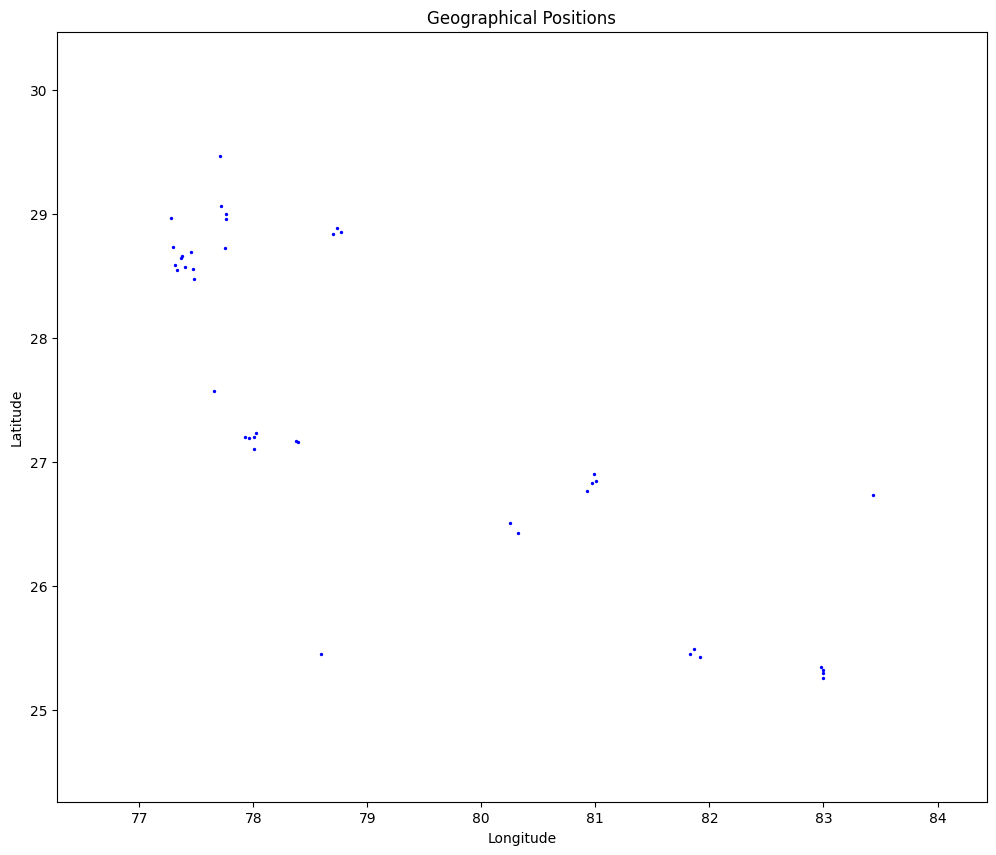

In [12]:
import matplotlib.pyplot as plt

# Split the latitude and longitude into separate lists
latitudes = [pos[0] for pos in filtered_lat_long_positions]
longitudes = [pos[1] for pos in filtered_lat_long_positions]

# Create a scatter plot with a larger figure size
plt.figure(figsize=(12, 10))  # Increase the figure size

# Plot the points with a larger marker size
plt.scatter(longitudes, latitudes, color='blue', marker='o', s=2)

# Label the axes
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Title of the plot
plt.title('Geographical Positions')

# Set the axis limits to zoom in and create more space between points
plt.xlim(min(longitudes) - 1, max(longitudes) + 1)
plt.ylim(min(latitudes) - 1, max(latitudes) + 1)

# Save the plot as an image file
output_image = 'positions_plot_large.png'
plt.savefig(output_image, dpi=300)  # Increase dpi for better resolution

# Show the plot
plt.show()


# Determine the k nearest neighbours

In [13]:
import numpy as np

k = 8  # Number of nearest neighbors

# Initialize adjacency matrix (with all zeros)
adjacency_matrix = np.zeros((len(input_files), len(input_files)), dtype=int)

# Loop through each entry to find k nearest neighbors
for i in range(len(input_files)):
    # Get distances for the i-th entry
    distances = distance_matrix[i]
    
    # Find the indices of the k smallest distances, excluding the distance to itself (i.e., index i)
    nearest_neighbors = np.argsort(distances)[1:k+1]  # 1:k+1 because argsort includes self-distance at position 0
    
    # Print the k nearest neighbors for the current file
    print(f"\nFile: {input_files[i]}")
    print(f"K-nearest neighbors: {[input_files[j] for j in nearest_neighbors]}")
    
    # Update the adjacency matrix to represent edges
    for neighbor in nearest_neighbors:
        adjacency_matrix[i][neighbor] = 1
        adjacency_matrix[neighbor][i] = 1  # Ensure undirected edge

# Print the adjacency matrix
print("\nAdjacency Matrix:")
print(adjacency_matrix)

# Print neighbors for each file based on the adjacency matrix
for i in range(len(input_files)):
    neighbors = [input_files[j] for j in range(len(input_files)) if adjacency_matrix[i][j] == 1]
    print(f"\nNeighbors of {input_files[i]} based on adjacency matrix: {neighbors}")


File: UP002.csv
K-nearest neighbors: ['UP024.csv', 'UP035.csv', 'UP039.csv', 'UP044.csv', 'UP040.csv', 'UP033.csv', 'UP038.csv', 'UP036.csv']

File: UP003.csv
K-nearest neighbors: ['UP041.csv', 'UP029.csv', 'UP031.csv', 'UP036.csv', 'UP033.csv', 'UP038.csv', 'UP032.csv', 'UP024.csv']

File: UP004.csv
K-nearest neighbors: ['UP030.csv', 'UP034.csv', 'UP028.csv', 'UP042.csv', 'UP037.csv', 'UP051.csv', 'UP043.csv', 'UP012.csv']

File: UP008.csv
K-nearest neighbors: ['UP021.csv', 'UP022.csv', 'UP018.csv', 'UP020.csv', 'UP009.csv', 'UP012.csv', 'UP017.csv', 'UP019.csv']

File: UP009.csv
K-nearest neighbors: ['UP018.csv', 'UP017.csv', 'UP021.csv', 'UP022.csv', 'UP019.csv', 'UP008.csv', 'UP020.csv', 'UP012.csv']

File: UP012.csv
K-nearest neighbors: ['UP020.csv', 'UP022.csv', 'UP008.csv', 'UP021.csv', 'UP018.csv', 'UP009.csv', 'UP017.csv', 'UP019.csv']

File: UP014.csv
K-nearest neighbors: ['UP026.csv', 'UP025.csv', 'UP023.csv', 'UP050.csv', 'UP016.csv', 'UP017.csv', 'UP019.csv', 'UP009.csv']

# Plotting the edges on the map

In [14]:
import folium

# Create a Folium map centered at the average of the coordinates
center_lat = sum([pos[0] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
center_long = sum([pos[1] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)

# Initialize the map
m = folium.Map(location=[center_lat, center_long], zoom_start=5)

# Add markers for each position
for idx, (lat, long) in enumerate(filtered_lat_long_positions):
    folium.Marker([lat, long], tooltip=f'Point {idx + 1}').add_to(m)

# Add edges based on adjacency matrix
for i in range(len(adjacency_matrix)):
    for j in range(i + 1, len(adjacency_matrix)):  # Only check upper triangle to avoid duplicate edges
        if adjacency_matrix[i][j] == 1:
            # Draw a line between point i and point j
            folium.PolyLine([filtered_lat_long_positions[i], filtered_lat_long_positions[j]], color="blue").add_to(m)

# Save the map to an HTML file or display in Jupyter notebook
m.save("map_with_edges.html")

# To display directly in Jupyter notebook
m


# Change the diagonal elements to 1

In [15]:
# Change the diagonal elements to 1
np.fill_diagonal(adjacency_matrix, 1)
adjacency_matrix

array([[1, 0, 0, ..., 0, 0, 0],
       [0, 1, 0, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 1, 1],
       ...,
       [0, 0, 0, ..., 1, 0, 0],
       [0, 0, 1, ..., 0, 1, 1],
       [0, 0, 1, ..., 0, 1, 1]])

# Prepare Graph Data for GNN

In [16]:
# Prepare graph data for each timestamp
def prepare_graph_data_for_timestamp(dataframes, adjacency_matrix, timestamp_index):
    # Extract the row corresponding to the timestamp index from all CSV files
    features = np.stack([df.iloc[timestamp_index].values for df in dataframes], axis=0)  # shape (num_nodes, num_features)
    
    # Create node features (tensor)
    node_features = torch.tensor(features, dtype=torch.float)
    
    # Create edge index (adjacency matrix)
    edge_index = torch.tensor(np.array(np.nonzero(adjacency_matrix)), dtype=torch.long)
    
    # Create target tensor (for 'AT (degree C)')
    target_values = torch.tensor([df.iloc[timestamp_index]['AT (degree C)'] for df in dataframes], dtype=torch.float)
    
    graph_data = Data(x=node_features, edge_index=edge_index, y=target_values)
    print(f"Graph data for timestamp {timestamp_index} created.")
    print(graph_data)
    return graph_data

# Get the number of timestamps
train_num_timestamps = len(train_dataframes[0])
test_num_timestamps = len(test_dataframes[0])

# Prepare graph data for each timestamp
train_graph_data_list = [prepare_graph_data_for_timestamp(train_dataframes, adjacency_matrix, i) for i in range(train_num_timestamps)]
test_graph_data_list = [prepare_graph_data_for_timestamp(test_dataframes, adjacency_matrix, i) for i in range(test_num_timestamps)]

print(f"Number of graph data objects created for training: {len(train_graph_data_list)}")
print(f"Number of graph data objects created for testing: {len(test_graph_data_list)}")
print("Sample training graph data object:")
print(train_graph_data_list[0])
print("Sample testing graph data object:")
print(test_graph_data_list[0])

Graph data for timestamp 0 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 1 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 2 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 3 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 4 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 5 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 6 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 7 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 8 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 9 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 10 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 11 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for

# GAT Implementation

Epoch 0, Loss: 0.4747165124396776
Epoch 1, Loss: 0.16529316043035383
Epoch 2, Loss: 0.15812979381650696
Epoch 3, Loss: 0.15489350789319578
Epoch 4, Loss: 0.15368881610362925
Epoch 5, Loss: 0.15156480969978808
Epoch 6, Loss: 0.15146331258471346
Epoch 7, Loss: 0.1512052605886838
Epoch 8, Loss: 0.15142247726644928
Epoch 9, Loss: 0.15121305915964073
Epoch 10, Loss: 0.15040430500105437
Epoch 11, Loss: 0.15065963729326565
Epoch 12, Loss: 0.1502929575638369
Epoch 13, Loss: 0.1504682859395382
Epoch 14, Loss: 0.15021808921518776
Epoch 15, Loss: 0.15031969734384626
Epoch 16, Loss: 0.15055321455229553
Epoch 17, Loss: 0.14971998073019996
Epoch 18, Loss: 0.1497085622788533
Epoch 19, Loss: 0.14981229547085245
Epoch 20, Loss: 0.15023344896439506
Epoch 21, Loss: 0.14977062962818447
Epoch 22, Loss: 0.14989639378659472
Epoch 23, Loss: 0.1499740597792528
Epoch 24, Loss: 0.14988179477935237
Epoch 25, Loss: 0.14994482469460213
Epoch 26, Loss: 0.14945685187256227
Epoch 27, Loss: 0.14978351960179476
Epoch 28

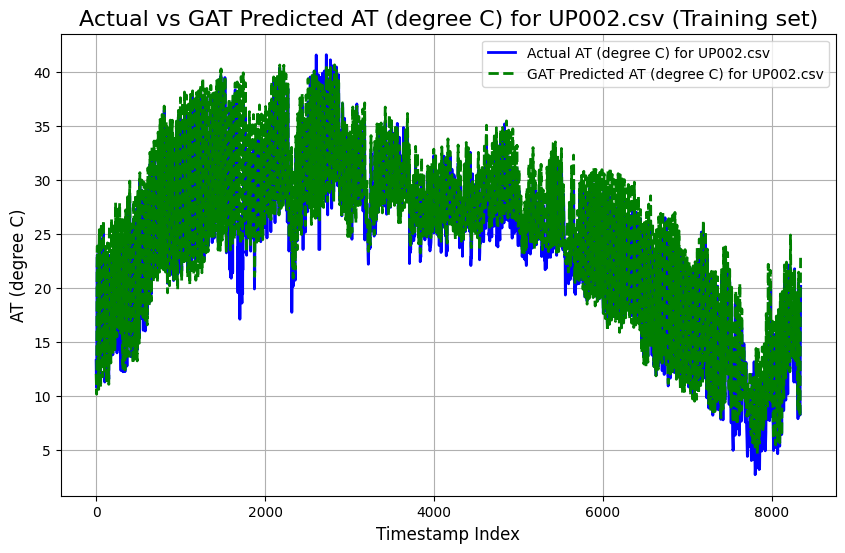

UP003.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3383
Mean Squared Error (MSE): 3.8534
Root Mean Squared Error (RMSE): 1.9630
Pearson Correlation Coefficient: 0.9781
R-squared (R²): 0.9498

----------------------------------------



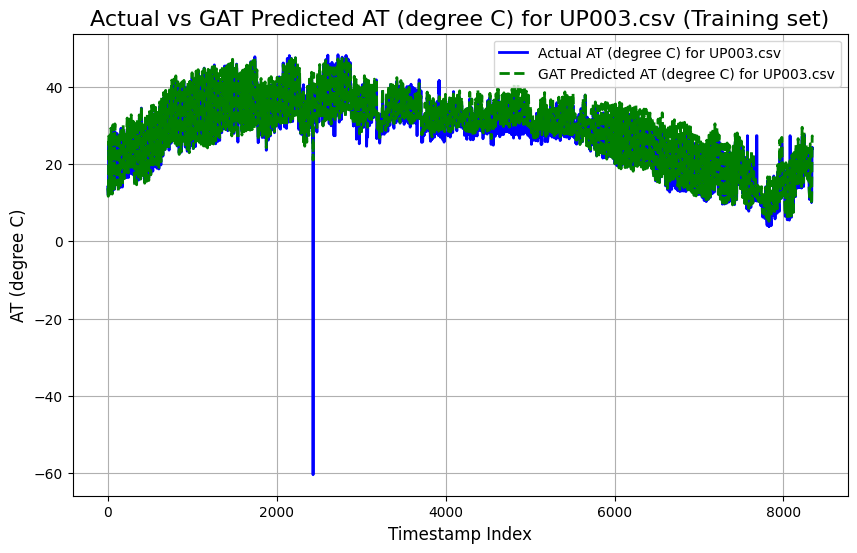

UP004.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5361
Mean Squared Error (MSE): 3.8806
Root Mean Squared Error (RMSE): 1.9699
Pearson Correlation Coefficient: 0.9788
R-squared (R²): 0.9533

----------------------------------------



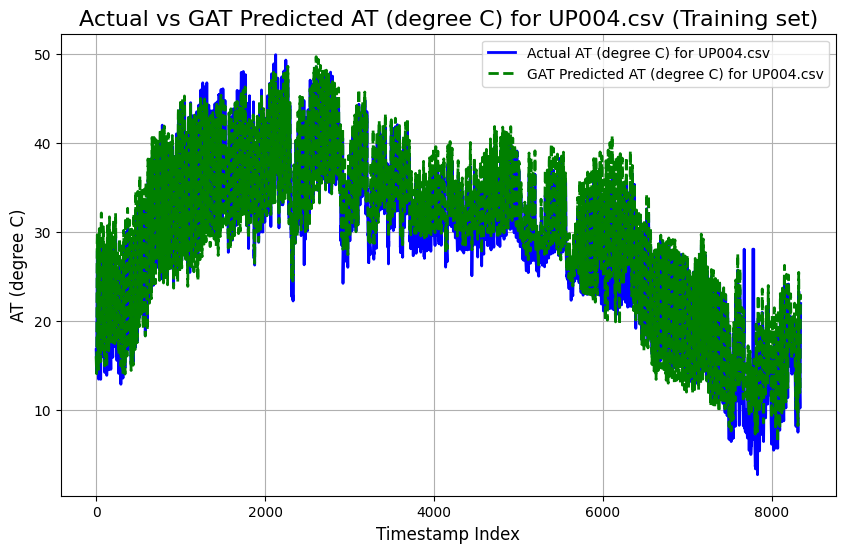

UP008.csv (Training set) Metrics:
Mean Absolute Error (MAE): 5.7810
Mean Squared Error (MSE): 68.6020
Root Mean Squared Error (RMSE): 8.2826
Pearson Correlation Coefficient: 0.7636
R-squared (R²): 0.5452

----------------------------------------



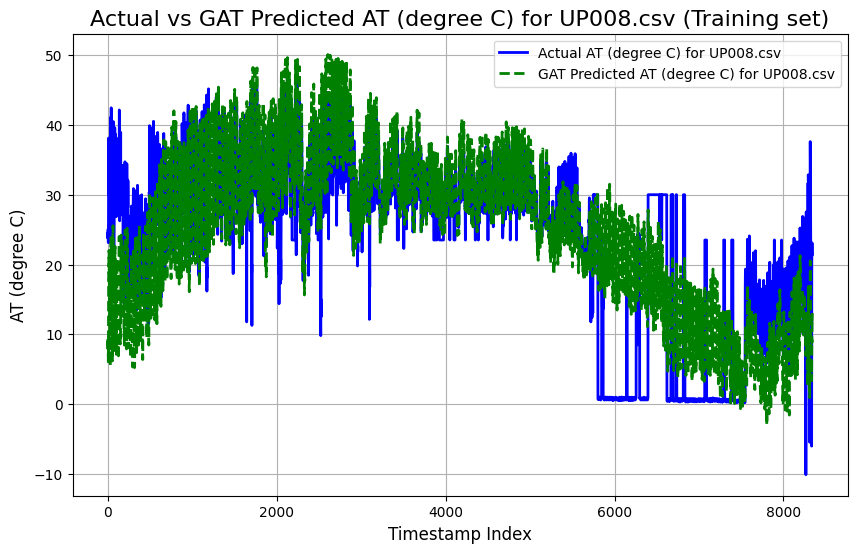

UP009.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3087
Mean Squared Error (MSE): 3.3758
Root Mean Squared Error (RMSE): 1.8373
Pearson Correlation Coefficient: 0.9736
R-squared (R²): 0.9432

----------------------------------------



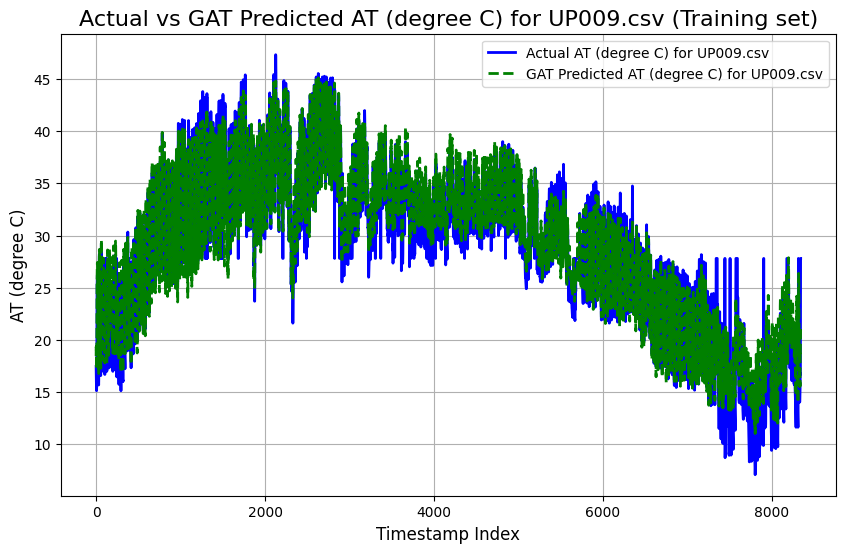

UP012.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.6962
Mean Squared Error (MSE): 7.7281
Root Mean Squared Error (RMSE): 2.7800
Pearson Correlation Coefficient: 0.9659
R-squared (R²): 0.9281

----------------------------------------



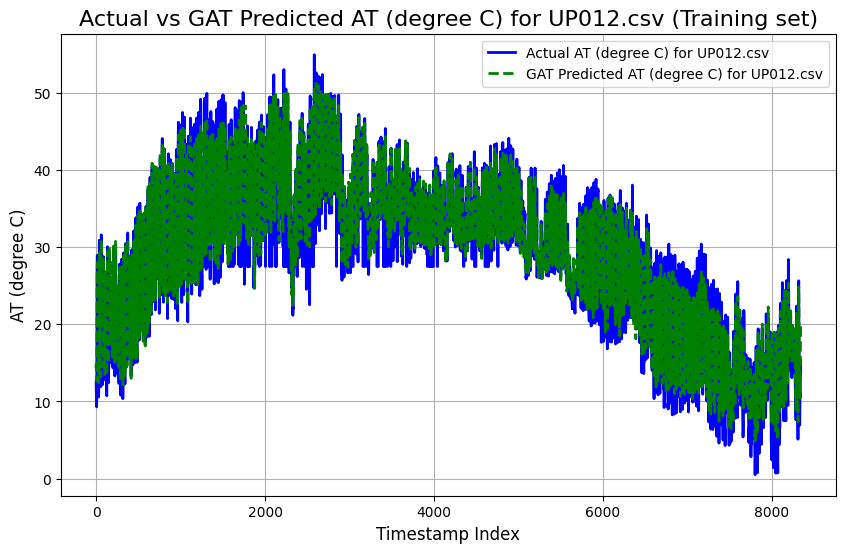

UP014.csv (Training set) Metrics:
Mean Absolute Error (MAE): 3.1231
Mean Squared Error (MSE): 16.1243
Root Mean Squared Error (RMSE): 4.0155
Pearson Correlation Coefficient: 0.9418
R-squared (R²): 0.8804

----------------------------------------



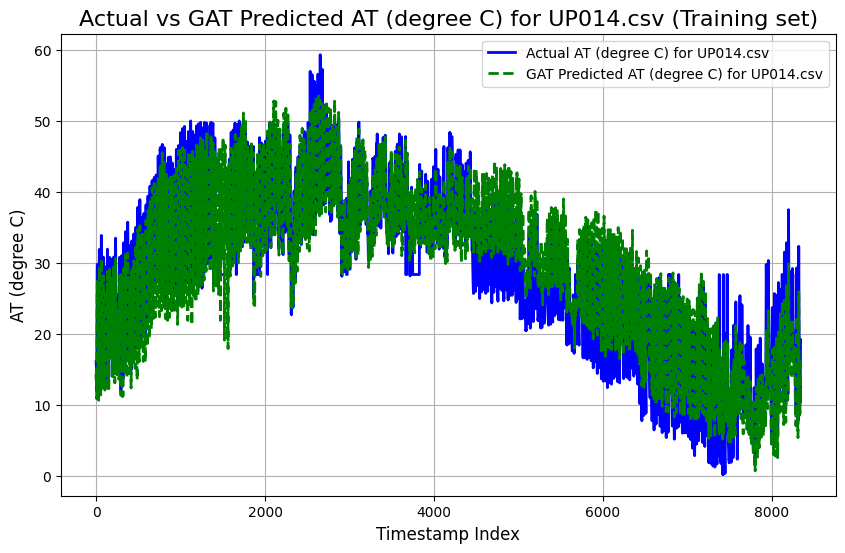

UP016.csv (Training set) Metrics:
Mean Absolute Error (MAE): 3.0016
Mean Squared Error (MSE): 16.0103
Root Mean Squared Error (RMSE): 4.0013
Pearson Correlation Coefficient: 0.9427
R-squared (R²): 0.8825

----------------------------------------



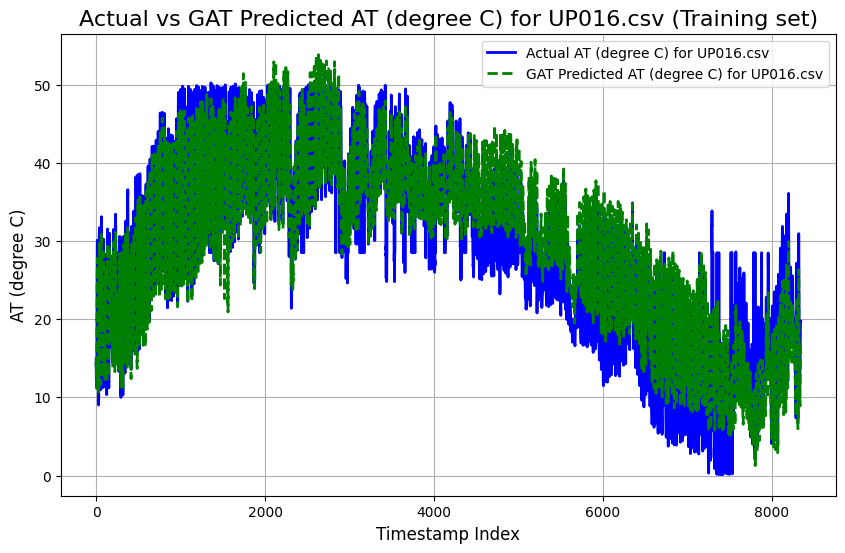

UP017.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.9165
Mean Squared Error (MSE): 1.2639
Root Mean Squared Error (RMSE): 1.1242
Pearson Correlation Coefficient: 0.9828
R-squared (R²): 0.9612

----------------------------------------



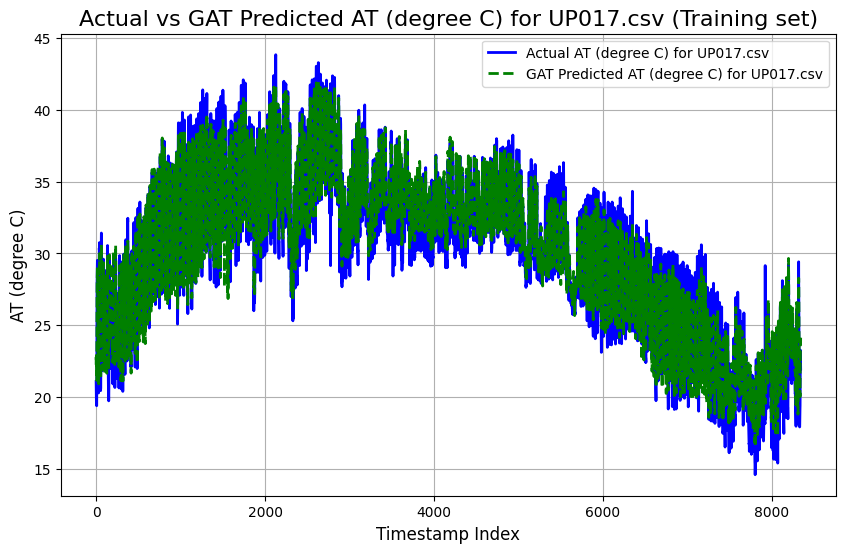

UP018.csv (Training set) Metrics:
Mean Absolute Error (MAE): 4.3543
Mean Squared Error (MSE): 39.5989
Root Mean Squared Error (RMSE): 6.2928
Pearson Correlation Coefficient: 0.5156
R-squared (R²): 0.0718

----------------------------------------



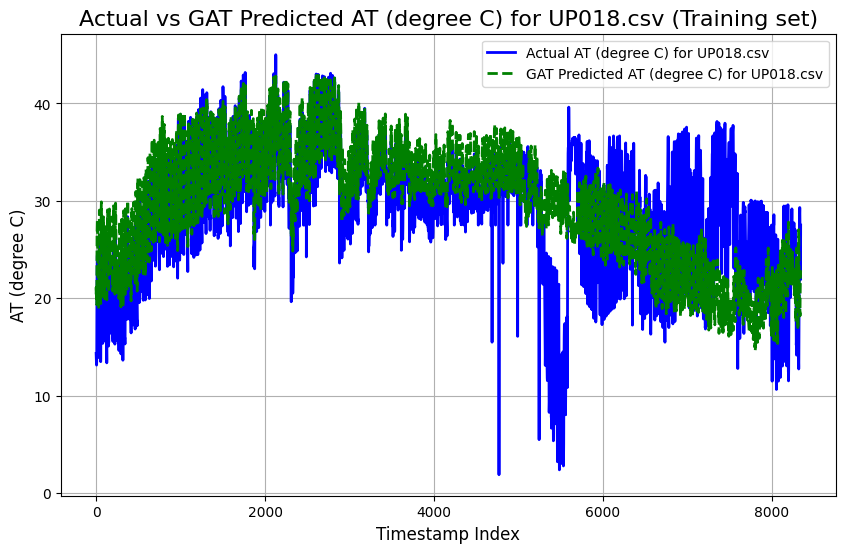

UP019.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.8061
Mean Squared Error (MSE): 7.1208
Root Mean Squared Error (RMSE): 2.6685
Pearson Correlation Coefficient: 0.8974
R-squared (R²): 0.7969

----------------------------------------



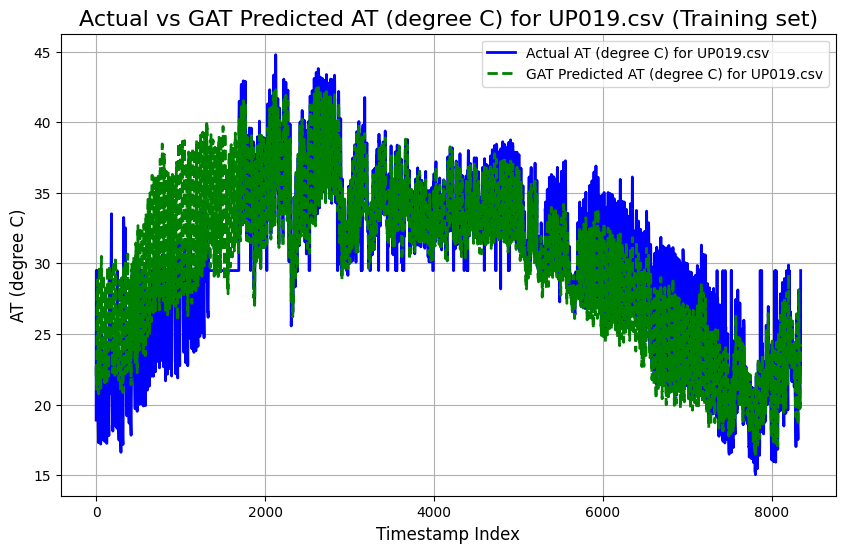

UP020.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3037
Mean Squared Error (MSE): 2.7095
Root Mean Squared Error (RMSE): 1.6461
Pearson Correlation Coefficient: 0.9784
R-squared (R²): 0.9521

----------------------------------------



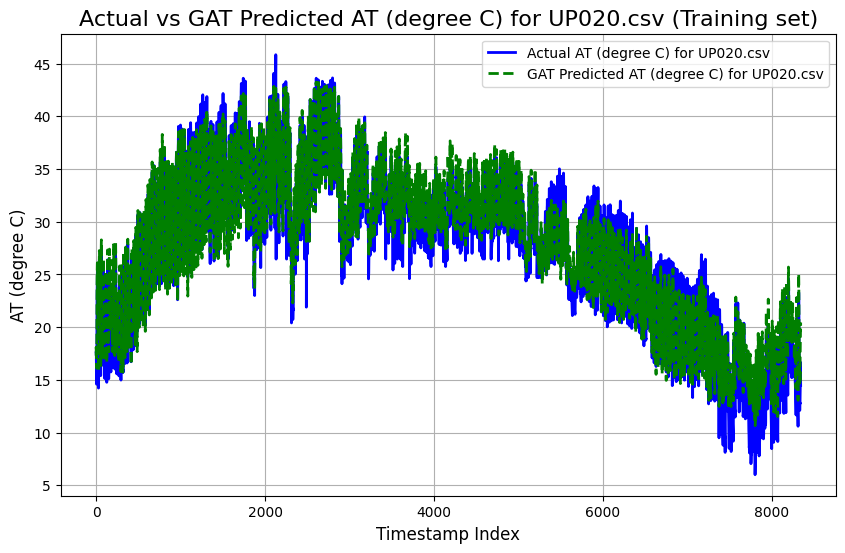

UP021.csv (Training set) Metrics:
Mean Absolute Error (MAE): 3.6536
Mean Squared Error (MSE): 23.6053
Root Mean Squared Error (RMSE): 4.8585
Pearson Correlation Coefficient: 0.8420
R-squared (R²): 0.6936

----------------------------------------



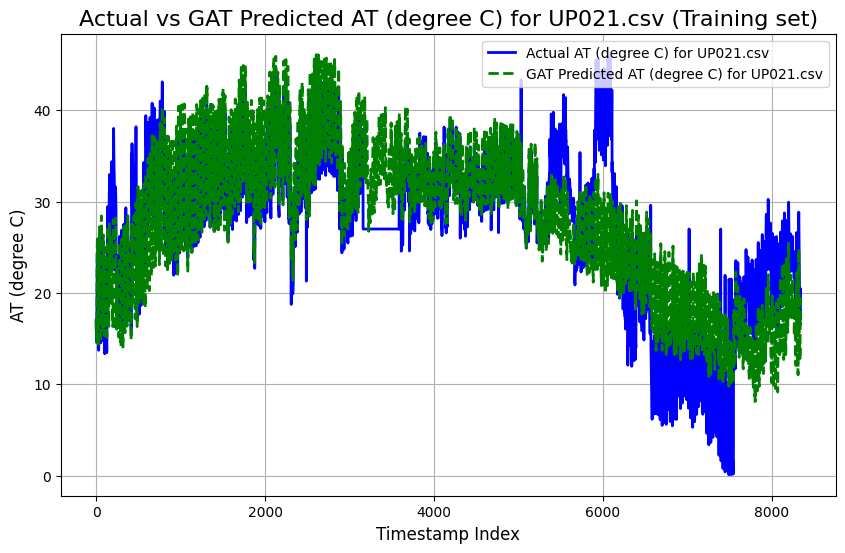

UP022.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3522
Mean Squared Error (MSE): 3.3762
Root Mean Squared Error (RMSE): 1.8374
Pearson Correlation Coefficient: 0.9723
R-squared (R²): 0.9405

----------------------------------------



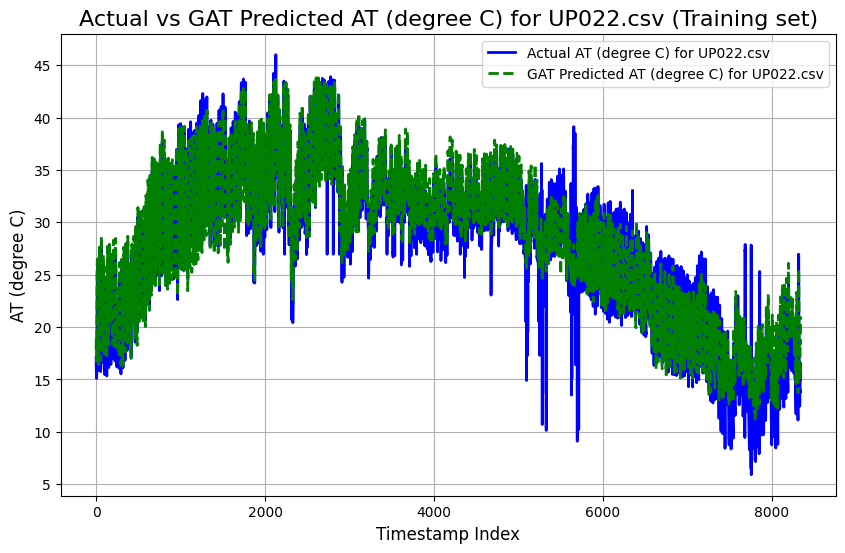

UP023.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.0618
Mean Squared Error (MSE): 14.6851
Root Mean Squared Error (RMSE): 3.8321
Pearson Correlation Coefficient: 0.8714
R-squared (R²): 0.7422

----------------------------------------



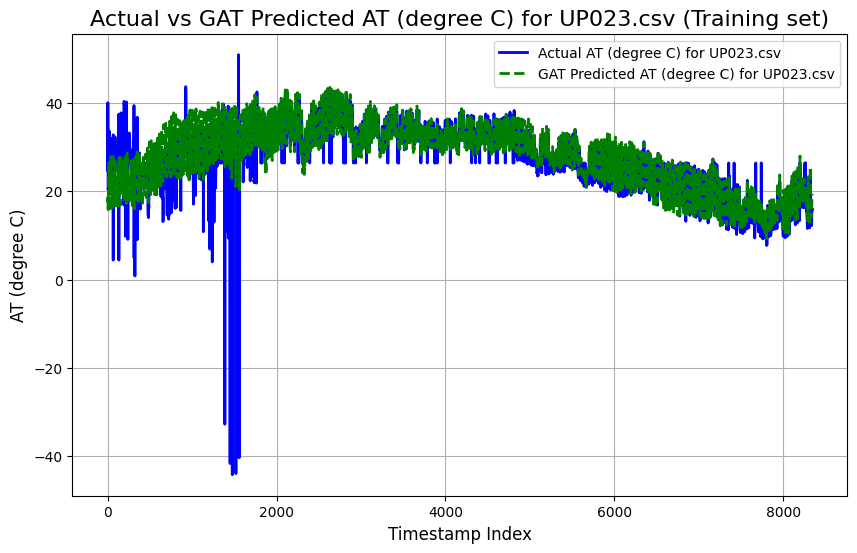

UP024.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.7010
Mean Squared Error (MSE): 13.7260
Root Mean Squared Error (RMSE): 3.7049
Pearson Correlation Coefficient: 0.8259
R-squared (R²): 0.6405

----------------------------------------



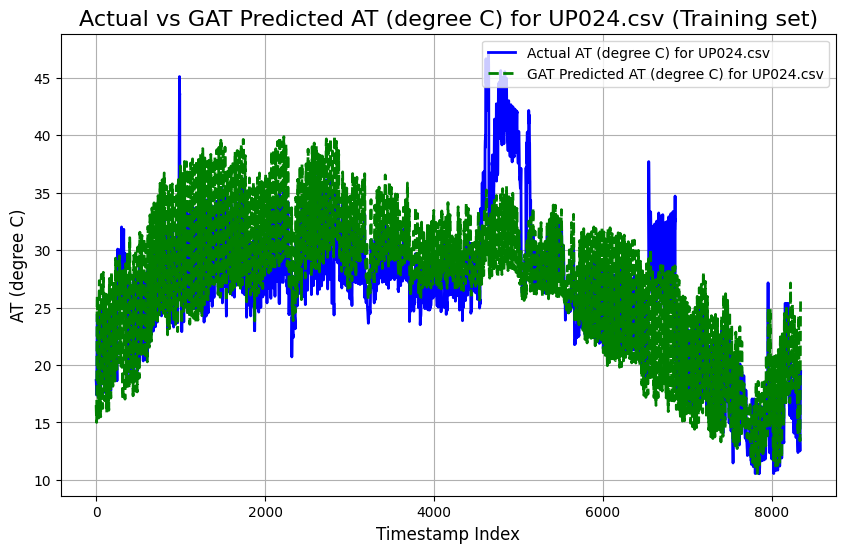

UP025.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2079
Mean Squared Error (MSE): 3.1406
Root Mean Squared Error (RMSE): 1.7722
Pearson Correlation Coefficient: 0.9751
R-squared (R²): 0.9461

----------------------------------------



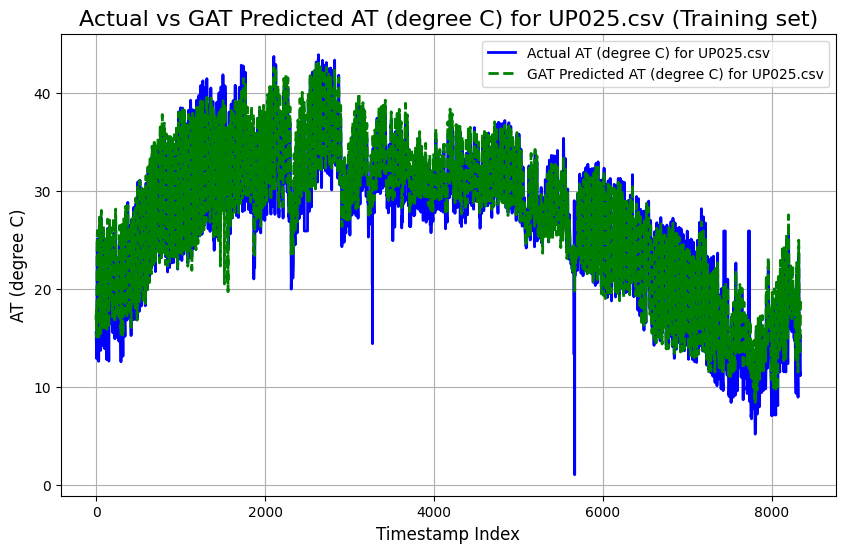

UP026.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1800
Mean Squared Error (MSE): 3.0683
Root Mean Squared Error (RMSE): 1.7516
Pearson Correlation Coefficient: 0.9794
R-squared (R²): 0.9546

----------------------------------------



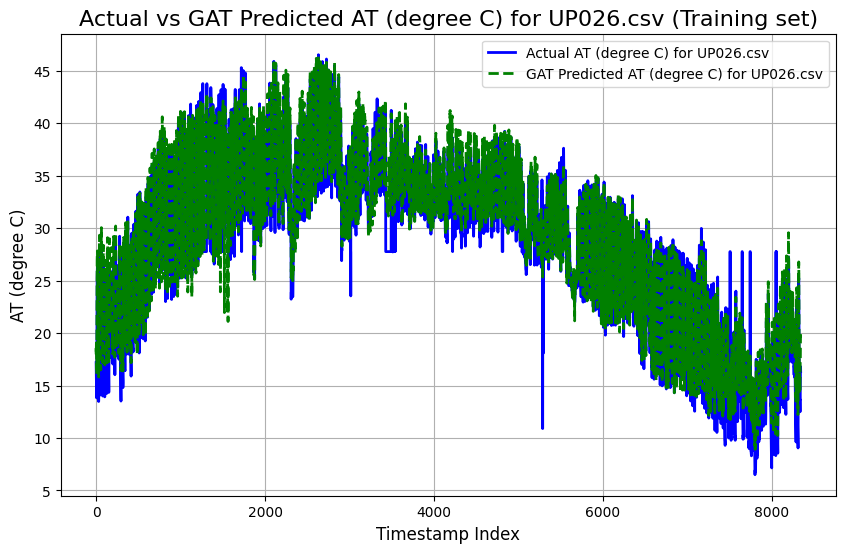

UP028.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.8549
Mean Squared Error (MSE): 5.3679
Root Mean Squared Error (RMSE): 2.3169
Pearson Correlation Coefficient: 0.9732
R-squared (R²): 0.9421

----------------------------------------



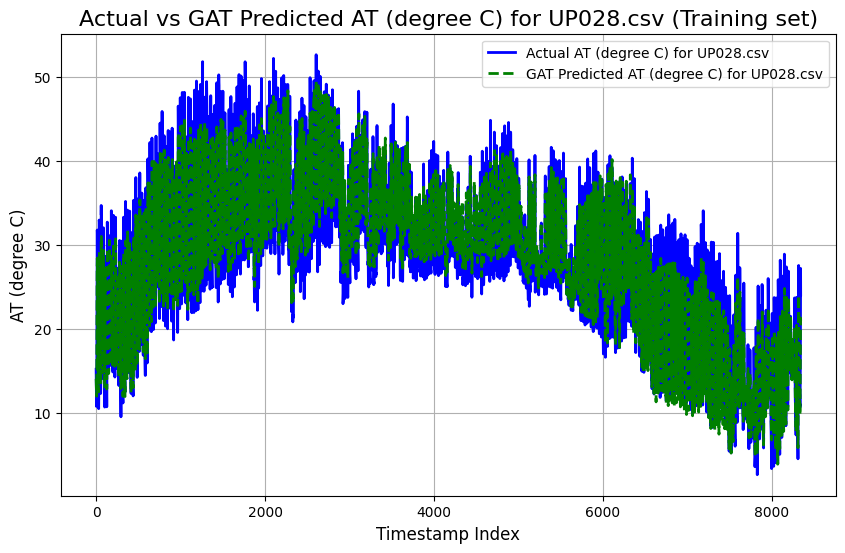

UP029.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1600
Mean Squared Error (MSE): 3.3555
Root Mean Squared Error (RMSE): 1.8318
Pearson Correlation Coefficient: 0.9748
R-squared (R²): 0.9431

----------------------------------------



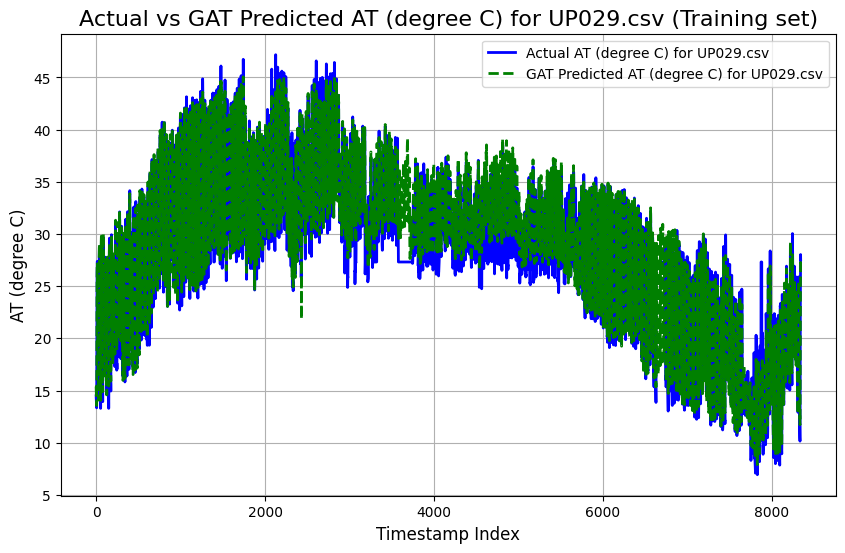

UP030.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3697
Mean Squared Error (MSE): 3.0276
Root Mean Squared Error (RMSE): 1.7400
Pearson Correlation Coefficient: 0.9837
R-squared (R²): 0.9629

----------------------------------------



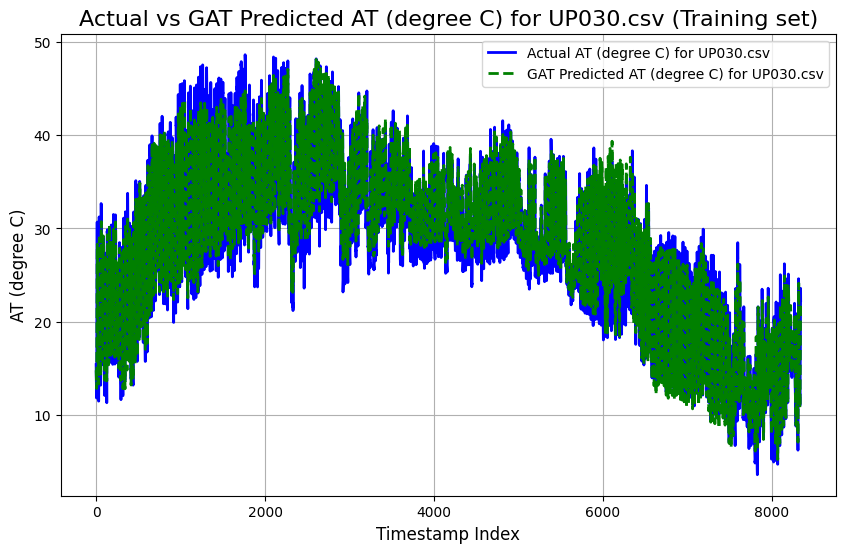

UP031.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5729
Mean Squared Error (MSE): 4.2600
Root Mean Squared Error (RMSE): 2.0640
Pearson Correlation Coefficient: 0.9721
R-squared (R²): 0.9375

----------------------------------------



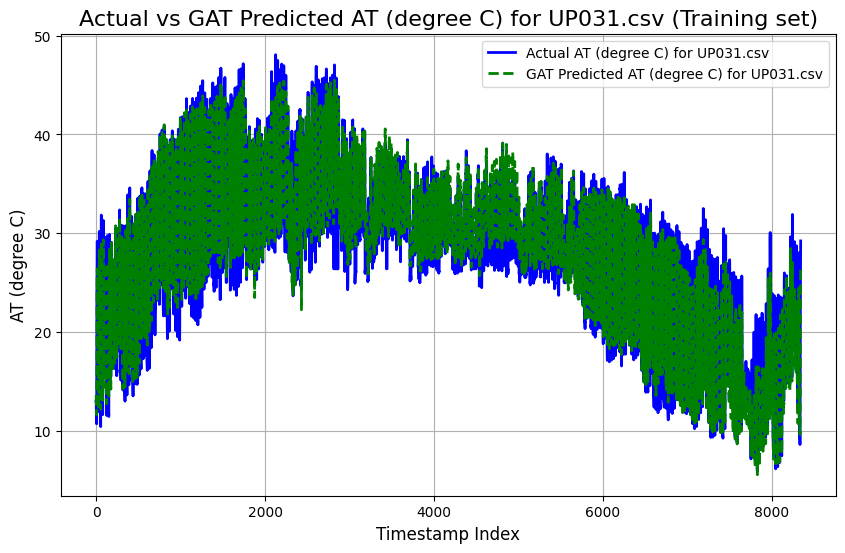

UP032.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4733
Mean Squared Error (MSE): 3.8564
Root Mean Squared Error (RMSE): 1.9638
Pearson Correlation Coefficient: 0.9674
R-squared (R²): 0.9279

----------------------------------------



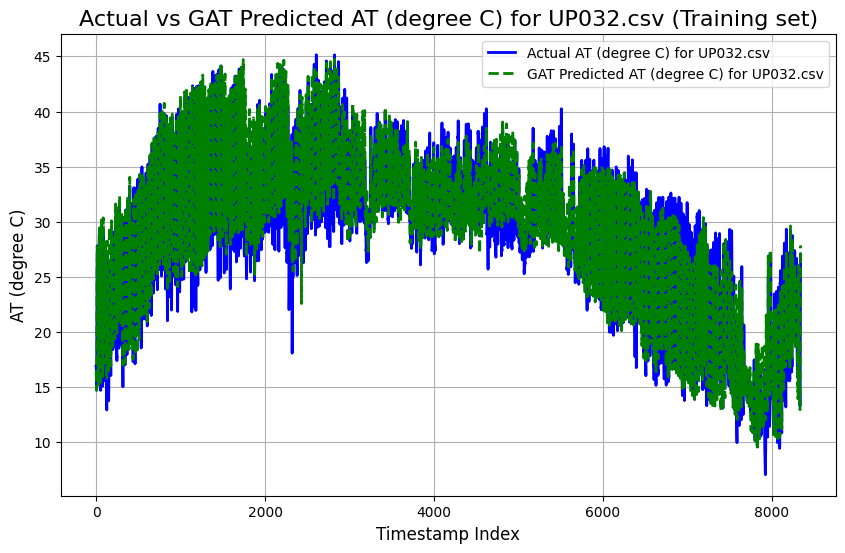

UP033.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0498
Mean Squared Error (MSE): 2.2866
Root Mean Squared Error (RMSE): 1.5122
Pearson Correlation Coefficient: 0.9848
R-squared (R²): 0.9638

----------------------------------------



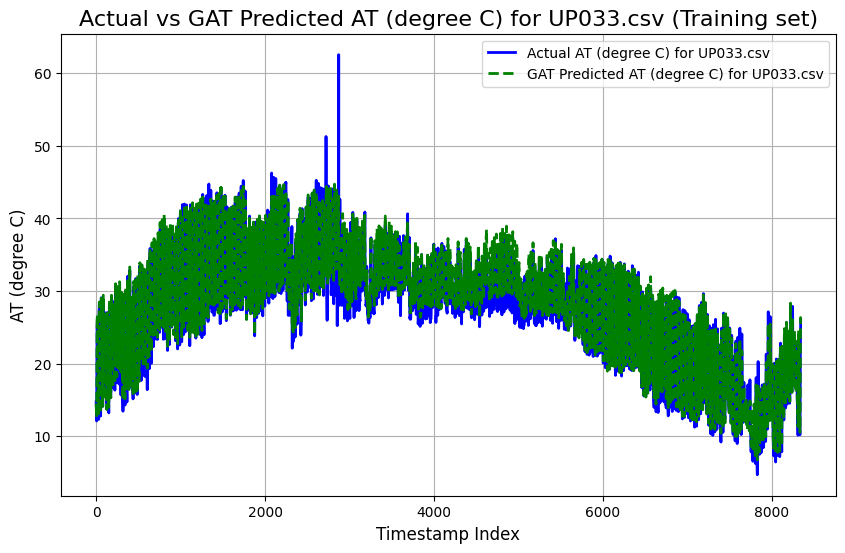

UP034.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5461
Mean Squared Error (MSE): 5.4410
Root Mean Squared Error (RMSE): 2.3326
Pearson Correlation Coefficient: 0.9724
R-squared (R²): 0.9405

----------------------------------------



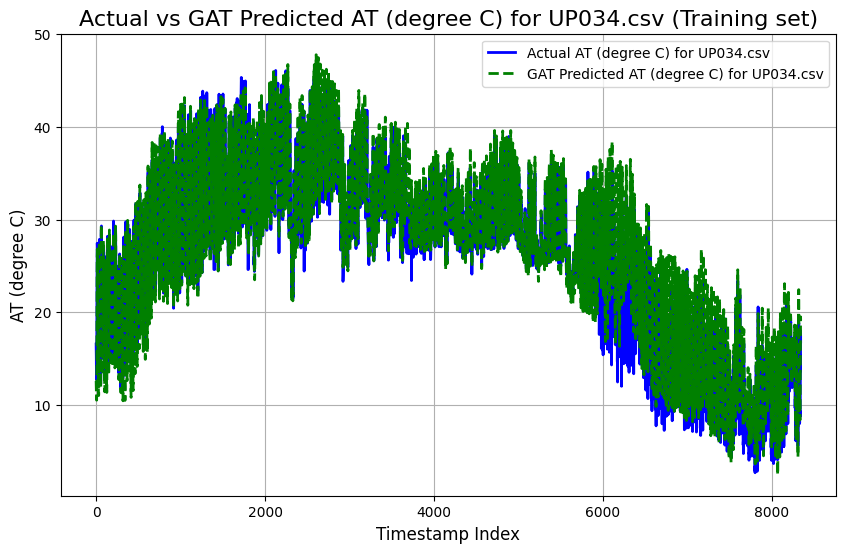

UP035.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0991
Mean Squared Error (MSE): 2.2089
Root Mean Squared Error (RMSE): 1.4862
Pearson Correlation Coefficient: 0.9870
R-squared (R²): 0.9683

----------------------------------------



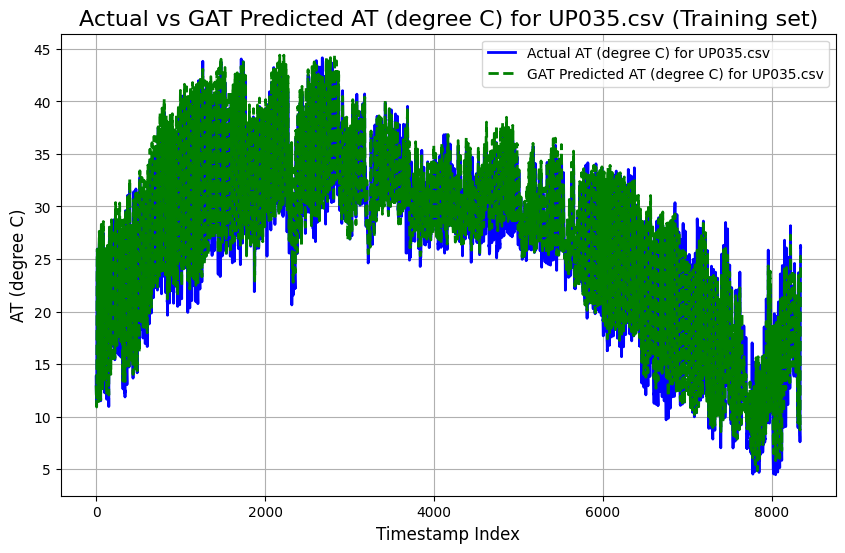

UP036.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2071
Mean Squared Error (MSE): 3.0681
Root Mean Squared Error (RMSE): 1.7516
Pearson Correlation Coefficient: 0.9781
R-squared (R²): 0.9498

----------------------------------------



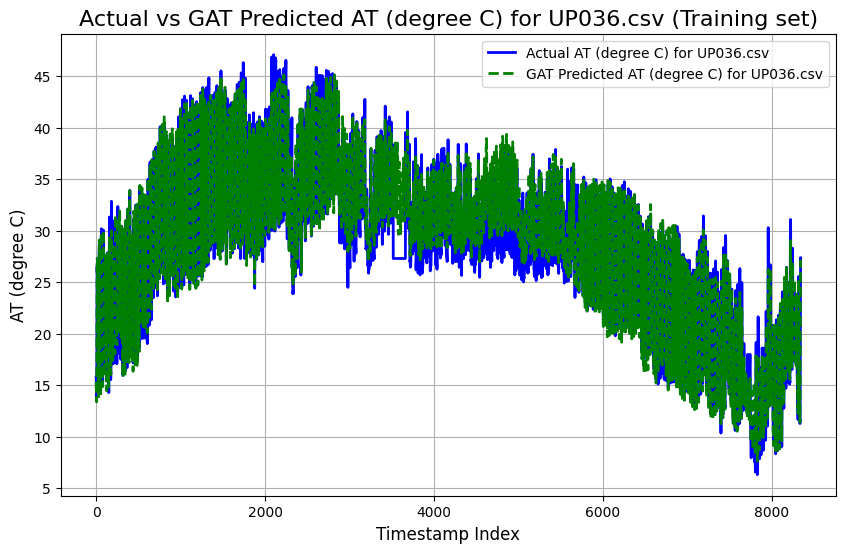

UP037.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3593
Mean Squared Error (MSE): 4.0731
Root Mean Squared Error (RMSE): 2.0182
Pearson Correlation Coefficient: 0.9754
R-squared (R²): 0.9464

----------------------------------------



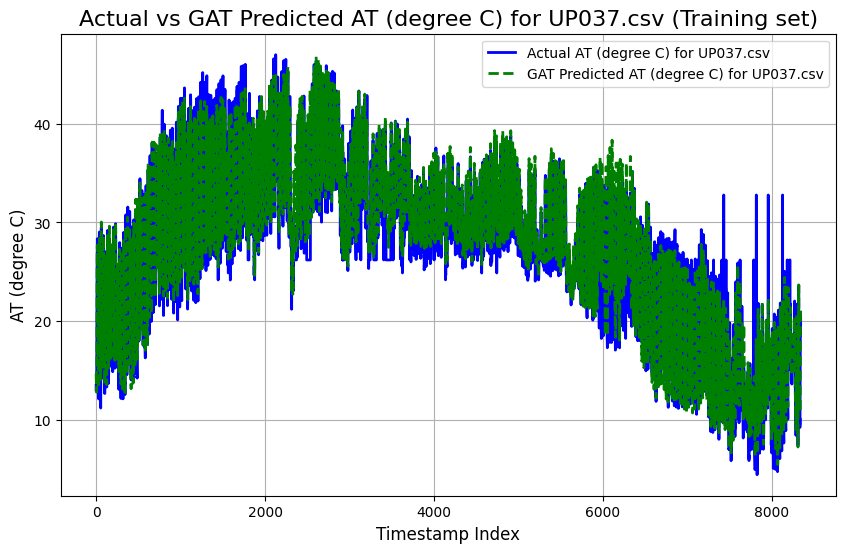

UP038.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3391
Mean Squared Error (MSE): 5.2696
Root Mean Squared Error (RMSE): 2.2956
Pearson Correlation Coefficient: 0.9574
R-squared (R²): 0.9079

----------------------------------------



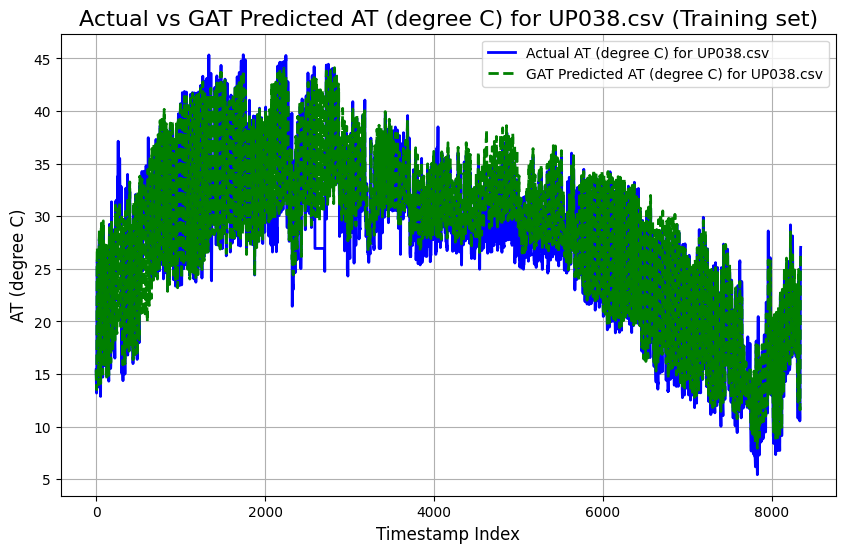

UP039.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.7033
Mean Squared Error (MSE): 5.0846
Root Mean Squared Error (RMSE): 2.2549
Pearson Correlation Coefficient: 0.9707
R-squared (R²): 0.9351

----------------------------------------



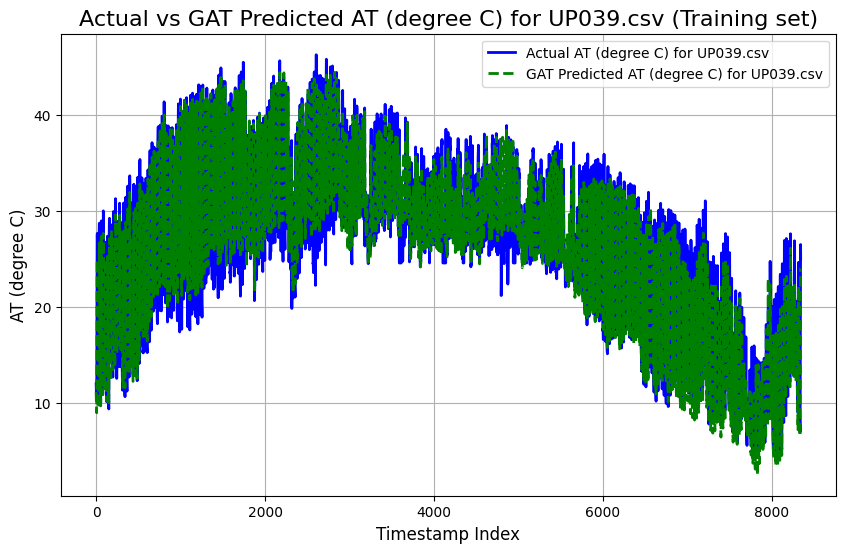

UP040.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4163
Mean Squared Error (MSE): 3.7470
Root Mean Squared Error (RMSE): 1.9357
Pearson Correlation Coefficient: 0.9793
R-squared (R²): 0.9531

----------------------------------------



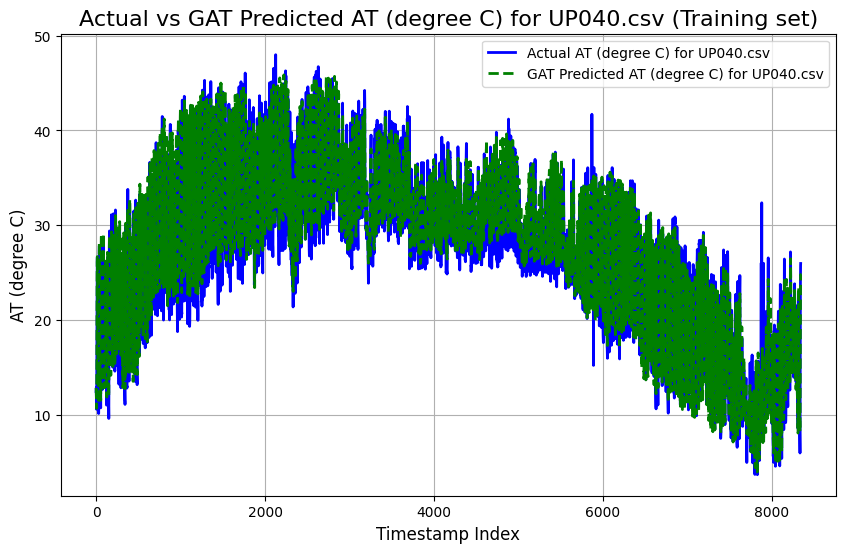

UP041.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2208
Mean Squared Error (MSE): 3.6982
Root Mean Squared Error (RMSE): 1.9231
Pearson Correlation Coefficient: 0.9704
R-squared (R²): 0.9339

----------------------------------------



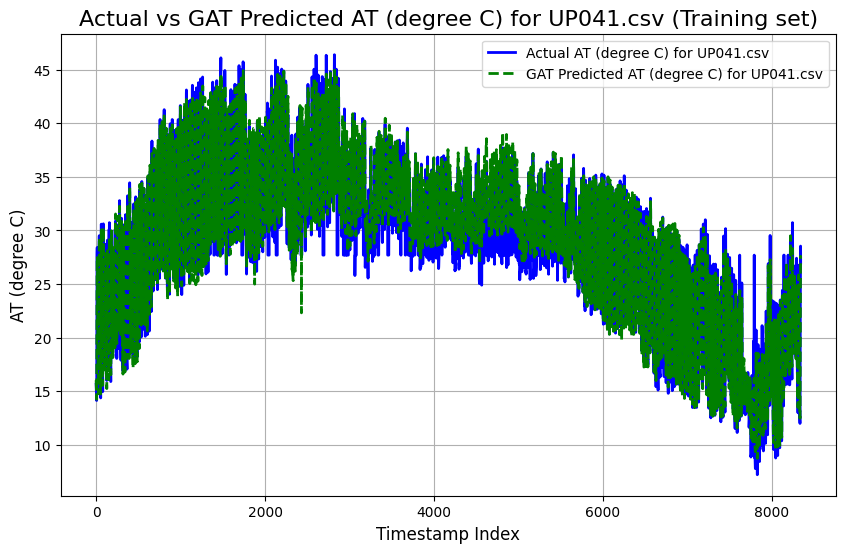

UP042.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.9809
Mean Squared Error (MSE): 10.6068
Root Mean Squared Error (RMSE): 3.2568
Pearson Correlation Coefficient: 0.9049
R-squared (R²): 0.8065

----------------------------------------



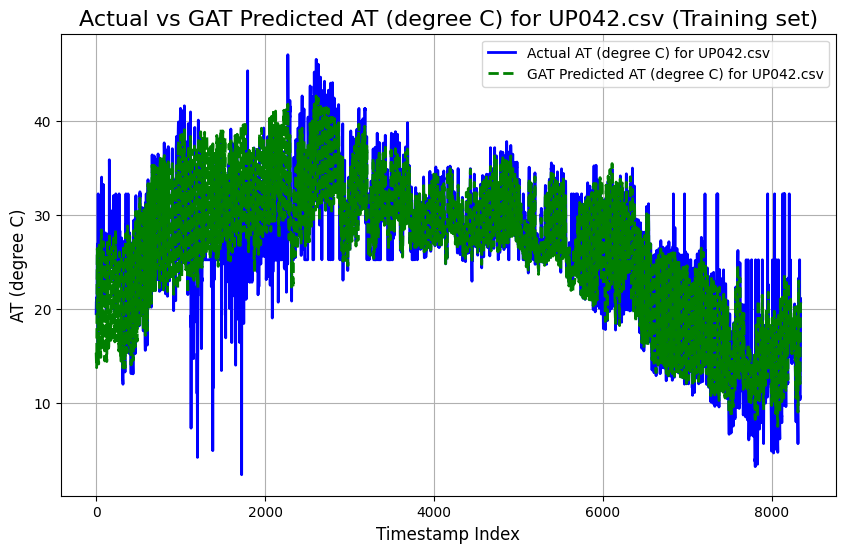

UP043.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.0841
Mean Squared Error (MSE): 10.8464
Root Mean Squared Error (RMSE): 3.2934
Pearson Correlation Coefficient: 0.9161
R-squared (R²): 0.8289

----------------------------------------



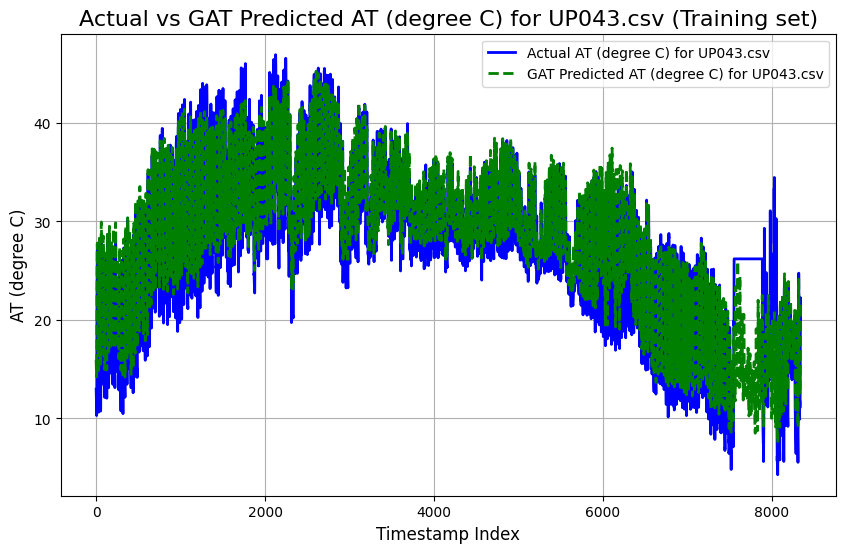

UP044.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2877
Mean Squared Error (MSE): 3.5567
Root Mean Squared Error (RMSE): 1.8859
Pearson Correlation Coefficient: 0.9796
R-squared (R²): 0.9535

----------------------------------------



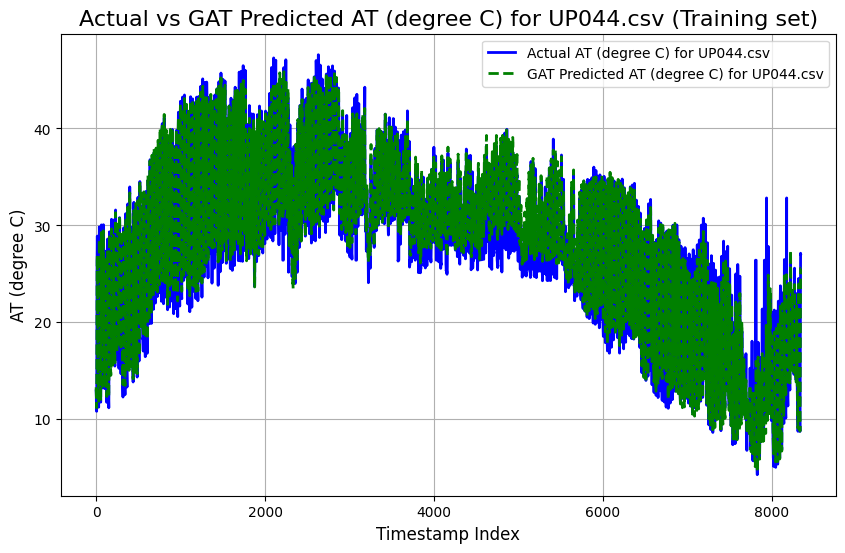

UP046.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5305
Mean Squared Error (MSE): 4.3839
Root Mean Squared Error (RMSE): 2.0938
Pearson Correlation Coefficient: 0.9701
R-squared (R²): 0.9355

----------------------------------------



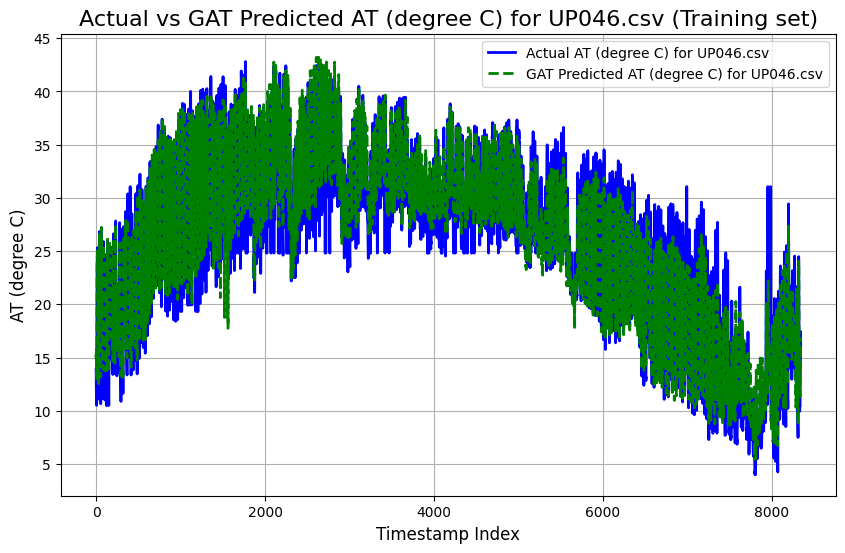

UP048.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.6197
Mean Squared Error (MSE): 5.0950
Root Mean Squared Error (RMSE): 2.2572
Pearson Correlation Coefficient: 0.9632
R-squared (R²): 0.9217

----------------------------------------



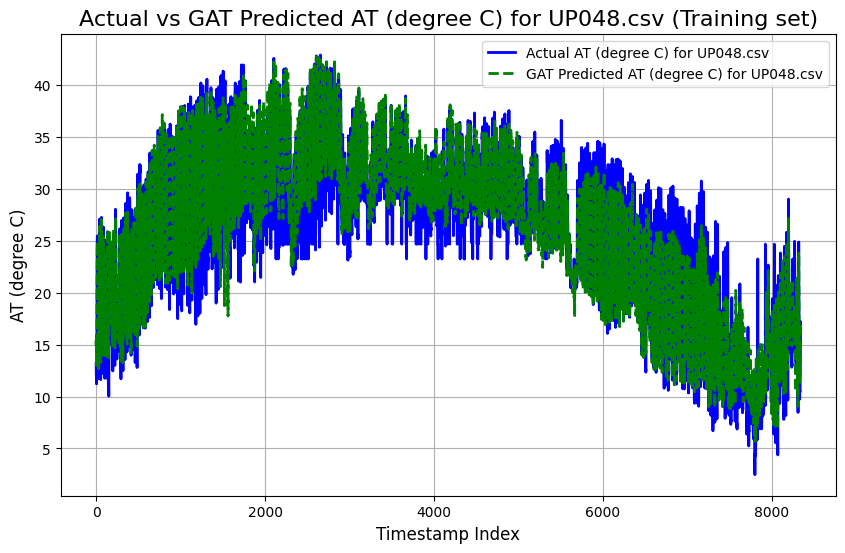

UP049.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4521
Mean Squared Error (MSE): 4.9235
Root Mean Squared Error (RMSE): 2.2189
Pearson Correlation Coefficient: 0.9668
R-squared (R²): 0.9290

----------------------------------------



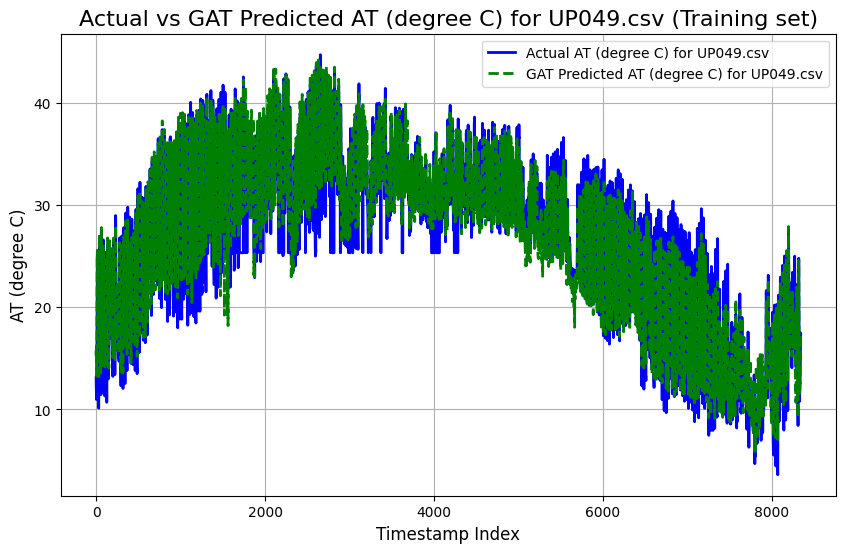

UP050.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.4594
Mean Squared Error (MSE): 10.8455
Root Mean Squared Error (RMSE): 3.2932
Pearson Correlation Coefficient: 0.8689
R-squared (R²): 0.7413

----------------------------------------



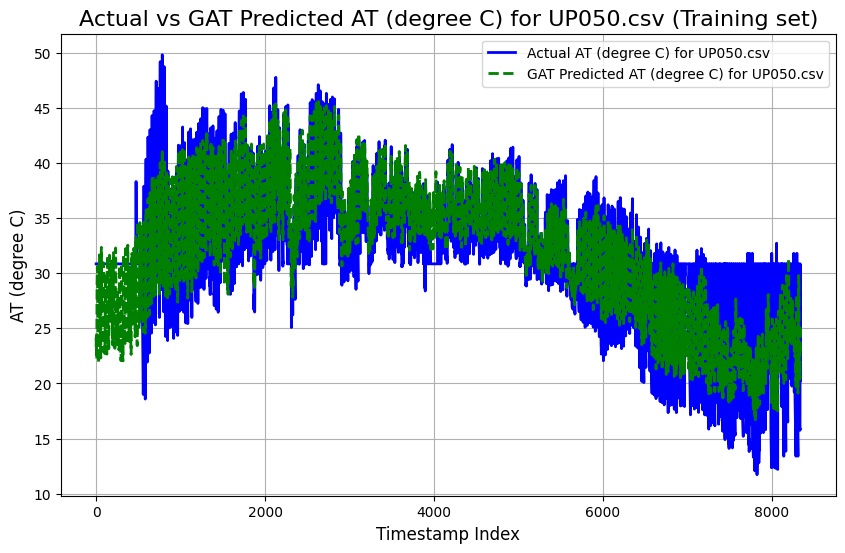

UP051.csv (Training set) Metrics:
Mean Absolute Error (MAE): 3.5072
Mean Squared Error (MSE): 39.8797
Root Mean Squared Error (RMSE): 6.3150
Pearson Correlation Coefficient: 0.7145
R-squared (R²): 0.4298

----------------------------------------



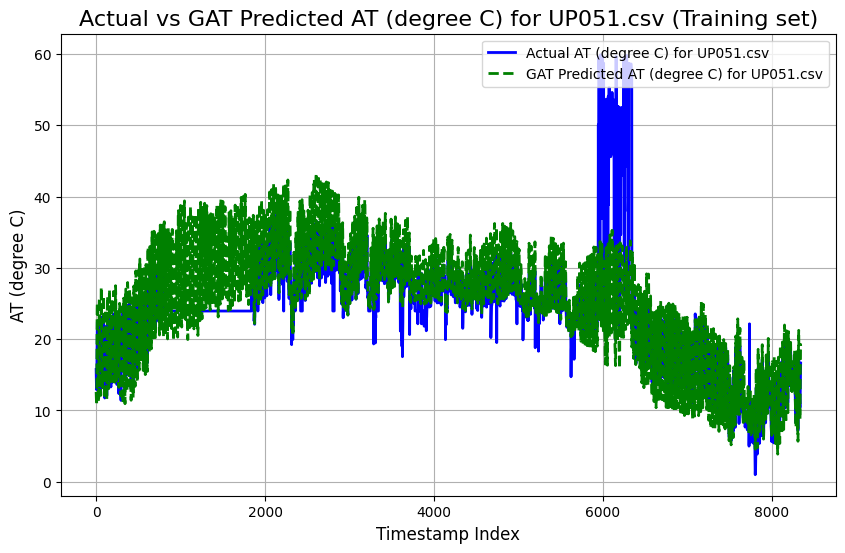

UP052.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.0319
Mean Squared Error (MSE): 8.3773
Root Mean Squared Error (RMSE): 2.8943
Pearson Correlation Coefficient: 0.9375
R-squared (R²): 0.8708

----------------------------------------



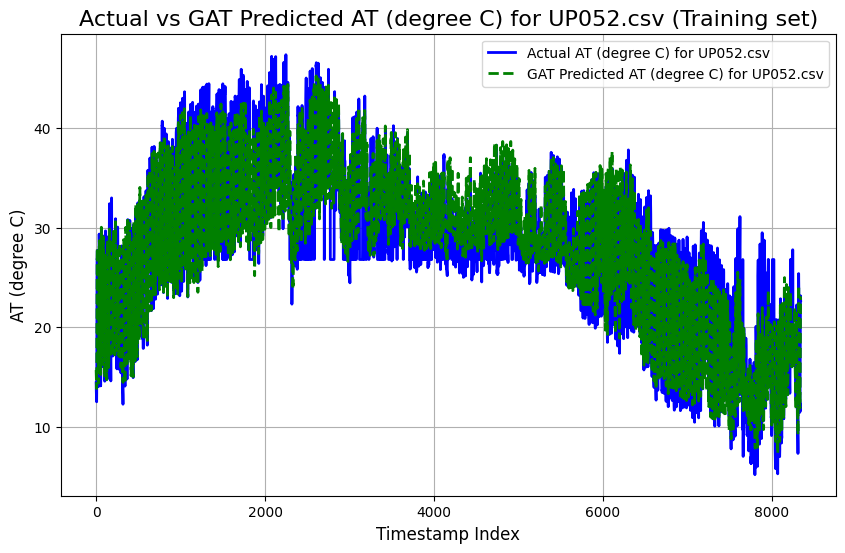

UP002.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2265
Mean Squared Error (MSE): 2.5360
Root Mean Squared Error (RMSE): 1.5925
Pearson Correlation Coefficient: 0.9659
R-squared (R²): 0.9087

----------------------------------------



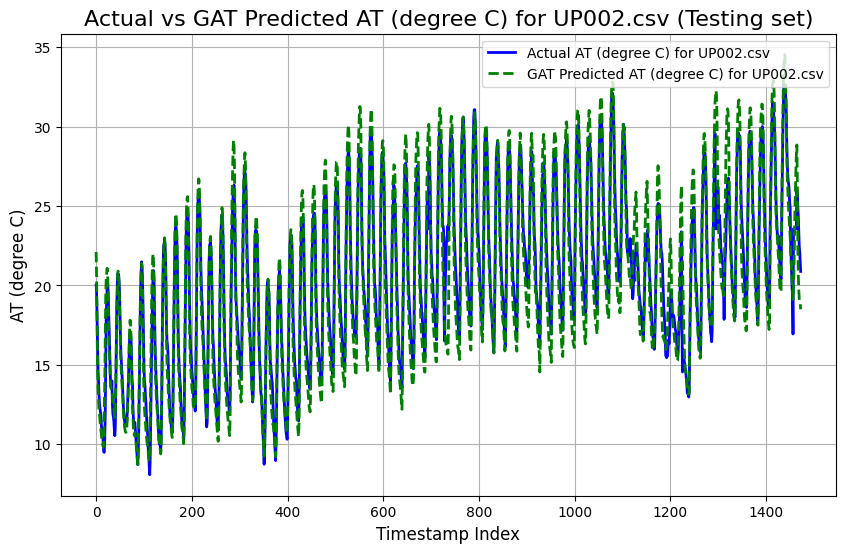

UP003.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4547
Mean Squared Error (MSE): 3.4644
Root Mean Squared Error (RMSE): 1.8613
Pearson Correlation Coefficient: 0.9668
R-squared (R²): 0.9072

----------------------------------------



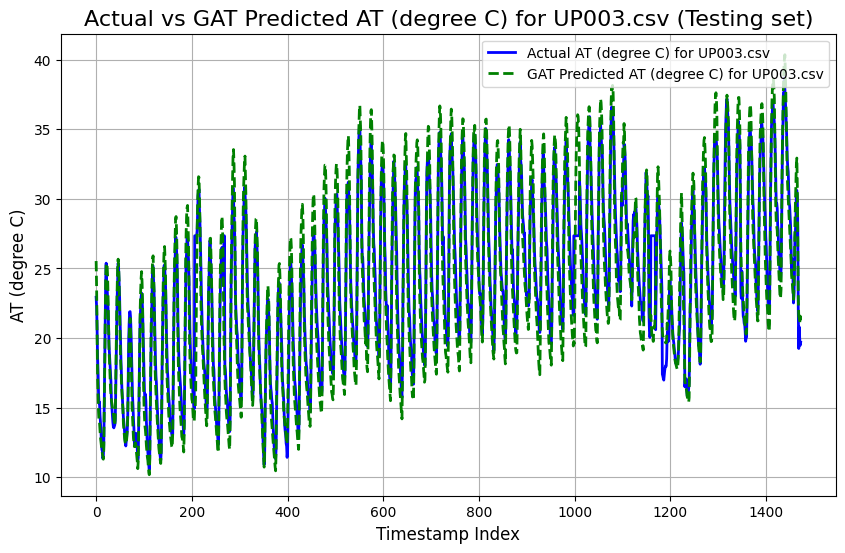

UP004.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4166
Mean Squared Error (MSE): 3.0914
Root Mean Squared Error (RMSE): 1.7582
Pearson Correlation Coefficient: 0.9657
R-squared (R²): 0.9099

----------------------------------------



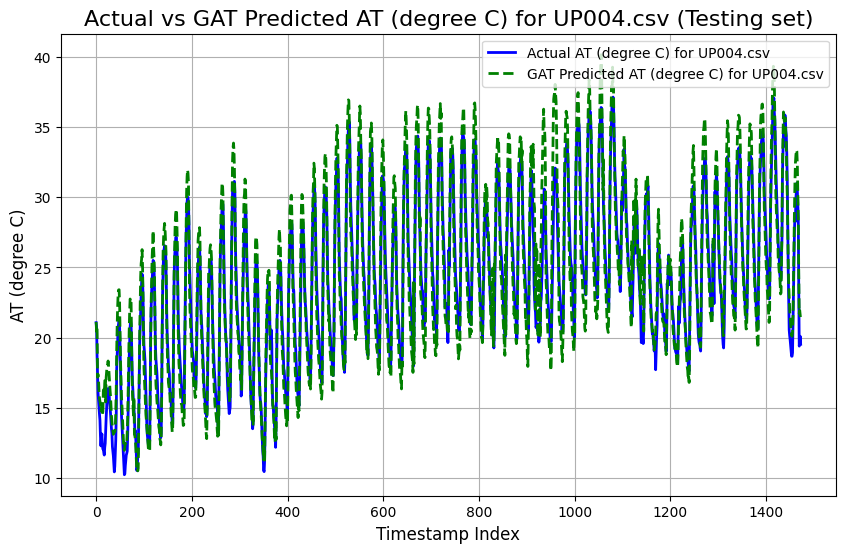

UP008.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 5.5835
Mean Squared Error (MSE): 45.9197
Root Mean Squared Error (RMSE): 6.7764
Pearson Correlation Coefficient: 0.7373
R-squared (R²): 0.0451

----------------------------------------



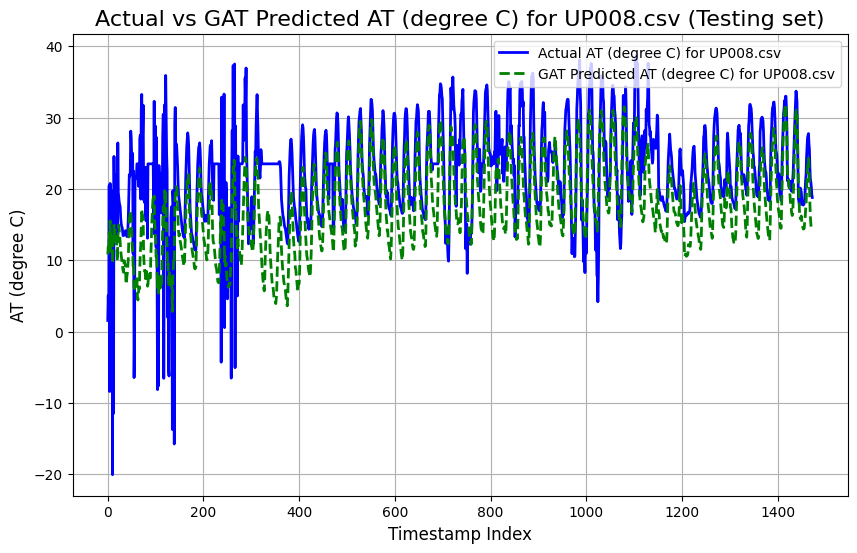

UP009.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1283
Mean Squared Error (MSE): 3.3705
Root Mean Squared Error (RMSE): 1.8359
Pearson Correlation Coefficient: 0.9185
R-squared (R²): 0.8353

----------------------------------------



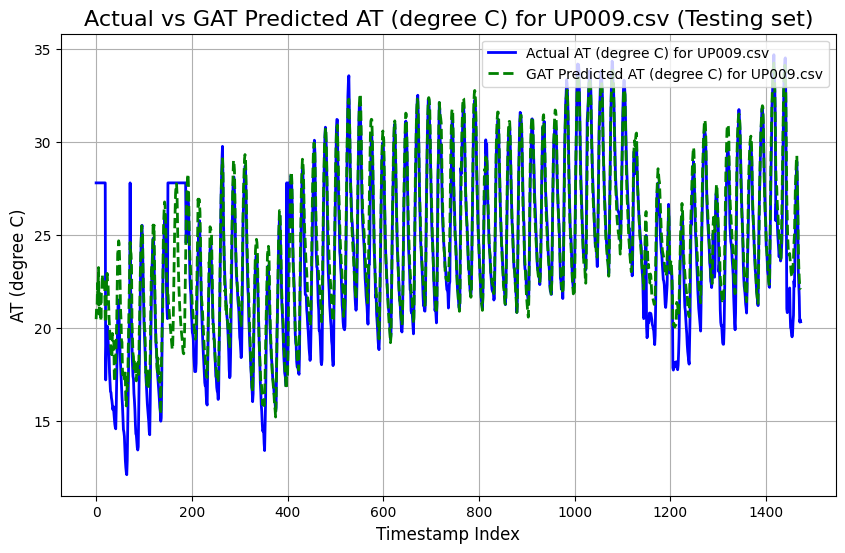

UP012.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4998
Mean Squared Error (MSE): 4.8071
Root Mean Squared Error (RMSE): 2.1925
Pearson Correlation Coefficient: 0.9451
R-squared (R²): 0.8925

----------------------------------------



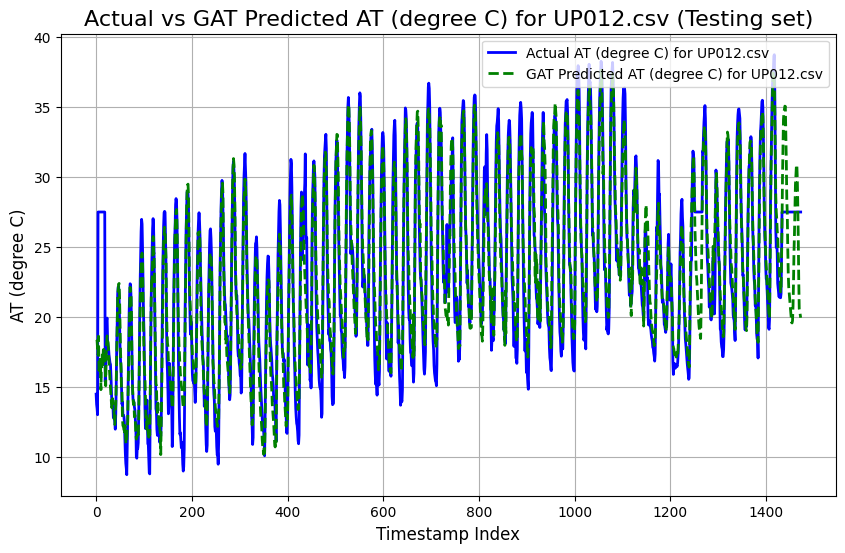

UP014.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 5.6162
Mean Squared Error (MSE): 35.3509
Root Mean Squared Error (RMSE): 5.9457
Pearson Correlation Coefficient: 0.9576
R-squared (R²): 0.4198

----------------------------------------



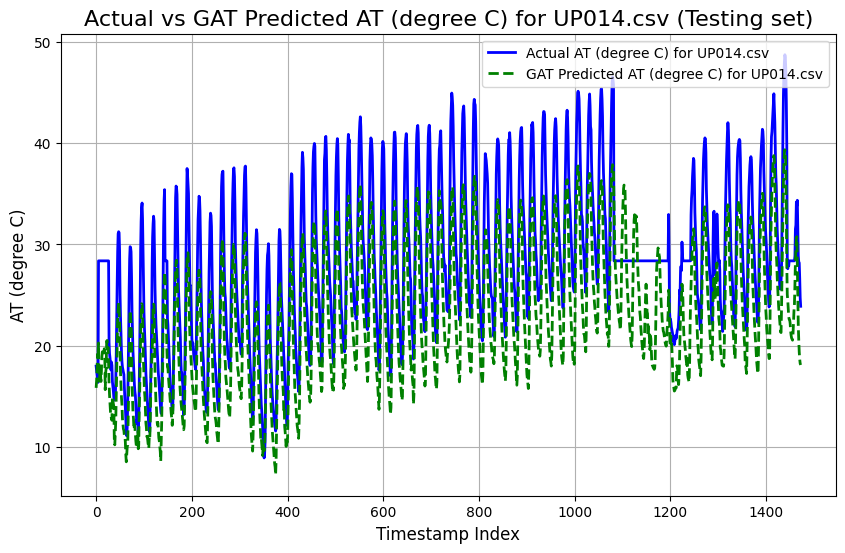

UP016.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 4.4275
Mean Squared Error (MSE): 22.8681
Root Mean Squared Error (RMSE): 4.7821
Pearson Correlation Coefficient: 0.9674
R-squared (R²): 0.6161

----------------------------------------



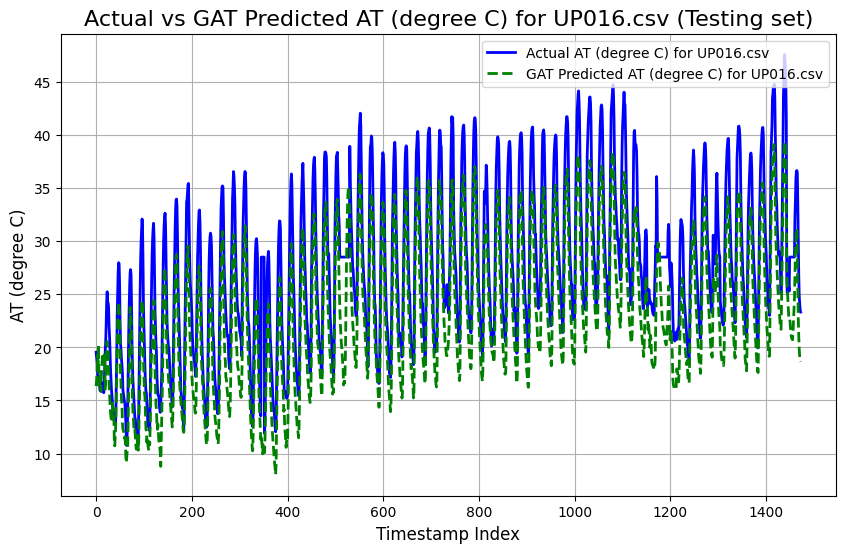

UP017.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8259
Mean Squared Error (MSE): 1.2974
Root Mean Squared Error (RMSE): 1.1390
Pearson Correlation Coefficient: 0.9586
R-squared (R²): 0.9017

----------------------------------------



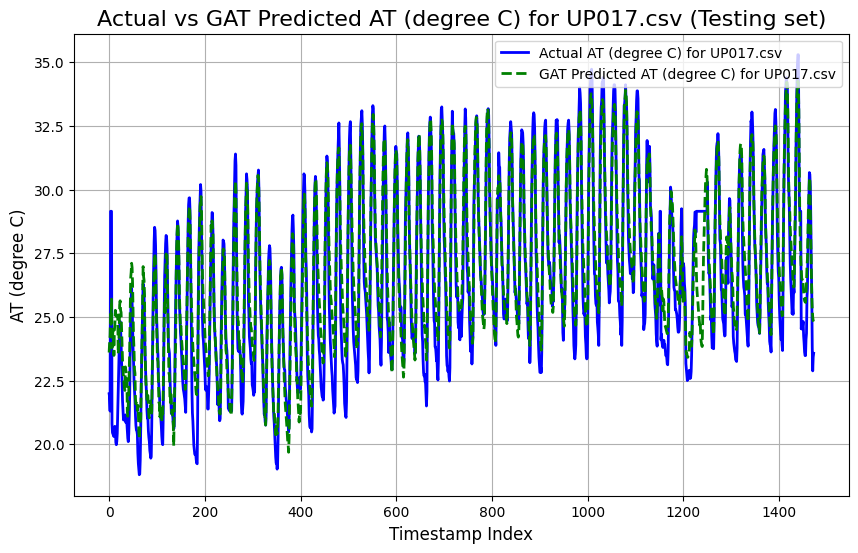

UP018.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 8.0841
Mean Squared Error (MSE): 101.8429
Root Mean Squared Error (RMSE): 10.0917
Pearson Correlation Coefficient: -0.6750
R-squared (R²): -2.6018

----------------------------------------



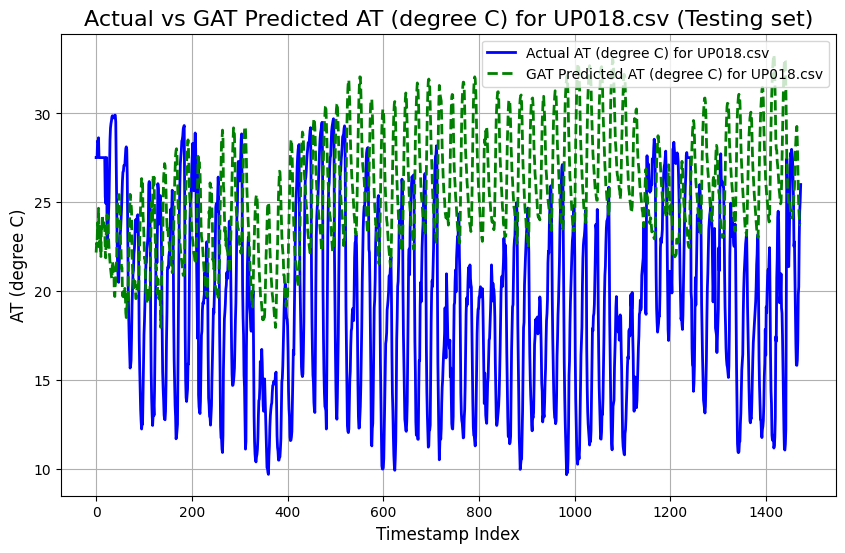

UP019.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.9397
Mean Squared Error (MSE): 4.9830
Root Mean Squared Error (RMSE): 2.2323
Pearson Correlation Coefficient: 0.9429
R-squared (R²): 0.6491

----------------------------------------



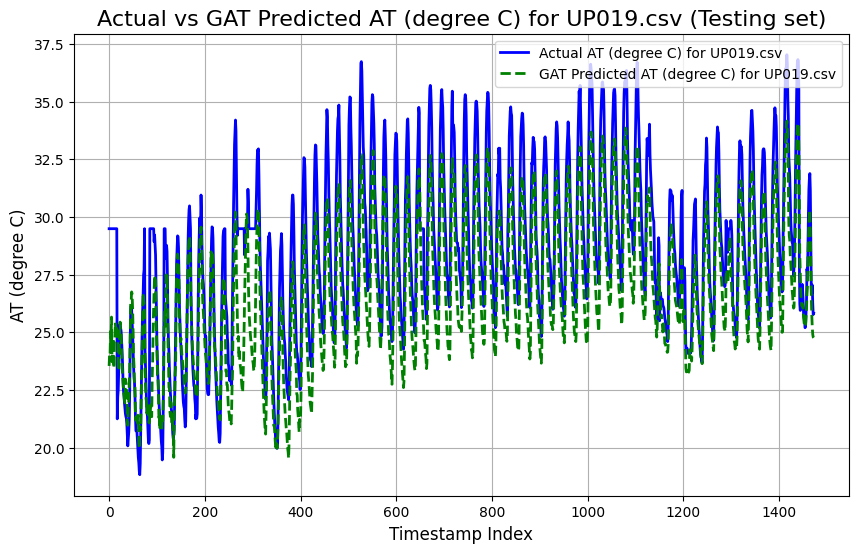

UP020.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0329
Mean Squared Error (MSE): 2.1855
Root Mean Squared Error (RMSE): 1.4783
Pearson Correlation Coefficient: 0.9573
R-squared (R²): 0.8917

----------------------------------------



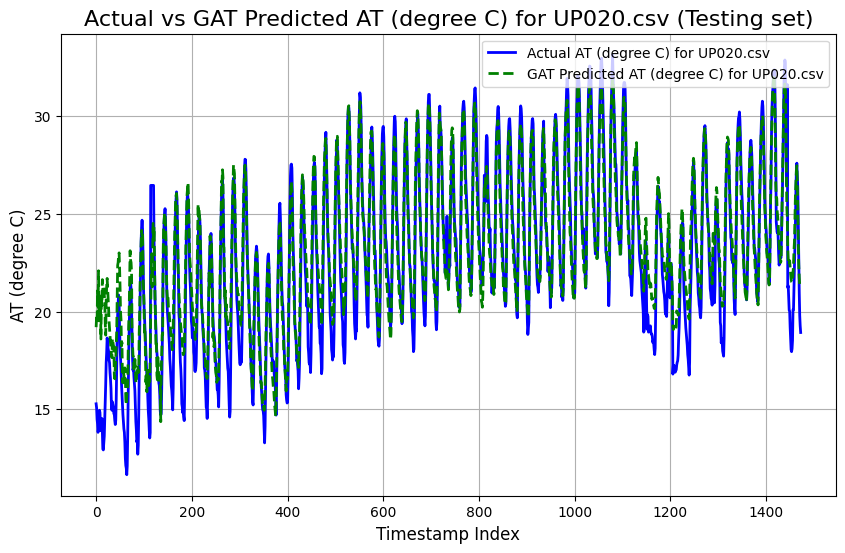

UP021.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.0455
Mean Squared Error (MSE): 13.6599
Root Mean Squared Error (RMSE): 3.6959
Pearson Correlation Coefficient: 0.8717
R-squared (R²): 0.2630

----------------------------------------



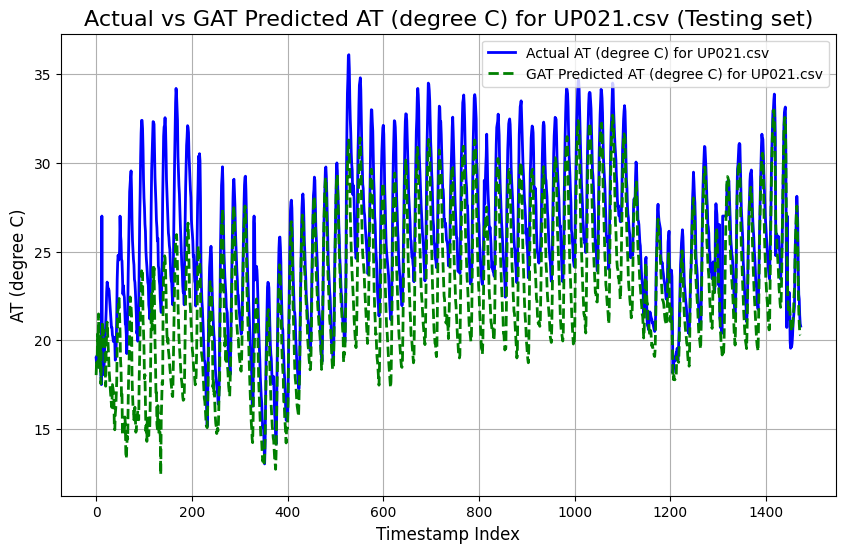

UP022.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0309
Mean Squared Error (MSE): 2.3365
Root Mean Squared Error (RMSE): 1.5286
Pearson Correlation Coefficient: 0.9541
R-squared (R²): 0.8801

----------------------------------------



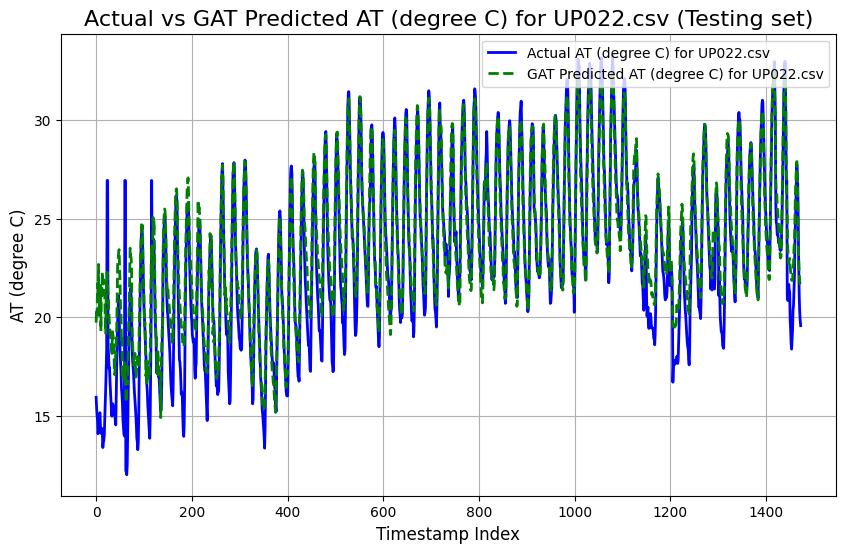

UP023.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.6115
Mean Squared Error (MSE): 4.2727
Root Mean Squared Error (RMSE): 2.0670
Pearson Correlation Coefficient: 0.9214
R-squared (R²): 0.7597

----------------------------------------



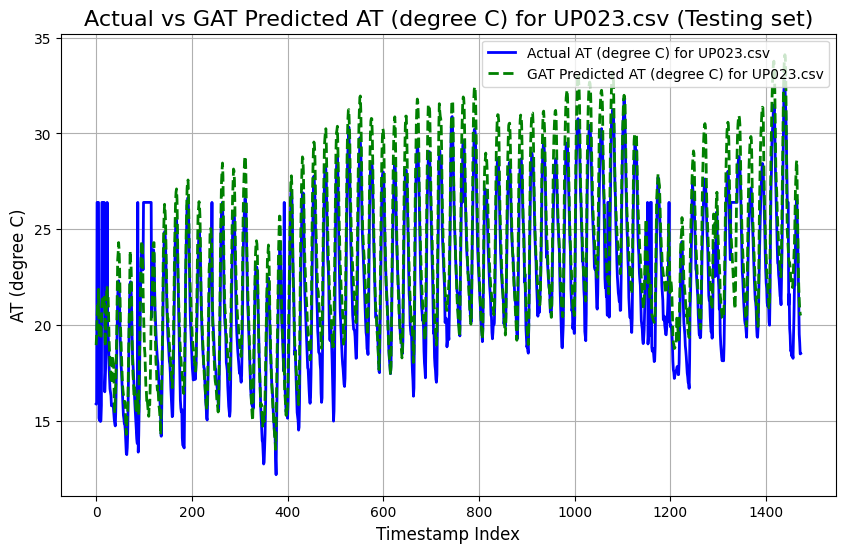

UP024.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.5333
Mean Squared Error (MSE): 16.7576
Root Mean Squared Error (RMSE): 4.0936
Pearson Correlation Coefficient: 0.9607
R-squared (R²): -0.8726

----------------------------------------



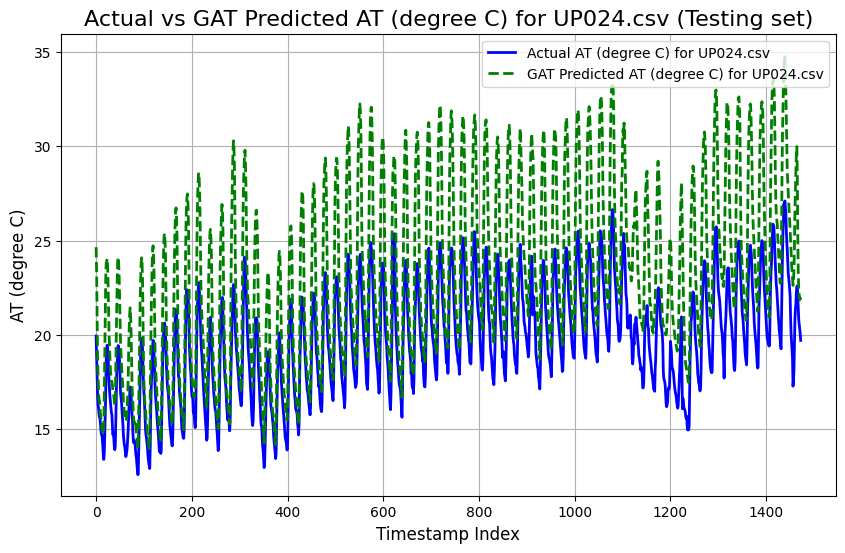

UP025.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0845
Mean Squared Error (MSE): 2.5180
Root Mean Squared Error (RMSE): 1.5868
Pearson Correlation Coefficient: 0.9565
R-squared (R²): 0.8919

----------------------------------------



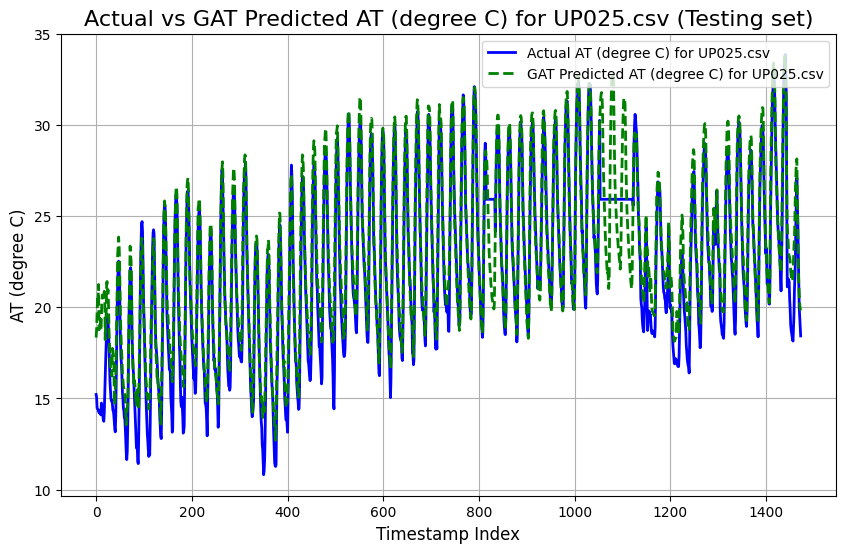

UP026.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.7539
Mean Squared Error (MSE): 5.4579
Root Mean Squared Error (RMSE): 2.3362
Pearson Correlation Coefficient: 0.9073
R-squared (R²): 0.7828

----------------------------------------



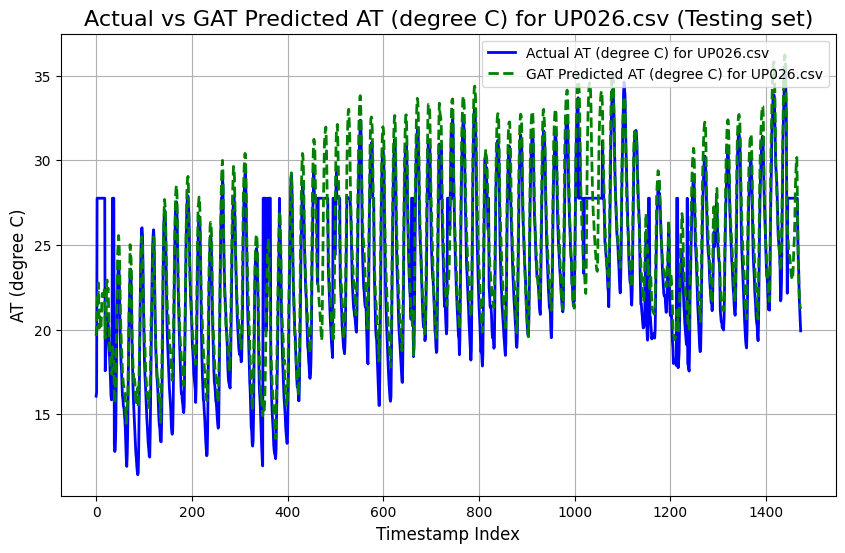

UP028.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3285
Mean Squared Error (MSE): 3.6059
Root Mean Squared Error (RMSE): 1.8989
Pearson Correlation Coefficient: 0.9716
R-squared (R²): 0.9381

----------------------------------------



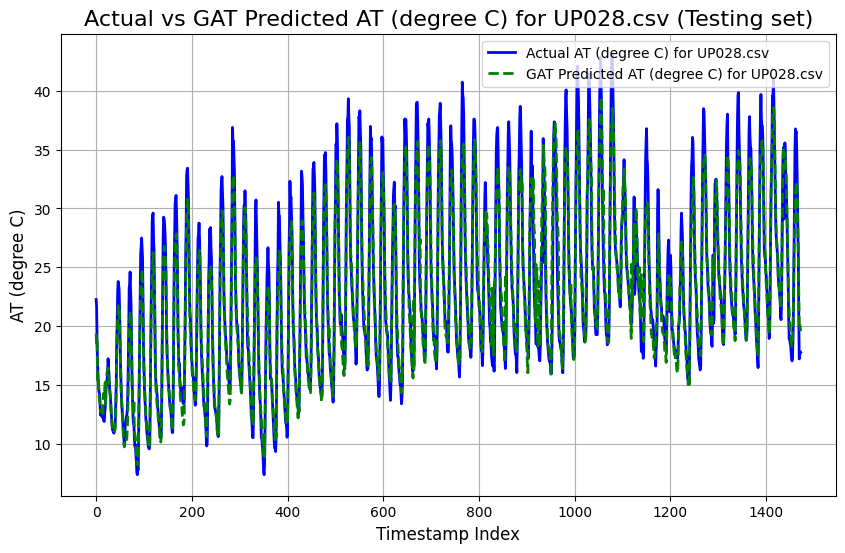

UP029.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.7109
Mean Squared Error (MSE): 1.0552
Root Mean Squared Error (RMSE): 1.0272
Pearson Correlation Coefficient: 0.9869
R-squared (R²): 0.9715

----------------------------------------



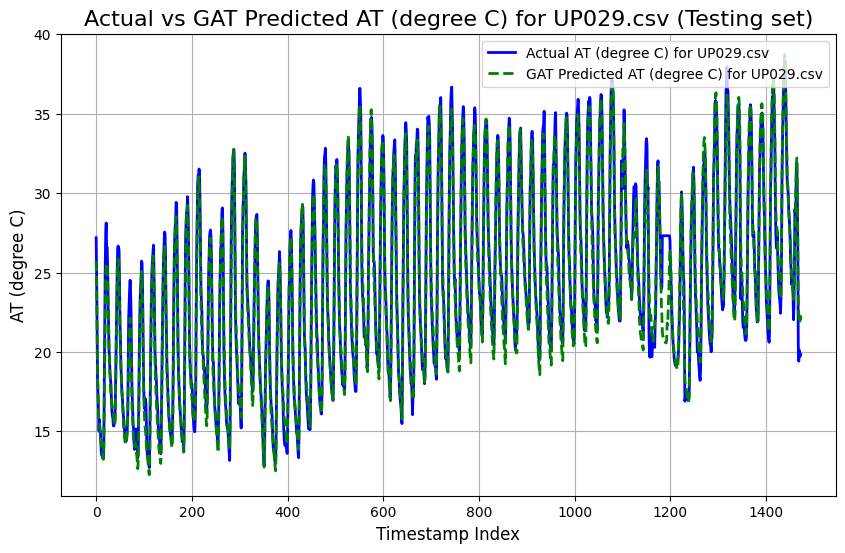

UP030.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1045
Mean Squared Error (MSE): 2.2713
Root Mean Squared Error (RMSE): 1.5071
Pearson Correlation Coefficient: 0.9751
R-squared (R²): 0.9484

----------------------------------------



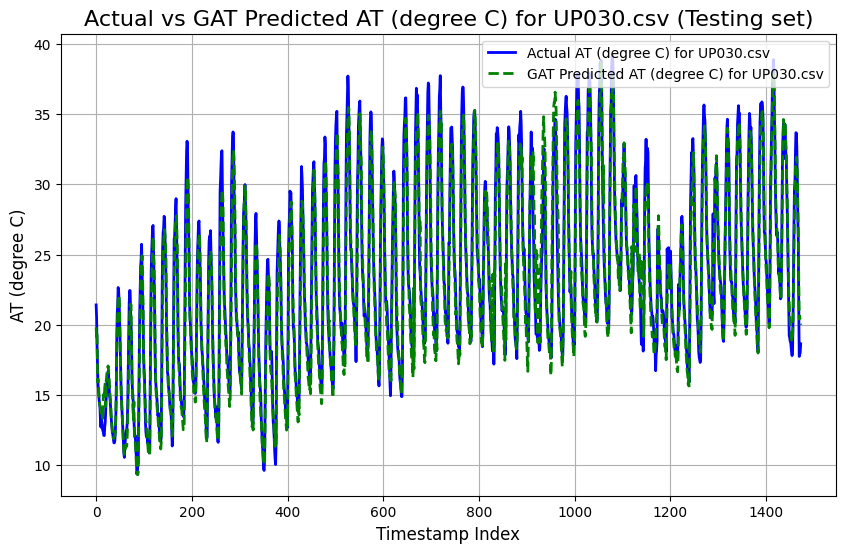

UP031.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4960
Mean Squared Error (MSE): 3.6576
Root Mean Squared Error (RMSE): 1.9125
Pearson Correlation Coefficient: 0.9636
R-squared (R²): 0.9250

----------------------------------------



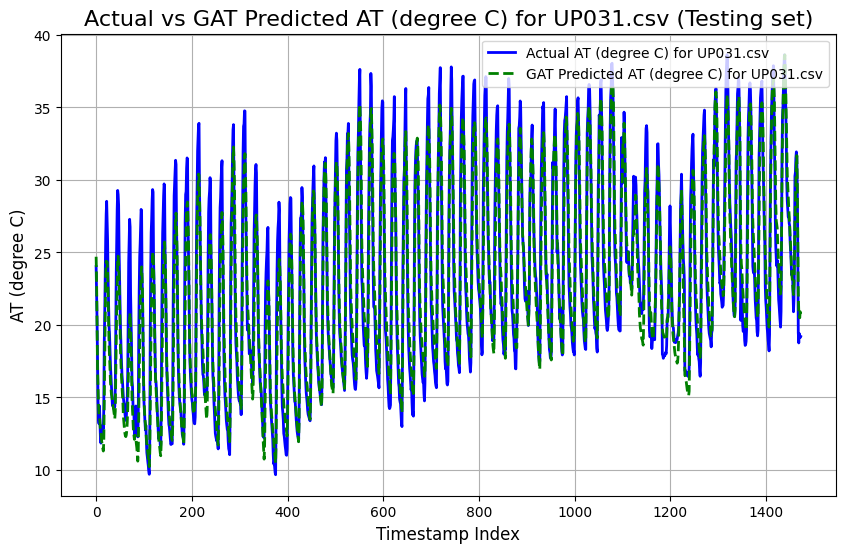

UP032.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1114
Mean Squared Error (MSE): 2.0141
Root Mean Squared Error (RMSE): 1.4192
Pearson Correlation Coefficient: 0.9704
R-squared (R²): 0.9413

----------------------------------------



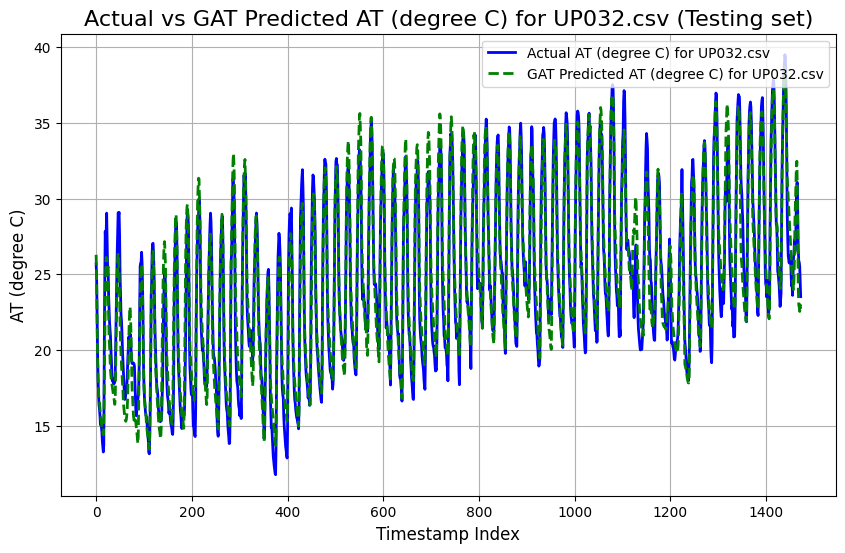

UP033.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.7117
Mean Squared Error (MSE): 0.9313
Root Mean Squared Error (RMSE): 0.9650
Pearson Correlation Coefficient: 0.9885
R-squared (R²): 0.9744

----------------------------------------



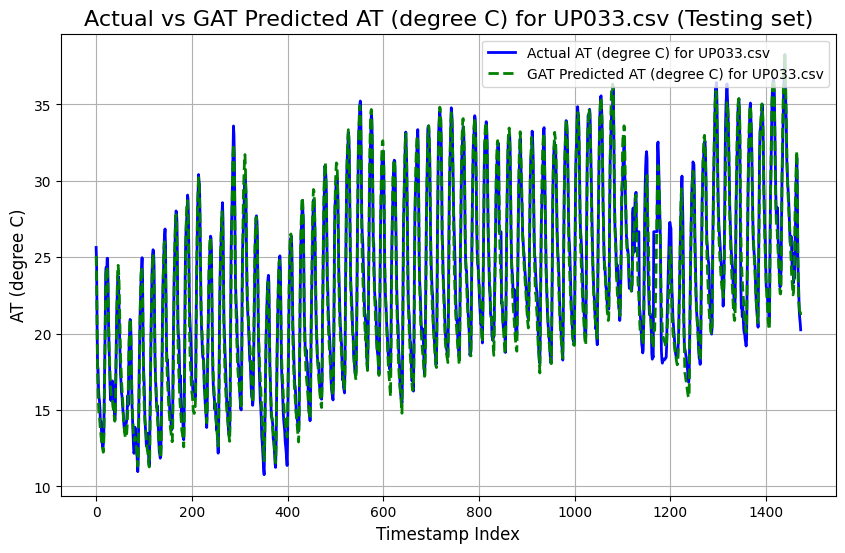

UP034.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 4.1105
Mean Squared Error (MSE): 26.2958
Root Mean Squared Error (RMSE): 5.1279
Pearson Correlation Coefficient: 0.8813
R-squared (R²): -0.1618

----------------------------------------



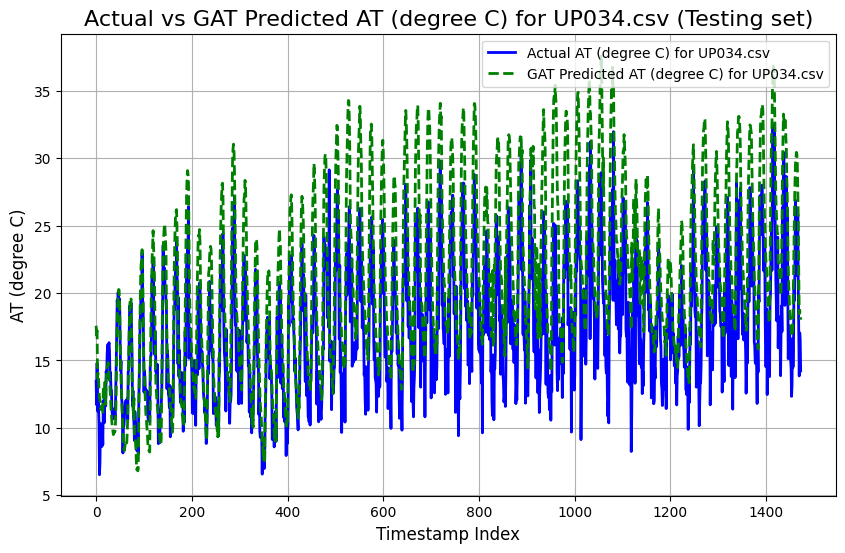

UP035.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2230
Mean Squared Error (MSE): 3.6421
Root Mean Squared Error (RMSE): 1.9084
Pearson Correlation Coefficient: 0.9577
R-squared (R²): 0.9155

----------------------------------------



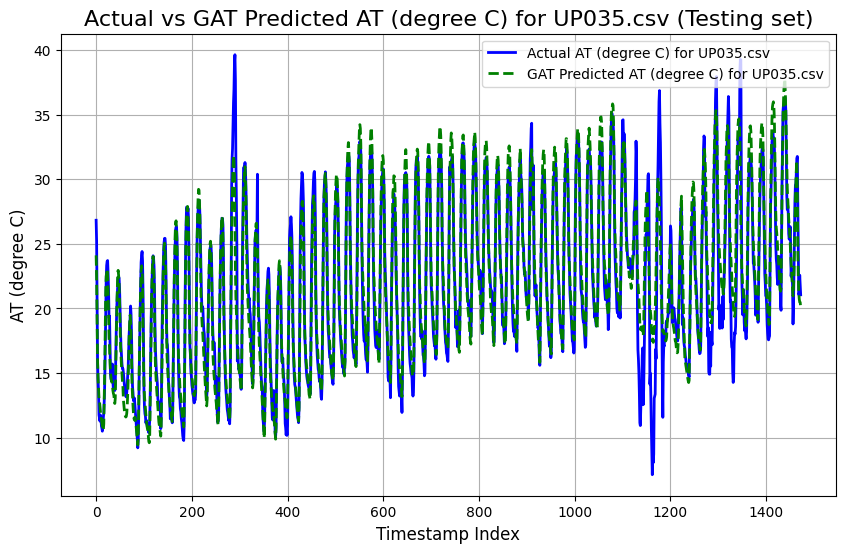

UP036.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1421
Mean Squared Error (MSE): 2.9318
Root Mean Squared Error (RMSE): 1.7123
Pearson Correlation Coefficient: 0.9623
R-squared (R²): 0.9121

----------------------------------------



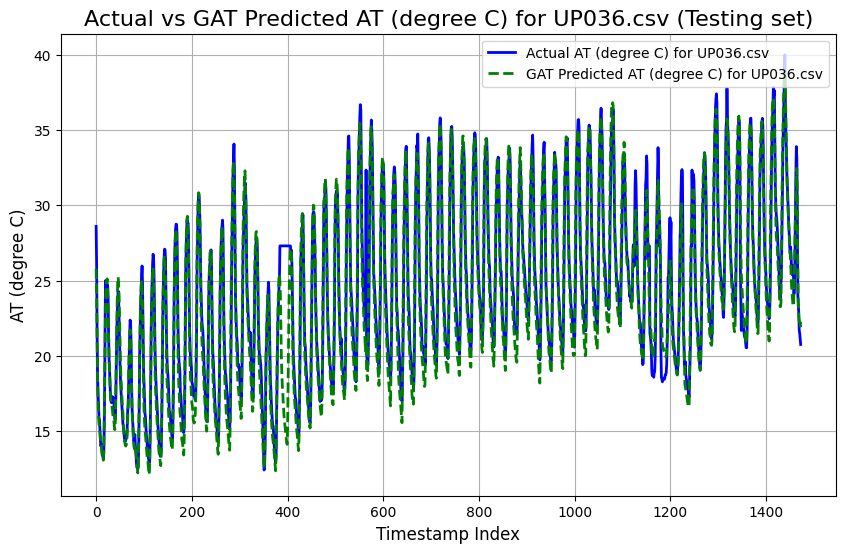

UP037.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1456
Mean Squared Error (MSE): 2.8052
Root Mean Squared Error (RMSE): 1.6749
Pearson Correlation Coefficient: 0.9643
R-squared (R²): 0.9292

----------------------------------------



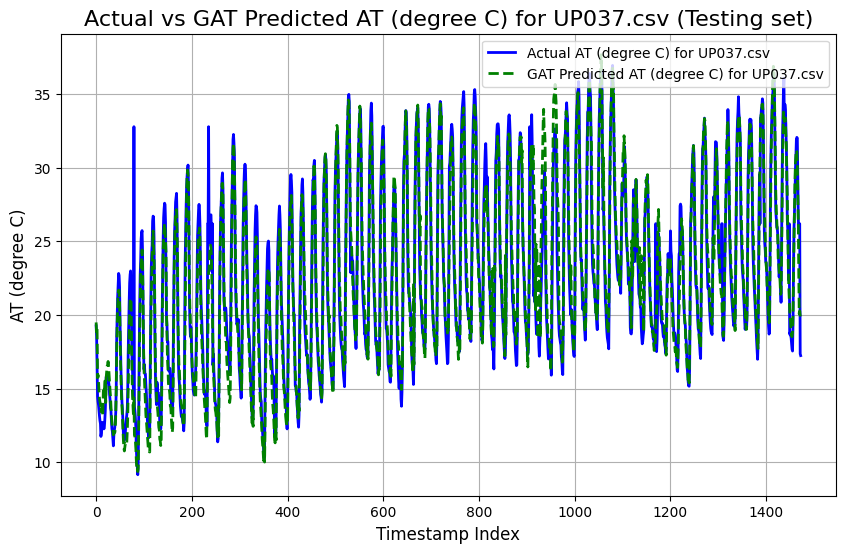

UP038.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.7760
Mean Squared Error (MSE): 1.0612
Root Mean Squared Error (RMSE): 1.0302
Pearson Correlation Coefficient: 0.9862
R-squared (R²): 0.9676

----------------------------------------



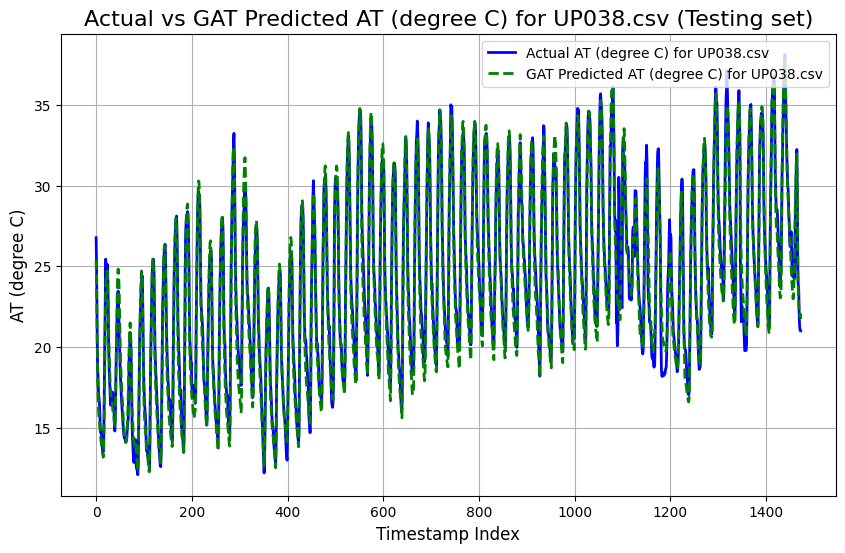

UP039.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4637
Mean Squared Error (MSE): 3.5501
Root Mean Squared Error (RMSE): 1.8842
Pearson Correlation Coefficient: 0.9681
R-squared (R²): 0.9316

----------------------------------------



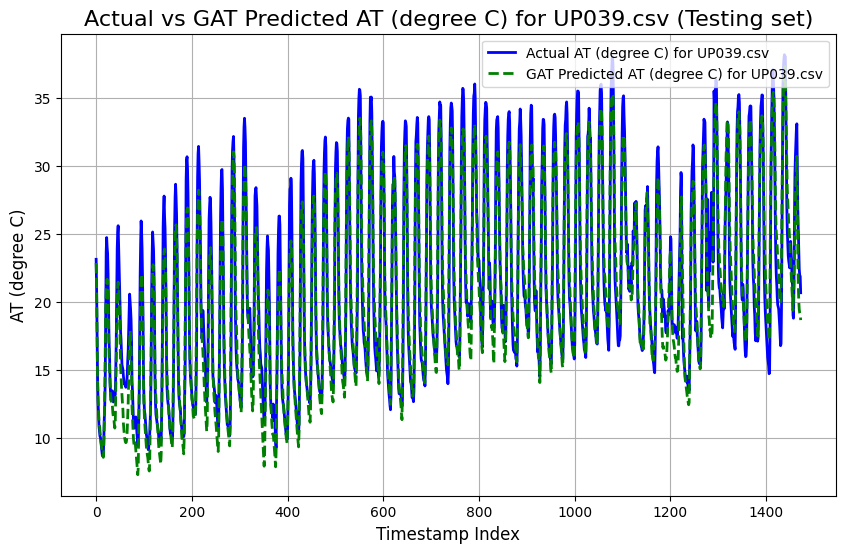

UP040.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1471
Mean Squared Error (MSE): 2.0497
Root Mean Squared Error (RMSE): 1.4317
Pearson Correlation Coefficient: 0.9779
R-squared (R²): 0.9517

----------------------------------------



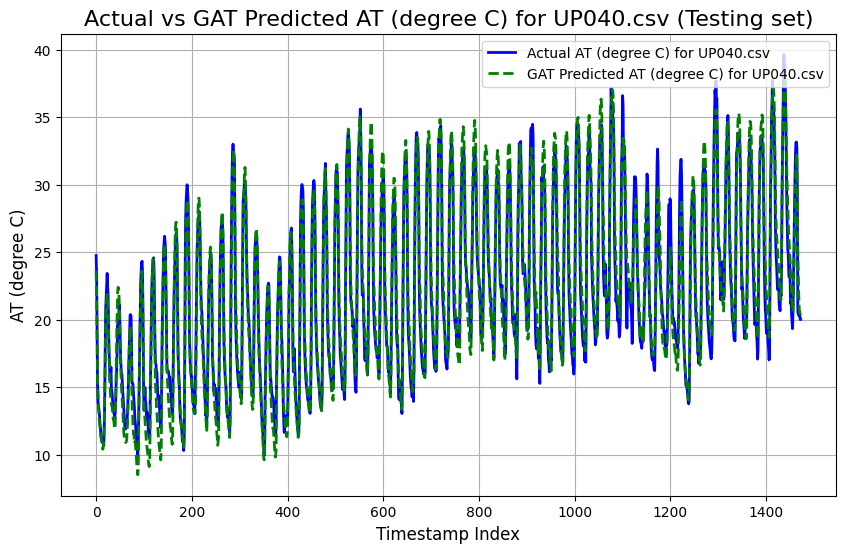

UP041.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2639
Mean Squared Error (MSE): 3.1574
Root Mean Squared Error (RMSE): 1.7769
Pearson Correlation Coefficient: 0.9600
R-squared (R²): 0.9042

----------------------------------------



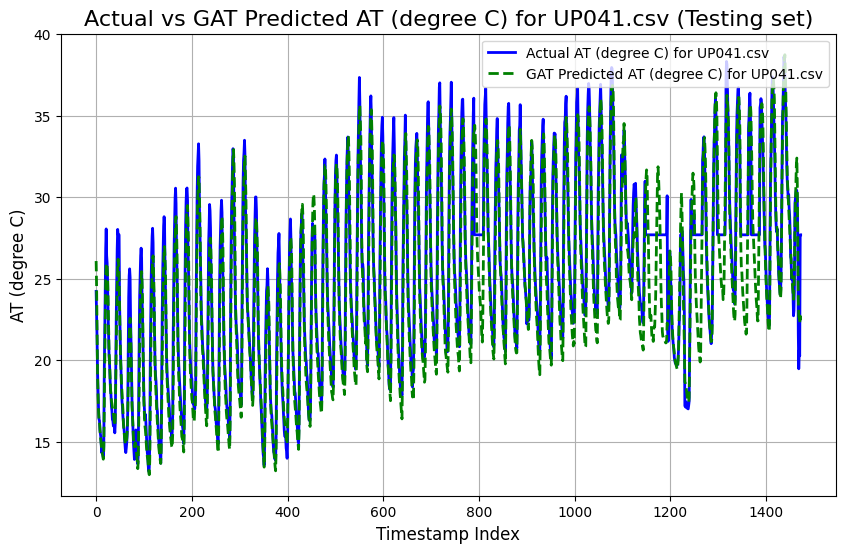

UP042.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4098
Mean Squared Error (MSE): 5.6665
Root Mean Squared Error (RMSE): 2.3804
Pearson Correlation Coefficient: 0.9167
R-squared (R²): 0.8271

----------------------------------------



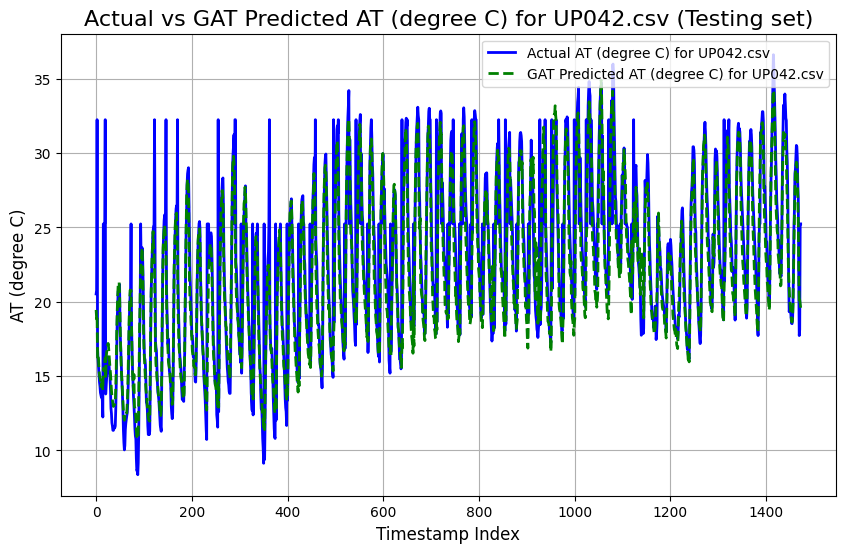

UP043.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.6641
Mean Squared Error (MSE): 4.1429
Root Mean Squared Error (RMSE): 2.0354
Pearson Correlation Coefficient: 0.9774
R-squared (R²): 0.8867

----------------------------------------



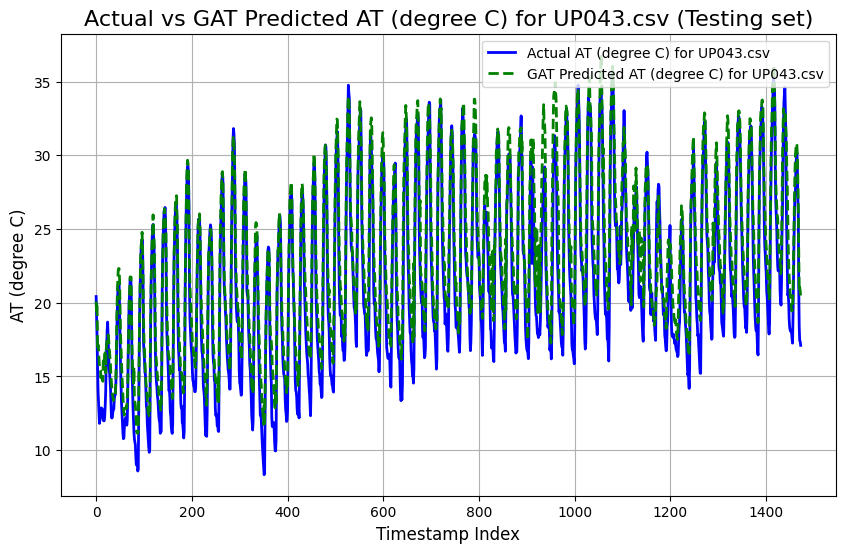

UP044.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.9371
Mean Squared Error (MSE): 1.8608
Root Mean Squared Error (RMSE): 1.3641
Pearson Correlation Coefficient: 0.9820
R-squared (R²): 0.9576

----------------------------------------



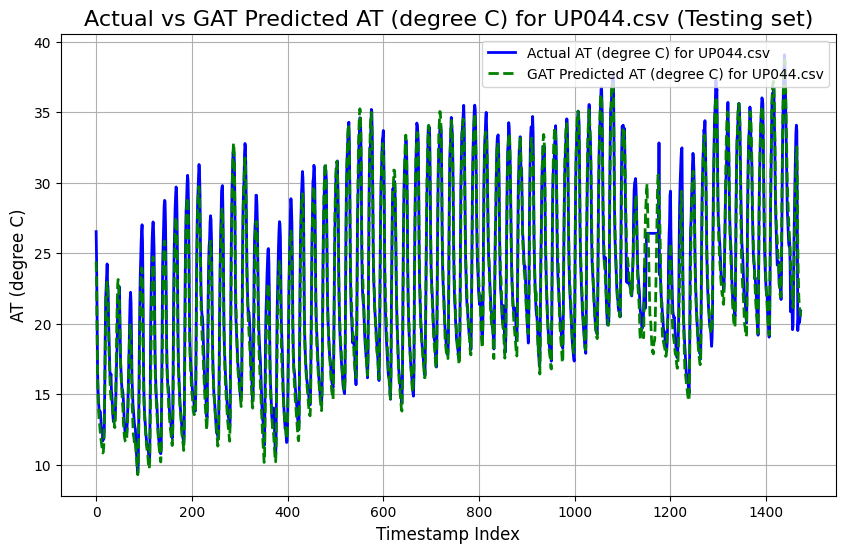

UP046.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3583
Mean Squared Error (MSE): 3.2613
Root Mean Squared Error (RMSE): 1.8059
Pearson Correlation Coefficient: 0.9639
R-squared (R²): 0.9086

----------------------------------------



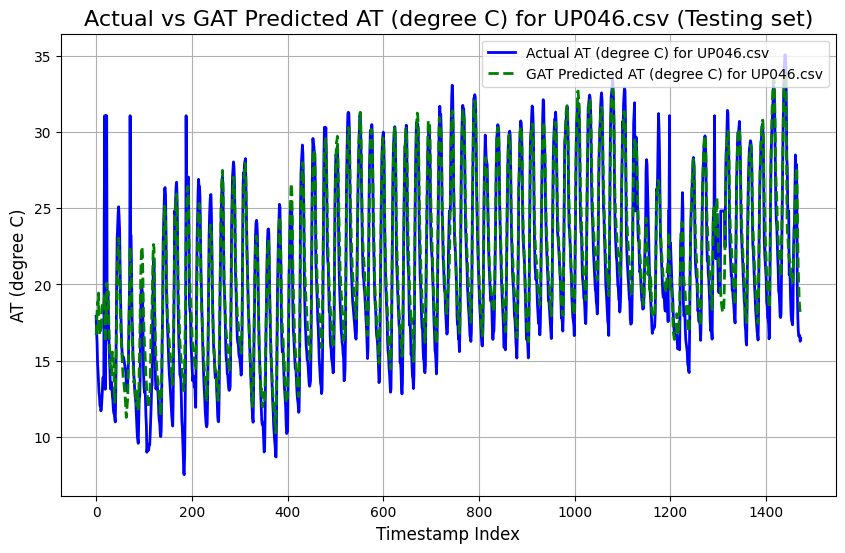

UP048.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.5201
Mean Squared Error (MSE): 3.8750
Root Mean Squared Error (RMSE): 1.9685
Pearson Correlation Coefficient: 0.9586
R-squared (R²): 0.8943

----------------------------------------



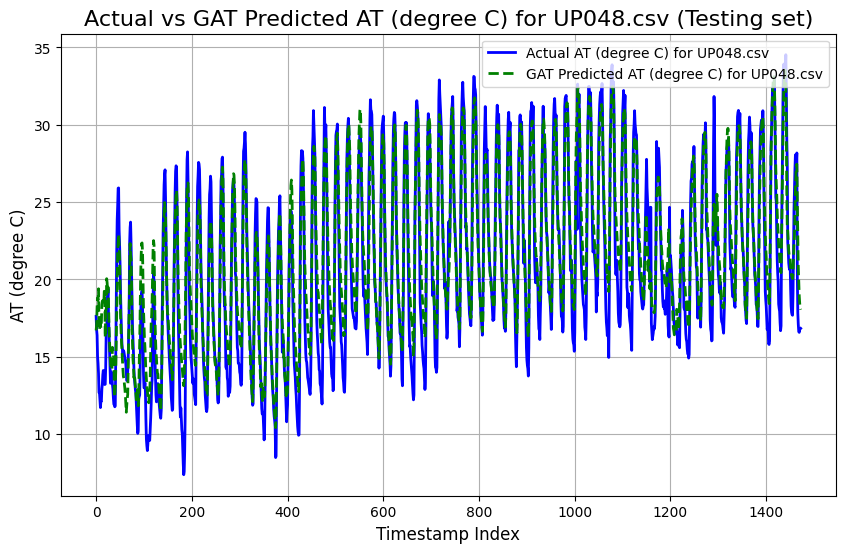

UP049.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4168
Mean Squared Error (MSE): 3.4167
Root Mean Squared Error (RMSE): 1.8484
Pearson Correlation Coefficient: 0.9533
R-squared (R²): 0.8889

----------------------------------------



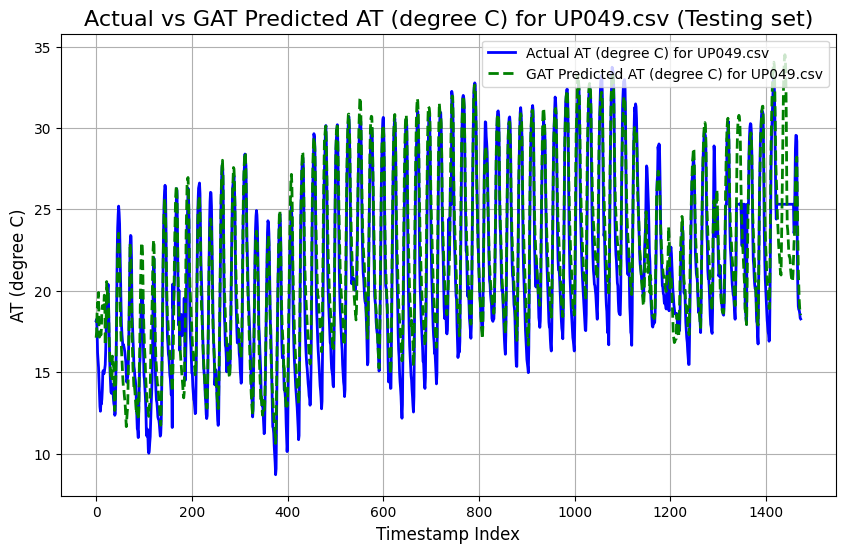

UP050.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 2.6729
Mean Squared Error (MSE): 10.4230
Root Mean Squared Error (RMSE): 3.2285
Pearson Correlation Coefficient: 0.7471
R-squared (R²): 0.5230

----------------------------------------



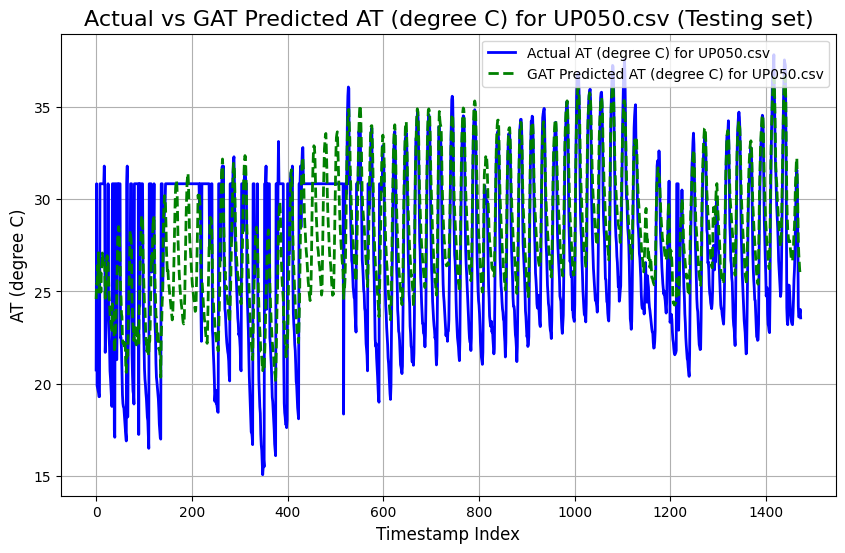

UP051.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.4935
Mean Squared Error (MSE): 44.6451
Root Mean Squared Error (RMSE): 6.6817
Pearson Correlation Coefficient: 0.6166
R-squared (R²): 0.3406

----------------------------------------



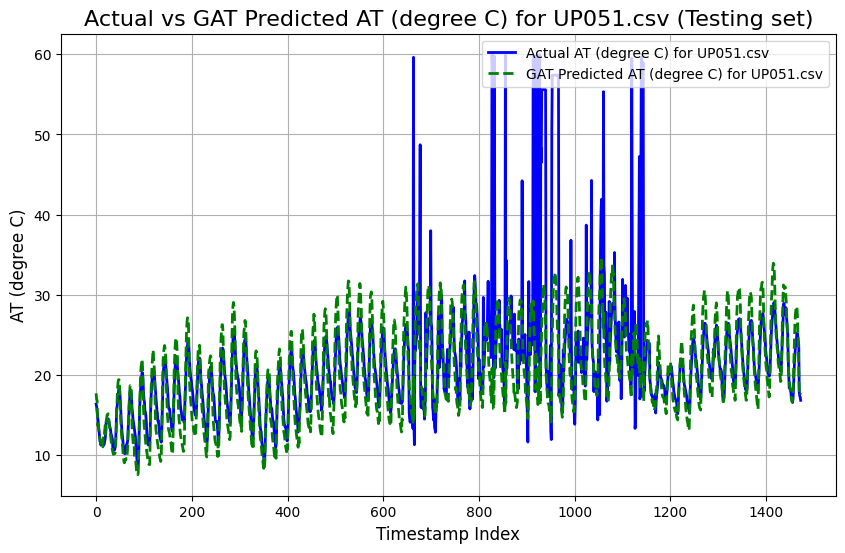

UP052.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4596
Mean Squared Error (MSE): 3.5007
Root Mean Squared Error (RMSE): 1.8710
Pearson Correlation Coefficient: 0.9626
R-squared (R²): 0.9034

----------------------------------------



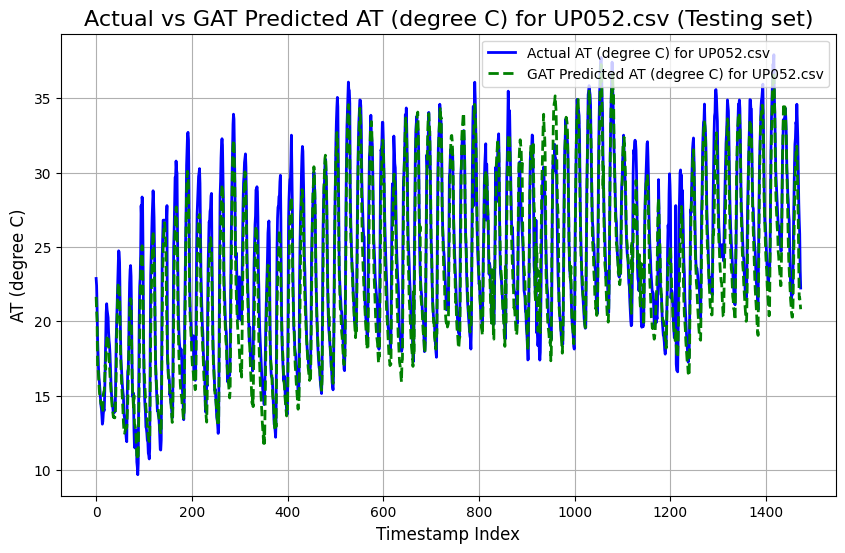

Train GNN Imputed HourMean.csv
CSV file 'Train GNN Imputed HourMean.csv' created successfully.
Test GNN Imputed HourMean.csv
CSV file 'Test GNN Imputed HourMean.csv' created successfully.
UP002.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2599
Mean Squared Error (MSE): 3.3805
Root Mean Squared Error (RMSE): 1.8386
Pearson Correlation Coefficient: 0.9724
R-squared (R²): 0.9387

----------------------------------------



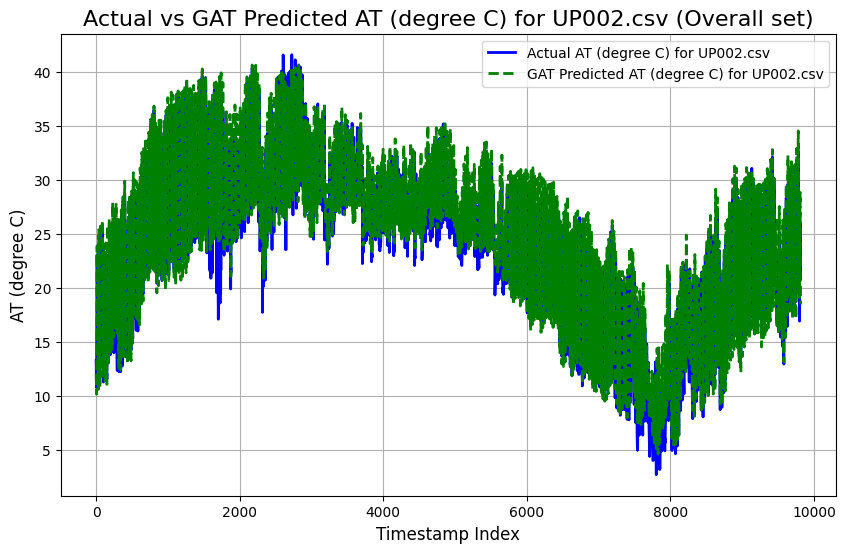

UP003.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3557
Mean Squared Error (MSE): 3.7950
Root Mean Squared Error (RMSE): 1.9481
Pearson Correlation Coefficient: 0.9770
R-squared (R²): 0.9479

----------------------------------------



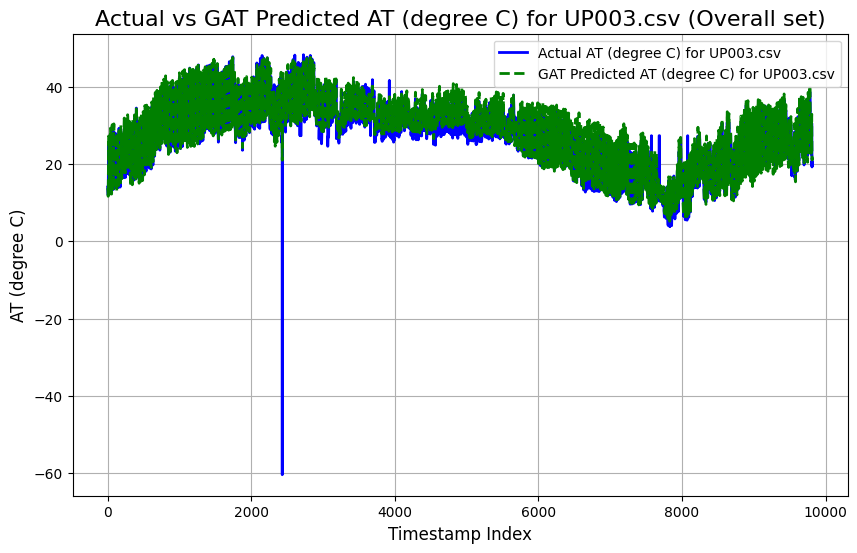

UP004.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5182
Mean Squared Error (MSE): 3.7622
Root Mean Squared Error (RMSE): 1.9396
Pearson Correlation Coefficient: 0.9782
R-squared (R²): 0.9521

----------------------------------------



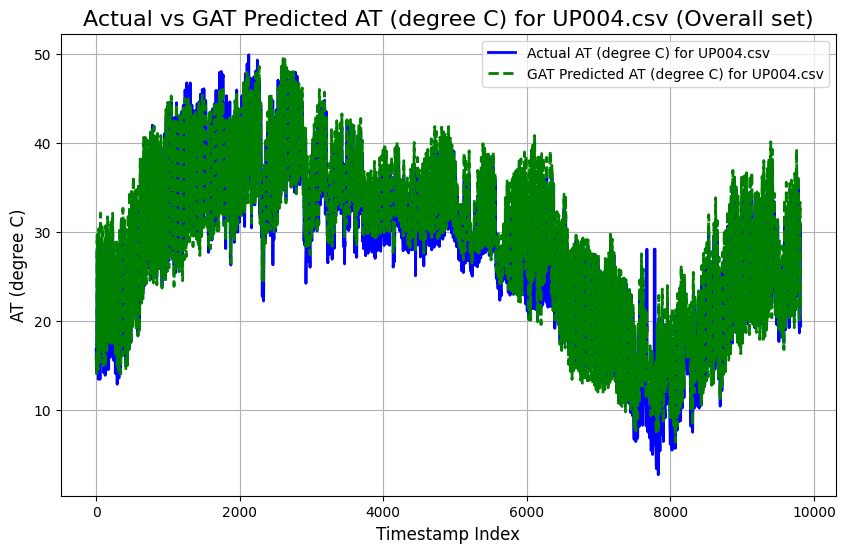

UP008.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 5.7513
Mean Squared Error (MSE): 65.1983
Root Mean Squared Error (RMSE): 8.0745
Pearson Correlation Coefficient: 0.7521
R-squared (R²): 0.5195

----------------------------------------



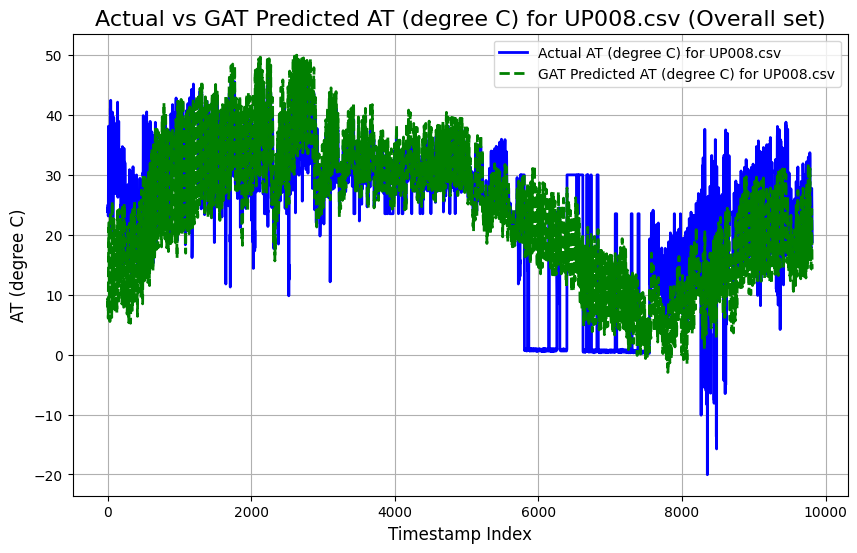

UP009.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2816
Mean Squared Error (MSE): 3.3750
Root Mean Squared Error (RMSE): 1.8371
Pearson Correlation Coefficient: 0.9717
R-squared (R²): 0.9397

----------------------------------------



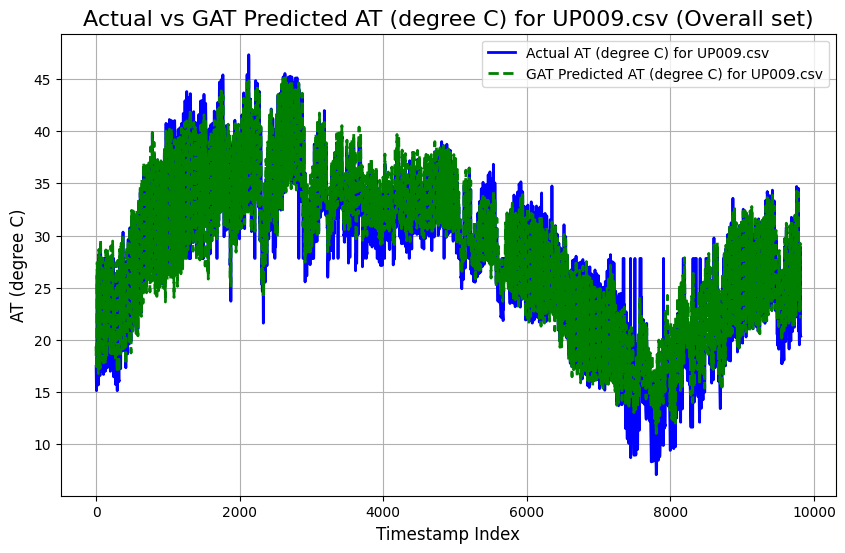

UP012.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.6668
Mean Squared Error (MSE): 7.2898
Root Mean Squared Error (RMSE): 2.7000
Pearson Correlation Coefficient: 0.9653
R-squared (R²): 0.9282

----------------------------------------



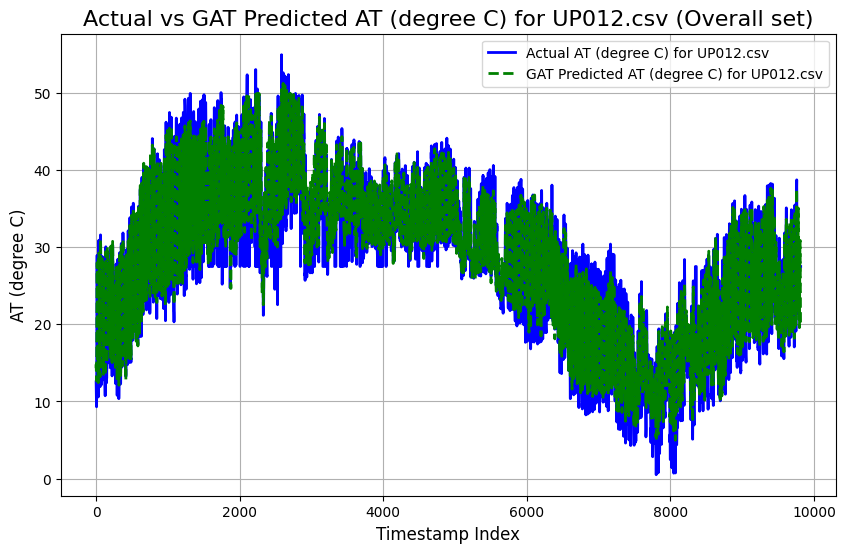

UP014.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.4972
Mean Squared Error (MSE): 19.0095
Root Mean Squared Error (RMSE): 4.3600
Pearson Correlation Coefficient: 0.9234
R-squared (R²): 0.8464

----------------------------------------



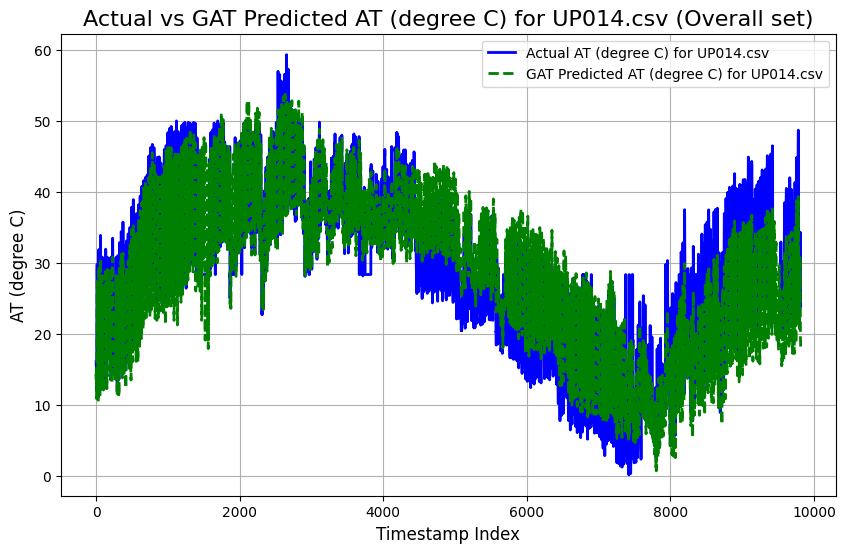

UP016.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.2155
Mean Squared Error (MSE): 17.0394
Root Mean Squared Error (RMSE): 4.1279
Pearson Correlation Coefficient: 0.9316
R-squared (R²): 0.8636

----------------------------------------



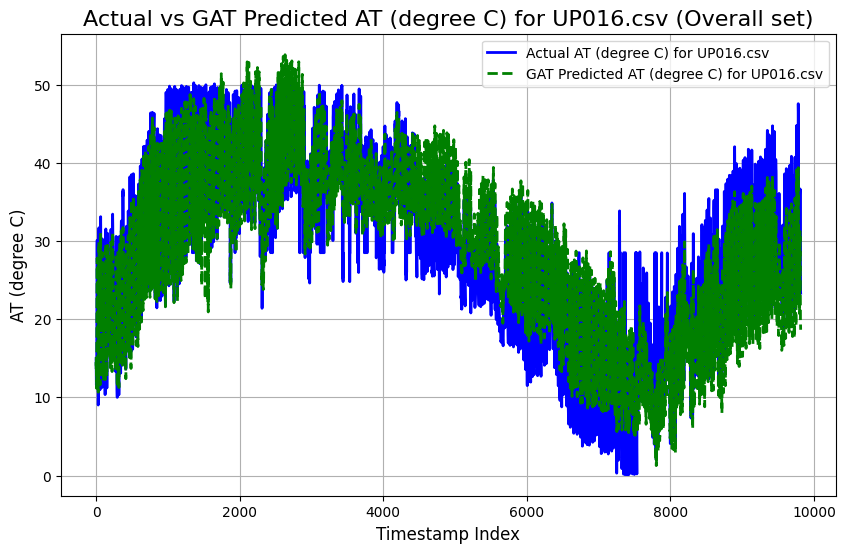

UP017.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9029
Mean Squared Error (MSE): 1.2689
Root Mean Squared Error (RMSE): 1.1265
Pearson Correlation Coefficient: 0.9819
R-squared (R²): 0.9590

----------------------------------------



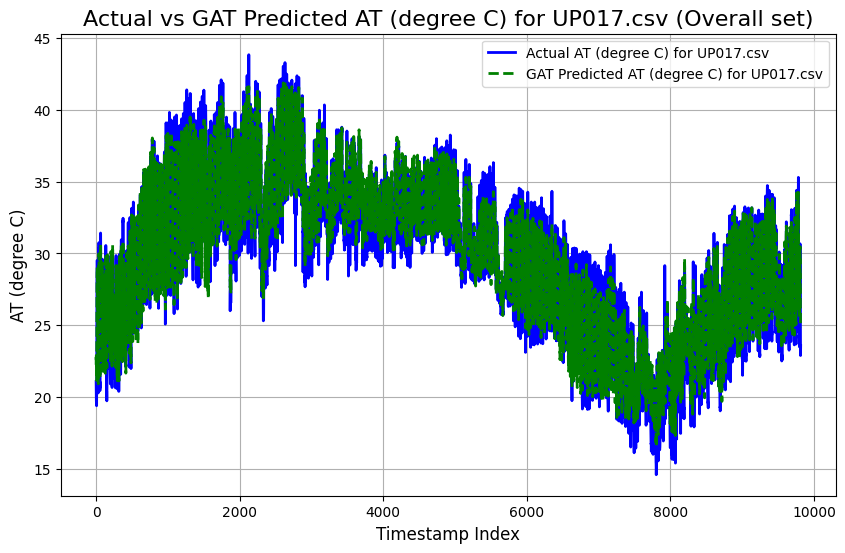

UP018.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 4.9140
Mean Squared Error (MSE): 48.9393
Root Mean Squared Error (RMSE): 6.9957
Pearson Correlation Coefficient: 0.4752
R-squared (R²): 0.0658

----------------------------------------



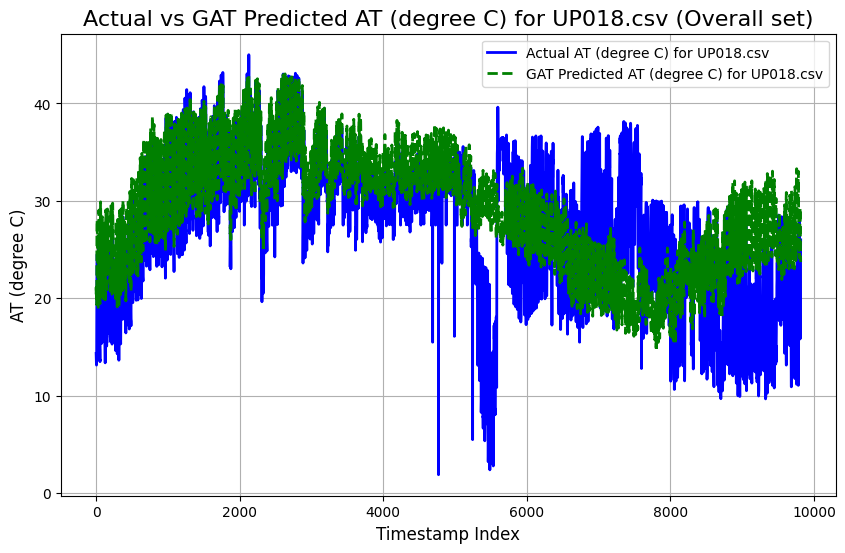

UP019.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.8261
Mean Squared Error (MSE): 6.8000
Root Mean Squared Error (RMSE): 2.6077
Pearson Correlation Coefficient: 0.8915
R-squared (R²): 0.7882

----------------------------------------



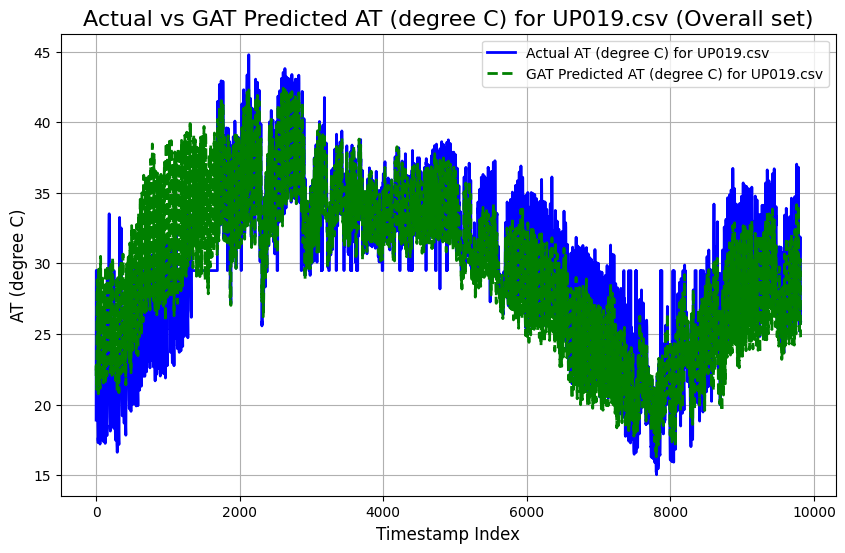

UP020.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2631
Mean Squared Error (MSE): 2.6309
Root Mean Squared Error (RMSE): 1.6220
Pearson Correlation Coefficient: 0.9779
R-squared (R²): 0.9508

----------------------------------------



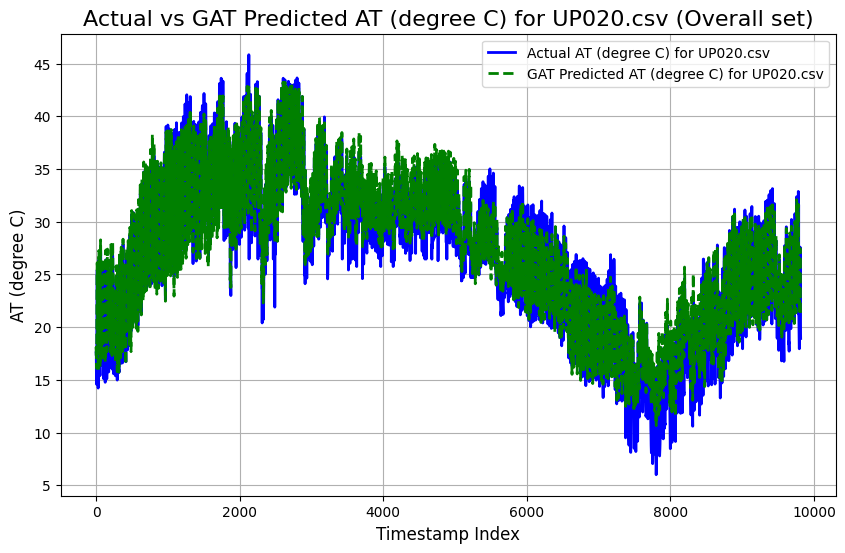

UP021.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.5624
Mean Squared Error (MSE): 22.1129
Root Mean Squared Error (RMSE): 4.7024
Pearson Correlation Coefficient: 0.8346
R-squared (R²): 0.6775

----------------------------------------



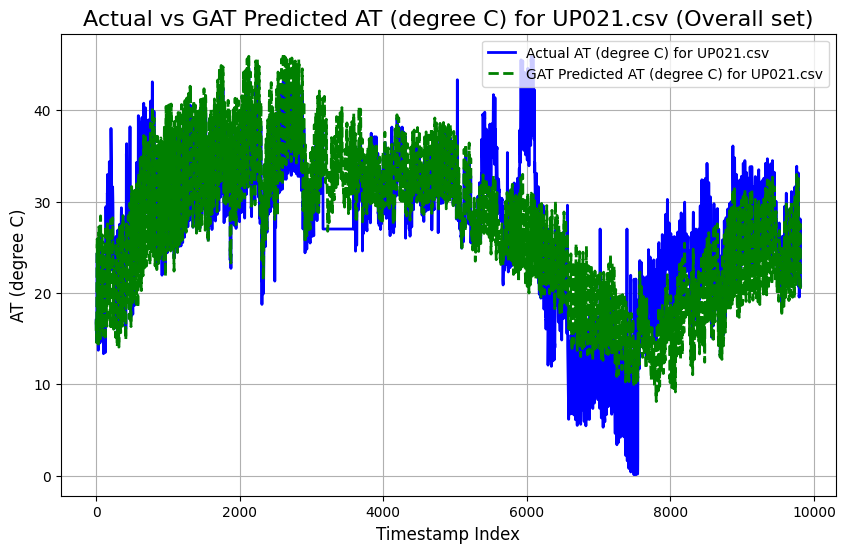

UP022.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3040
Mean Squared Error (MSE): 3.2202
Root Mean Squared Error (RMSE): 1.7945
Pearson Correlation Coefficient: 0.9725
R-squared (R²): 0.9400

----------------------------------------



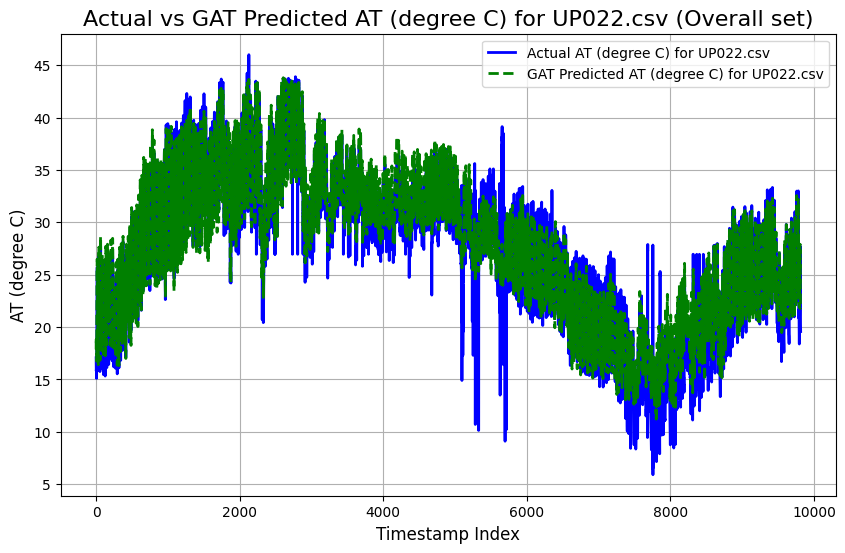

UP023.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.9942
Mean Squared Error (MSE): 13.1226
Root Mean Squared Error (RMSE): 3.6225
Pearson Correlation Coefficient: 0.8798
R-squared (R²): 0.7568

----------------------------------------



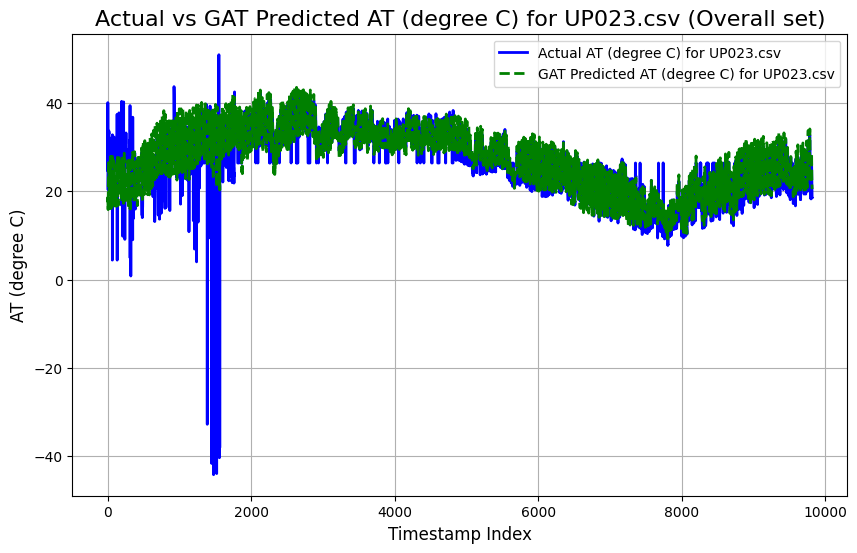

UP024.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.8259
Mean Squared Error (MSE): 14.1809
Root Mean Squared Error (RMSE): 3.7658
Pearson Correlation Coefficient: 0.8289
R-squared (R²): 0.6407

----------------------------------------



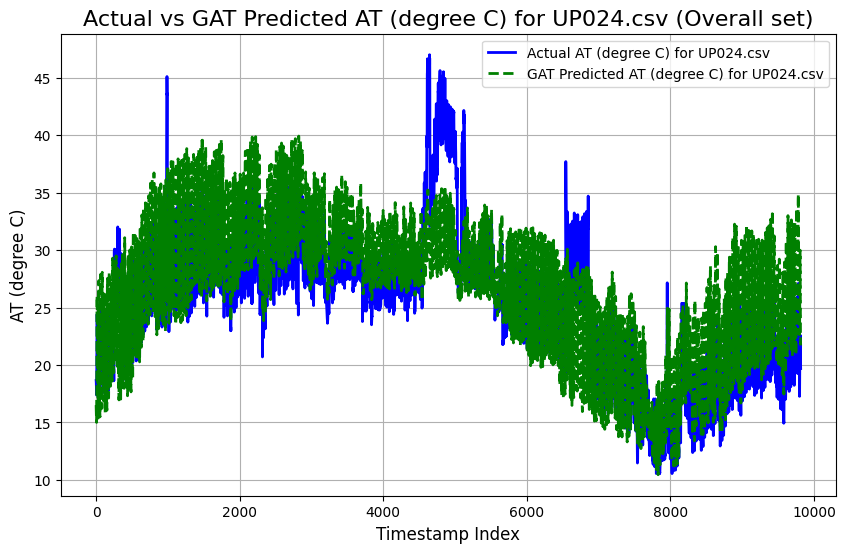

UP025.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1894
Mean Squared Error (MSE): 3.0472
Root Mean Squared Error (RMSE): 1.7456
Pearson Correlation Coefficient: 0.9750
R-squared (R²): 0.9451

----------------------------------------



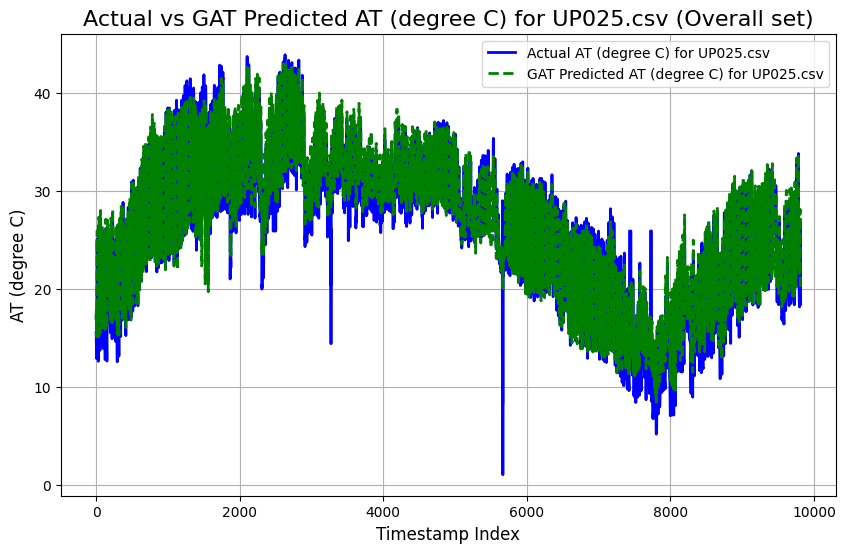

UP026.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2661
Mean Squared Error (MSE): 3.4269
Root Mean Squared Error (RMSE): 1.8512
Pearson Correlation Coefficient: 0.9760
R-squared (R²): 0.9467

----------------------------------------



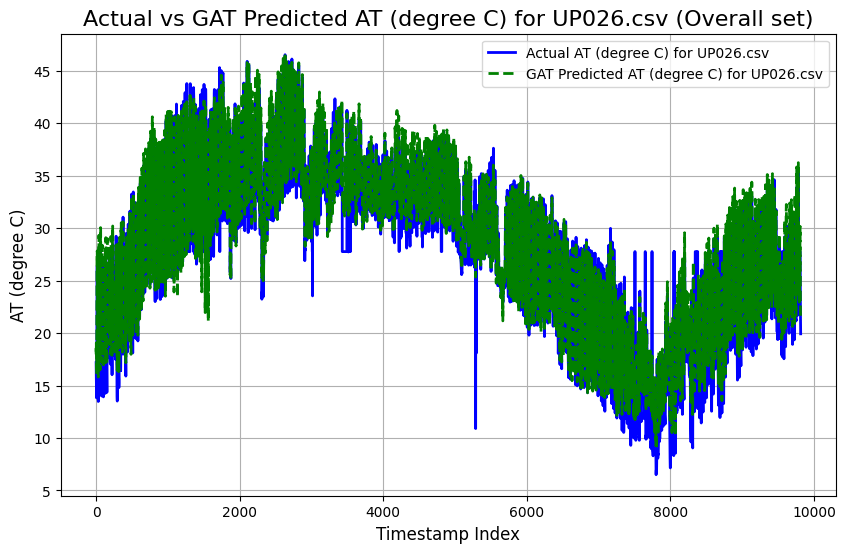

UP028.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.7759
Mean Squared Error (MSE): 5.1035
Root Mean Squared Error (RMSE): 2.2591
Pearson Correlation Coefficient: 0.9730
R-squared (R²): 0.9434

----------------------------------------



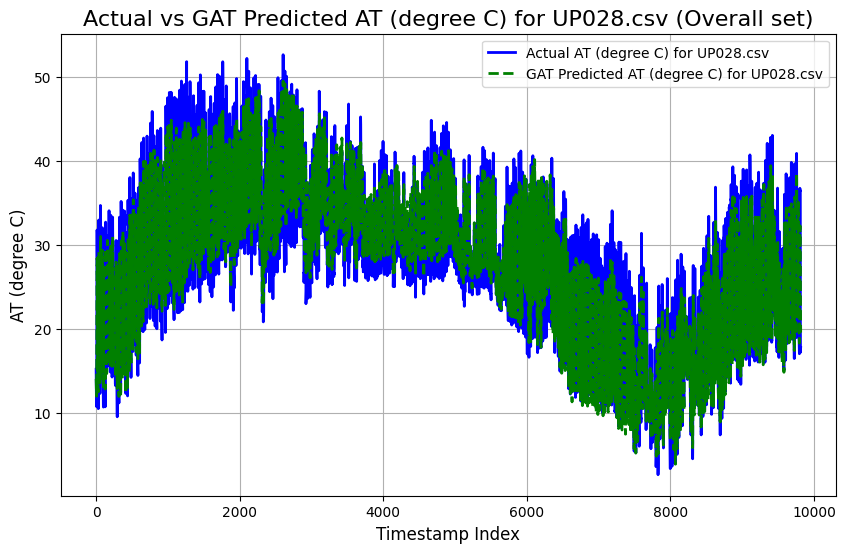

UP029.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.0926
Mean Squared Error (MSE): 3.0103
Root Mean Squared Error (RMSE): 1.7350
Pearson Correlation Coefficient: 0.9761
R-squared (R²): 0.9474

----------------------------------------



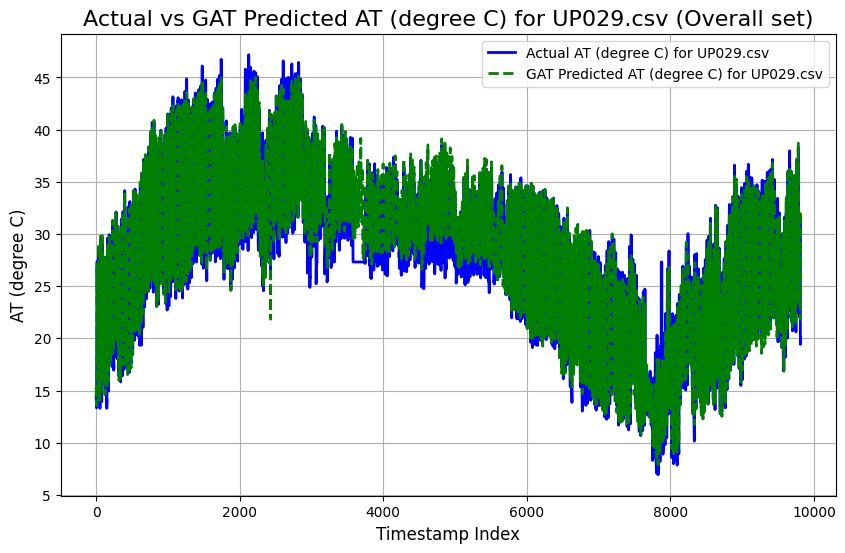

UP030.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3299
Mean Squared Error (MSE): 2.9141
Root Mean Squared Error (RMSE): 1.7071
Pearson Correlation Coefficient: 0.9827
R-squared (R²): 0.9627

----------------------------------------



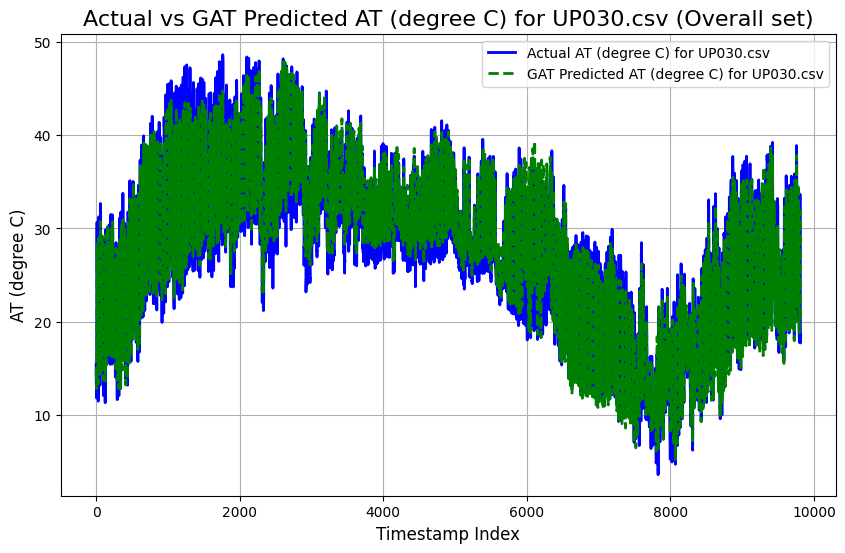

UP031.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5614
Mean Squared Error (MSE): 4.1696
Root Mean Squared Error (RMSE): 2.0420
Pearson Correlation Coefficient: 0.9711
R-squared (R²): 0.9378

----------------------------------------



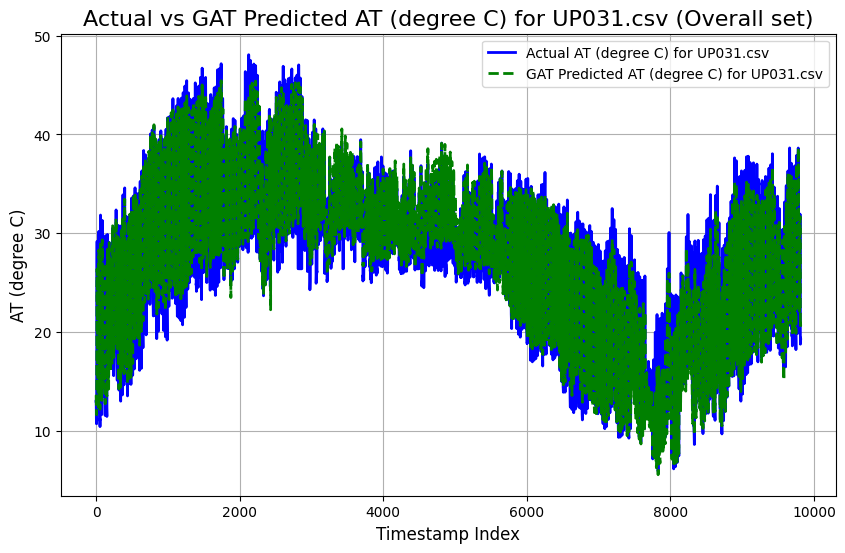

UP032.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4190
Mean Squared Error (MSE): 3.5800
Root Mean Squared Error (RMSE): 1.8921
Pearson Correlation Coefficient: 0.9687
R-squared (R²): 0.9316

----------------------------------------



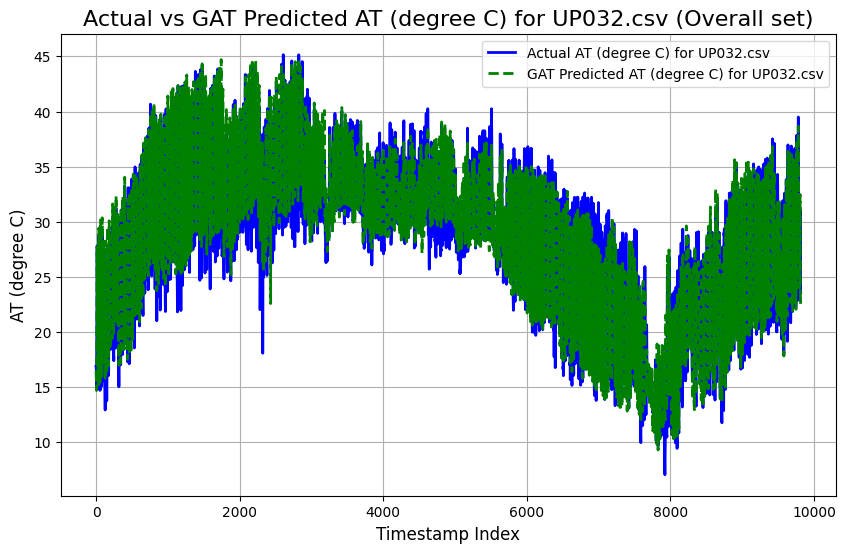

UP033.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9991
Mean Squared Error (MSE): 2.0833
Root Mean Squared Error (RMSE): 1.4433
Pearson Correlation Coefficient: 0.9852
R-squared (R²): 0.9658

----------------------------------------



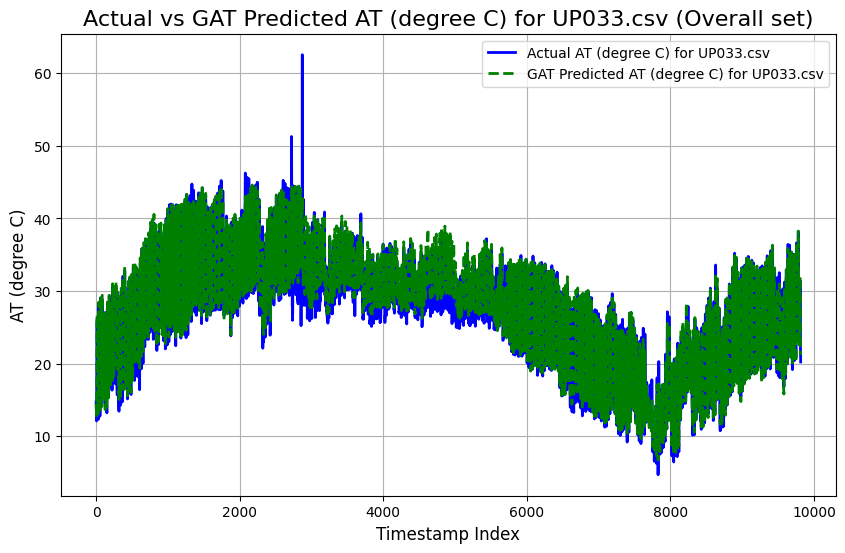

UP034.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.9309
Mean Squared Error (MSE): 8.5705
Root Mean Squared Error (RMSE): 2.9275
Pearson Correlation Coefficient: 0.9590
R-squared (R²): 0.9052

----------------------------------------



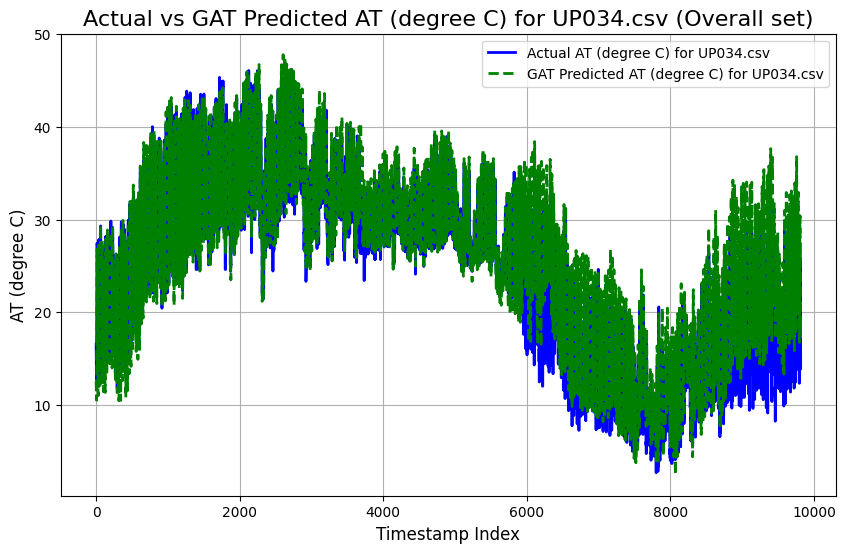

UP035.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1177
Mean Squared Error (MSE): 2.4240
Root Mean Squared Error (RMSE): 1.5569
Pearson Correlation Coefficient: 0.9847
R-squared (R²): 0.9644

----------------------------------------



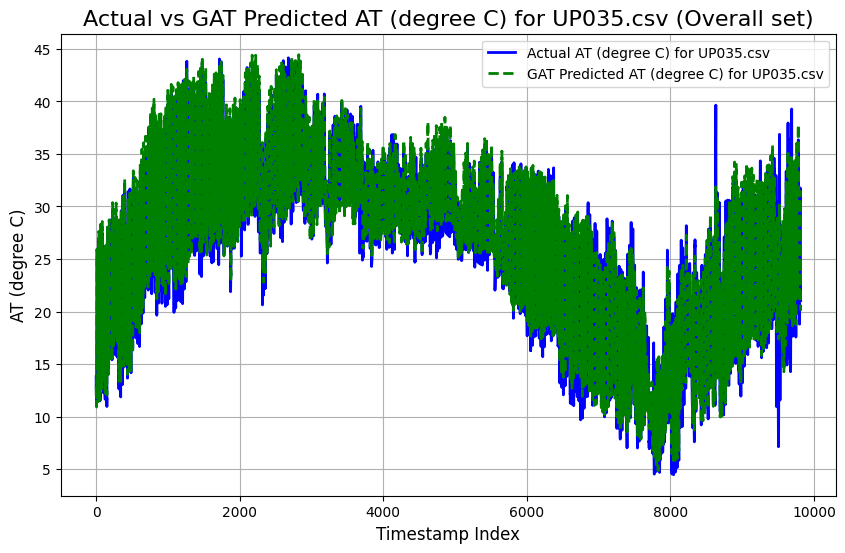

UP036.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1974
Mean Squared Error (MSE): 3.0476
Root Mean Squared Error (RMSE): 1.7457
Pearson Correlation Coefficient: 0.9766
R-squared (R²): 0.9479

----------------------------------------



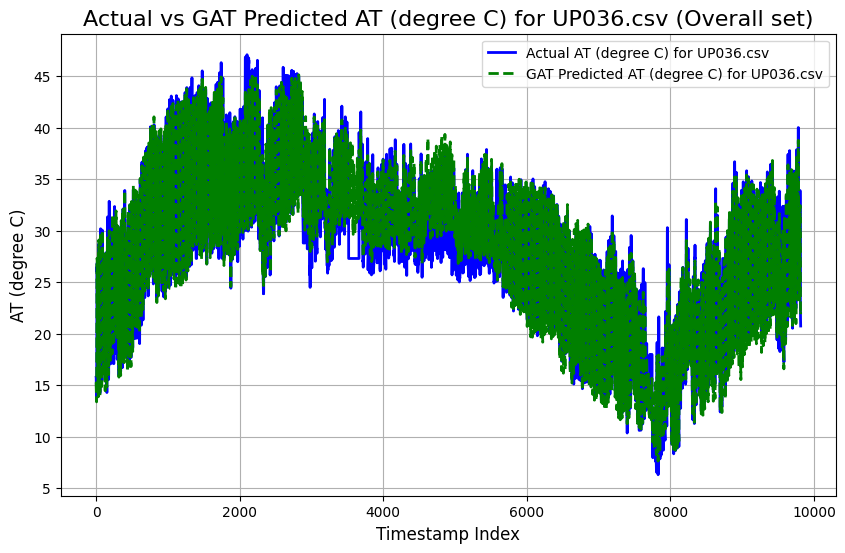

UP037.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3272
Mean Squared Error (MSE): 3.8829
Root Mean Squared Error (RMSE): 1.9705
Pearson Correlation Coefficient: 0.9749
R-squared (R²): 0.9466

----------------------------------------



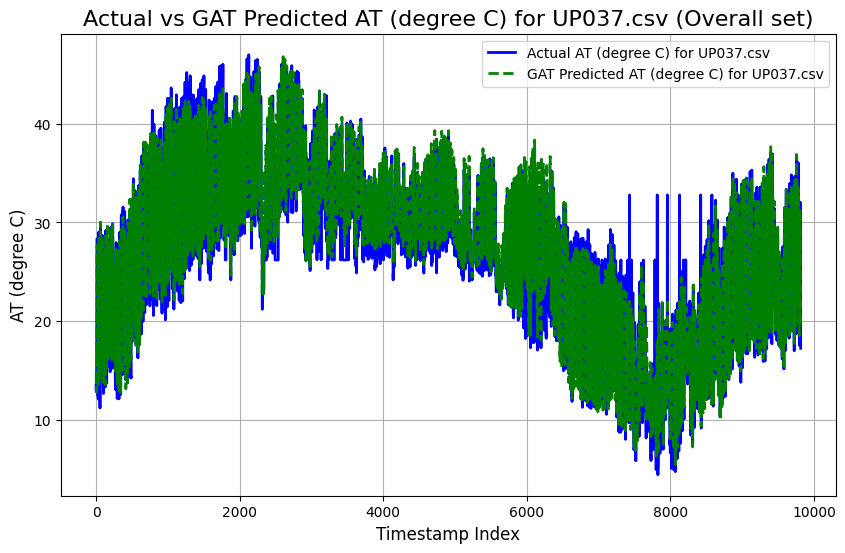

UP038.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2546
Mean Squared Error (MSE): 4.6381
Root Mean Squared Error (RMSE): 2.1536
Pearson Correlation Coefficient: 0.9608
R-squared (R²): 0.9158

----------------------------------------



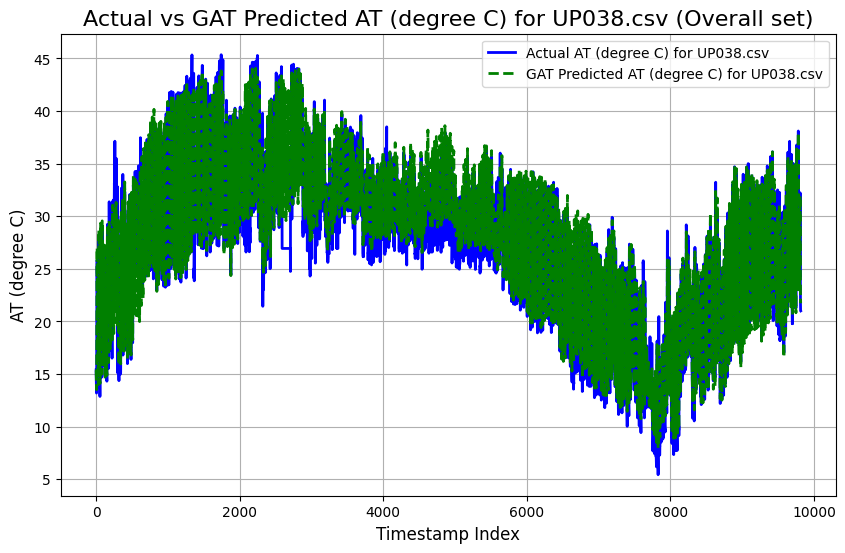

UP039.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.6673
Mean Squared Error (MSE): 4.8544
Root Mean Squared Error (RMSE): 2.2033
Pearson Correlation Coefficient: 0.9704
R-squared (R²): 0.9365

----------------------------------------



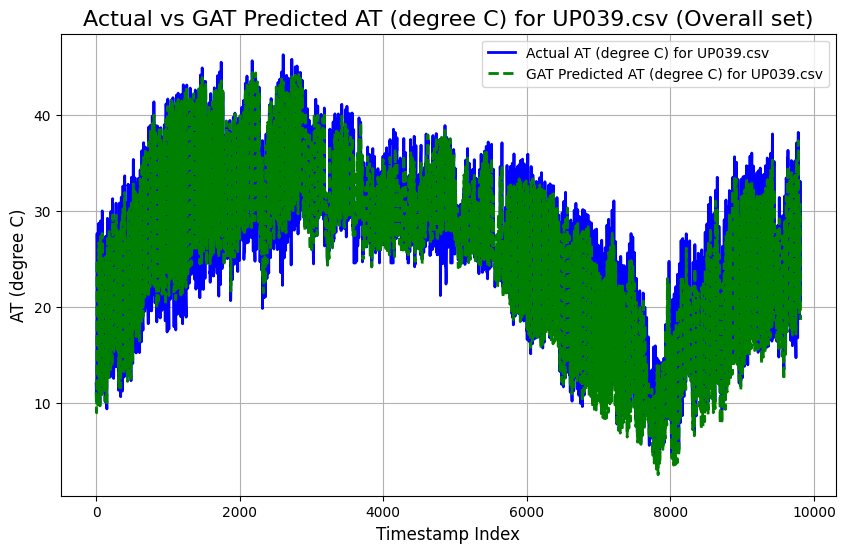

UP040.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3759
Mean Squared Error (MSE): 3.4923
Root Mean Squared Error (RMSE): 1.8688
Pearson Correlation Coefficient: 0.9797
R-squared (R²): 0.9546

----------------------------------------



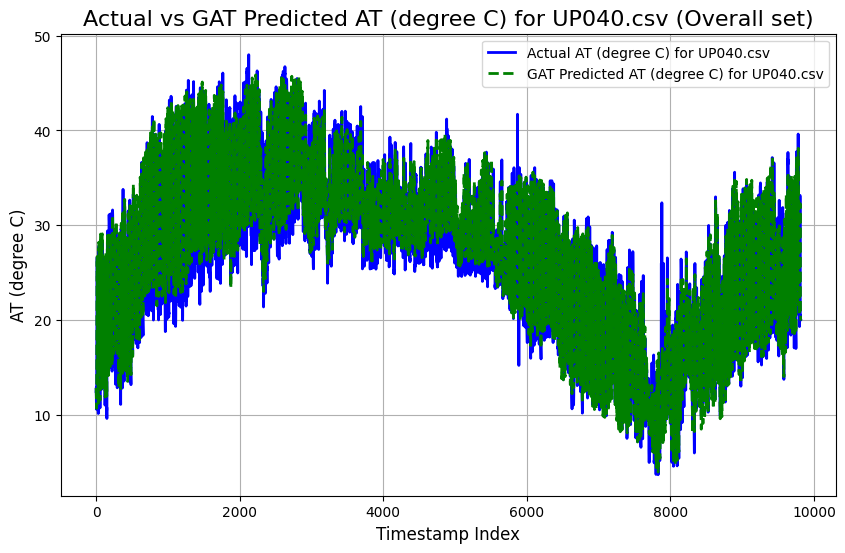

UP041.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2273
Mean Squared Error (MSE): 3.6171
Root Mean Squared Error (RMSE): 1.9019
Pearson Correlation Coefficient: 0.9689
R-squared (R²): 0.9326

----------------------------------------



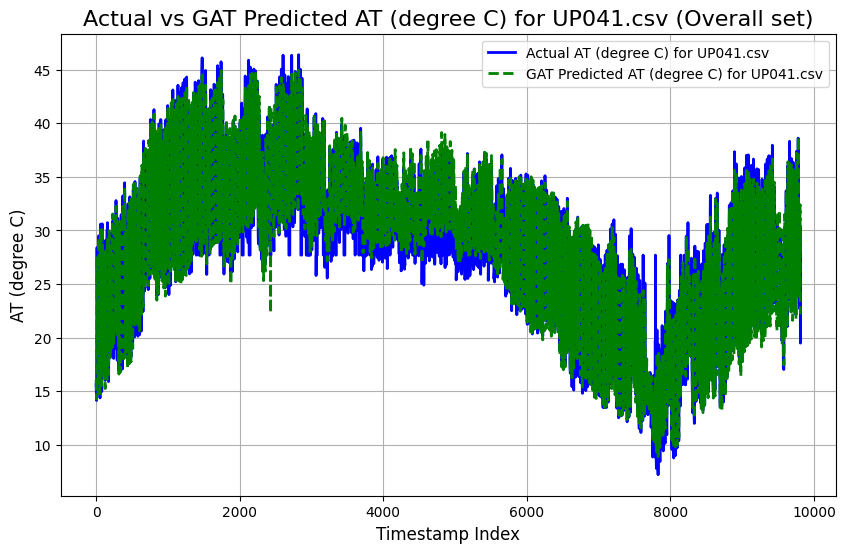

UP042.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.8952
Mean Squared Error (MSE): 9.8654
Root Mean Squared Error (RMSE): 3.1409
Pearson Correlation Coefficient: 0.9070
R-squared (R²): 0.8126

----------------------------------------



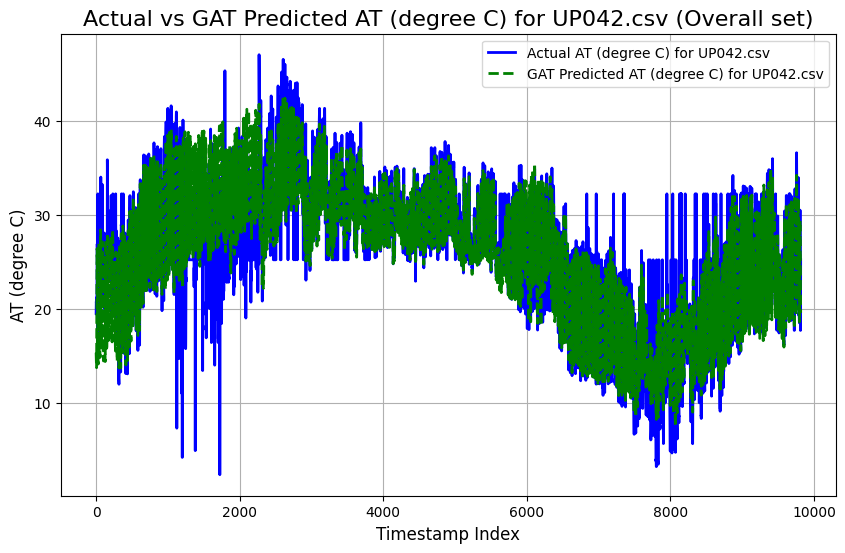

UP043.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.0210
Mean Squared Error (MSE): 9.8405
Root Mean Squared Error (RMSE): 3.1370
Pearson Correlation Coefficient: 0.9245
R-squared (R²): 0.8444

----------------------------------------



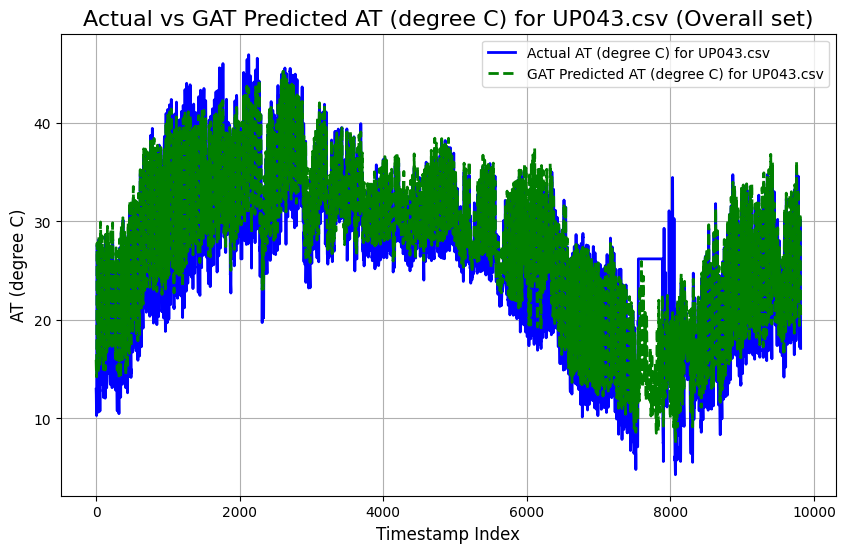

UP044.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2351
Mean Squared Error (MSE): 3.3022
Root Mean Squared Error (RMSE): 1.8172
Pearson Correlation Coefficient: 0.9796
R-squared (R²): 0.9551

----------------------------------------



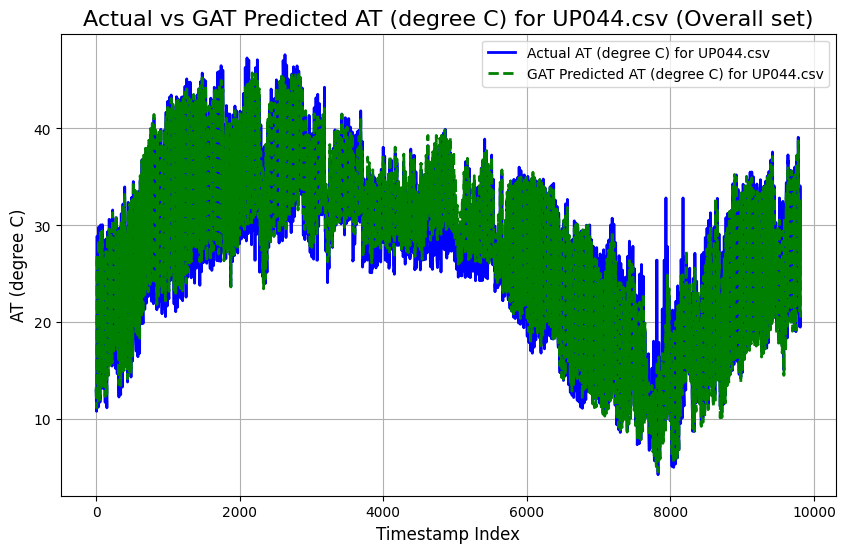

UP046.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5047
Mean Squared Error (MSE): 4.2154
Root Mean Squared Error (RMSE): 2.0531
Pearson Correlation Coefficient: 0.9702
R-squared (R²): 0.9359

----------------------------------------



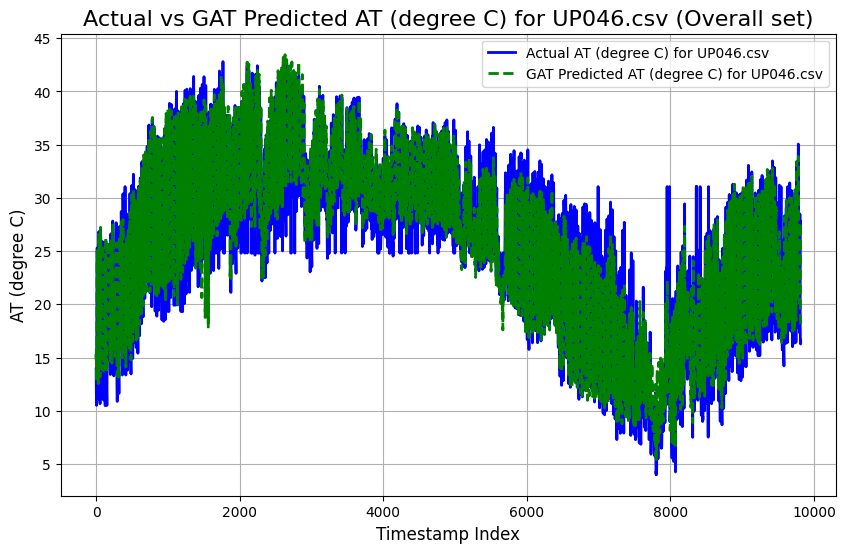

UP048.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.6048
Mean Squared Error (MSE): 4.9119
Root Mean Squared Error (RMSE): 2.2163
Pearson Correlation Coefficient: 0.9633
R-squared (R²): 0.9225

----------------------------------------



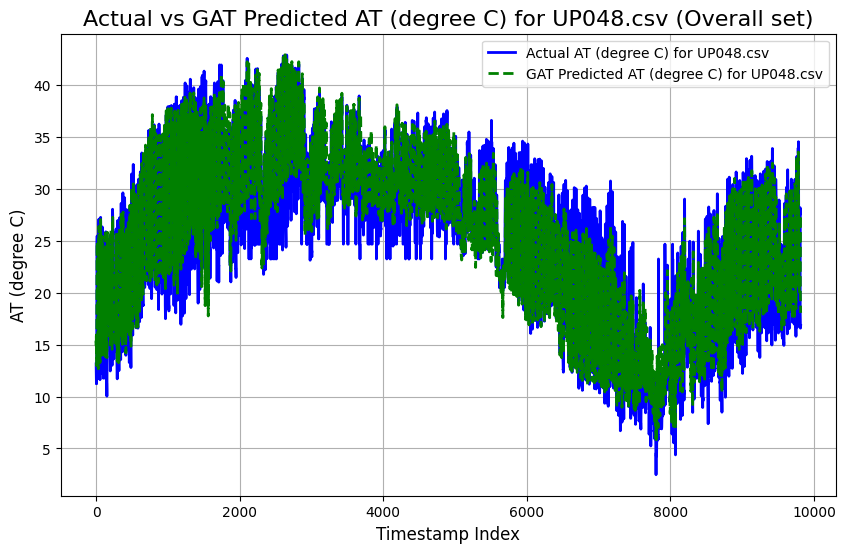

UP049.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4468
Mean Squared Error (MSE): 4.6973
Root Mean Squared Error (RMSE): 2.1673
Pearson Correlation Coefficient: 0.9672
R-squared (R²): 0.9293

----------------------------------------



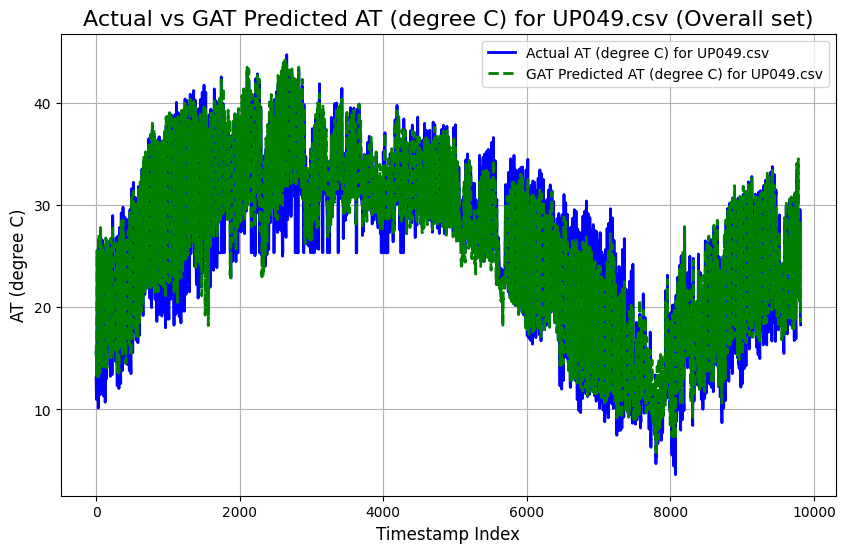

UP050.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.4914
Mean Squared Error (MSE): 10.7821
Root Mean Squared Error (RMSE): 3.2836
Pearson Correlation Coefficient: 0.8659
R-squared (R²): 0.7373

----------------------------------------



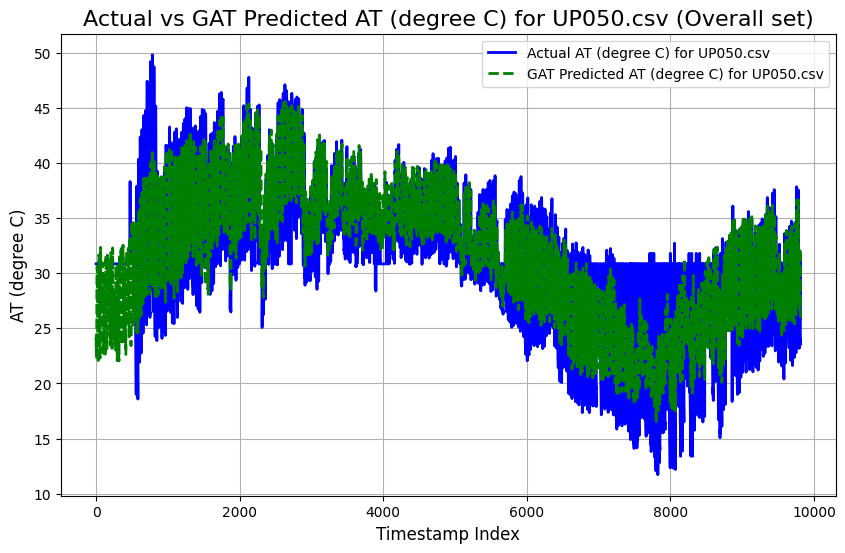

UP051.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.5052
Mean Squared Error (MSE): 40.5948
Root Mean Squared Error (RMSE): 6.3714
Pearson Correlation Coefficient: 0.7046
R-squared (R²): 0.4246

----------------------------------------



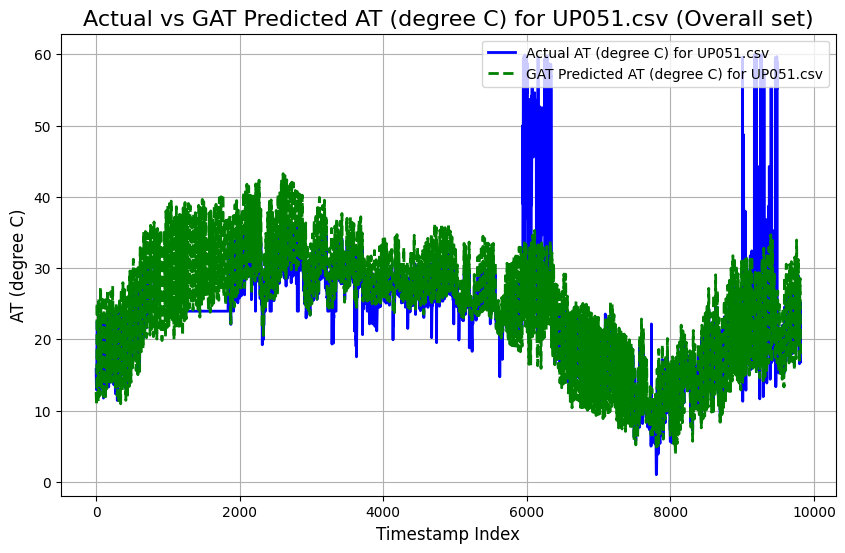

UP052.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.9460
Mean Squared Error (MSE): 7.6455
Root Mean Squared Error (RMSE): 2.7650
Pearson Correlation Coefficient: 0.9393
R-squared (R²): 0.8761

----------------------------------------



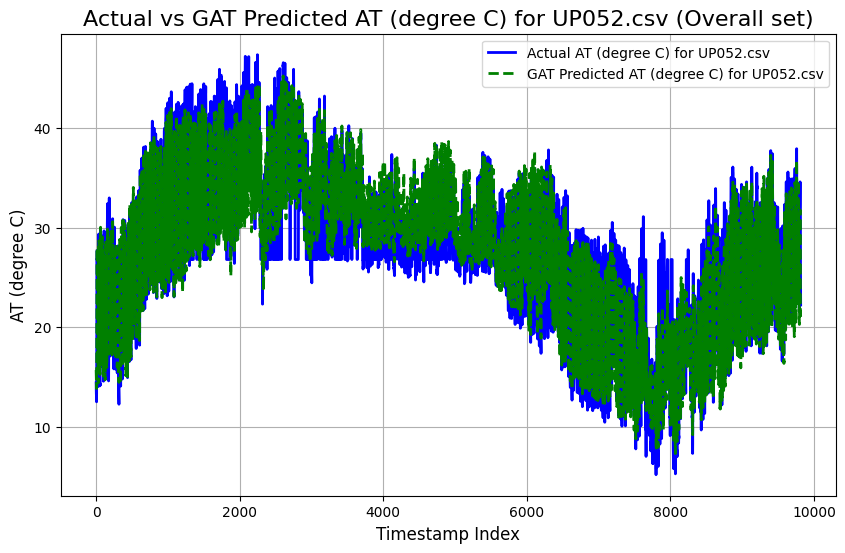

Overall GNN Imputed HourMean.csv
CSV file 'Overall GNN Imputed HourMean.csv' created successfully.
Shape of gat_outputs: (9816, 41)
Shape of actual_values: (9816, 41)


In [17]:

from torch.optim.lr_scheduler import StepLR
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from scipy.stats import pearsonr

# Define the GAT model
class GATModel(torch.nn.Module):
    def __init__(self, in_channels, out_channels):
        super(GATModel, self).__init__()
        self.conv1 = GATConv(in_channels, 8, heads=8, dropout=0.2)
        self.conv2 = GATConv(8 * 8, out_channels, heads=1, concat=False, dropout=0.2)
        
    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        # First GAT layer followed by ELU activation
        x = self.conv1(x, edge_index)
        x = F.elu(x)
        # Dropout
        x = F.dropout(x, p=0.2, training=self.training)
        
        # Second GAT layer followed by ELU activation
        x = self.conv2(x, edge_index)
        return x

# Initialize the model and optimizer
in_channels = train_graph_data_list[0].x.size(-1)  # Number of input features (depends on the number of columns)
out_channels = 1  # Predicting a single value ('AT (degree C)')
model = GATModel(in_channels, out_channels)

optimizer = torch.optim.Adam(model.parameters(), lr=0.0005, weight_decay=5e-4)
loss_fn = torch.nn.MSELoss()

# StepLR: Reduces the learning rate by gamma every step_size epochs
scheduler = StepLR(optimizer, step_size=5, gamma=0.5)

# Train the GAT model on the training set
def train_gat(graph_data_list, epochs=30):
    model.train()
    for epoch in range(epochs):
        epoch_loss = 0
        for graph_data in graph_data_list:
            optimizer.zero_grad()
            out = model(graph_data)
            loss = loss_fn(out.squeeze(), graph_data.y)
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
        scheduler.step()
        print(f"Epoch {epoch}, Loss: {epoch_loss/len(graph_data_list)}")

# Train the model using the training dataset
train_gat(train_graph_data_list)

# Evaluate the model on the training and testing sets
def evaluate_gat(graph_data_list):
    model.eval()
    gat_outputs = []
    actual_values = []
    with torch.no_grad():
        for graph_data in graph_data_list:
            gat_output = model(graph_data)
            gat_outputs.append(gat_output.squeeze().numpy())
            actual_values.append(graph_data.y.squeeze().numpy())
    return np.array(gat_outputs), np.array(actual_values)

# Get GAT predictions for training and testing sets
train_gat_outputs, train_actual_values = evaluate_gat(train_graph_data_list)
test_gat_outputs, test_actual_values = evaluate_gat(test_graph_data_list)

train_gnn_mae_list = []
train_gnn_mse_list = []
train_gnn_rmse_list = []
train_gnn_pearson_corr_list = []
train_gnn_r_squared_list = []

test_gnn_mae_list = []
test_gnn_mse_list = []
test_gnn_rmse_list = []
test_gnn_pearson_corr_list = []
test_gnn_r_squared_list = []

overall_gnn_mae_list = []
overall_gnn_mse_list = []
overall_gnn_rmse_list = []
overall_gnn_pearson_corr_list = []
overall_gnn_r_squared_list = []

# Apply inverse scaling and calculate performance metrics for training and testing sets
def inverse_scale_and_evaluate(gat_outputs, actual_values, set_type):
    gat_outputs_inverse_scaled = []
    actual_values_inverse_scaled = []
    for node_idx in range(gat_outputs.shape[1]):
        gat_node_values = gat_outputs[:, node_idx].reshape(-1, 1)
        actual_node_values = actual_values[:, node_idx].reshape(-1, 1)
        gat_node_inverse_scaled = scalers[input_files[node_idx]].inverse_transform(gat_node_values).flatten()
        actual_node_inverse_scaled = scalers[input_files[node_idx]].inverse_transform(actual_node_values).flatten()
        gat_outputs_inverse_scaled.append(gat_node_inverse_scaled)
        actual_values_inverse_scaled.append(actual_node_inverse_scaled)
    
    # Evaluate performance metrics for each node
    num_nodes = gat_outputs.shape[1]
    for node_idx in range(num_nodes):
        actual = actual_values_inverse_scaled[node_idx]
        predicted = gat_outputs_inverse_scaled[node_idx]
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        rmse = np.sqrt(mse)
        pearson_corr, _ = pearsonr(actual, predicted)
        r_squared = r2_score(actual, predicted)
        
        print(f"{input_files[node_idx]} ({set_type} set) Metrics:")
        print(f"Mean Absolute Error (MAE): {mae:.4f}")
        print(f"Mean Squared Error (MSE): {mse:.4f}")
        print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
        print(f"Pearson Correlation Coefficient: {pearson_corr:.4f}")
        print(f"R-squared (R²): {r_squared:.4f}")
        print("\n" + "-"*40 + "\n")

        if(set_type == 'Training'):
            train_gnn_mae_list.append(mae)
            train_gnn_mse_list.append(mse)
            train_gnn_rmse_list.append(rmse)
            train_gnn_pearson_corr_list.append(pearson_corr)
            train_gnn_r_squared_list.append(r_squared)

        if(set_type == 'Testing'):
            test_gnn_mae_list.append(mae)
            test_gnn_mse_list.append(mse)
            test_gnn_rmse_list.append(rmse)
            test_gnn_pearson_corr_list.append(pearson_corr)
            test_gnn_r_squared_list.append(r_squared)

        if(set_type == 'Overall'):
            overall_gnn_mae_list.append(mae)
            overall_gnn_mse_list.append(mse)
            overall_gnn_rmse_list.append(rmse)
            overall_gnn_pearson_corr_list.append(pearson_corr)
            overall_gnn_r_squared_list.append(r_squared)        
        
        # Plot actual vs predicted values for this node
        plt.figure(figsize=(10, 6))
        plt.plot(actual, label=f'Actual AT (degree C) for {input_files[node_idx]}', color='blue', linewidth=2)
        plt.plot(predicted, label=f'GAT Predicted AT (degree C) for {input_files[node_idx]}', color='green', linestyle='--', linewidth=2)
        plt.title(f'Actual vs GAT Predicted AT (degree C) for {input_files[node_idx]} ({set_type} set)', fontsize=16)
        plt.xlabel('Timestamp Index', fontsize=12)
        plt.ylabel('AT (degree C)', fontsize=12)
        plt.legend(loc='upper right')
        plt.grid(True)
        plt.show()

# Evaluate and plot for both training and testing sets
inverse_scale_and_evaluate(train_gat_outputs, train_actual_values, 'Training')
inverse_scale_and_evaluate(test_gat_outputs, test_actual_values, 'Testing')

def create_metrics_gnn_csv(file_name, input_files, mae_list, mse_list, rmse_list, r2_list, corr_list):
    metrics_df = pd.DataFrame({
        "File Name": input_files,
        "MAE": mae_list,
        "MSE": mse_list,
        "RMSE": rmse_list,
        "R2": r2_list,
        "CorrCoeff": corr_list
    })
    metrics_df.to_csv(file_name, index=False)
    print(f"CSV file '{file_name}' created successfully.")


# Create CSV for training set
file_name = "Train GNN Imputed HourMean.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, train_gnn_mae_list, train_gnn_mse_list, train_gnn_rmse_list, train_gnn_r_squared_list, train_gnn_pearson_corr_list)

# Create CSV for training set
file_name = "Test GNN Imputed HourMean.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, test_gnn_mae_list, test_gnn_mse_list, test_gnn_rmse_list, test_gnn_r_squared_list, test_gnn_pearson_corr_list)

# Concatenate training and testing outputs
gat_outputs = np.concatenate([train_gat_outputs, test_gat_outputs], axis=0)
actual_values = np.concatenate([train_actual_values, test_actual_values], axis=0)
inverse_scale_and_evaluate(gat_outputs, actual_values, 'Overall')

# Create CSV for overall set
file_name = "Overall GNN Imputed HourMean.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, overall_gnn_mae_list, overall_gnn_mse_list, overall_gnn_rmse_list, overall_gnn_r_squared_list, overall_gnn_pearson_corr_list)

# Print the shapes of gat_outputs and actual_values
print(f"Shape of gat_outputs: {gat_outputs.shape}")
print(f"Shape of actual_values: {actual_values.shape}")


# Showing the GAT outputs and actual outputs

In [18]:
gat_outputs_without_inverse_scaled = []
actual_values_without_inverse_scaled = []

for node_idx in range(gat_outputs.shape[1]):
    # Extract predictions and actual values for the current node across all timestamps
    gat_node_values = gat_outputs[:, node_idx].reshape(-1, 1)
    actual_node_values = actual_values[:, node_idx].reshape(-1, 1)
    
    # Append the inverse scaled values for this node
    gat_outputs_without_inverse_scaled.append(gat_node_values)
    actual_values_without_inverse_scaled.append(actual_node_values)

# Plot the actual vs predicted values for each node
num_nodes = gat_outputs.shape[1]
print(gat_outputs_without_inverse_scaled)
print(actual_values_without_inverse_scaled)


[array([[-1.581215  ],
       [-1.6176059 ],
       [-1.6595764 ],
       ...,
       [-0.6758294 ],
       [-0.68635017],
       [-0.73632383]], dtype=float32), array([[-1.6221129 ],
       [-1.6483828 ],
       [-1.6945728 ],
       ...,
       [-0.7860364 ],
       [-0.72639877],
       [-0.7624799 ]], dtype=float32), array([[-1.3951048 ],
       [-1.4218152 ],
       [-1.4782238 ],
       ...,
       [-0.7507615 ],
       [-0.78354883],
       [-0.82163167]], dtype=float32), array([[-1.2929136 ],
       [-1.170982  ],
       [-1.2233952 ],
       ...,
       [-0.76188844],
       [-0.777209  ],
       [-0.7779237 ]], dtype=float32), array([[-1.2977569 ],
       [-1.181589  ],
       [-1.2398797 ],
       ...,
       [-0.8021129 ],
       [-0.8236181 ],
       [-0.82800925]], dtype=float32), array([[-1.3443902],
       [-1.2979395],
       [-1.3535502],
       ...,
       [-0.7581359],
       [-0.7827639],
       [-0.8026336]], dtype=float32), array([[-1.2810794 ],
       [-1.209269

# Adding the GNN predicted values as a new column

In [19]:
train_gat_outputs_without_inverse_scaled = []
test_gat_outputs_without_inverse_scaled = []
train_size = train_dataframes[0].shape[0]

for node_idx in range(num_nodes):
    train1 = gat_outputs_without_inverse_scaled[node_idx][:train_size]
    test1 = gat_outputs_without_inverse_scaled[node_idx][train_size:]
    train_gat_outputs_without_inverse_scaled.append(train1)
    test_gat_outputs_without_inverse_scaled.append(test1)

# Add predicted values as a new column in each dataframe and print column and row details
for node_idx, df in enumerate(train_dataframes):
    # Extract the predicted values for the current node (inverse scaled)
    predicted_values = train_gat_outputs_without_inverse_scaled[node_idx].flatten()
    print(df.shape)
    print(len(predicted_values))

    # Add a new column for the predicted values
    df['Predicted AT (degree C)'] = predicted_values

    # Print column numbers and names
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}: Columns")
    for col_idx, col_name in enumerate(df.columns):
        print(f"Column {col_idx + 1}: {col_name}")

    print(f"Row numbers total: {len(df)}")    

# Optionally print the first few rows to verify the predicted column was added correctly
    print(df.head(10))  # Display the first few rows of the dataframe for verification
    print("\n" + "="*60 + "\n")


# Add predicted values as a new column in each dataframe and print column and row details
for node_idx, df in enumerate(test_dataframes):
    # Extract the predicted values for the current node (inverse scaled)
    predicted_values = test_gat_outputs_without_inverse_scaled[node_idx].flatten()

    # Add a new column for the predicted values
    df['Predicted AT (degree C)'] = predicted_values

    # Print column numbers and names
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}: Columns")
    for col_idx, col_name in enumerate(df.columns):
        print(f"Column {col_idx + 1}: {col_name}")

    print(f"Row numbers total: {len(df)}")    

# Optionally print the first few rows to verify the predicted column was added correctly
    print(df.head(10))  # Display the first few rows of the dataframe for verification
    print("\n" + "="*60 + "\n")


(8343, 15)
8343
DataFrame 1 - UP002.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 8343
   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       0.022507      0.443334    0.114415     0.431821    -0.852547   
1       0.102528      0.344042    0.078682     0.341594    -0.300485   
2       0.075123      0.247553    0.199116     0.638535     0.123190   
3       0.082797      0.236477    0.100188     0.592075     0.187383   
4      -0.180285      0.092744    0.050558     0.200194     0.232319   
5      -0.091057      0.000393    0.091254     0.334861    -0.062970   
6      -0.176558     -0.008015    0.211358     0.892719    -0.092927   
7       0.0

C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_i

(8343, 15)
8343
DataFrame 9 - UP017.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 8343
   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       0.642866      0.596453    1.226829     0.891013    -0.472350   
1       0.842691      0.753314    1.542632     0.615617    -0.171878   
2       0.874460      0.606112    1.305924     0.024389    -0.584922   
3       0.853334      0.637732    1.444485    -0.135868    -0.779594   
4       1.178963      0.922560    2.562013     0.456592    -0.625549   
5       1.294124      1.003054    1.872675    -0.167673    -0.738967   
6       1.446297      0.991331    0.924883    -0.359982    -0.669562   
7       1.8

C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_i

   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       0.014835      0.017792   -0.034705    -0.003439    -0.064316   
1       0.014835      0.017792   -0.034705    -0.003439    -0.064316   
2       0.014835      0.017792   -0.034705    -0.003439    -0.064316   
3       0.014835      0.017792   -0.034705    -0.003439    -0.064316   
4       0.014835      0.017792   -0.034705    -0.003439    -0.064316   
5       0.014835      0.017792   -0.034705    -0.003439    -0.064316   
6       0.014835      0.017792   -0.034705    -0.003439    -0.064316   
7       0.014835      0.017792   -0.034705    -0.003439    -0.064316   
8       0.014835      0.017792   -0.034705    -0.003439    -0.064316   
9       0.014835      0.017792   -0.034705    -0.003439    -0.064316   

   CO (mg/m3)  Ozone (ug/m3)    RH (%)  WS (m/s)  WD (degree)  AT (degree C)  \
0    0.084845       0.031237  0.031229 -0.017546    -0.034982      -0.094833   
1    0.084845       0.031237  0.031229 -0.01754

C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_4916\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_i

      PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
8343      -0.939087     -0.970875   -0.468601    -0.475577     1.842320   
8344      -0.950066     -1.019471   -0.474803    -0.458792     1.827321   
8345      -1.115666     -1.038957   -0.474477    -0.218009     1.877316   
8346      -0.995812     -0.964302   -0.466968     0.108436     1.868317   
8347      -0.857049     -0.868988   -0.457502     0.088178     1.852319   
8348      -0.756408     -0.748555   -0.465010    -0.020637     1.755327   
8349      -0.802154     -0.871571   -0.464683    -0.053629     1.717331   
8350      -0.794224     -0.868284   -0.465663     0.063289     1.714331   
8351      -0.595382     -0.597485   -0.468274    -0.090094     1.687333   
8352      -0.580134     -0.648194   -0.467295    -0.127137     1.651337   

      CO (mg/m3)  Ozone (ug/m3)    RH (%)  WS (m/s)  WD (degree)  \
8343   -0.814783       1.962352 -0.278640  1.004833    -1.694101   
8344   -0.814783       1.948994 -0.245

# Creating feature and target lists

In [20]:
# Initialize lists to store features and target for each dataframe
train_features_list = []
train_target_list = []

test_features_list = []
test_target_list = []

# Iterate over each dataframe to separate features and target
for node_idx, (df1, df2) in enumerate(zip(train_dataframes, test_dataframes)):
    # Features include all columns except 'AT (degree C)'
    trainfeatures1 = df1.drop(columns=['AT (degree C)'])
    testfeatures1 = df2.drop(columns=['AT (degree C)'])
    
    # Target is the 'AT (degree C)' column
    traintarget1 = df1['AT (degree C)']
    testtarget1 = df2['AT (degree C)']
    
    # Append the features and target to the respective lists
    train_features_list.append(trainfeatures1)
    train_target_list.append(traintarget1)
    test_features_list.append(testfeatures1)
    test_target_list.append(testtarget1)
    
    # Print the columns of features and target, and number of rows
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}:")
    print(f"Features columns: {len(trainfeatures1.columns)}")
    print(trainfeatures1.columns)
    
    print("\nTarget column:")
    print(traintarget1.name)
    
    print(f"\nNumber of rows in training features: {trainfeatures1.shape[0]}")
    print(f"Number of rows in training target: {traintarget1.shape[0]}")
    print(f"\nNumber of rows in testing features: {testfeatures1.shape[0]}")
    print(f"Number of rows in testing target: {testtarget1.shape[0]}")
    print("\n" + "="*60 + "\n")

DataFrame 1 - UP002.csv:
Features columns: 15
Index(['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)',
       'SO2 (ug/m3)', 'CO (mg/m3)', 'Ozone (ug/m3)', 'RH (%)', 'WS (m/s)',
       'WD (degree)', 'Year', 'Month', 'Day', 'Hour',
       'Predicted AT (degree C)'],
      dtype='object')

Target column:
AT (degree C)

Number of rows in training features: 8343
Number of rows in training target: 8343

Number of rows in testing features: 1473
Number of rows in testing target: 1473


DataFrame 2 - UP003.csv:
Features columns: 15
Index(['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)',
       'SO2 (ug/m3)', 'CO (mg/m3)', 'Ozone (ug/m3)', 'RH (%)', 'WS (m/s)',
       'WD (degree)', 'Year', 'Month', 'Day', 'Hour',
       'Predicted AT (degree C)'],
      dtype='object')

Target column:
AT (degree C)

Number of rows in training features: 8343
Number of rows in training target: 8343

Number of rows in testing features: 1473
Number of rows in testing target: 1473


DataFr

# LSTM Model Implementation

For Batch Size= 3 and Sequence Length = 3
Processing node 1...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1031
Epoch [2/50], Train Loss: 0.0718
Epoch [3/50], Train Loss: 0.0658
Epoch [4/50], Train Loss: 0.0618
Epoch [5/50], Train Loss: 0.0602
Epoch [6/50], Train Loss: 0.0579
Epoch [7/50], Train Loss: 0.0551
Epoch [8/50], Train Loss: 0.0546
Epoch [9/50], Train Loss: 0.0537
Epoch [10/50], Train Loss: 0.0526
Epoch [11/50], Train Loss: 0.0517
Epoch [12/50], Train Loss: 0.0516
Epoch [13/50], Train Loss: 0.0498
Epoch [14/50], Train Loss: 0.0492
Epoch [15/50], Train Loss: 0.0474
Epoch [16/50], Train Loss: 0.0473
Epoch [17/50], Train Loss: 0.0456
Epoch [18/50], Train Loss: 0.0451
Epoch [19/50], Train Loss: 0.0437
Epoch [20/50], Train Loss: 0.0428
Epoch [21/50], Train Loss: 0.0420
Epoch [22/50], Train Loss: 0.0414
Epoch [23/50], Train Loss: 0.0403
Epoch [24/50], Train Loss: 0.0387
Epoch [25/50], Train Loss: 0.0389
Epoch [26/50], Train Loss: 0.0377
Epoch [27/50], Train Loss: 0.0371
Epoch [28/50], Train Loss: 0.0367
Epoch [29/50], Train Loss: 0.0349
Epoch [30/50], Train Lo

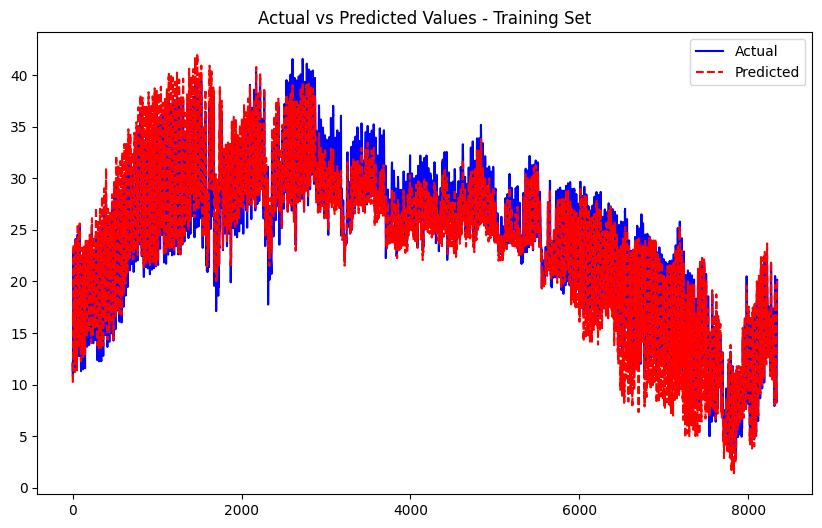

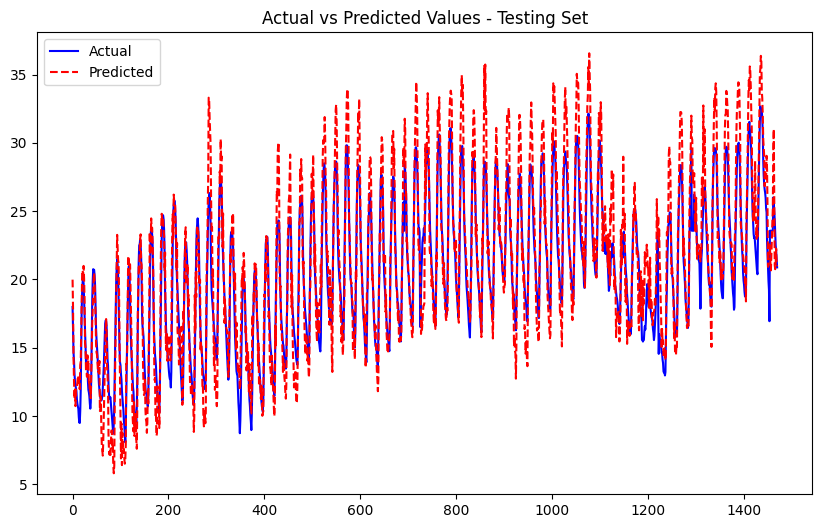

Processing node 2...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0593
Epoch [2/50], Train Loss: 0.0518
Epoch [3/50], Train Loss: 0.0487
Epoch [4/50], Train Loss: 0.0467
Epoch [5/50], Train Loss: 0.0451
Epoch [6/50], Train Loss: 0.0437
Epoch [7/50], Train Loss: 0.0426
Epoch [8/50], Train Loss: 0.0420
Epoch [9/50], Train Loss: 0.0408
Epoch [10/50], Train Loss: 0.0402
Epoch [11/50], Train Loss: 0.0396
Epoch [12/50], Train Loss: 0.0391
Epoch [13/50], Train Loss: 0.0382
Epoch [14/50], Train Loss: 0.0385
Epoch [15/50], Train Loss: 0.0378
Epoch [16/50], Train Loss: 0.0374
Epoch [17/50], Train Loss: 0.0369
Epoch [18/50], Train Loss: 0.0358
Epoch [19/50], Train Loss: 0.0359
Epoch [20/50], Train Loss: 0.0362
Epoch [21/50], Train Loss: 0.0350
Epoch [22/50], Train Loss: 0.0345
Epoch [23/50], Train Loss: 0.0358
Epoch [24/50], Train Loss: 0.0364
Epoch [25/50], Train Loss: 0.0330
Epoch [26/50], Train Loss: 0.0333
Epoch [27/50], Train Loss: 0.0328
Epoch [28/50], Train Loss: 0.0358
Epoch [29/50], Train Loss: 0.0327
Epoch [30/50], Train Lo

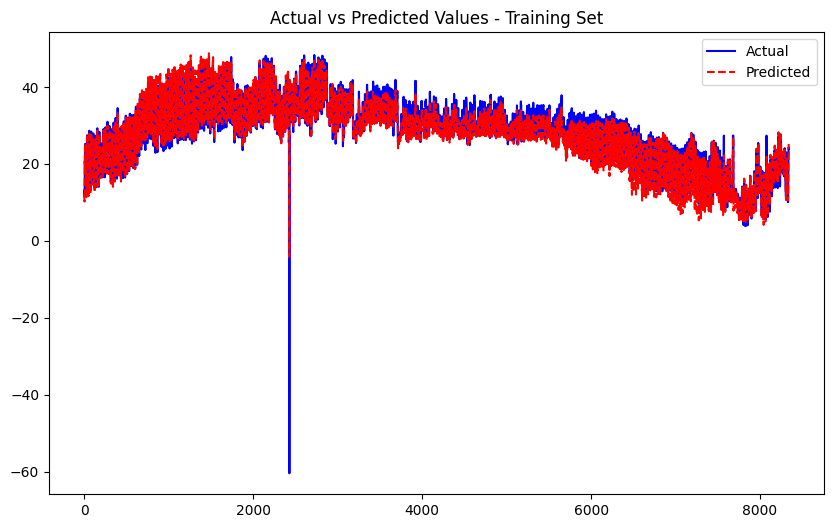

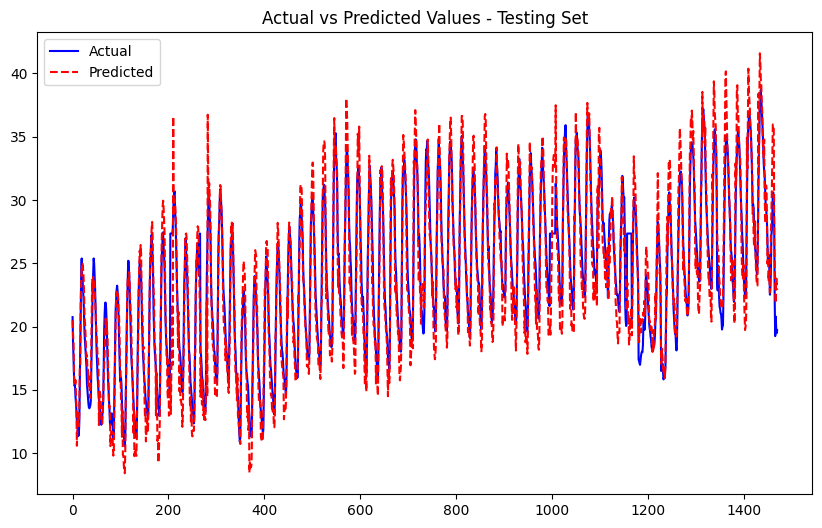

Processing node 3...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0458
Epoch [2/50], Train Loss: 0.0365
Epoch [3/50], Train Loss: 0.0331
Epoch [4/50], Train Loss: 0.0306
Epoch [5/50], Train Loss: 0.0293
Epoch [6/50], Train Loss: 0.0281
Epoch [7/50], Train Loss: 0.0274
Epoch [8/50], Train Loss: 0.0263
Epoch [9/50], Train Loss: 0.0259
Epoch [10/50], Train Loss: 0.0249
Epoch [11/50], Train Loss: 0.0249
Epoch [12/50], Train Loss: 0.0247
Epoch [13/50], Train Loss: 0.0240
Epoch [14/50], Train Loss: 0.0240
Epoch [15/50], Train Loss: 0.0233
Epoch [16/50], Train Loss: 0.0230
Epoch [17/50], Train Loss: 0.0232
Epoch [18/50], Train Loss: 0.0229
Epoch [19/50], Train Loss: 0.0224
Epoch [20/50], Train Loss: 0.0222
Epoch [21/50], Train Loss: 0.0220
Epoch [22/50], Train Loss: 0.0224
Epoch [23/50], Train Loss: 0.0219
Epoch [24/50], Train Loss: 0.0218
Epoch [25/50], Train Loss: 0.0215
Epoch [26/50], Train Loss: 0.0215
Epoch [27/50], Train Loss: 0.0214
Epoch [28/50], Train Loss: 0.0212
Epoch [29/50], Train Loss: 0.0212
Epoch [30/50], Train Lo

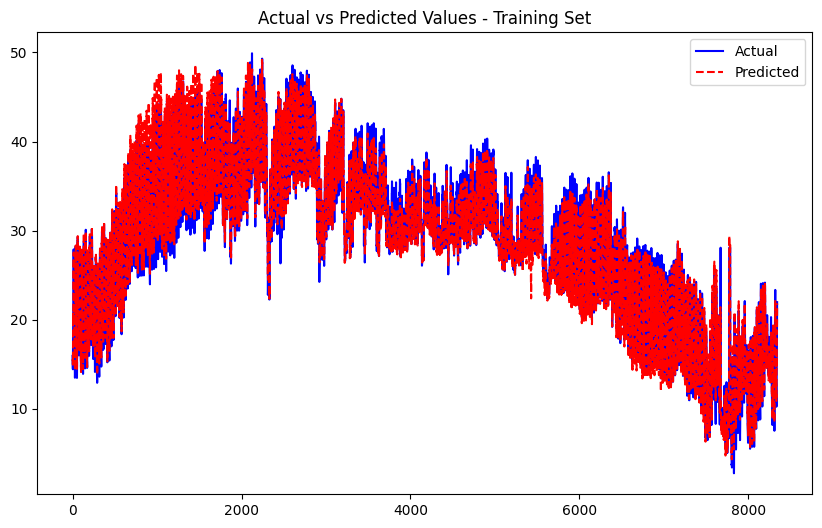

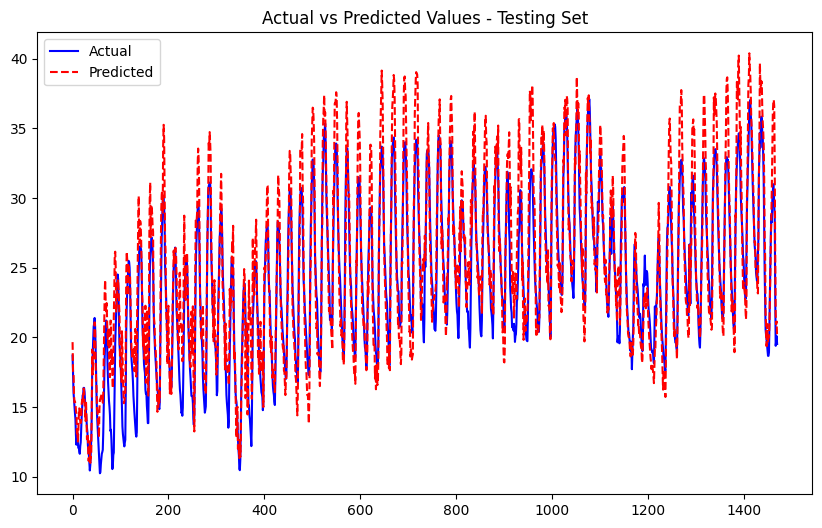

Processing node 4...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2359
Epoch [2/50], Train Loss: 0.1986
Epoch [3/50], Train Loss: 0.1736
Epoch [4/50], Train Loss: 0.1539
Epoch [5/50], Train Loss: 0.1386
Epoch [6/50], Train Loss: 0.1299
Epoch [7/50], Train Loss: 0.1196
Epoch [8/50], Train Loss: 0.1142
Epoch [9/50], Train Loss: 0.1085
Epoch [10/50], Train Loss: 0.1051
Epoch [11/50], Train Loss: 0.0992
Epoch [12/50], Train Loss: 0.0915
Epoch [13/50], Train Loss: 0.0891
Epoch [14/50], Train Loss: 0.0846
Epoch [15/50], Train Loss: 0.0795
Epoch [16/50], Train Loss: 0.0778
Epoch [17/50], Train Loss: 0.0743
Epoch [18/50], Train Loss: 0.0712
Epoch [19/50], Train Loss: 0.0689
Epoch [20/50], Train Loss: 0.0715
Epoch [21/50], Train Loss: 0.0655
Epoch [22/50], Train Loss: 0.0625
Epoch [23/50], Train Loss: 0.0683
Epoch [24/50], Train Loss: 0.0622
Epoch [25/50], Train Loss: 0.0607
Epoch [26/50], Train Loss: 0.0593
Epoch [27/50], Train Loss: 0.0582
Epoch [28/50], Train Loss: 0.0549
Epoch [29/50], Train Loss: 0.0548
Epoch [30/50], Train Lo

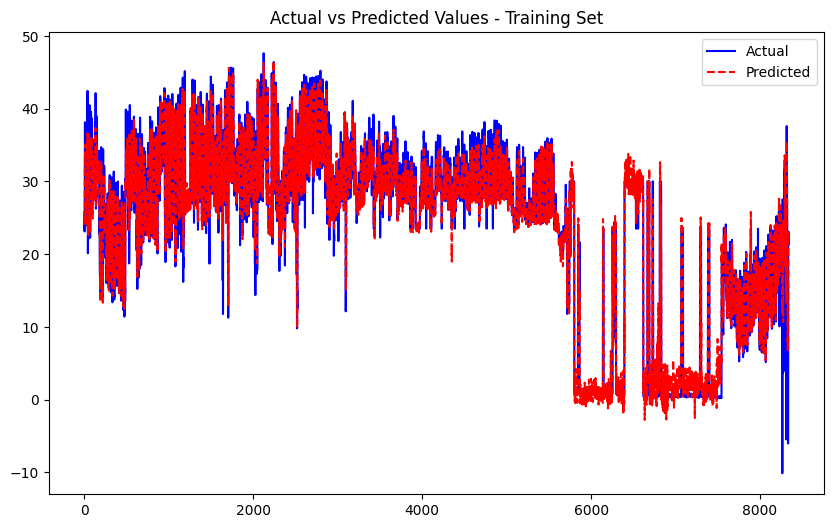

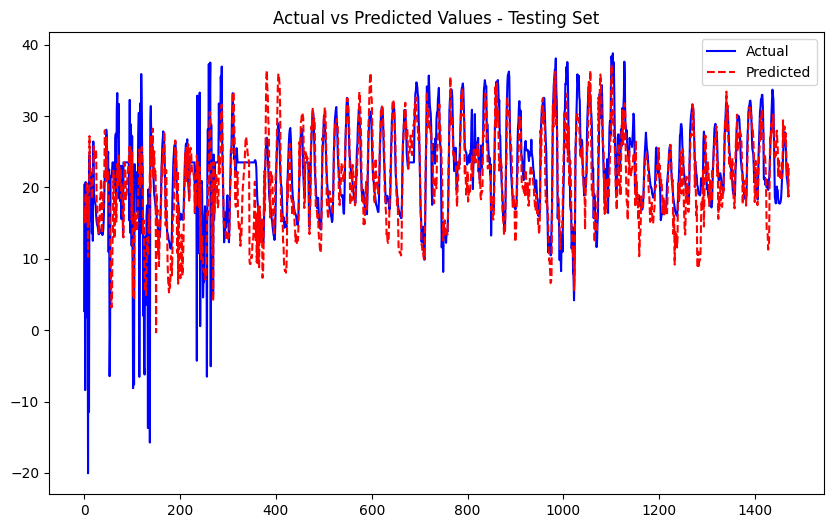

Processing node 5...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0937
Epoch [2/50], Train Loss: 0.0615
Epoch [3/50], Train Loss: 0.0503
Epoch [4/50], Train Loss: 0.0447
Epoch [5/50], Train Loss: 0.0412
Epoch [6/50], Train Loss: 0.0375
Epoch [7/50], Train Loss: 0.0364
Epoch [8/50], Train Loss: 0.0349
Epoch [9/50], Train Loss: 0.0331
Epoch [10/50], Train Loss: 0.0312
Epoch [11/50], Train Loss: 0.0310
Epoch [12/50], Train Loss: 0.0302
Epoch [13/50], Train Loss: 0.0293
Epoch [14/50], Train Loss: 0.0288
Epoch [15/50], Train Loss: 0.0296
Epoch [16/50], Train Loss: 0.0284
Epoch [17/50], Train Loss: 0.0277
Epoch [18/50], Train Loss: 0.0272
Epoch [19/50], Train Loss: 0.0272
Epoch [20/50], Train Loss: 0.0269
Epoch [21/50], Train Loss: 0.0272
Epoch [22/50], Train Loss: 0.0265
Epoch [23/50], Train Loss: 0.0262
Epoch [24/50], Train Loss: 0.0258
Epoch [25/50], Train Loss: 0.0261
Epoch [26/50], Train Loss: 0.0256
Epoch [27/50], Train Loss: 0.0252
Epoch [28/50], Train Loss: 0.0254
Epoch [29/50], Train Loss: 0.0253
Epoch [30/50], Train Lo

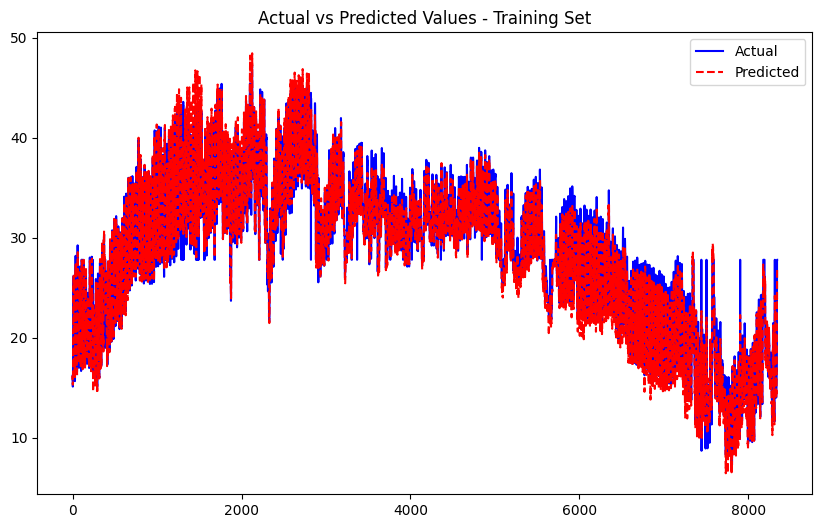

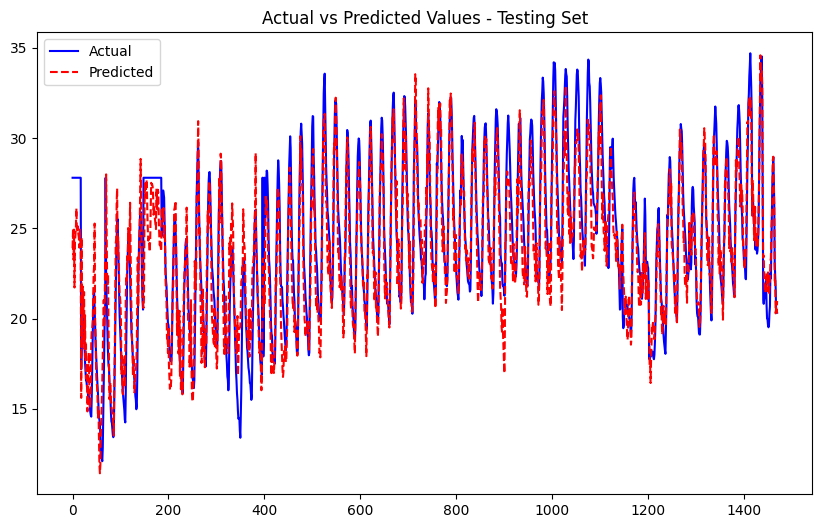

Processing node 6...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0690
Epoch [2/50], Train Loss: 0.0574
Epoch [3/50], Train Loss: 0.0531
Epoch [4/50], Train Loss: 0.0494
Epoch [5/50], Train Loss: 0.0472
Epoch [6/50], Train Loss: 0.0455
Epoch [7/50], Train Loss: 0.0441
Epoch [8/50], Train Loss: 0.0431
Epoch [9/50], Train Loss: 0.0420
Epoch [10/50], Train Loss: 0.0411
Epoch [11/50], Train Loss: 0.0407
Epoch [12/50], Train Loss: 0.0396
Epoch [13/50], Train Loss: 0.0389
Epoch [14/50], Train Loss: 0.0385
Epoch [15/50], Train Loss: 0.0385
Epoch [16/50], Train Loss: 0.0378
Epoch [17/50], Train Loss: 0.0377
Epoch [18/50], Train Loss: 0.0378
Epoch [19/50], Train Loss: 0.0376
Epoch [20/50], Train Loss: 0.0373
Epoch [21/50], Train Loss: 0.0367
Epoch [22/50], Train Loss: 0.0365
Epoch [23/50], Train Loss: 0.0365
Epoch [24/50], Train Loss: 0.0362
Epoch [25/50], Train Loss: 0.0362
Epoch [26/50], Train Loss: 0.0360
Epoch [27/50], Train Loss: 0.0359
Epoch [28/50], Train Loss: 0.0353
Epoch [29/50], Train Loss: 0.0354
Epoch [30/50], Train Lo

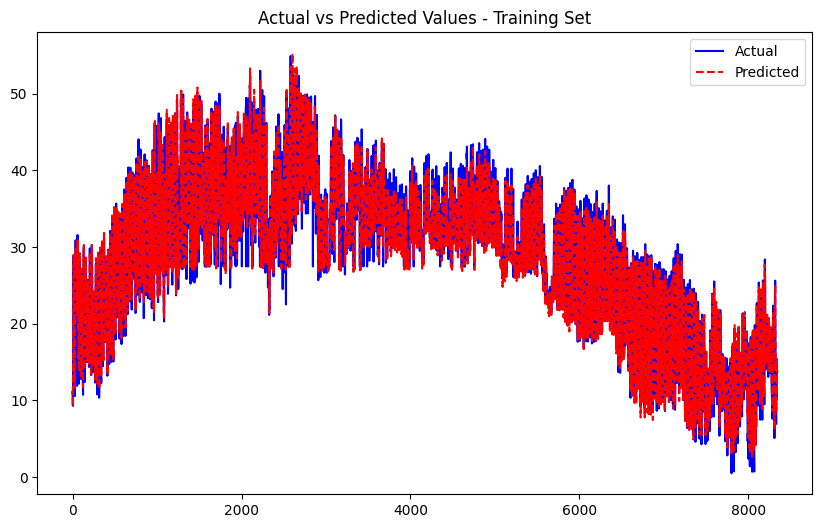

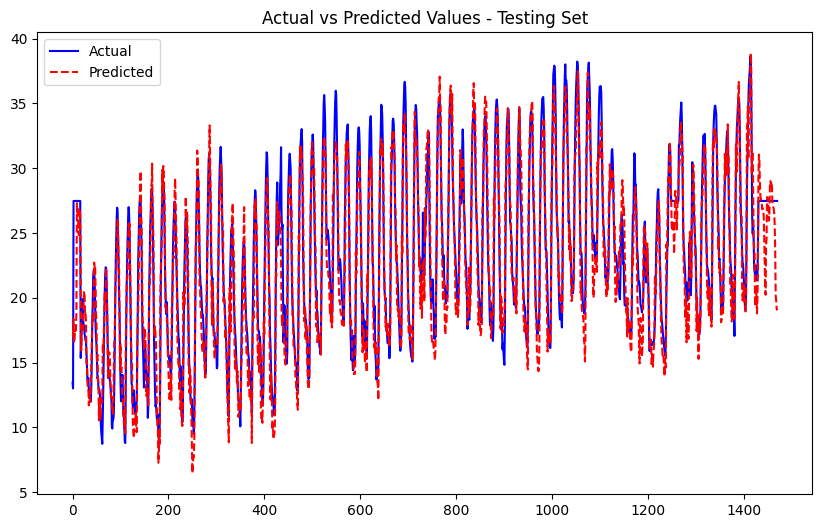

Processing node 7...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0615
Epoch [2/50], Train Loss: 0.0481
Epoch [3/50], Train Loss: 0.0416
Epoch [4/50], Train Loss: 0.0381
Epoch [5/50], Train Loss: 0.0352
Epoch [6/50], Train Loss: 0.0332
Epoch [7/50], Train Loss: 0.0317
Epoch [8/50], Train Loss: 0.0299
Epoch [9/50], Train Loss: 0.0296
Epoch [10/50], Train Loss: 0.0288
Epoch [11/50], Train Loss: 0.0284
Epoch [12/50], Train Loss: 0.0276
Epoch [13/50], Train Loss: 0.0276
Epoch [14/50], Train Loss: 0.0269
Epoch [15/50], Train Loss: 0.0264
Epoch [16/50], Train Loss: 0.0262
Epoch [17/50], Train Loss: 0.0261
Epoch [18/50], Train Loss: 0.0259
Epoch [19/50], Train Loss: 0.0254
Epoch [20/50], Train Loss: 0.0256
Epoch [21/50], Train Loss: 0.0248
Epoch [22/50], Train Loss: 0.0248
Epoch [23/50], Train Loss: 0.0249
Epoch [24/50], Train Loss: 0.0245
Epoch [25/50], Train Loss: 0.0244
Epoch [26/50], Train Loss: 0.0245
Epoch [27/50], Train Loss: 0.0240
Epoch [28/50], Train Loss: 0.0242
Epoch [29/50], Train Loss: 0.0240
Epoch [30/50], Train Lo

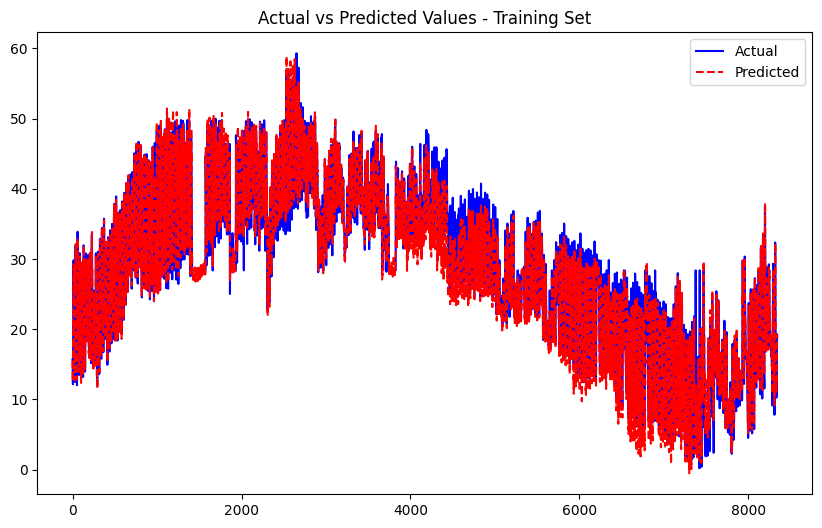

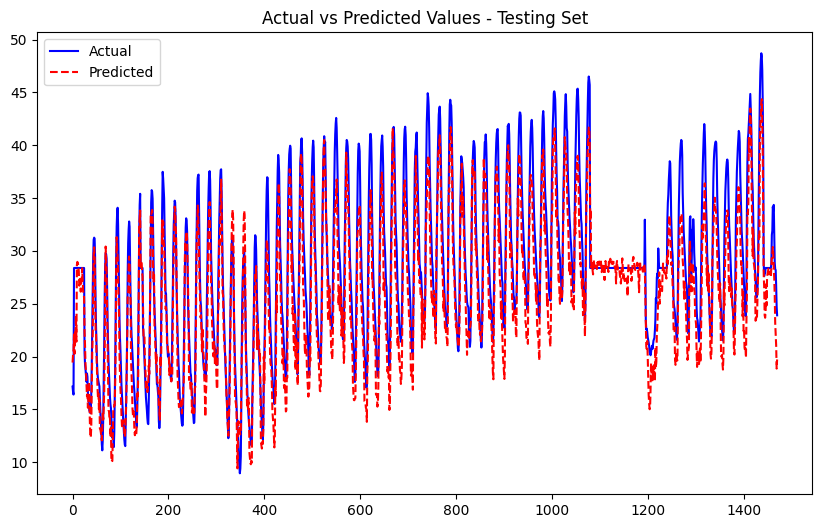

Processing node 8...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0810
Epoch [2/50], Train Loss: 0.0645
Epoch [3/50], Train Loss: 0.0569
Epoch [4/50], Train Loss: 0.0519
Epoch [5/50], Train Loss: 0.0489
Epoch [6/50], Train Loss: 0.0460
Epoch [7/50], Train Loss: 0.0441
Epoch [8/50], Train Loss: 0.0429
Epoch [9/50], Train Loss: 0.0406
Epoch [10/50], Train Loss: 0.0405
Epoch [11/50], Train Loss: 0.0387
Epoch [12/50], Train Loss: 0.0387
Epoch [13/50], Train Loss: 0.0386
Epoch [14/50], Train Loss: 0.0378
Epoch [15/50], Train Loss: 0.0367
Epoch [16/50], Train Loss: 0.0368
Epoch [17/50], Train Loss: 0.0363
Epoch [18/50], Train Loss: 0.0360
Epoch [19/50], Train Loss: 0.0354
Epoch [20/50], Train Loss: 0.0353
Epoch [21/50], Train Loss: 0.0347
Epoch [22/50], Train Loss: 0.0344
Epoch [23/50], Train Loss: 0.0343
Epoch [24/50], Train Loss: 0.0345
Epoch [25/50], Train Loss: 0.0337
Epoch [26/50], Train Loss: 0.0344
Epoch [27/50], Train Loss: 0.0335
Epoch [28/50], Train Loss: 0.0334
Epoch [29/50], Train Loss: 0.0336
Epoch [30/50], Train Lo

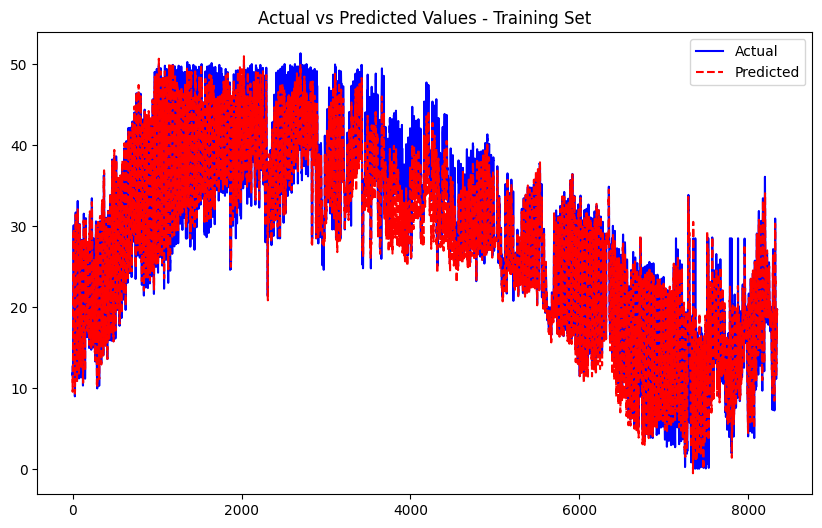

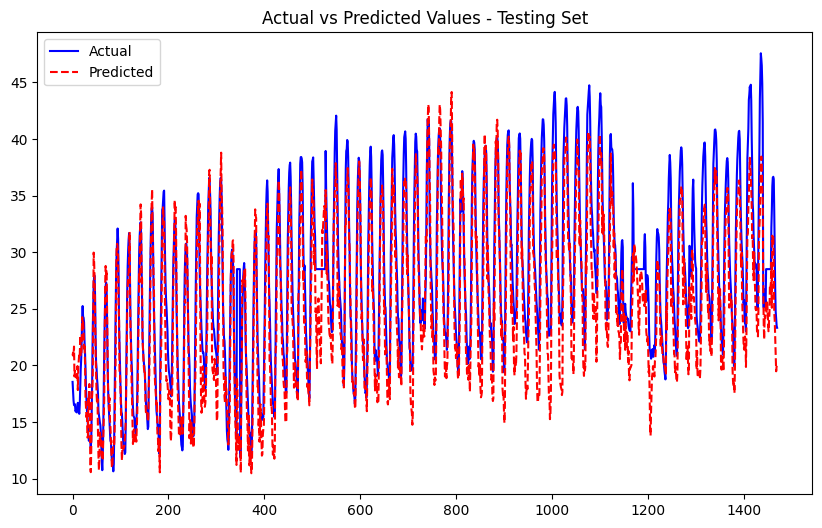

Processing node 9...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0484
Epoch [2/50], Train Loss: 0.0398
Epoch [3/50], Train Loss: 0.0356
Epoch [4/50], Train Loss: 0.0326
Epoch [5/50], Train Loss: 0.0311
Epoch [6/50], Train Loss: 0.0300
Epoch [7/50], Train Loss: 0.0290
Epoch [8/50], Train Loss: 0.0281
Epoch [9/50], Train Loss: 0.0272
Epoch [10/50], Train Loss: 0.0274
Epoch [11/50], Train Loss: 0.0268
Epoch [12/50], Train Loss: 0.0264
Epoch [13/50], Train Loss: 0.0259
Epoch [14/50], Train Loss: 0.0260
Epoch [15/50], Train Loss: 0.0255
Epoch [16/50], Train Loss: 0.0251
Epoch [17/50], Train Loss: 0.0256
Epoch [18/50], Train Loss: 0.0247
Epoch [19/50], Train Loss: 0.0243
Epoch [20/50], Train Loss: 0.0244
Epoch [21/50], Train Loss: 0.0242
Epoch [22/50], Train Loss: 0.0243
Epoch [23/50], Train Loss: 0.0243
Epoch [24/50], Train Loss: 0.0237
Epoch [25/50], Train Loss: 0.0241
Epoch [26/50], Train Loss: 0.0237
Epoch [27/50], Train Loss: 0.0235
Epoch [28/50], Train Loss: 0.0233
Epoch [29/50], Train Loss: 0.0234
Epoch [30/50], Train Lo

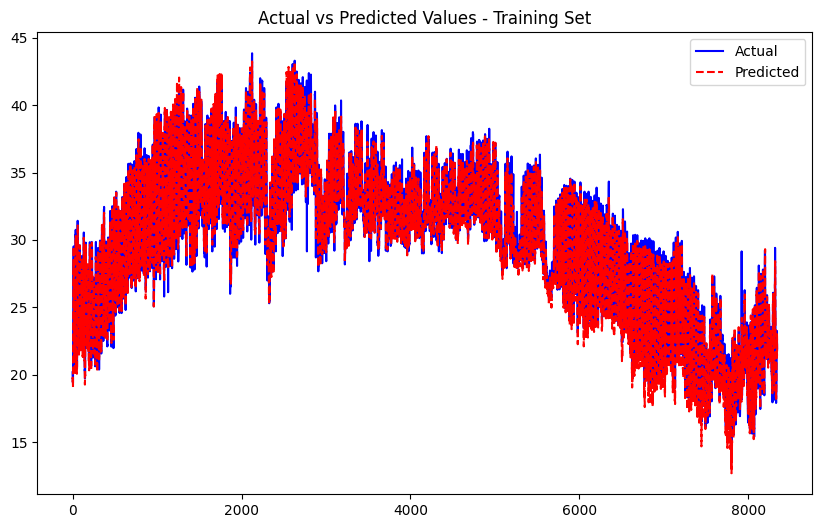

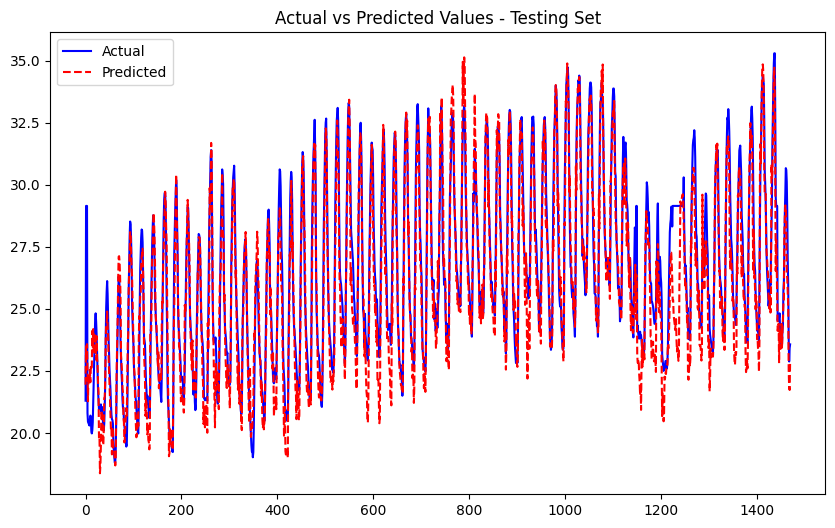

Processing node 10...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2337
Epoch [2/50], Train Loss: 0.2314
Epoch [3/50], Train Loss: 0.1727
Epoch [4/50], Train Loss: 0.1445
Epoch [5/50], Train Loss: 0.1287
Epoch [6/50], Train Loss: 0.1124
Epoch [7/50], Train Loss: 0.1019
Epoch [8/50], Train Loss: 0.0929
Epoch [9/50], Train Loss: 0.0824
Epoch [10/50], Train Loss: 0.0801
Epoch [11/50], Train Loss: 0.0750
Epoch [12/50], Train Loss: 0.0706
Epoch [13/50], Train Loss: 0.0693
Epoch [14/50], Train Loss: 0.0666
Epoch [15/50], Train Loss: 0.0642
Epoch [16/50], Train Loss: 0.0597
Epoch [17/50], Train Loss: 0.0604
Epoch [18/50], Train Loss: 0.0592
Epoch [19/50], Train Loss: 0.0556
Epoch [20/50], Train Loss: 0.0544
Epoch [21/50], Train Loss: 0.0547
Epoch [22/50], Train Loss: 0.0533
Epoch [23/50], Train Loss: 0.0553
Epoch [24/50], Train Loss: 0.0541
Epoch [25/50], Train Loss: 0.0506
Epoch [26/50], Train Loss: 0.0508
Epoch [27/50], Train Loss: 0.0506
Epoch [28/50], Train Loss: 0.0501
Epoch [29/50], Train Loss: 0.0496
Epoch [30/50], Train Lo

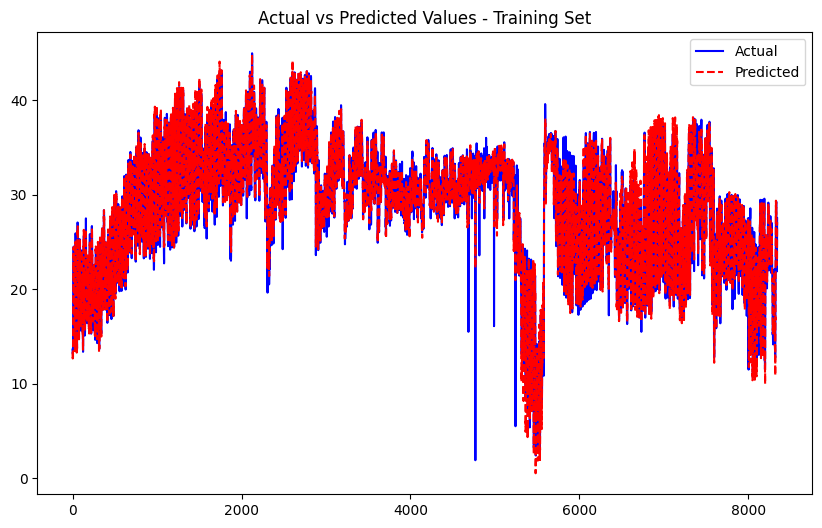

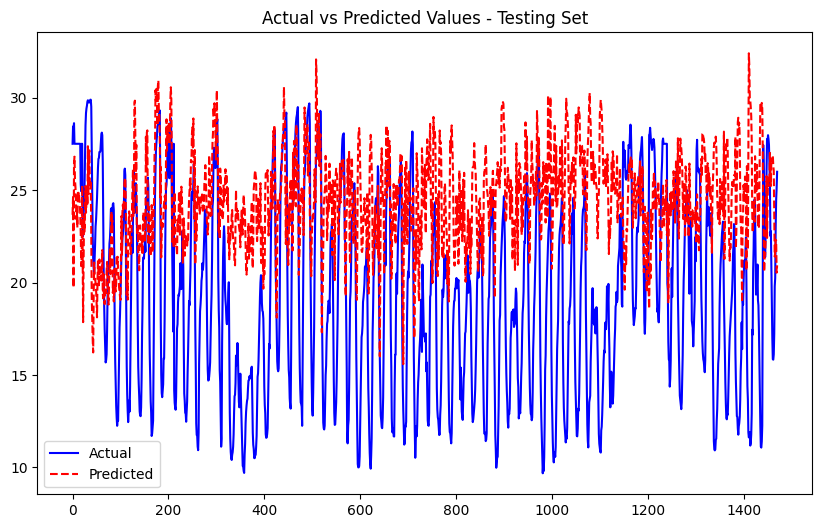

Processing node 11...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0895
Epoch [2/50], Train Loss: 0.0688
Epoch [3/50], Train Loss: 0.0543
Epoch [4/50], Train Loss: 0.0465
Epoch [5/50], Train Loss: 0.0422
Epoch [6/50], Train Loss: 0.0378
Epoch [7/50], Train Loss: 0.0361
Epoch [8/50], Train Loss: 0.0348
Epoch [9/50], Train Loss: 0.0330
Epoch [10/50], Train Loss: 0.0330
Epoch [11/50], Train Loss: 0.0324
Epoch [12/50], Train Loss: 0.0312
Epoch [13/50], Train Loss: 0.0302
Epoch [14/50], Train Loss: 0.0301
Epoch [15/50], Train Loss: 0.0299
Epoch [16/50], Train Loss: 0.0297
Epoch [17/50], Train Loss: 0.0290
Epoch [18/50], Train Loss: 0.0286
Epoch [19/50], Train Loss: 0.0287
Epoch [20/50], Train Loss: 0.0286
Epoch [21/50], Train Loss: 0.0285
Epoch [22/50], Train Loss: 0.0278
Epoch [23/50], Train Loss: 0.0277
Epoch [24/50], Train Loss: 0.0276
Epoch [25/50], Train Loss: 0.0270
Epoch [26/50], Train Loss: 0.0269
Epoch [27/50], Train Loss: 0.0266
Epoch [28/50], Train Loss: 0.0271
Epoch [29/50], Train Loss: 0.0269
Epoch [30/50], Train Lo

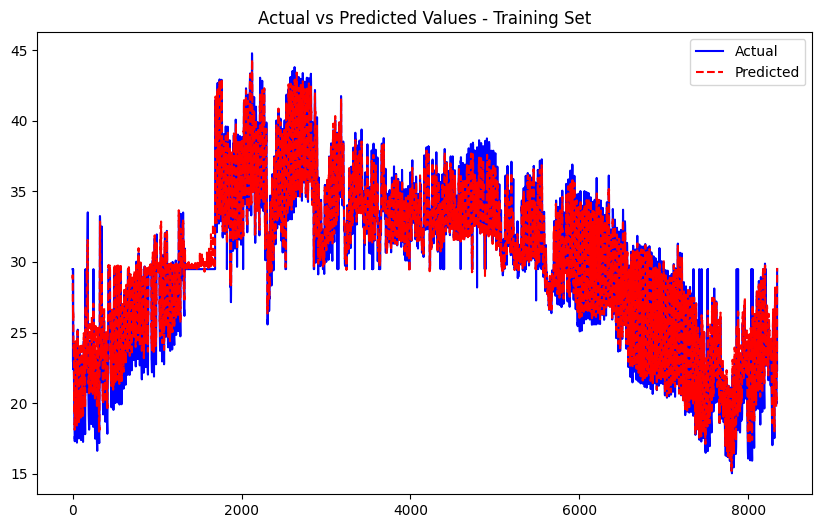

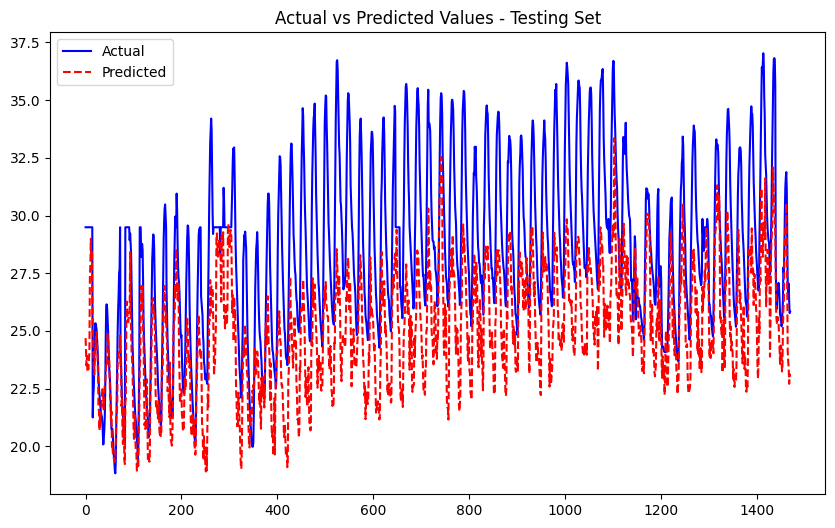

Processing node 12...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0409
Epoch [2/50], Train Loss: 0.0325
Epoch [3/50], Train Loss: 0.0293
Epoch [4/50], Train Loss: 0.0277
Epoch [5/50], Train Loss: 0.0254
Epoch [6/50], Train Loss: 0.0239
Epoch [7/50], Train Loss: 0.0231
Epoch [8/50], Train Loss: 0.0224
Epoch [9/50], Train Loss: 0.0216
Epoch [10/50], Train Loss: 0.0210
Epoch [11/50], Train Loss: 0.0207
Epoch [12/50], Train Loss: 0.0205
Epoch [13/50], Train Loss: 0.0205
Epoch [14/50], Train Loss: 0.0204
Epoch [15/50], Train Loss: 0.0201
Epoch [16/50], Train Loss: 0.0196
Epoch [17/50], Train Loss: 0.0199
Epoch [18/50], Train Loss: 0.0195
Epoch [19/50], Train Loss: 0.0192
Epoch [20/50], Train Loss: 0.0192
Epoch [21/50], Train Loss: 0.0189
Epoch [22/50], Train Loss: 0.0188
Epoch [23/50], Train Loss: 0.0190
Epoch [24/50], Train Loss: 0.0182
Epoch [25/50], Train Loss: 0.0189
Epoch [26/50], Train Loss: 0.0184
Epoch [27/50], Train Loss: 0.0184
Epoch [28/50], Train Loss: 0.0182
Epoch [29/50], Train Loss: 0.0178
Epoch [30/50], Train Lo

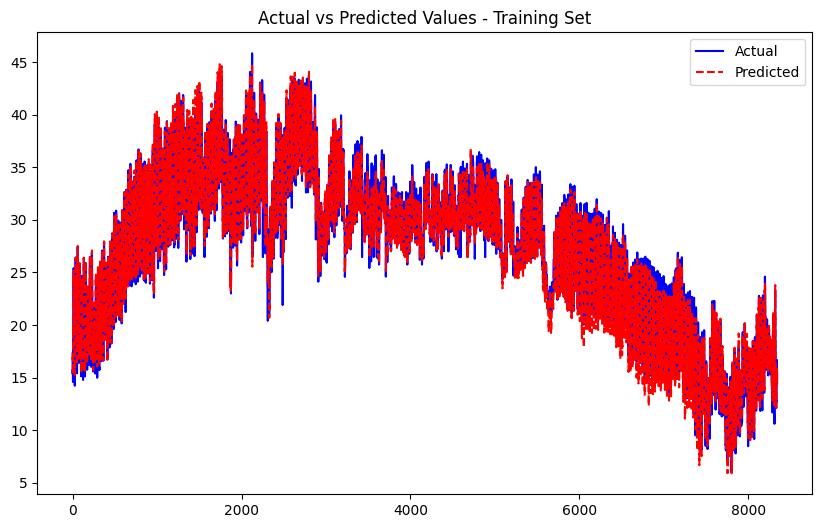

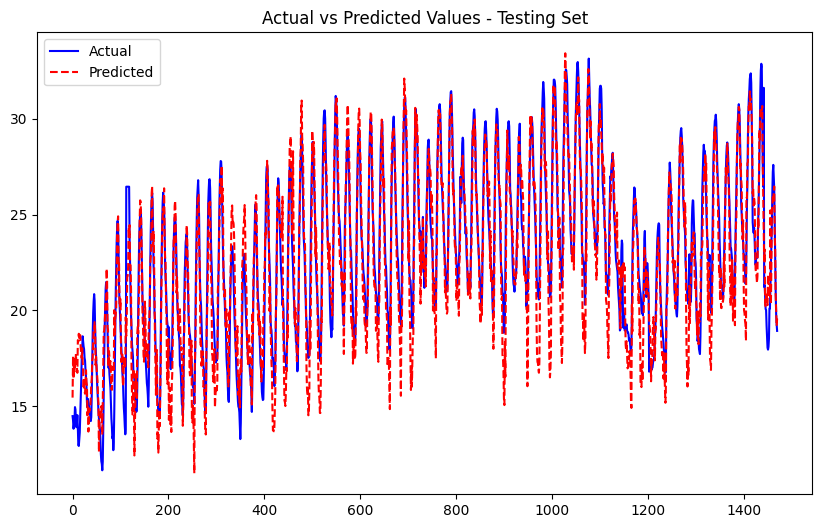

Processing node 13...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1359
Epoch [2/50], Train Loss: 0.1093
Epoch [3/50], Train Loss: 0.0889
Epoch [4/50], Train Loss: 0.0756
Epoch [5/50], Train Loss: 0.0656
Epoch [6/50], Train Loss: 0.0584
Epoch [7/50], Train Loss: 0.0517
Epoch [8/50], Train Loss: 0.0474
Epoch [9/50], Train Loss: 0.0422
Epoch [10/50], Train Loss: 0.0382
Epoch [11/50], Train Loss: 0.0346
Epoch [12/50], Train Loss: 0.0340
Epoch [13/50], Train Loss: 0.0320
Epoch [14/50], Train Loss: 0.0296
Epoch [15/50], Train Loss: 0.0298
Epoch [16/50], Train Loss: 0.0291
Epoch [17/50], Train Loss: 0.0282
Epoch [18/50], Train Loss: 0.0268
Epoch [19/50], Train Loss: 0.0268
Epoch [20/50], Train Loss: 0.0260
Epoch [21/50], Train Loss: 0.0259
Epoch [22/50], Train Loss: 0.0247
Epoch [23/50], Train Loss: 0.0249
Epoch [24/50], Train Loss: 0.0237
Epoch [25/50], Train Loss: 0.0238
Epoch [26/50], Train Loss: 0.0237
Epoch [27/50], Train Loss: 0.0241
Epoch [28/50], Train Loss: 0.0224
Epoch [29/50], Train Loss: 0.0221
Epoch [30/50], Train Lo

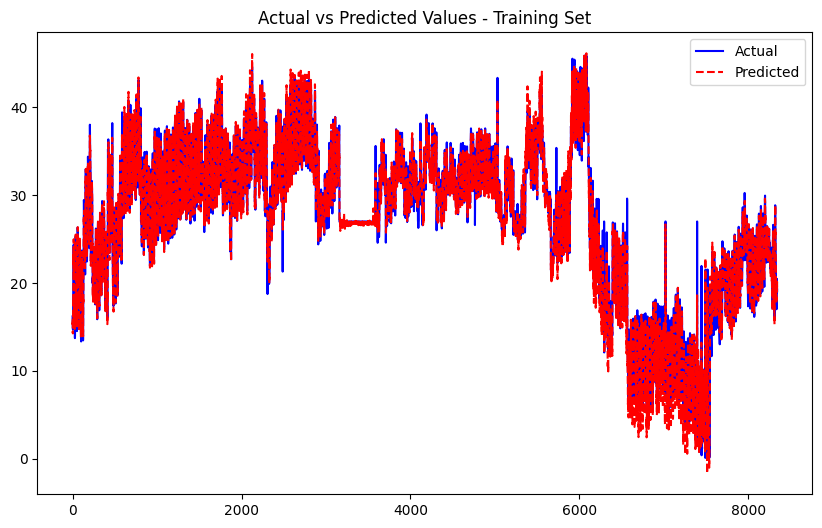

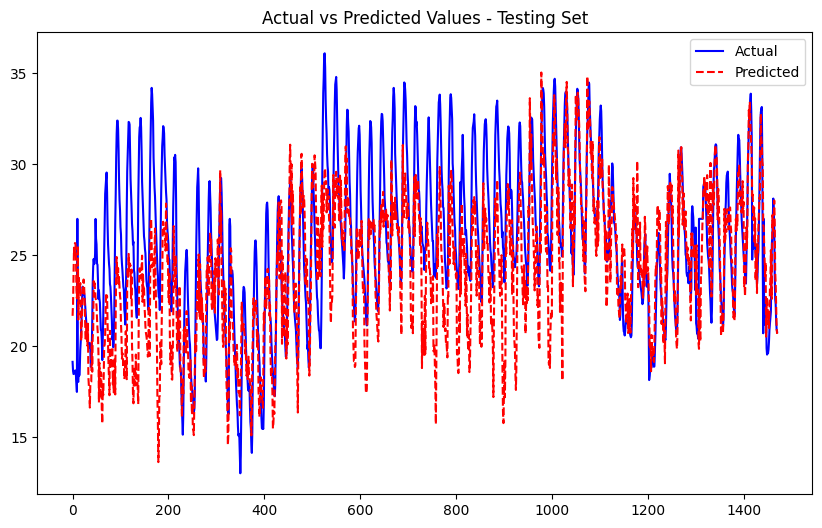

Processing node 14...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0602
Epoch [2/50], Train Loss: 0.0452
Epoch [3/50], Train Loss: 0.0385
Epoch [4/50], Train Loss: 0.0352
Epoch [5/50], Train Loss: 0.0334
Epoch [6/50], Train Loss: 0.0319
Epoch [7/50], Train Loss: 0.0304
Epoch [8/50], Train Loss: 0.0295
Epoch [9/50], Train Loss: 0.0288
Epoch [10/50], Train Loss: 0.0283
Epoch [11/50], Train Loss: 0.0275
Epoch [12/50], Train Loss: 0.0274
Epoch [13/50], Train Loss: 0.0270
Epoch [14/50], Train Loss: 0.0264
Epoch [15/50], Train Loss: 0.0262
Epoch [16/50], Train Loss: 0.0260
Epoch [17/50], Train Loss: 0.0258
Epoch [18/50], Train Loss: 0.0255
Epoch [19/50], Train Loss: 0.0253
Epoch [20/50], Train Loss: 0.0254
Epoch [21/50], Train Loss: 0.0251
Epoch [22/50], Train Loss: 0.0249
Epoch [23/50], Train Loss: 0.0245
Epoch [24/50], Train Loss: 0.0247
Epoch [25/50], Train Loss: 0.0249
Epoch [26/50], Train Loss: 0.0244
Epoch [27/50], Train Loss: 0.0244
Epoch [28/50], Train Loss: 0.0245
Epoch [29/50], Train Loss: 0.0242
Epoch [30/50], Train Lo

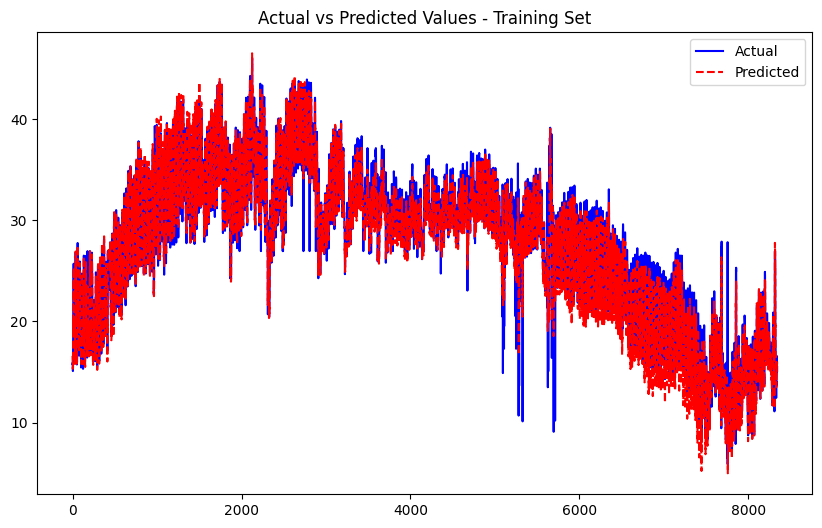

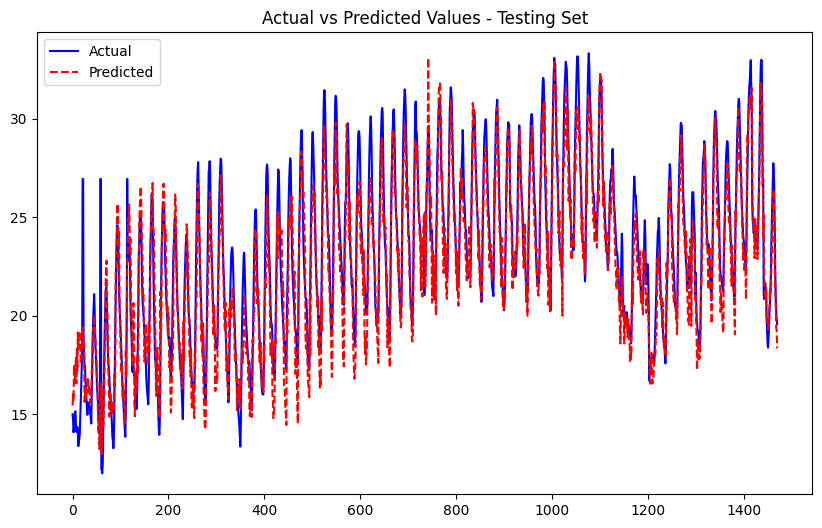

Processing node 15...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1864
Epoch [2/50], Train Loss: 0.1573
Epoch [3/50], Train Loss: 0.1400
Epoch [4/50], Train Loss: 0.1277
Epoch [5/50], Train Loss: 0.1185
Epoch [6/50], Train Loss: 0.1130
Epoch [7/50], Train Loss: 0.1084
Epoch [8/50], Train Loss: 0.1053
Epoch [9/50], Train Loss: 0.1031
Epoch [10/50], Train Loss: 0.1019
Epoch [11/50], Train Loss: 0.1000
Epoch [12/50], Train Loss: 0.0981
Epoch [13/50], Train Loss: 0.0970
Epoch [14/50], Train Loss: 0.0962
Epoch [15/50], Train Loss: 0.0955
Epoch [16/50], Train Loss: 0.0947
Epoch [17/50], Train Loss: 0.0945
Epoch [18/50], Train Loss: 0.0940
Epoch [19/50], Train Loss: 0.0932
Epoch [20/50], Train Loss: 0.0933
Epoch [21/50], Train Loss: 0.0926
Epoch [22/50], Train Loss: 0.0920
Epoch [23/50], Train Loss: 0.0921
Epoch [24/50], Train Loss: 0.0921
Epoch [25/50], Train Loss: 0.0915
Epoch [26/50], Train Loss: 0.0916
Epoch [27/50], Train Loss: 0.0914
Epoch [28/50], Train Loss: 0.0914
Epoch [29/50], Train Loss: 0.0910
Epoch [30/50], Train Lo

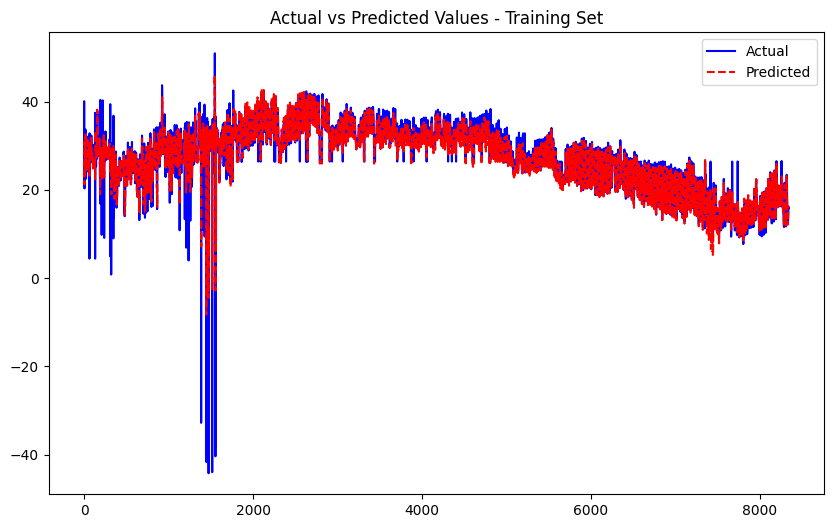

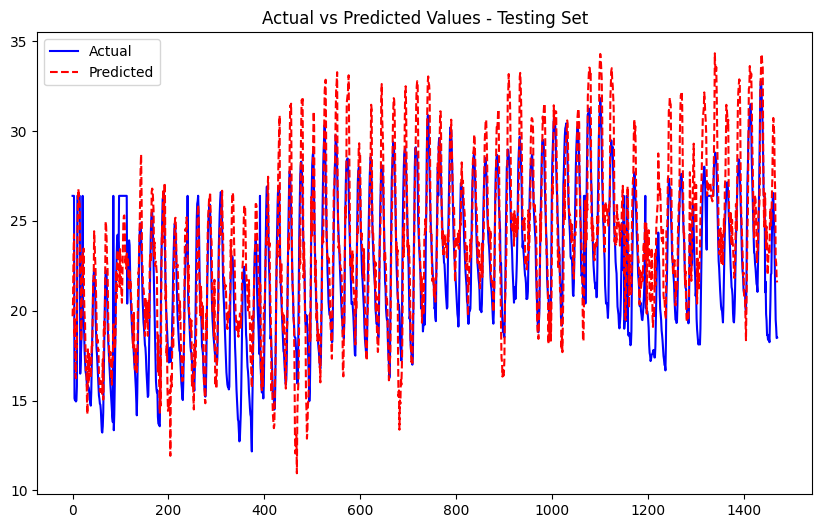

Processing node 16...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1463
Epoch [2/50], Train Loss: 0.1220
Epoch [3/50], Train Loss: 0.1058
Epoch [4/50], Train Loss: 0.0910
Epoch [5/50], Train Loss: 0.0802
Epoch [6/50], Train Loss: 0.0731
Epoch [7/50], Train Loss: 0.0630
Epoch [8/50], Train Loss: 0.0560
Epoch [9/50], Train Loss: 0.0519
Epoch [10/50], Train Loss: 0.0482
Epoch [11/50], Train Loss: 0.0440
Epoch [12/50], Train Loss: 0.0420
Epoch [13/50], Train Loss: 0.0405
Epoch [14/50], Train Loss: 0.0387
Epoch [15/50], Train Loss: 0.0378
Epoch [16/50], Train Loss: 0.0342
Epoch [17/50], Train Loss: 0.0326
Epoch [18/50], Train Loss: 0.0350
Epoch [19/50], Train Loss: 0.0329
Epoch [20/50], Train Loss: 0.0312
Epoch [21/50], Train Loss: 0.0306
Epoch [22/50], Train Loss: 0.0306
Epoch [23/50], Train Loss: 0.0288
Epoch [24/50], Train Loss: 0.0273
Epoch [25/50], Train Loss: 0.0274
Epoch [26/50], Train Loss: 0.0283
Epoch [27/50], Train Loss: 0.0268
Epoch [28/50], Train Loss: 0.0270
Epoch [29/50], Train Loss: 0.0262
Epoch [30/50], Train Lo

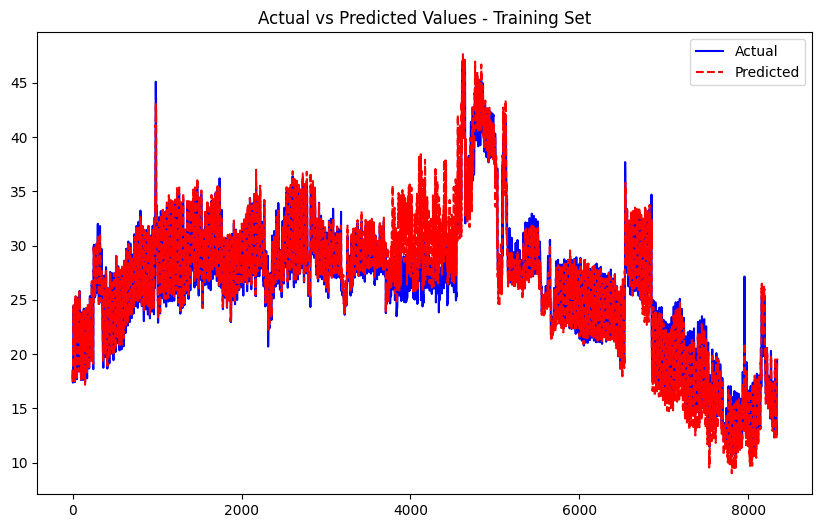

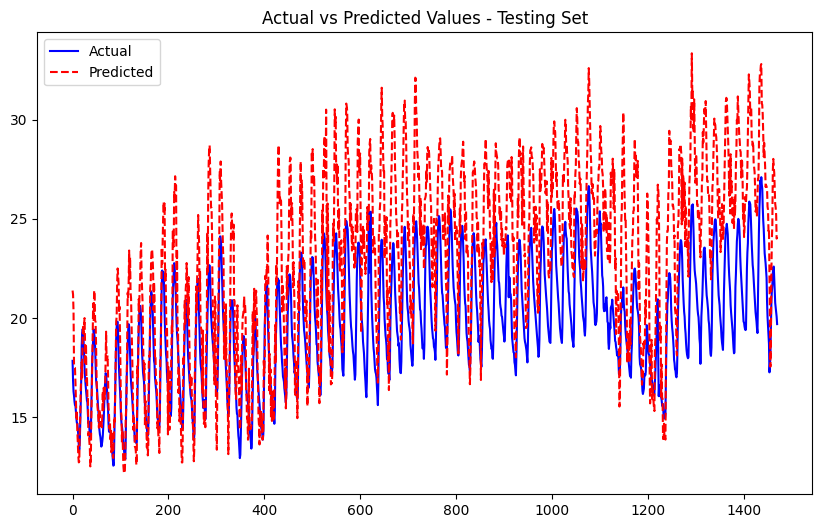

Processing node 17...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0803
Epoch [2/50], Train Loss: 0.0541
Epoch [3/50], Train Loss: 0.0444
Epoch [4/50], Train Loss: 0.0377
Epoch [5/50], Train Loss: 0.0333
Epoch [6/50], Train Loss: 0.0315
Epoch [7/50], Train Loss: 0.0298
Epoch [8/50], Train Loss: 0.0280
Epoch [9/50], Train Loss: 0.0272
Epoch [10/50], Train Loss: 0.0269
Epoch [11/50], Train Loss: 0.0260
Epoch [12/50], Train Loss: 0.0254
Epoch [13/50], Train Loss: 0.0245
Epoch [14/50], Train Loss: 0.0244
Epoch [15/50], Train Loss: 0.0245
Epoch [16/50], Train Loss: 0.0241
Epoch [17/50], Train Loss: 0.0237
Epoch [18/50], Train Loss: 0.0234
Epoch [19/50], Train Loss: 0.0234
Epoch [20/50], Train Loss: 0.0233
Epoch [21/50], Train Loss: 0.0232
Epoch [22/50], Train Loss: 0.0228
Epoch [23/50], Train Loss: 0.0226
Epoch [24/50], Train Loss: 0.0225
Epoch [25/50], Train Loss: 0.0225
Epoch [26/50], Train Loss: 0.0225
Epoch [27/50], Train Loss: 0.0221
Epoch [28/50], Train Loss: 0.0223
Epoch [29/50], Train Loss: 0.0224
Epoch [30/50], Train Lo

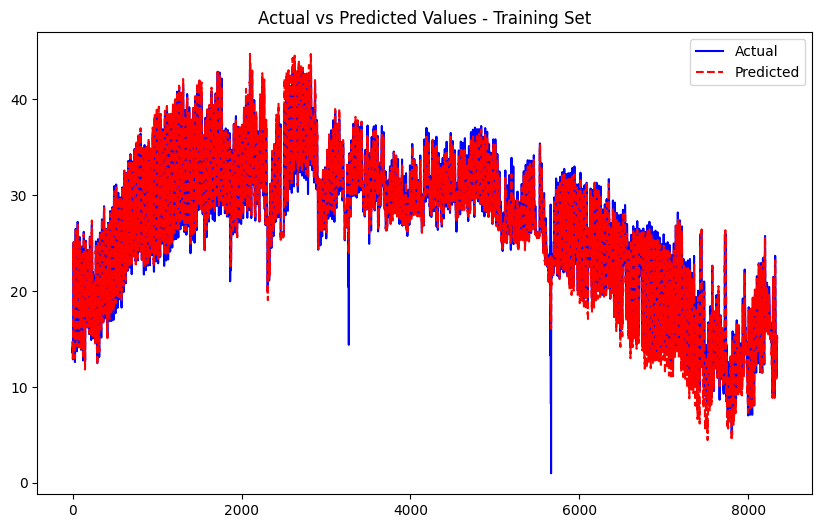

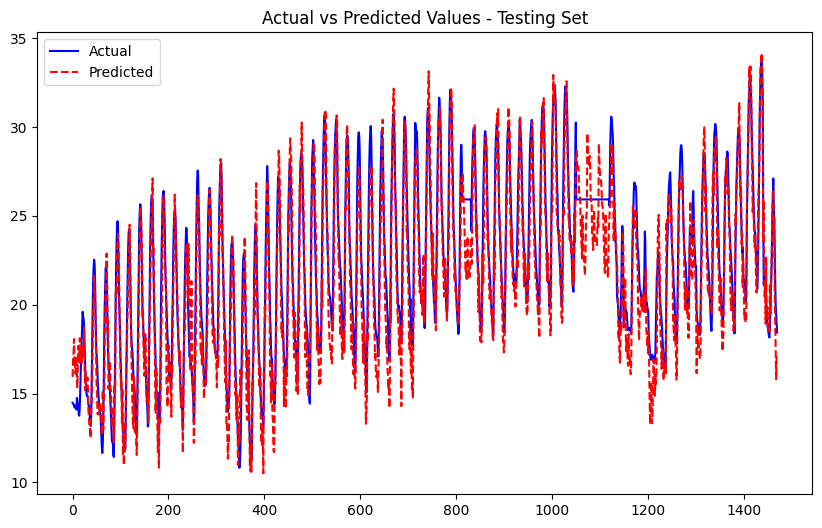

Processing node 18...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0511
Epoch [2/50], Train Loss: 0.0401
Epoch [3/50], Train Loss: 0.0363
Epoch [4/50], Train Loss: 0.0334
Epoch [5/50], Train Loss: 0.0308
Epoch [6/50], Train Loss: 0.0297
Epoch [7/50], Train Loss: 0.0288
Epoch [8/50], Train Loss: 0.0277
Epoch [9/50], Train Loss: 0.0271
Epoch [10/50], Train Loss: 0.0262
Epoch [11/50], Train Loss: 0.0261
Epoch [12/50], Train Loss: 0.0254
Epoch [13/50], Train Loss: 0.0247
Epoch [14/50], Train Loss: 0.0246
Epoch [15/50], Train Loss: 0.0246
Epoch [16/50], Train Loss: 0.0241
Epoch [17/50], Train Loss: 0.0242
Epoch [18/50], Train Loss: 0.0237
Epoch [19/50], Train Loss: 0.0238
Epoch [20/50], Train Loss: 0.0235
Epoch [21/50], Train Loss: 0.0234
Epoch [22/50], Train Loss: 0.0232
Epoch [23/50], Train Loss: 0.0228
Epoch [24/50], Train Loss: 0.0229
Epoch [25/50], Train Loss: 0.0230
Epoch [26/50], Train Loss: 0.0229
Epoch [27/50], Train Loss: 0.0227
Epoch [28/50], Train Loss: 0.0226
Epoch [29/50], Train Loss: 0.0223
Epoch [30/50], Train Lo

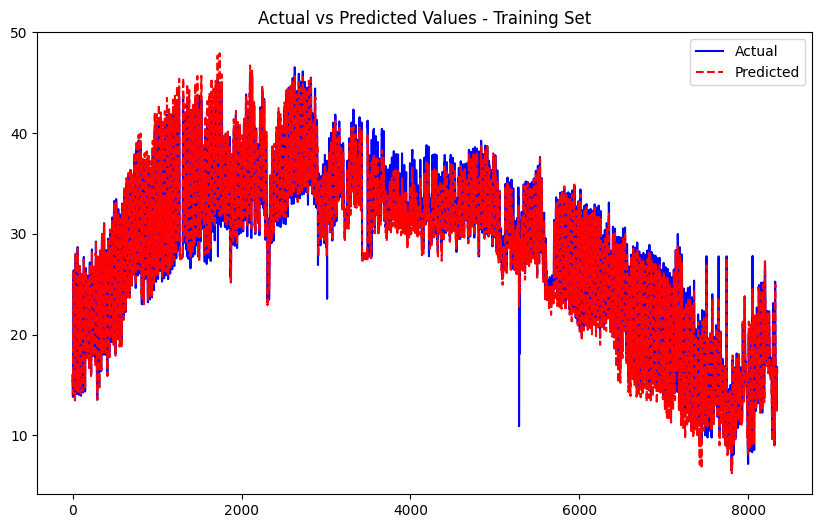

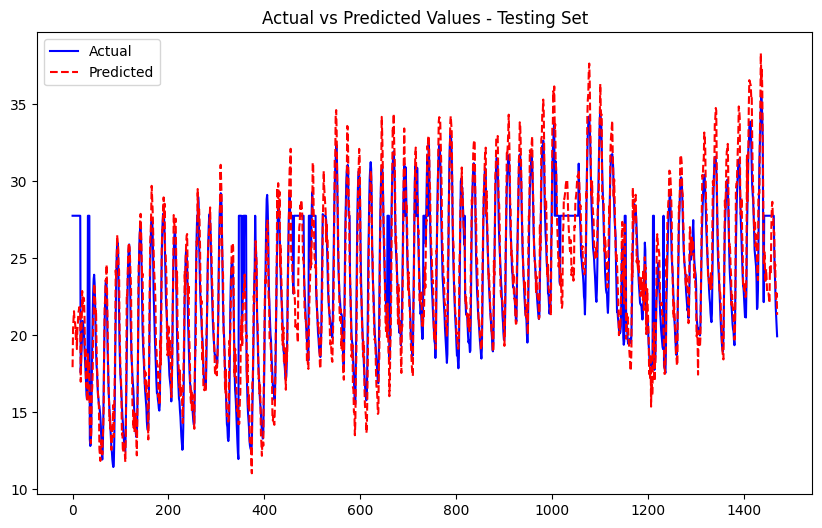

Processing node 19...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0676
Epoch [2/50], Train Loss: 0.0547
Epoch [3/50], Train Loss: 0.0497
Epoch [4/50], Train Loss: 0.0463
Epoch [5/50], Train Loss: 0.0438
Epoch [6/50], Train Loss: 0.0418
Epoch [7/50], Train Loss: 0.0403
Epoch [8/50], Train Loss: 0.0393
Epoch [9/50], Train Loss: 0.0387
Epoch [10/50], Train Loss: 0.0379
Epoch [11/50], Train Loss: 0.0373
Epoch [12/50], Train Loss: 0.0369
Epoch [13/50], Train Loss: 0.0366
Epoch [14/50], Train Loss: 0.0360
Epoch [15/50], Train Loss: 0.0358
Epoch [16/50], Train Loss: 0.0356
Epoch [17/50], Train Loss: 0.0351
Epoch [18/50], Train Loss: 0.0354
Epoch [19/50], Train Loss: 0.0351
Epoch [20/50], Train Loss: 0.0347
Epoch [21/50], Train Loss: 0.0345
Epoch [22/50], Train Loss: 0.0349
Epoch [23/50], Train Loss: 0.0341
Epoch [24/50], Train Loss: 0.0342
Epoch [25/50], Train Loss: 0.0344
Epoch [26/50], Train Loss: 0.0339
Epoch [27/50], Train Loss: 0.0340
Epoch [28/50], Train Loss: 0.0337
Epoch [29/50], Train Loss: 0.0337
Epoch [30/50], Train Lo

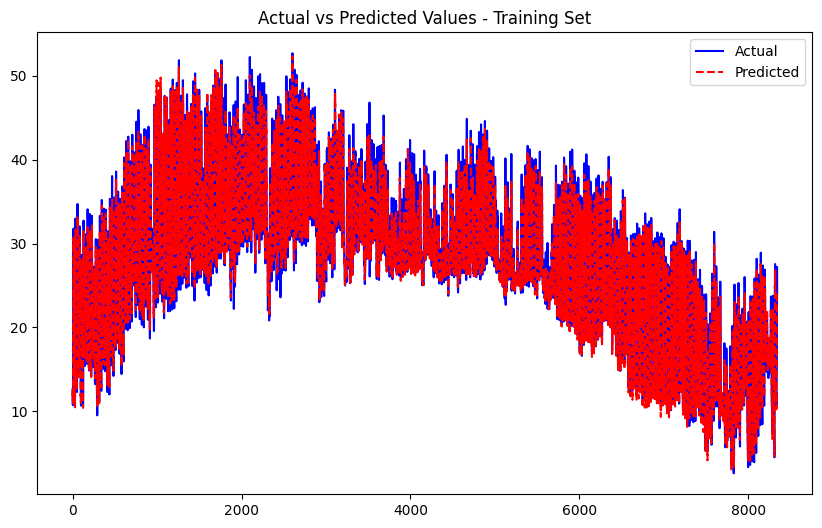

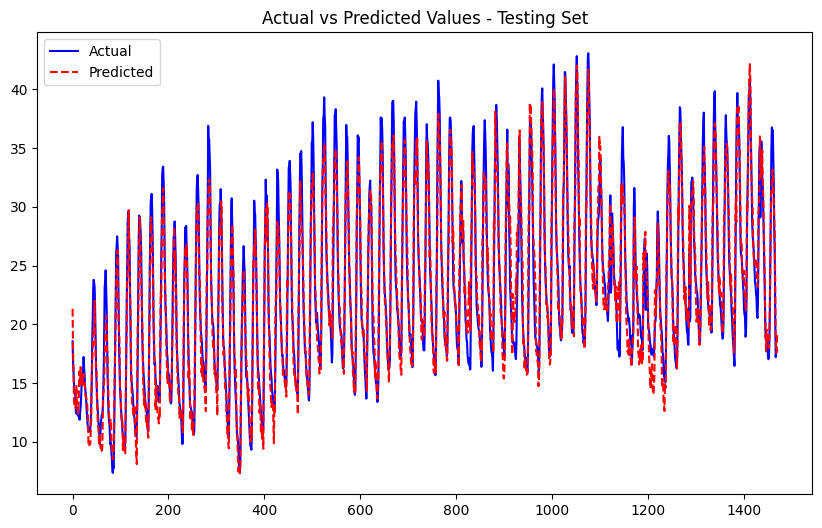

Processing node 20...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0649
Epoch [2/50], Train Loss: 0.0479
Epoch [3/50], Train Loss: 0.0424
Epoch [4/50], Train Loss: 0.0383
Epoch [5/50], Train Loss: 0.0357
Epoch [6/50], Train Loss: 0.0338
Epoch [7/50], Train Loss: 0.0326
Epoch [8/50], Train Loss: 0.0318
Epoch [9/50], Train Loss: 0.0309
Epoch [10/50], Train Loss: 0.0305
Epoch [11/50], Train Loss: 0.0303
Epoch [12/50], Train Loss: 0.0299
Epoch [13/50], Train Loss: 0.0295
Epoch [14/50], Train Loss: 0.0288
Epoch [15/50], Train Loss: 0.0287
Epoch [16/50], Train Loss: 0.0284
Epoch [17/50], Train Loss: 0.0282
Epoch [18/50], Train Loss: 0.0281
Epoch [19/50], Train Loss: 0.0278
Epoch [20/50], Train Loss: 0.0277
Epoch [21/50], Train Loss: 0.0276
Epoch [22/50], Train Loss: 0.0274
Epoch [23/50], Train Loss: 0.0273
Epoch [24/50], Train Loss: 0.0275
Epoch [25/50], Train Loss: 0.0270
Epoch [26/50], Train Loss: 0.0270
Epoch [27/50], Train Loss: 0.0269
Epoch [28/50], Train Loss: 0.0270
Epoch [29/50], Train Loss: 0.0266
Epoch [30/50], Train Lo

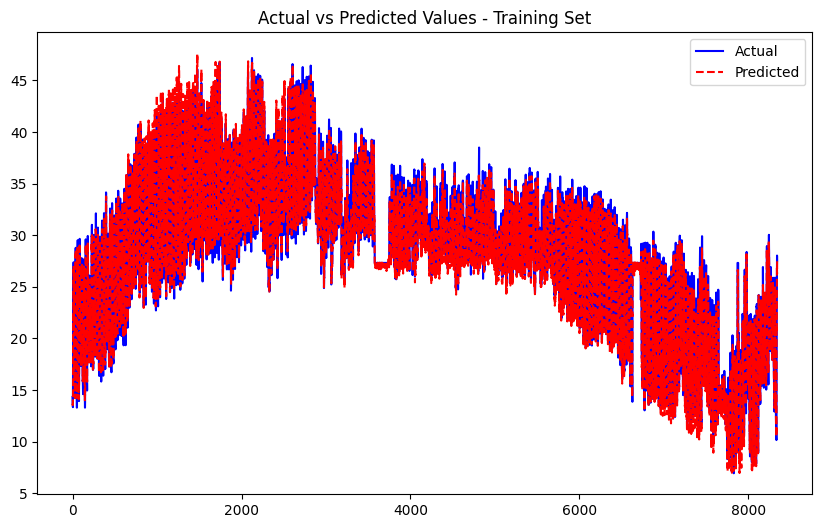

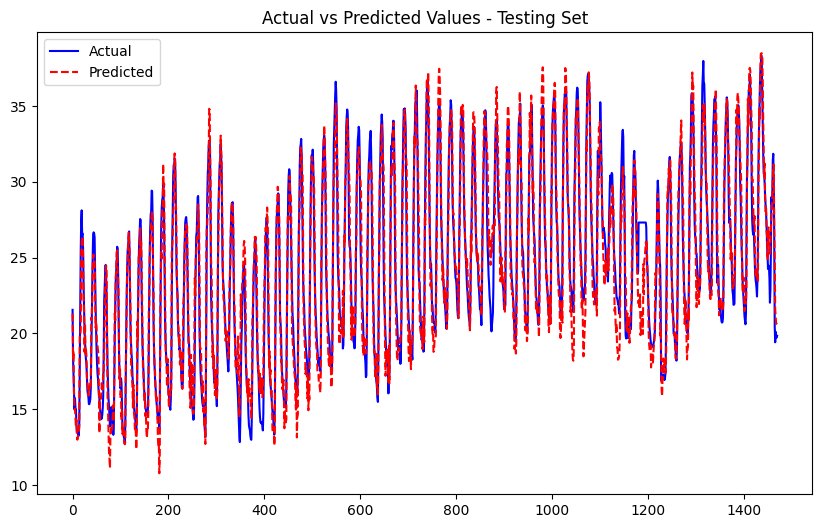

Processing node 21...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0466
Epoch [2/50], Train Loss: 0.0395
Epoch [3/50], Train Loss: 0.0369
Epoch [4/50], Train Loss: 0.0345
Epoch [5/50], Train Loss: 0.0328
Epoch [6/50], Train Loss: 0.0320
Epoch [7/50], Train Loss: 0.0312
Epoch [8/50], Train Loss: 0.0302
Epoch [9/50], Train Loss: 0.0301
Epoch [10/50], Train Loss: 0.0290
Epoch [11/50], Train Loss: 0.0288
Epoch [12/50], Train Loss: 0.0284
Epoch [13/50], Train Loss: 0.0284
Epoch [14/50], Train Loss: 0.0283
Epoch [15/50], Train Loss: 0.0279
Epoch [16/50], Train Loss: 0.0276
Epoch [17/50], Train Loss: 0.0272
Epoch [18/50], Train Loss: 0.0276
Epoch [19/50], Train Loss: 0.0272
Epoch [20/50], Train Loss: 0.0271
Epoch [21/50], Train Loss: 0.0270
Epoch [22/50], Train Loss: 0.0269
Epoch [23/50], Train Loss: 0.0268
Epoch [24/50], Train Loss: 0.0268
Epoch [25/50], Train Loss: 0.0267
Epoch [26/50], Train Loss: 0.0265
Epoch [27/50], Train Loss: 0.0265
Epoch [28/50], Train Loss: 0.0265
Epoch [29/50], Train Loss: 0.0267
Epoch [30/50], Train Lo

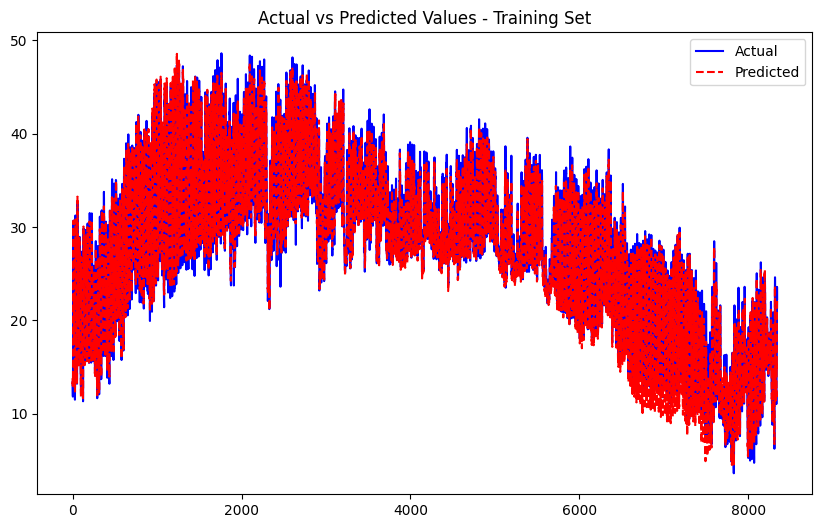

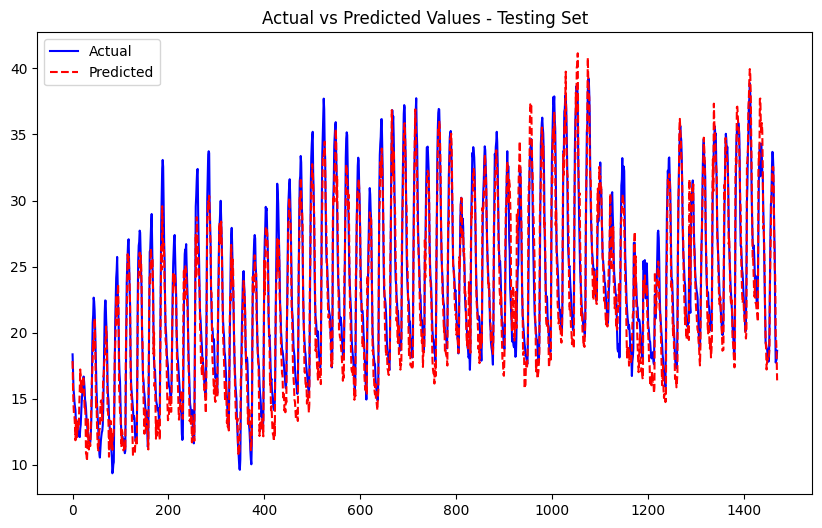

Processing node 22...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0591
Epoch [2/50], Train Loss: 0.0495
Epoch [3/50], Train Loss: 0.0455
Epoch [4/50], Train Loss: 0.0426
Epoch [5/50], Train Loss: 0.0403
Epoch [6/50], Train Loss: 0.0392
Epoch [7/50], Train Loss: 0.0378
Epoch [8/50], Train Loss: 0.0368
Epoch [9/50], Train Loss: 0.0366
Epoch [10/50], Train Loss: 0.0356
Epoch [11/50], Train Loss: 0.0356
Epoch [12/50], Train Loss: 0.0352
Epoch [13/50], Train Loss: 0.0346
Epoch [14/50], Train Loss: 0.0343
Epoch [15/50], Train Loss: 0.0341
Epoch [16/50], Train Loss: 0.0340
Epoch [17/50], Train Loss: 0.0340
Epoch [18/50], Train Loss: 0.0336
Epoch [19/50], Train Loss: 0.0336
Epoch [20/50], Train Loss: 0.0334
Epoch [21/50], Train Loss: 0.0332
Epoch [22/50], Train Loss: 0.0333
Epoch [23/50], Train Loss: 0.0334
Epoch [24/50], Train Loss: 0.0330
Epoch [25/50], Train Loss: 0.0332
Epoch [26/50], Train Loss: 0.0329
Epoch [27/50], Train Loss: 0.0329
Epoch [28/50], Train Loss: 0.0328
Epoch [29/50], Train Loss: 0.0326
Epoch [30/50], Train Lo

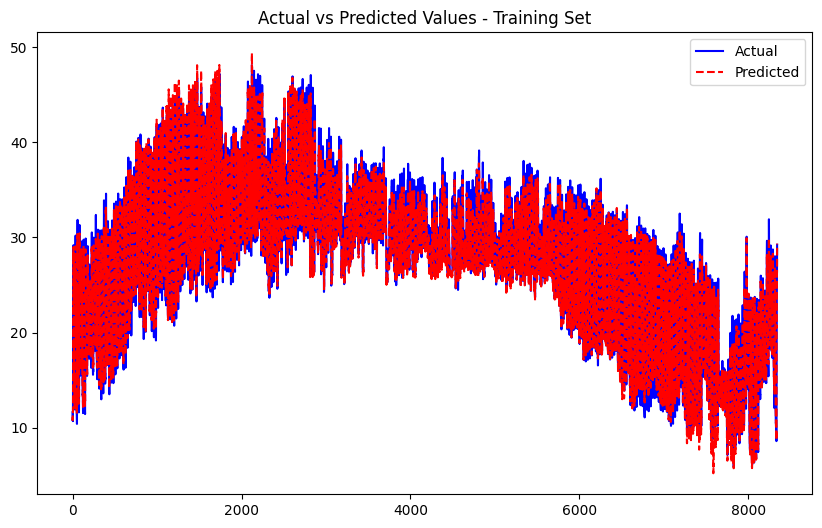

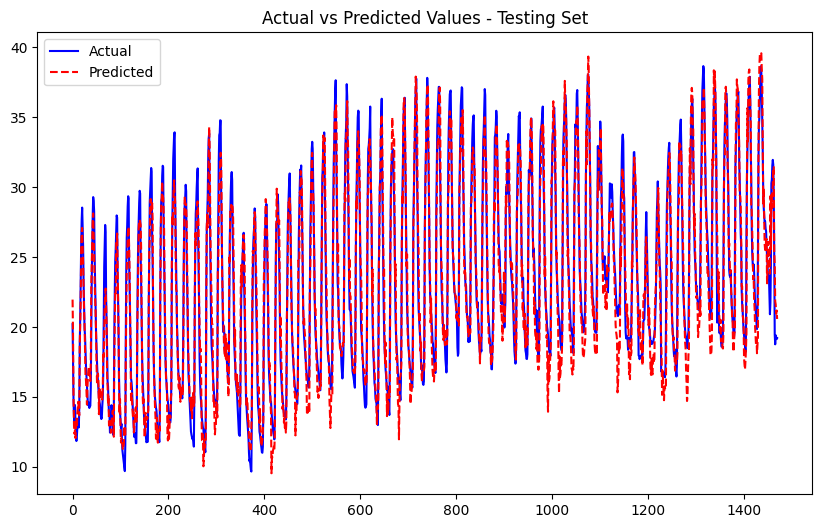

Processing node 23...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0637
Epoch [2/50], Train Loss: 0.0528
Epoch [3/50], Train Loss: 0.0481
Epoch [4/50], Train Loss: 0.0436
Epoch [5/50], Train Loss: 0.0408
Epoch [6/50], Train Loss: 0.0388
Epoch [7/50], Train Loss: 0.0372
Epoch [8/50], Train Loss: 0.0356
Epoch [9/50], Train Loss: 0.0344
Epoch [10/50], Train Loss: 0.0336
Epoch [11/50], Train Loss: 0.0329
Epoch [12/50], Train Loss: 0.0321
Epoch [13/50], Train Loss: 0.0319
Epoch [14/50], Train Loss: 0.0310
Epoch [15/50], Train Loss: 0.0308
Epoch [16/50], Train Loss: 0.0307
Epoch [17/50], Train Loss: 0.0303
Epoch [18/50], Train Loss: 0.0303
Epoch [19/50], Train Loss: 0.0300
Epoch [20/50], Train Loss: 0.0295
Epoch [21/50], Train Loss: 0.0293
Epoch [22/50], Train Loss: 0.0292
Epoch [23/50], Train Loss: 0.0288
Epoch [24/50], Train Loss: 0.0289
Epoch [25/50], Train Loss: 0.0286
Epoch [26/50], Train Loss: 0.0285
Epoch [27/50], Train Loss: 0.0288
Epoch [28/50], Train Loss: 0.0287
Epoch [29/50], Train Loss: 0.0281
Epoch [30/50], Train Lo

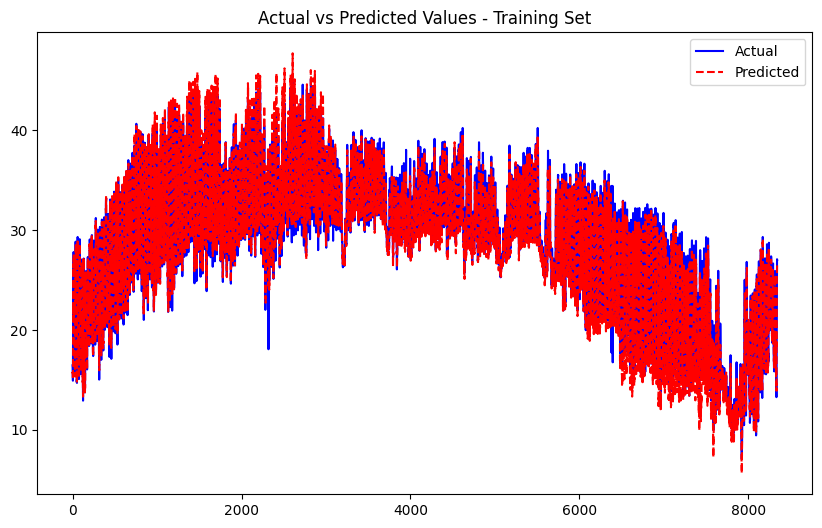

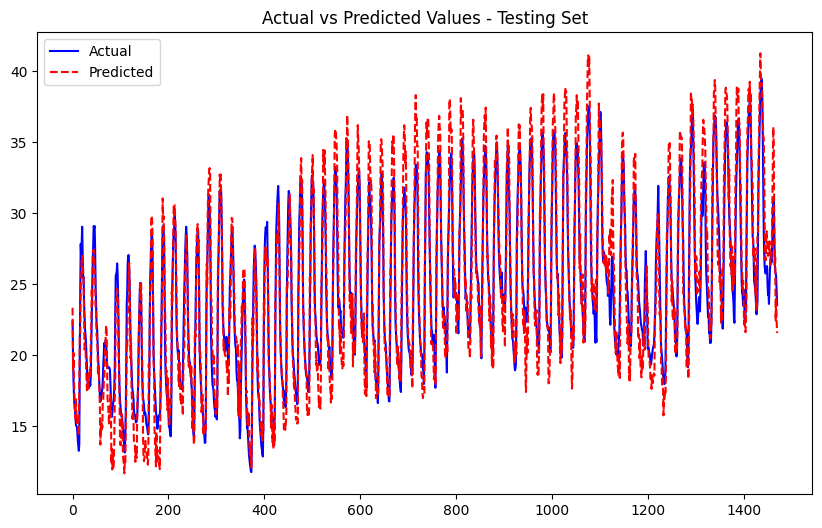

Processing node 24...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0489
Epoch [2/50], Train Loss: 0.0407
Epoch [3/50], Train Loss: 0.0362
Epoch [4/50], Train Loss: 0.0333
Epoch [5/50], Train Loss: 0.0320
Epoch [6/50], Train Loss: 0.0303
Epoch [7/50], Train Loss: 0.0294
Epoch [8/50], Train Loss: 0.0288
Epoch [9/50], Train Loss: 0.0282
Epoch [10/50], Train Loss: 0.0274
Epoch [11/50], Train Loss: 0.0271
Epoch [12/50], Train Loss: 0.0271
Epoch [13/50], Train Loss: 0.0265
Epoch [14/50], Train Loss: 0.0263
Epoch [15/50], Train Loss: 0.0261
Epoch [16/50], Train Loss: 0.0261
Epoch [17/50], Train Loss: 0.0257
Epoch [18/50], Train Loss: 0.0259
Epoch [19/50], Train Loss: 0.0257
Epoch [20/50], Train Loss: 0.0258
Epoch [21/50], Train Loss: 0.0255
Epoch [22/50], Train Loss: 0.0255
Epoch [23/50], Train Loss: 0.0251
Epoch [24/50], Train Loss: 0.0254
Epoch [25/50], Train Loss: 0.0252
Epoch [26/50], Train Loss: 0.0253
Epoch [27/50], Train Loss: 0.0247
Epoch [28/50], Train Loss: 0.0247
Epoch [29/50], Train Loss: 0.0247
Epoch [30/50], Train Lo

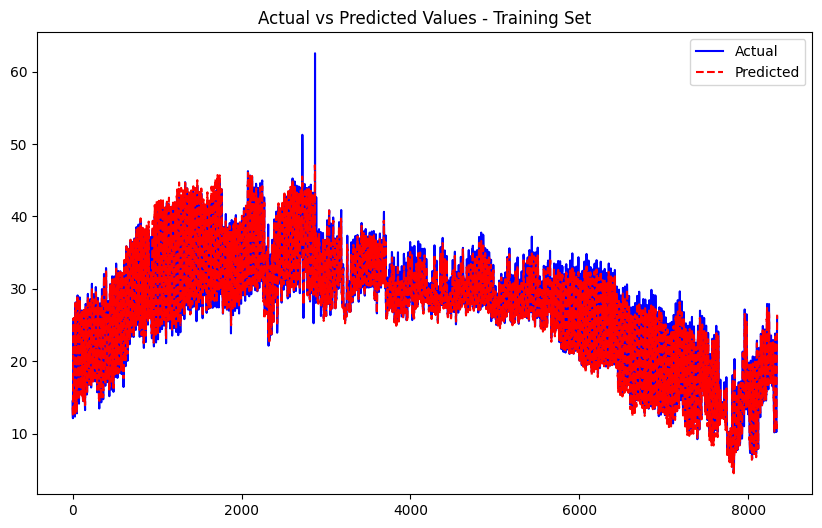

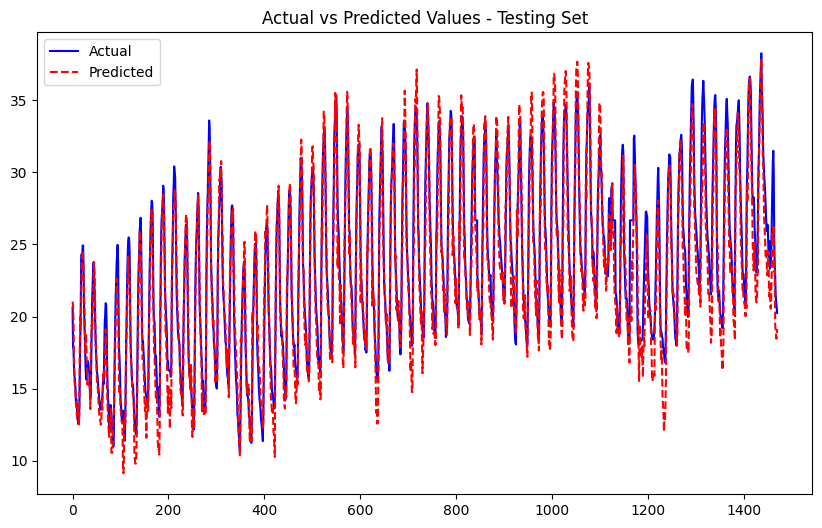

Processing node 25...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0451
Epoch [2/50], Train Loss: 0.0402
Epoch [3/50], Train Loss: 0.0350
Epoch [4/50], Train Loss: 0.0323
Epoch [5/50], Train Loss: 0.0305
Epoch [6/50], Train Loss: 0.0289
Epoch [7/50], Train Loss: 0.0280
Epoch [8/50], Train Loss: 0.0269
Epoch [9/50], Train Loss: 0.0261
Epoch [10/50], Train Loss: 0.0261
Epoch [11/50], Train Loss: 0.0257
Epoch [12/50], Train Loss: 0.0249
Epoch [13/50], Train Loss: 0.0246
Epoch [14/50], Train Loss: 0.0245
Epoch [15/50], Train Loss: 0.0238
Epoch [16/50], Train Loss: 0.0241
Epoch [17/50], Train Loss: 0.0239
Epoch [18/50], Train Loss: 0.0235
Epoch [19/50], Train Loss: 0.0234
Epoch [20/50], Train Loss: 0.0231
Epoch [21/50], Train Loss: 0.0229
Epoch [22/50], Train Loss: 0.0229
Epoch [23/50], Train Loss: 0.0228
Epoch [24/50], Train Loss: 0.0226
Epoch [25/50], Train Loss: 0.0228
Epoch [26/50], Train Loss: 0.0226
Epoch [27/50], Train Loss: 0.0224
Epoch [28/50], Train Loss: 0.0223
Epoch [29/50], Train Loss: 0.0226
Epoch [30/50], Train Lo

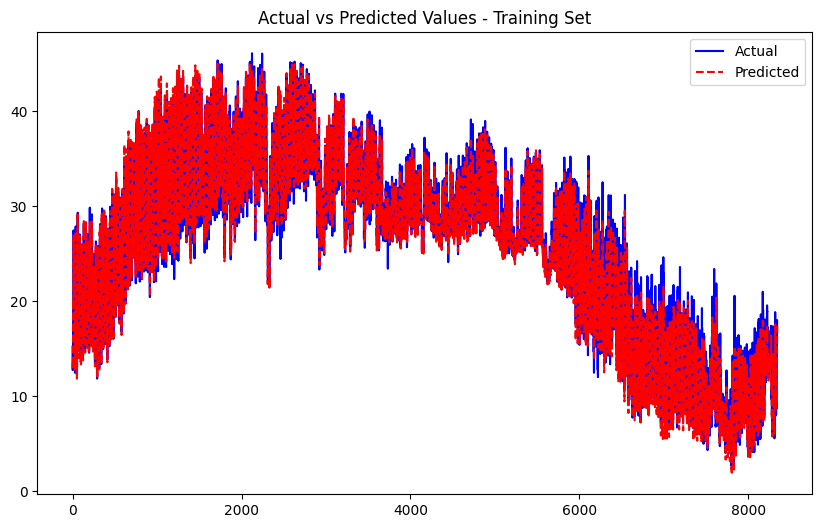

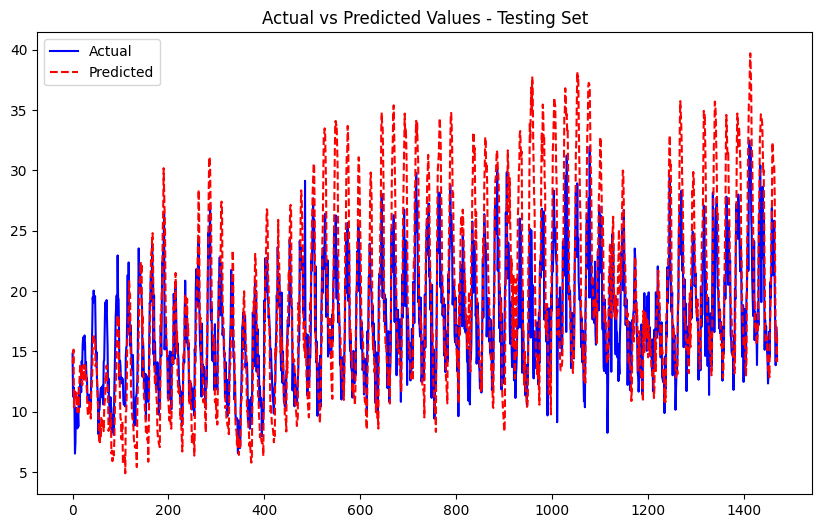

Processing node 26...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0515
Epoch [2/50], Train Loss: 0.0418
Epoch [3/50], Train Loss: 0.0371
Epoch [4/50], Train Loss: 0.0339
Epoch [5/50], Train Loss: 0.0319
Epoch [6/50], Train Loss: 0.0307
Epoch [7/50], Train Loss: 0.0295
Epoch [8/50], Train Loss: 0.0288
Epoch [9/50], Train Loss: 0.0280
Epoch [10/50], Train Loss: 0.0275
Epoch [11/50], Train Loss: 0.0270
Epoch [12/50], Train Loss: 0.0267
Epoch [13/50], Train Loss: 0.0267
Epoch [14/50], Train Loss: 0.0260
Epoch [15/50], Train Loss: 0.0257
Epoch [16/50], Train Loss: 0.0257
Epoch [17/50], Train Loss: 0.0255
Epoch [18/50], Train Loss: 0.0252
Epoch [19/50], Train Loss: 0.0251
Epoch [20/50], Train Loss: 0.0250
Epoch [21/50], Train Loss: 0.0250
Epoch [22/50], Train Loss: 0.0248
Epoch [23/50], Train Loss: 0.0246
Epoch [24/50], Train Loss: 0.0247
Epoch [25/50], Train Loss: 0.0244
Epoch [26/50], Train Loss: 0.0242
Epoch [27/50], Train Loss: 0.0245
Epoch [28/50], Train Loss: 0.0244
Epoch [29/50], Train Loss: 0.0240
Epoch [30/50], Train Lo

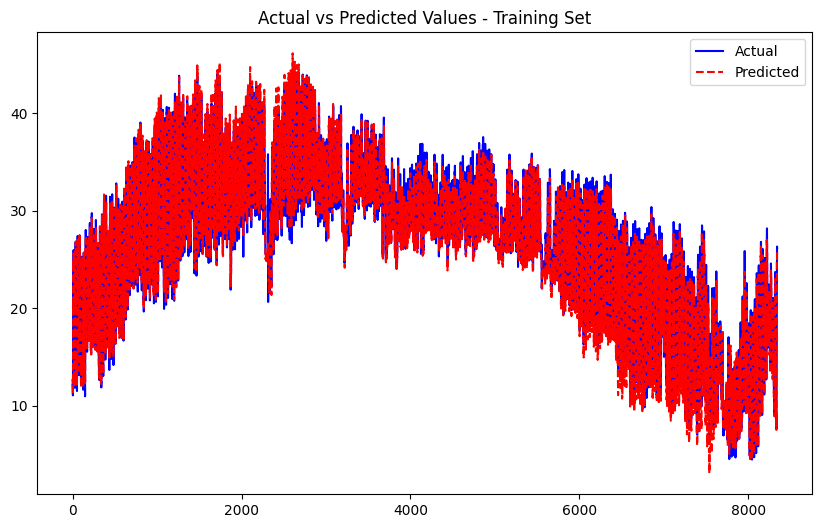

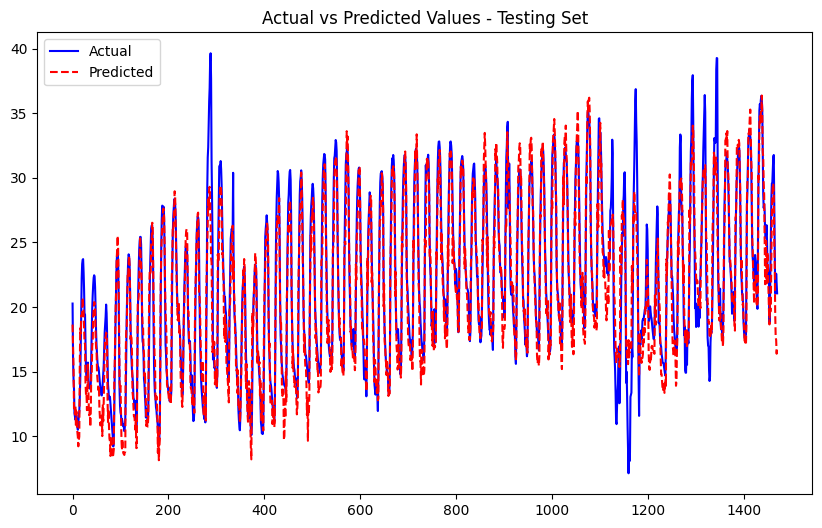

Processing node 27...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0486
Epoch [2/50], Train Loss: 0.0402
Epoch [3/50], Train Loss: 0.0371
Epoch [4/50], Train Loss: 0.0349
Epoch [5/50], Train Loss: 0.0330
Epoch [6/50], Train Loss: 0.0315
Epoch [7/50], Train Loss: 0.0309
Epoch [8/50], Train Loss: 0.0303
Epoch [9/50], Train Loss: 0.0297
Epoch [10/50], Train Loss: 0.0289
Epoch [11/50], Train Loss: 0.0289
Epoch [12/50], Train Loss: 0.0283
Epoch [13/50], Train Loss: 0.0283
Epoch [14/50], Train Loss: 0.0280
Epoch [15/50], Train Loss: 0.0283
Epoch [16/50], Train Loss: 0.0278
Epoch [17/50], Train Loss: 0.0276
Epoch [18/50], Train Loss: 0.0276
Epoch [19/50], Train Loss: 0.0274
Epoch [20/50], Train Loss: 0.0272
Epoch [21/50], Train Loss: 0.0273
Epoch [22/50], Train Loss: 0.0269
Epoch [23/50], Train Loss: 0.0271
Epoch [24/50], Train Loss: 0.0269
Epoch [25/50], Train Loss: 0.0270
Epoch [26/50], Train Loss: 0.0269
Epoch [27/50], Train Loss: 0.0268
Epoch [28/50], Train Loss: 0.0267
Epoch [29/50], Train Loss: 0.0266
Epoch [30/50], Train Lo

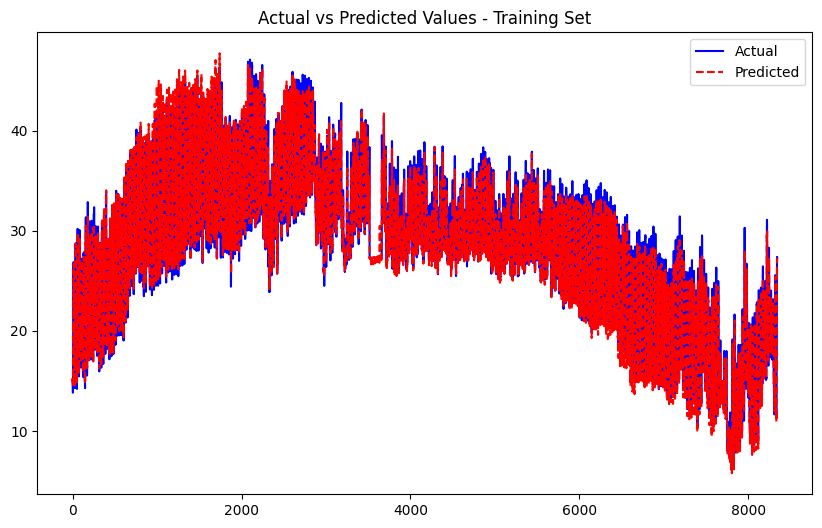

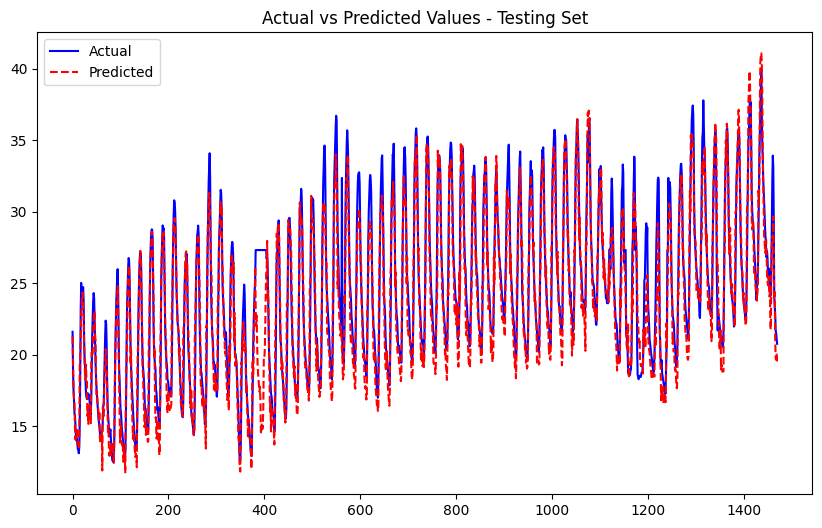

Processing node 28...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0600
Epoch [2/50], Train Loss: 0.0473
Epoch [3/50], Train Loss: 0.0430
Epoch [4/50], Train Loss: 0.0397
Epoch [5/50], Train Loss: 0.0375
Epoch [6/50], Train Loss: 0.0350
Epoch [7/50], Train Loss: 0.0342
Epoch [8/50], Train Loss: 0.0333
Epoch [9/50], Train Loss: 0.0327
Epoch [10/50], Train Loss: 0.0320
Epoch [11/50], Train Loss: 0.0316
Epoch [12/50], Train Loss: 0.0307
Epoch [13/50], Train Loss: 0.0306
Epoch [14/50], Train Loss: 0.0302
Epoch [15/50], Train Loss: 0.0300
Epoch [16/50], Train Loss: 0.0297
Epoch [17/50], Train Loss: 0.0294
Epoch [18/50], Train Loss: 0.0294
Epoch [19/50], Train Loss: 0.0291
Epoch [20/50], Train Loss: 0.0289
Epoch [21/50], Train Loss: 0.0292
Epoch [22/50], Train Loss: 0.0289
Epoch [23/50], Train Loss: 0.0287
Epoch [24/50], Train Loss: 0.0288
Epoch [25/50], Train Loss: 0.0288
Epoch [26/50], Train Loss: 0.0285
Epoch [27/50], Train Loss: 0.0284
Epoch [28/50], Train Loss: 0.0286
Epoch [29/50], Train Loss: 0.0283
Epoch [30/50], Train Lo

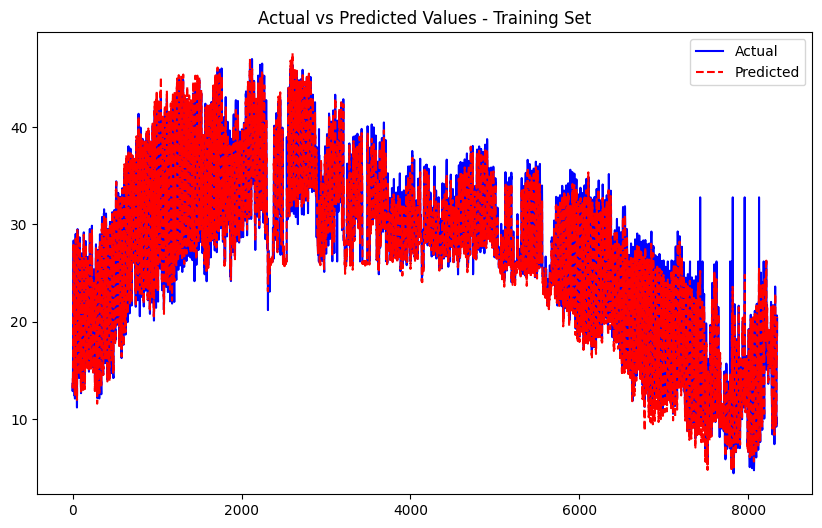

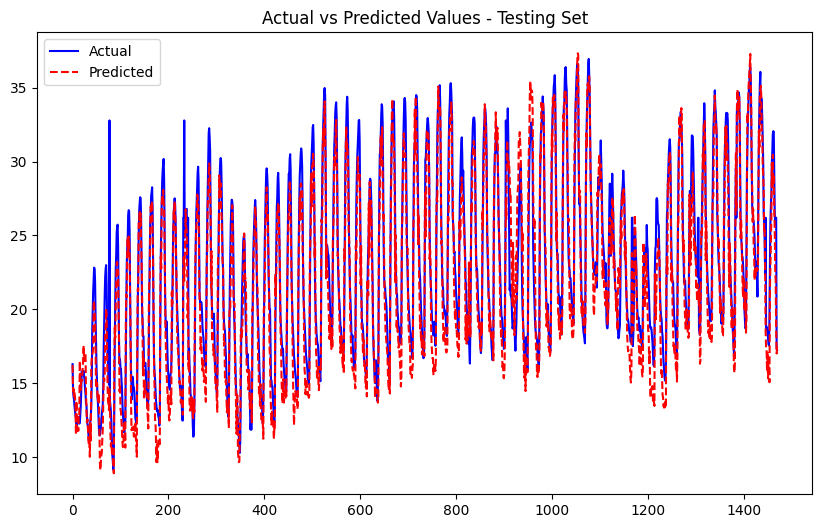

Processing node 29...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0598
Epoch [2/50], Train Loss: 0.0455
Epoch [3/50], Train Loss: 0.0402
Epoch [4/50], Train Loss: 0.0369
Epoch [5/50], Train Loss: 0.0339
Epoch [6/50], Train Loss: 0.0321
Epoch [7/50], Train Loss: 0.0306
Epoch [8/50], Train Loss: 0.0296
Epoch [9/50], Train Loss: 0.0289
Epoch [10/50], Train Loss: 0.0280
Epoch [11/50], Train Loss: 0.0274
Epoch [12/50], Train Loss: 0.0271
Epoch [13/50], Train Loss: 0.0268
Epoch [14/50], Train Loss: 0.0265
Epoch [15/50], Train Loss: 0.0262
Epoch [16/50], Train Loss: 0.0260
Epoch [17/50], Train Loss: 0.0261
Epoch [18/50], Train Loss: 0.0255
Epoch [19/50], Train Loss: 0.0257
Epoch [20/50], Train Loss: 0.0255
Epoch [21/50], Train Loss: 0.0254
Epoch [22/50], Train Loss: 0.0253
Epoch [23/50], Train Loss: 0.0253
Epoch [24/50], Train Loss: 0.0249
Epoch [25/50], Train Loss: 0.0250
Epoch [26/50], Train Loss: 0.0252
Epoch [27/50], Train Loss: 0.0250
Epoch [28/50], Train Loss: 0.0249
Epoch [29/50], Train Loss: 0.0249
Epoch [30/50], Train Lo

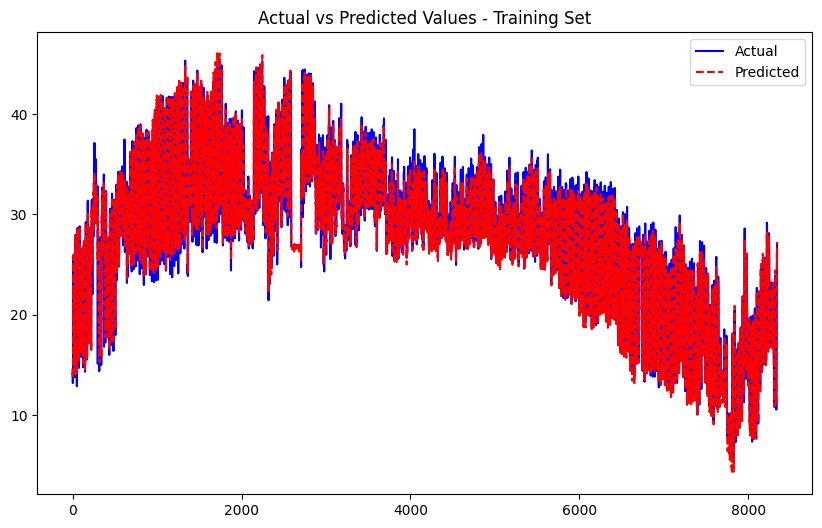

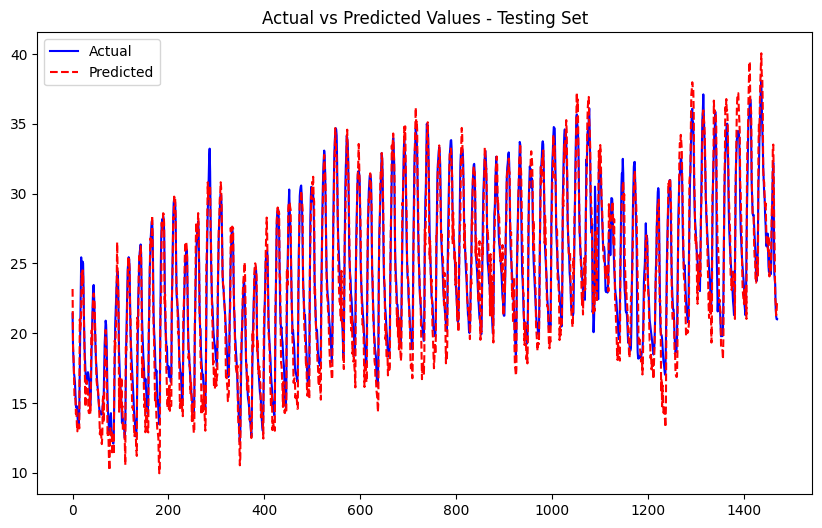

Processing node 30...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0639
Epoch [2/50], Train Loss: 0.0525
Epoch [3/50], Train Loss: 0.0475
Epoch [4/50], Train Loss: 0.0444
Epoch [5/50], Train Loss: 0.0419
Epoch [6/50], Train Loss: 0.0401
Epoch [7/50], Train Loss: 0.0389
Epoch [8/50], Train Loss: 0.0378
Epoch [9/50], Train Loss: 0.0372
Epoch [10/50], Train Loss: 0.0365
Epoch [11/50], Train Loss: 0.0360
Epoch [12/50], Train Loss: 0.0354
Epoch [13/50], Train Loss: 0.0351
Epoch [14/50], Train Loss: 0.0350
Epoch [15/50], Train Loss: 0.0345
Epoch [16/50], Train Loss: 0.0344
Epoch [17/50], Train Loss: 0.0342
Epoch [18/50], Train Loss: 0.0341
Epoch [19/50], Train Loss: 0.0339
Epoch [20/50], Train Loss: 0.0339
Epoch [21/50], Train Loss: 0.0337
Epoch [22/50], Train Loss: 0.0337
Epoch [23/50], Train Loss: 0.0333
Epoch [24/50], Train Loss: 0.0332
Epoch [25/50], Train Loss: 0.0331
Epoch [26/50], Train Loss: 0.0330
Epoch [27/50], Train Loss: 0.0333
Epoch [28/50], Train Loss: 0.0329
Epoch [29/50], Train Loss: 0.0330
Epoch [30/50], Train Lo

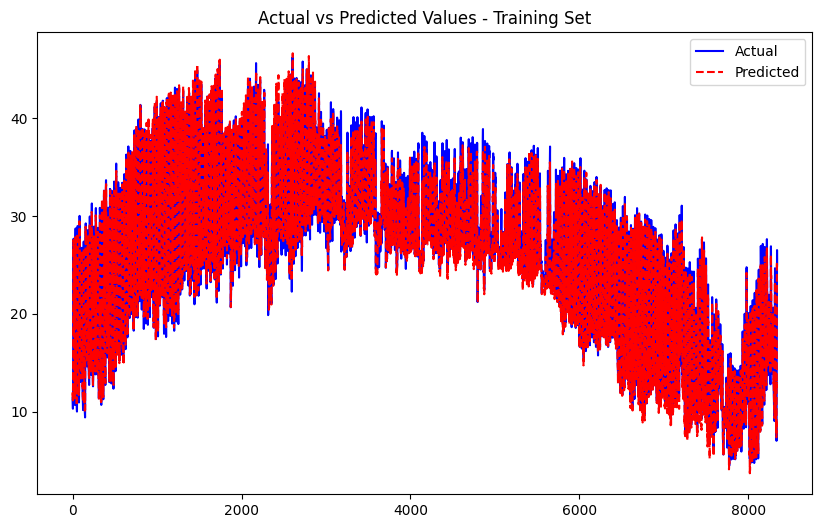

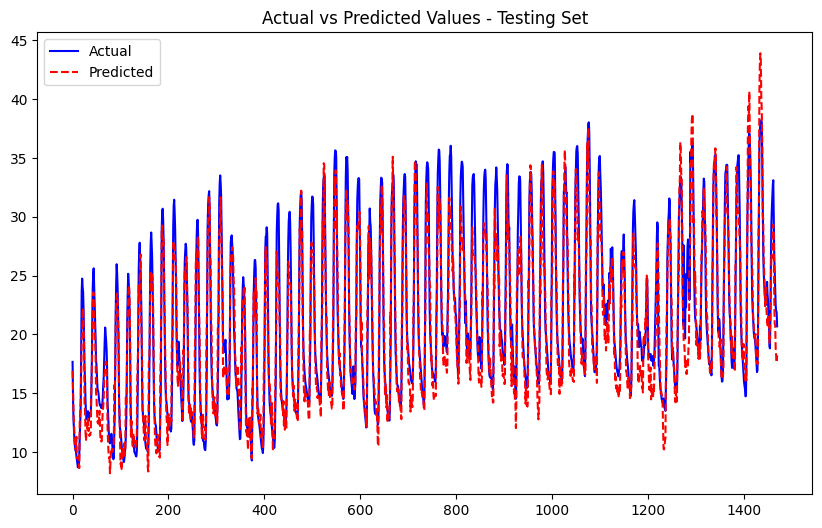

Processing node 31...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0545
Epoch [2/50], Train Loss: 0.0452
Epoch [3/50], Train Loss: 0.0409
Epoch [4/50], Train Loss: 0.0385
Epoch [5/50], Train Loss: 0.0369
Epoch [6/50], Train Loss: 0.0352
Epoch [7/50], Train Loss: 0.0341
Epoch [8/50], Train Loss: 0.0336
Epoch [9/50], Train Loss: 0.0324
Epoch [10/50], Train Loss: 0.0325
Epoch [11/50], Train Loss: 0.0320
Epoch [12/50], Train Loss: 0.0313
Epoch [13/50], Train Loss: 0.0311
Epoch [14/50], Train Loss: 0.0309
Epoch [15/50], Train Loss: 0.0304
Epoch [16/50], Train Loss: 0.0306
Epoch [17/50], Train Loss: 0.0302
Epoch [18/50], Train Loss: 0.0302
Epoch [19/50], Train Loss: 0.0301
Epoch [20/50], Train Loss: 0.0299
Epoch [21/50], Train Loss: 0.0296
Epoch [22/50], Train Loss: 0.0302
Epoch [23/50], Train Loss: 0.0294
Epoch [24/50], Train Loss: 0.0298
Epoch [25/50], Train Loss: 0.0294
Epoch [26/50], Train Loss: 0.0296
Epoch [27/50], Train Loss: 0.0293
Epoch [28/50], Train Loss: 0.0291
Epoch [29/50], Train Loss: 0.0292
Epoch [30/50], Train Lo

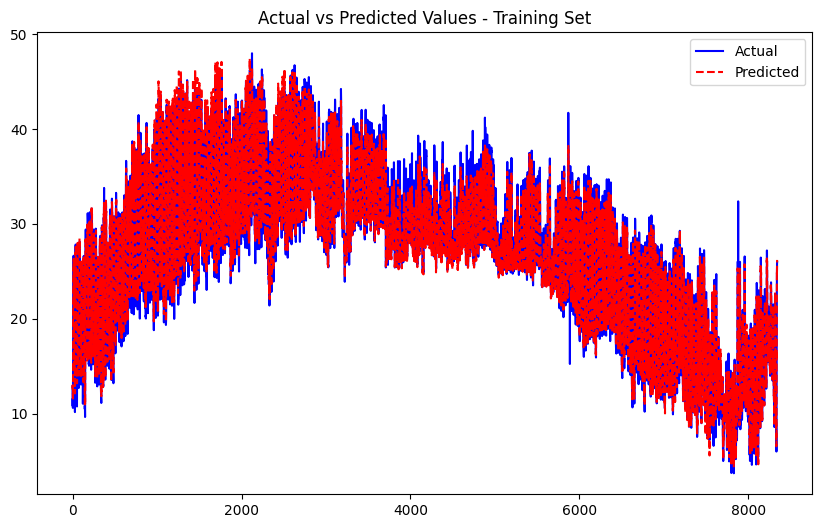

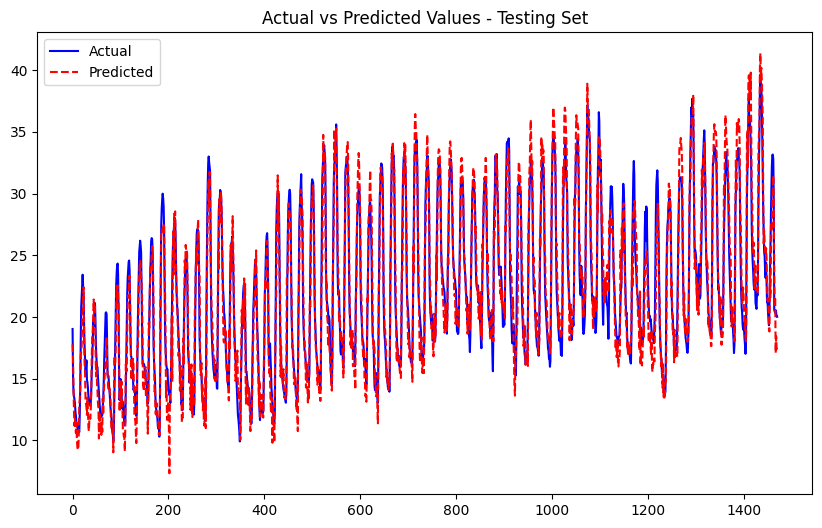

Processing node 32...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0613
Epoch [2/50], Train Loss: 0.0504
Epoch [3/50], Train Loss: 0.0451
Epoch [4/50], Train Loss: 0.0422
Epoch [5/50], Train Loss: 0.0396
Epoch [6/50], Train Loss: 0.0378
Epoch [7/50], Train Loss: 0.0368
Epoch [8/50], Train Loss: 0.0355
Epoch [9/50], Train Loss: 0.0349
Epoch [10/50], Train Loss: 0.0342
Epoch [11/50], Train Loss: 0.0339
Epoch [12/50], Train Loss: 0.0332
Epoch [13/50], Train Loss: 0.0330
Epoch [14/50], Train Loss: 0.0329
Epoch [15/50], Train Loss: 0.0324
Epoch [16/50], Train Loss: 0.0323
Epoch [17/50], Train Loss: 0.0319
Epoch [18/50], Train Loss: 0.0320
Epoch [19/50], Train Loss: 0.0318
Epoch [20/50], Train Loss: 0.0317
Epoch [21/50], Train Loss: 0.0316
Epoch [22/50], Train Loss: 0.0312
Epoch [23/50], Train Loss: 0.0313
Epoch [24/50], Train Loss: 0.0312
Epoch [25/50], Train Loss: 0.0310
Epoch [26/50], Train Loss: 0.0308
Epoch [27/50], Train Loss: 0.0309
Epoch [28/50], Train Loss: 0.0306
Epoch [29/50], Train Loss: 0.0307
Epoch [30/50], Train Lo

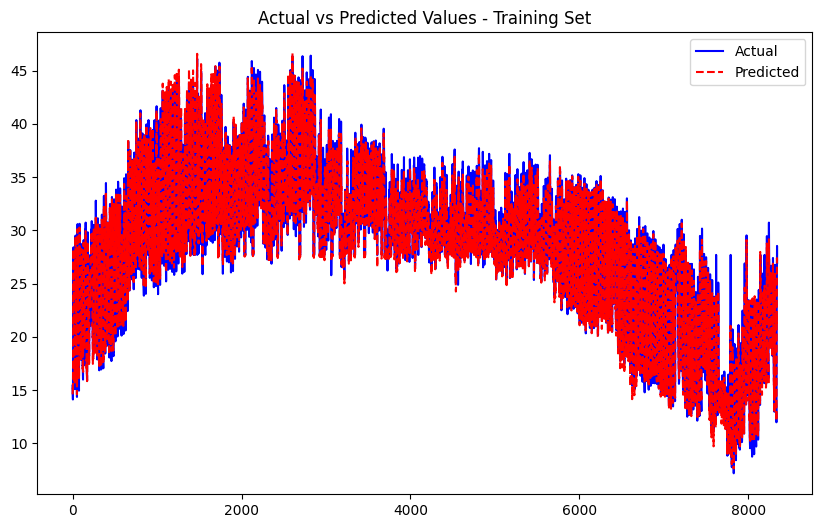

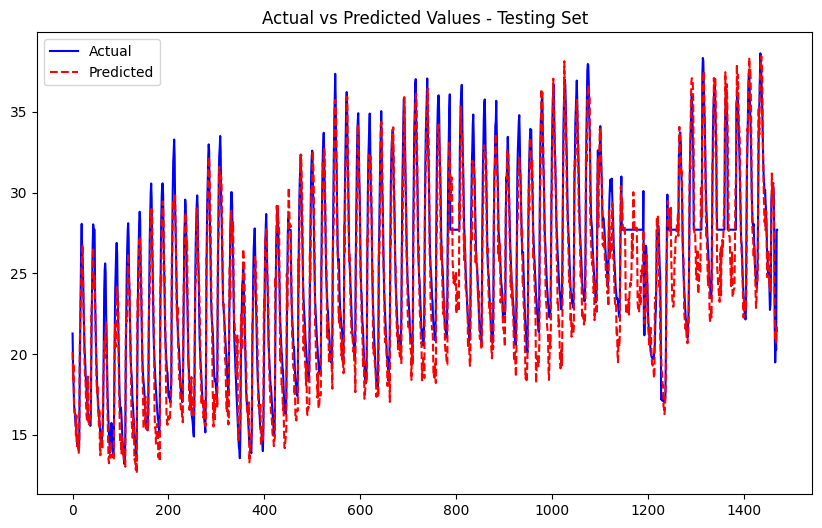

Processing node 33...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1189
Epoch [2/50], Train Loss: 0.1006
Epoch [3/50], Train Loss: 0.0910
Epoch [4/50], Train Loss: 0.0833
Epoch [5/50], Train Loss: 0.0772
Epoch [6/50], Train Loss: 0.0727
Epoch [7/50], Train Loss: 0.0695
Epoch [8/50], Train Loss: 0.0666
Epoch [9/50], Train Loss: 0.0642
Epoch [10/50], Train Loss: 0.0627
Epoch [11/50], Train Loss: 0.0615
Epoch [12/50], Train Loss: 0.0602
Epoch [13/50], Train Loss: 0.0598
Epoch [14/50], Train Loss: 0.0590
Epoch [15/50], Train Loss: 0.0589
Epoch [16/50], Train Loss: 0.0585
Epoch [17/50], Train Loss: 0.0573
Epoch [18/50], Train Loss: 0.0571
Epoch [19/50], Train Loss: 0.0568
Epoch [20/50], Train Loss: 0.0566
Epoch [21/50], Train Loss: 0.0563
Epoch [22/50], Train Loss: 0.0564
Epoch [23/50], Train Loss: 0.0558
Epoch [24/50], Train Loss: 0.0560
Epoch [25/50], Train Loss: 0.0556
Epoch [26/50], Train Loss: 0.0553
Epoch [27/50], Train Loss: 0.0552
Epoch [28/50], Train Loss: 0.0549
Epoch [29/50], Train Loss: 0.0549
Epoch [30/50], Train Lo

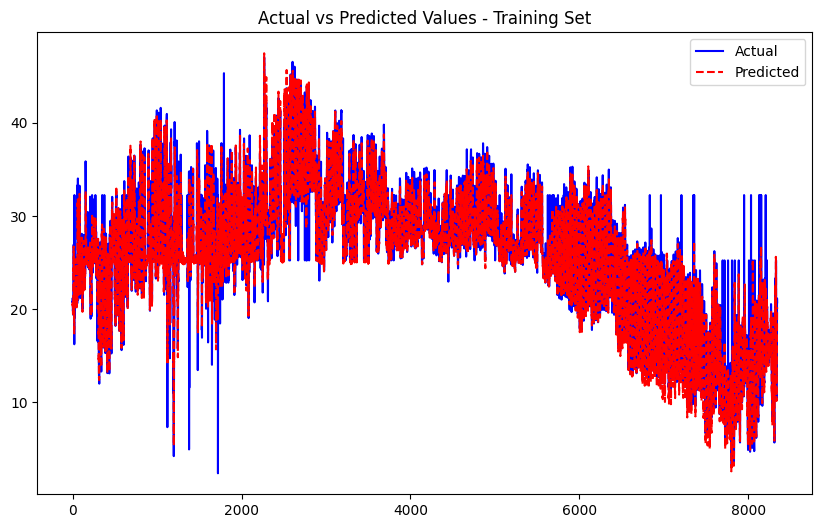

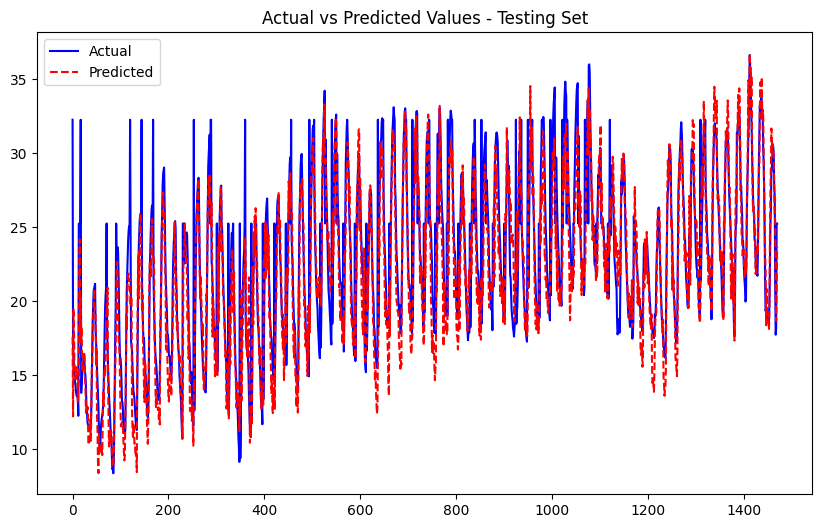

Processing node 34...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0832
Epoch [2/50], Train Loss: 0.0594
Epoch [3/50], Train Loss: 0.0493
Epoch [4/50], Train Loss: 0.0435
Epoch [5/50], Train Loss: 0.0391
Epoch [6/50], Train Loss: 0.0358
Epoch [7/50], Train Loss: 0.0340
Epoch [8/50], Train Loss: 0.0328
Epoch [9/50], Train Loss: 0.0321
Epoch [10/50], Train Loss: 0.0309
Epoch [11/50], Train Loss: 0.0305
Epoch [12/50], Train Loss: 0.0298
Epoch [13/50], Train Loss: 0.0296
Epoch [14/50], Train Loss: 0.0292
Epoch [15/50], Train Loss: 0.0291
Epoch [16/50], Train Loss: 0.0287
Epoch [17/50], Train Loss: 0.0290
Epoch [18/50], Train Loss: 0.0283
Epoch [19/50], Train Loss: 0.0280
Epoch [20/50], Train Loss: 0.0280
Epoch [21/50], Train Loss: 0.0279
Epoch [22/50], Train Loss: 0.0279
Epoch [23/50], Train Loss: 0.0276
Epoch [24/50], Train Loss: 0.0278
Epoch [25/50], Train Loss: 0.0274
Epoch [26/50], Train Loss: 0.0270
Epoch [27/50], Train Loss: 0.0270
Epoch [28/50], Train Loss: 0.0270
Epoch [29/50], Train Loss: 0.0271
Epoch [30/50], Train Lo

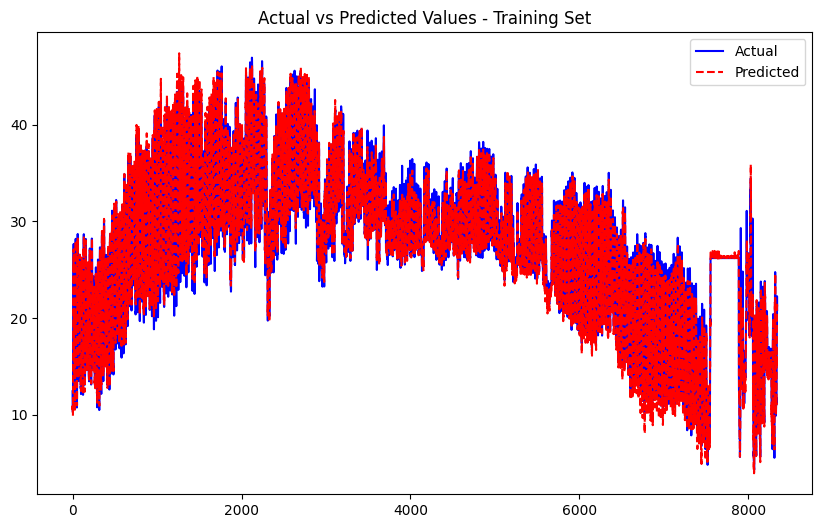

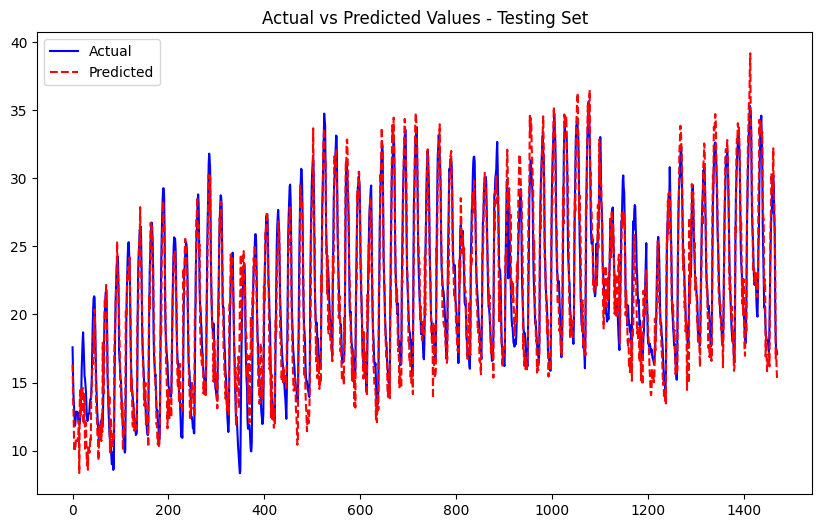

Processing node 35...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0494
Epoch [2/50], Train Loss: 0.0407
Epoch [3/50], Train Loss: 0.0371
Epoch [4/50], Train Loss: 0.0353
Epoch [5/50], Train Loss: 0.0336
Epoch [6/50], Train Loss: 0.0319
Epoch [7/50], Train Loss: 0.0311
Epoch [8/50], Train Loss: 0.0303
Epoch [9/50], Train Loss: 0.0302
Epoch [10/50], Train Loss: 0.0294
Epoch [11/50], Train Loss: 0.0292
Epoch [12/50], Train Loss: 0.0288
Epoch [13/50], Train Loss: 0.0284
Epoch [14/50], Train Loss: 0.0285
Epoch [15/50], Train Loss: 0.0281
Epoch [16/50], Train Loss: 0.0279
Epoch [17/50], Train Loss: 0.0276
Epoch [18/50], Train Loss: 0.0279
Epoch [19/50], Train Loss: 0.0274
Epoch [20/50], Train Loss: 0.0275
Epoch [21/50], Train Loss: 0.0272
Epoch [22/50], Train Loss: 0.0272
Epoch [23/50], Train Loss: 0.0273
Epoch [24/50], Train Loss: 0.0268
Epoch [25/50], Train Loss: 0.0271
Epoch [26/50], Train Loss: 0.0269
Epoch [27/50], Train Loss: 0.0266
Epoch [28/50], Train Loss: 0.0268
Epoch [29/50], Train Loss: 0.0267
Epoch [30/50], Train Lo

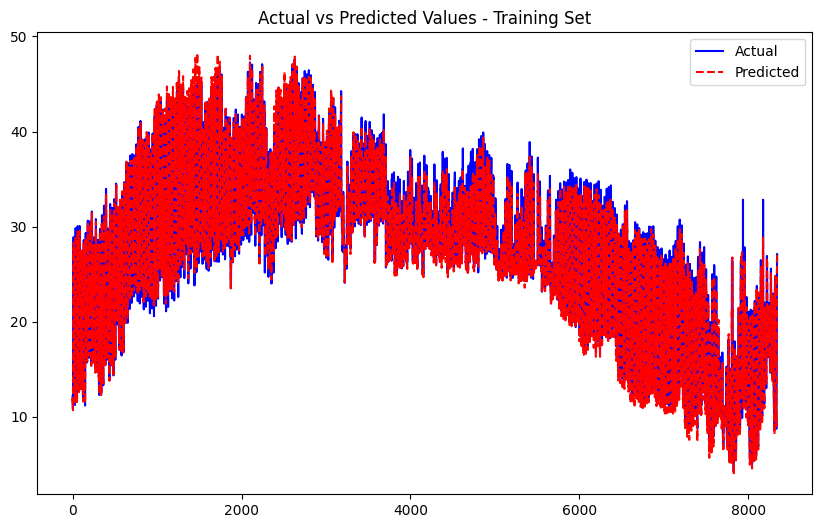

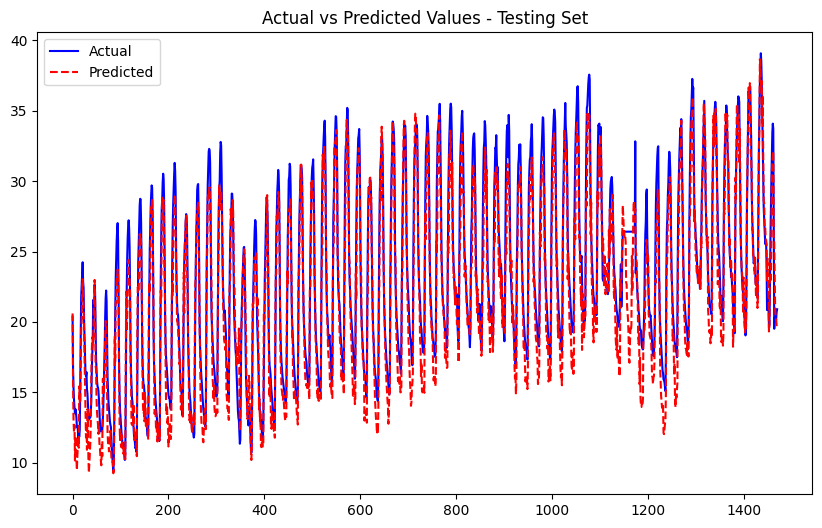

Processing node 36...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0585
Epoch [2/50], Train Loss: 0.0484
Epoch [3/50], Train Loss: 0.0439
Epoch [4/50], Train Loss: 0.0409
Epoch [5/50], Train Loss: 0.0389
Epoch [6/50], Train Loss: 0.0372
Epoch [7/50], Train Loss: 0.0358
Epoch [8/50], Train Loss: 0.0347
Epoch [9/50], Train Loss: 0.0341
Epoch [10/50], Train Loss: 0.0336
Epoch [11/50], Train Loss: 0.0330
Epoch [12/50], Train Loss: 0.0328
Epoch [13/50], Train Loss: 0.0324
Epoch [14/50], Train Loss: 0.0318
Epoch [15/50], Train Loss: 0.0316
Epoch [16/50], Train Loss: 0.0315
Epoch [17/50], Train Loss: 0.0313
Epoch [18/50], Train Loss: 0.0310
Epoch [19/50], Train Loss: 0.0307
Epoch [20/50], Train Loss: 0.0309
Epoch [21/50], Train Loss: 0.0306
Epoch [22/50], Train Loss: 0.0304
Epoch [23/50], Train Loss: 0.0302
Epoch [24/50], Train Loss: 0.0303
Epoch [25/50], Train Loss: 0.0300
Epoch [26/50], Train Loss: 0.0302
Epoch [27/50], Train Loss: 0.0301
Epoch [28/50], Train Loss: 0.0300
Epoch [29/50], Train Loss: 0.0299
Epoch [30/50], Train Lo

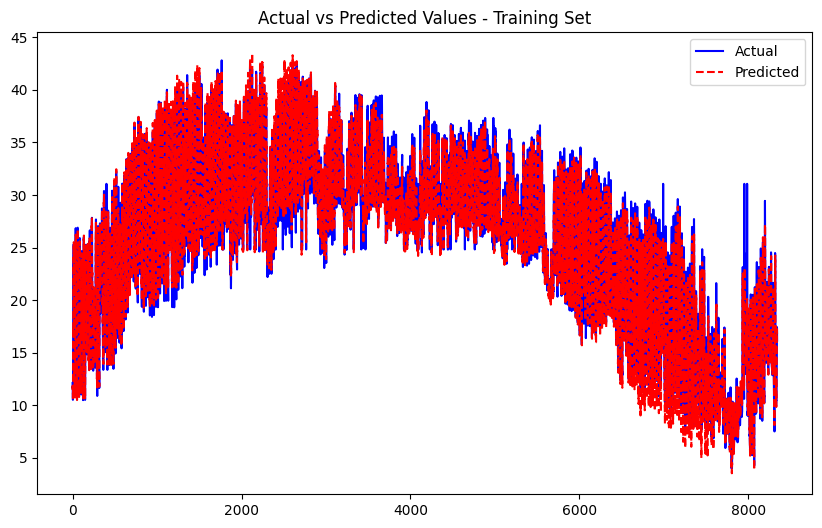

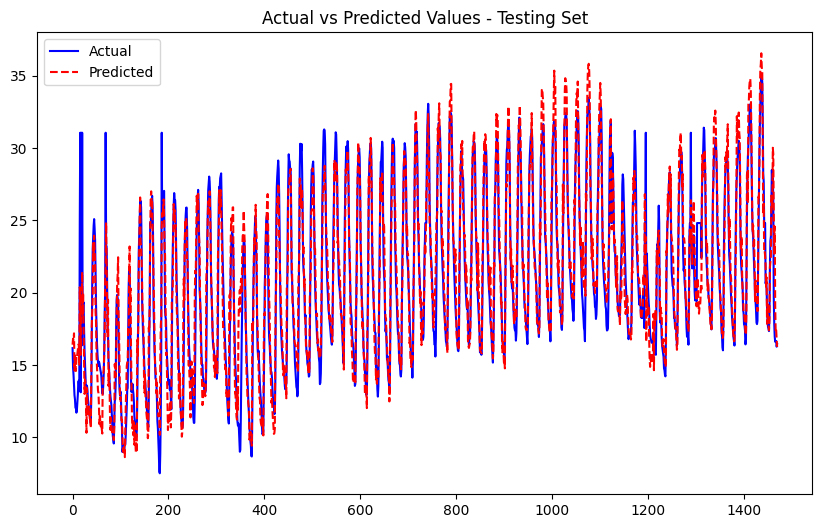

Processing node 37...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0604
Epoch [2/50], Train Loss: 0.0507
Epoch [3/50], Train Loss: 0.0469
Epoch [4/50], Train Loss: 0.0443
Epoch [5/50], Train Loss: 0.0420
Epoch [6/50], Train Loss: 0.0403
Epoch [7/50], Train Loss: 0.0393
Epoch [8/50], Train Loss: 0.0383
Epoch [9/50], Train Loss: 0.0372
Epoch [10/50], Train Loss: 0.0368
Epoch [11/50], Train Loss: 0.0363
Epoch [12/50], Train Loss: 0.0358
Epoch [13/50], Train Loss: 0.0357
Epoch [14/50], Train Loss: 0.0356
Epoch [15/50], Train Loss: 0.0352
Epoch [16/50], Train Loss: 0.0348
Epoch [17/50], Train Loss: 0.0348
Epoch [18/50], Train Loss: 0.0345
Epoch [19/50], Train Loss: 0.0346
Epoch [20/50], Train Loss: 0.0344
Epoch [21/50], Train Loss: 0.0342
Epoch [22/50], Train Loss: 0.0339
Epoch [23/50], Train Loss: 0.0342
Epoch [24/50], Train Loss: 0.0340
Epoch [25/50], Train Loss: 0.0338
Epoch [26/50], Train Loss: 0.0336
Epoch [27/50], Train Loss: 0.0337
Epoch [28/50], Train Loss: 0.0335
Epoch [29/50], Train Loss: 0.0335
Epoch [30/50], Train Lo

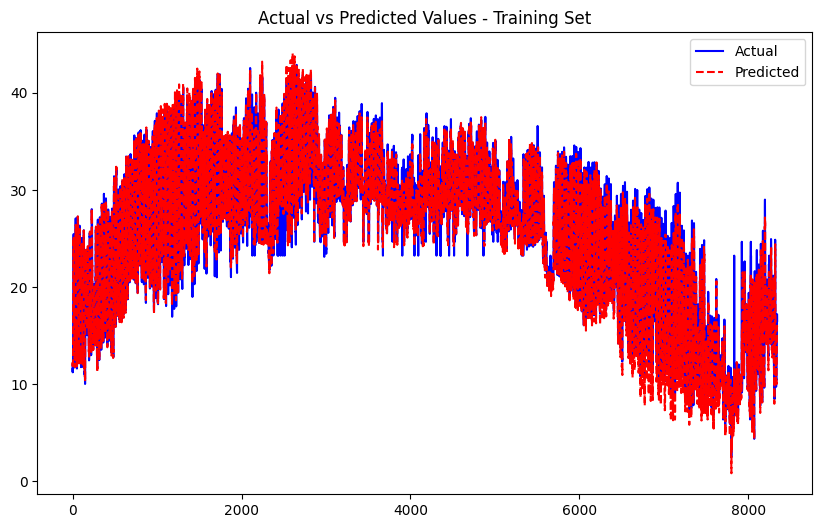

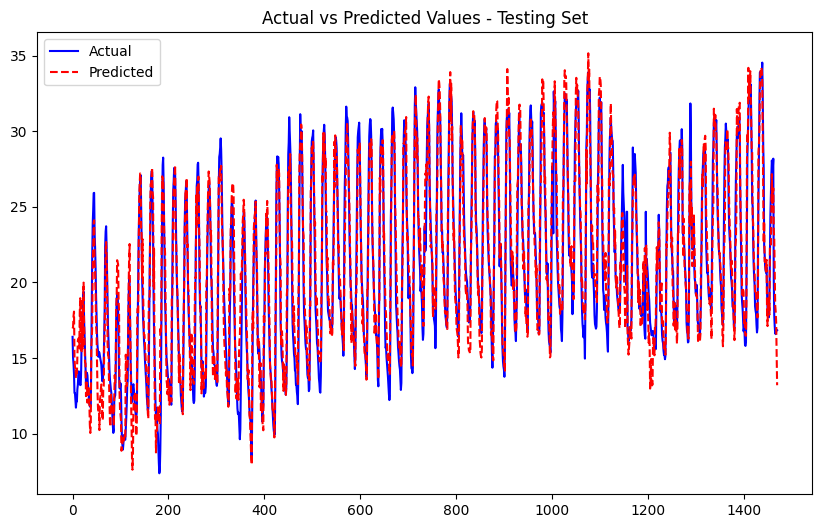

Processing node 38...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0554
Epoch [2/50], Train Loss: 0.0456
Epoch [3/50], Train Loss: 0.0411
Epoch [4/50], Train Loss: 0.0379
Epoch [5/50], Train Loss: 0.0361
Epoch [6/50], Train Loss: 0.0344
Epoch [7/50], Train Loss: 0.0335
Epoch [8/50], Train Loss: 0.0325
Epoch [9/50], Train Loss: 0.0315
Epoch [10/50], Train Loss: 0.0310
Epoch [11/50], Train Loss: 0.0305
Epoch [12/50], Train Loss: 0.0302
Epoch [13/50], Train Loss: 0.0297
Epoch [14/50], Train Loss: 0.0294
Epoch [15/50], Train Loss: 0.0292
Epoch [16/50], Train Loss: 0.0291
Epoch [17/50], Train Loss: 0.0287
Epoch [18/50], Train Loss: 0.0286
Epoch [19/50], Train Loss: 0.0287
Epoch [20/50], Train Loss: 0.0287
Epoch [21/50], Train Loss: 0.0284
Epoch [22/50], Train Loss: 0.0281
Epoch [23/50], Train Loss: 0.0283
Epoch [24/50], Train Loss: 0.0279
Epoch [25/50], Train Loss: 0.0285
Epoch [26/50], Train Loss: 0.0280
Epoch [27/50], Train Loss: 0.0278
Epoch [28/50], Train Loss: 0.0275
Epoch [29/50], Train Loss: 0.0276
Epoch [30/50], Train Lo

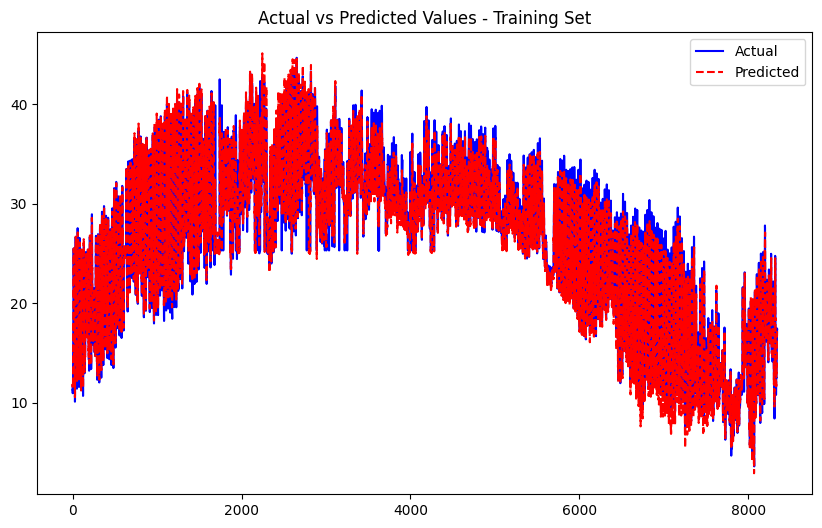

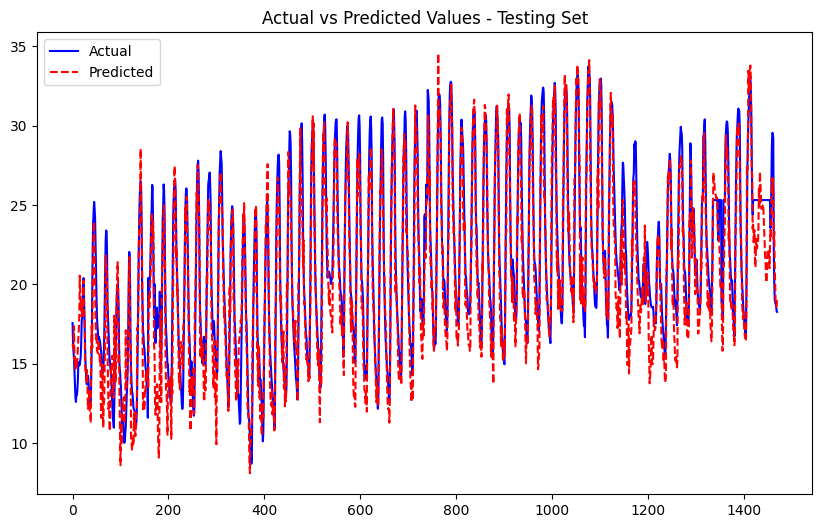

Processing node 39...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1383
Epoch [2/50], Train Loss: 0.1154
Epoch [3/50], Train Loss: 0.1041
Epoch [4/50], Train Loss: 0.0982
Epoch [5/50], Train Loss: 0.0940
Epoch [6/50], Train Loss: 0.0910
Epoch [7/50], Train Loss: 0.0870
Epoch [8/50], Train Loss: 0.0849
Epoch [9/50], Train Loss: 0.0837
Epoch [10/50], Train Loss: 0.0813
Epoch [11/50], Train Loss: 0.0804
Epoch [12/50], Train Loss: 0.0796
Epoch [13/50], Train Loss: 0.0795
Epoch [14/50], Train Loss: 0.0779
Epoch [15/50], Train Loss: 0.0776
Epoch [16/50], Train Loss: 0.0772
Epoch [17/50], Train Loss: 0.0766
Epoch [18/50], Train Loss: 0.0768
Epoch [19/50], Train Loss: 0.0761
Epoch [20/50], Train Loss: 0.0761
Epoch [21/50], Train Loss: 0.0756
Epoch [22/50], Train Loss: 0.0754
Epoch [23/50], Train Loss: 0.0758
Epoch [24/50], Train Loss: 0.0754
Epoch [25/50], Train Loss: 0.0750
Epoch [26/50], Train Loss: 0.0748
Epoch [27/50], Train Loss: 0.0745
Epoch [28/50], Train Loss: 0.0748
Epoch [29/50], Train Loss: 0.0744
Epoch [30/50], Train Lo

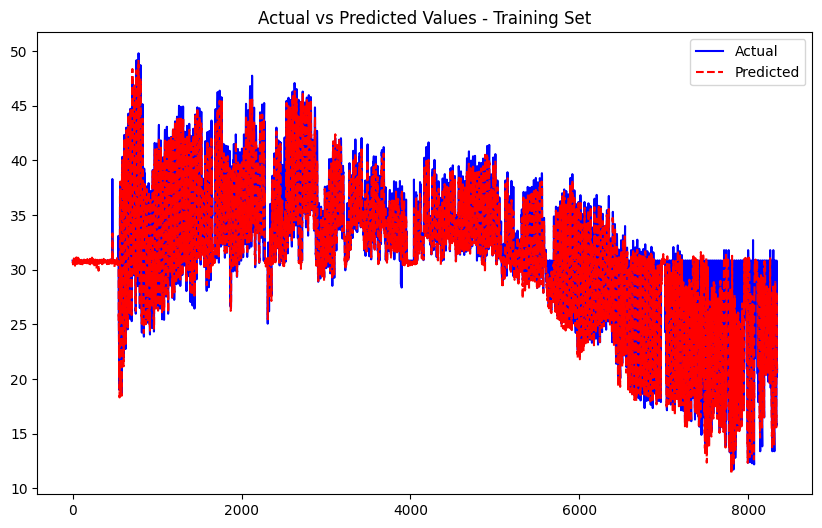

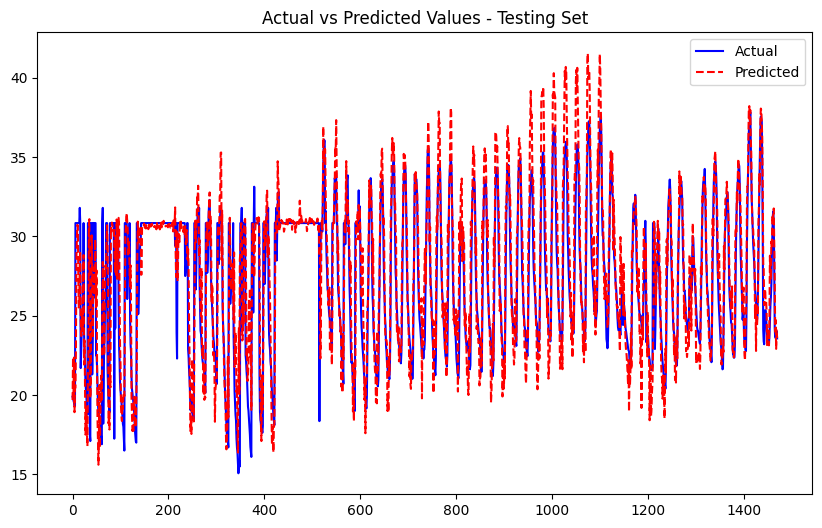

Processing node 40...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1581
Epoch [2/50], Train Loss: 0.0773
Epoch [3/50], Train Loss: 0.0581
Epoch [4/50], Train Loss: 0.0498
Epoch [5/50], Train Loss: 0.0474
Epoch [6/50], Train Loss: 0.0423
Epoch [7/50], Train Loss: 0.0413
Epoch [8/50], Train Loss: 0.0392
Epoch [9/50], Train Loss: 0.0375
Epoch [10/50], Train Loss: 0.0355
Epoch [11/50], Train Loss: 0.0347
Epoch [12/50], Train Loss: 0.0323
Epoch [13/50], Train Loss: 0.0324
Epoch [14/50], Train Loss: 0.0321
Epoch [15/50], Train Loss: 0.0307
Epoch [16/50], Train Loss: 0.0303
Epoch [17/50], Train Loss: 0.0303
Epoch [18/50], Train Loss: 0.0286
Epoch [19/50], Train Loss: 0.0286
Epoch [20/50], Train Loss: 0.0292
Epoch [21/50], Train Loss: 0.0284
Epoch [22/50], Train Loss: 0.0279
Epoch [23/50], Train Loss: 0.0278
Epoch [24/50], Train Loss: 0.0274
Epoch [25/50], Train Loss: 0.0279
Epoch [26/50], Train Loss: 0.0278
Epoch [27/50], Train Loss: 0.0278
Epoch [28/50], Train Loss: 0.0273
Epoch [29/50], Train Loss: 0.0266
Epoch [30/50], Train Lo

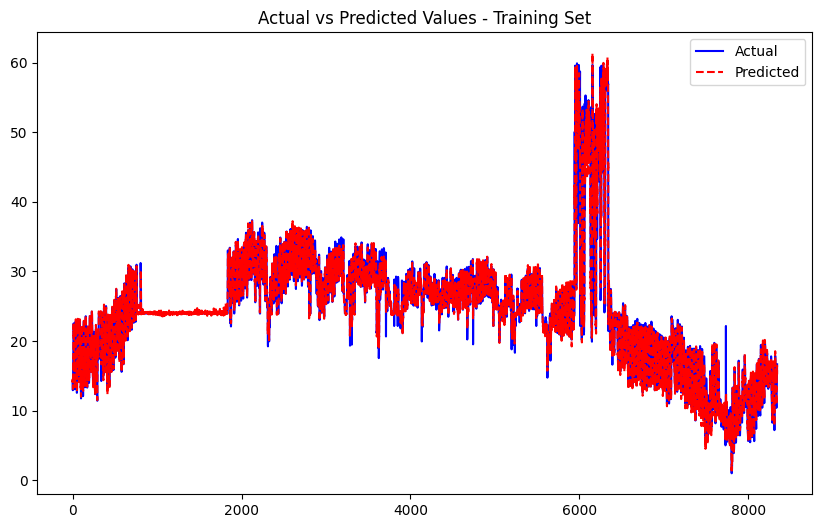

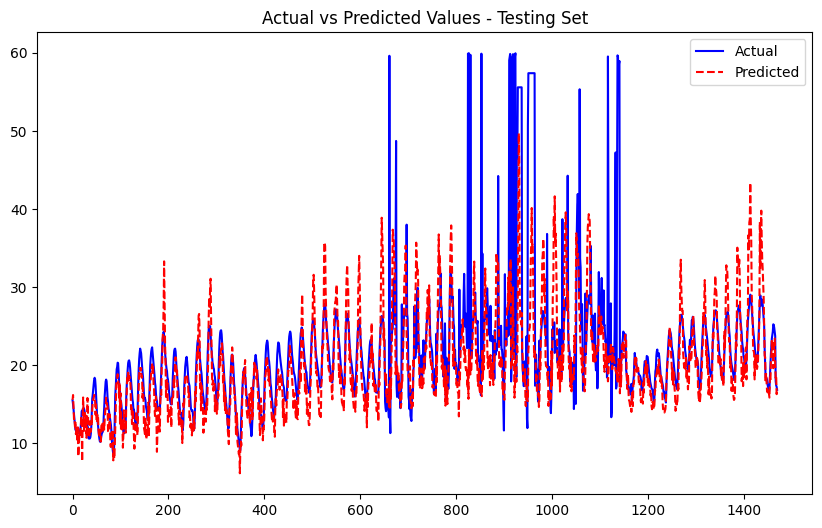

Processing node 41...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0851
Epoch [2/50], Train Loss: 0.0665
Epoch [3/50], Train Loss: 0.0604
Epoch [4/50], Train Loss: 0.0552
Epoch [5/50], Train Loss: 0.0511
Epoch [6/50], Train Loss: 0.0492
Epoch [7/50], Train Loss: 0.0476
Epoch [8/50], Train Loss: 0.0458
Epoch [9/50], Train Loss: 0.0448
Epoch [10/50], Train Loss: 0.0430
Epoch [11/50], Train Loss: 0.0425
Epoch [12/50], Train Loss: 0.0417
Epoch [13/50], Train Loss: 0.0415
Epoch [14/50], Train Loss: 0.0409
Epoch [15/50], Train Loss: 0.0400
Epoch [16/50], Train Loss: 0.0396
Epoch [17/50], Train Loss: 0.0398
Epoch [18/50], Train Loss: 0.0392
Epoch [19/50], Train Loss: 0.0388
Epoch [20/50], Train Loss: 0.0384
Epoch [21/50], Train Loss: 0.0384
Epoch [22/50], Train Loss: 0.0378
Epoch [23/50], Train Loss: 0.0380
Epoch [24/50], Train Loss: 0.0377
Epoch [25/50], Train Loss: 0.0374
Epoch [26/50], Train Loss: 0.0373
Epoch [27/50], Train Loss: 0.0372
Epoch [28/50], Train Loss: 0.0371
Epoch [29/50], Train Loss: 0.0372
Epoch [30/50], Train Lo

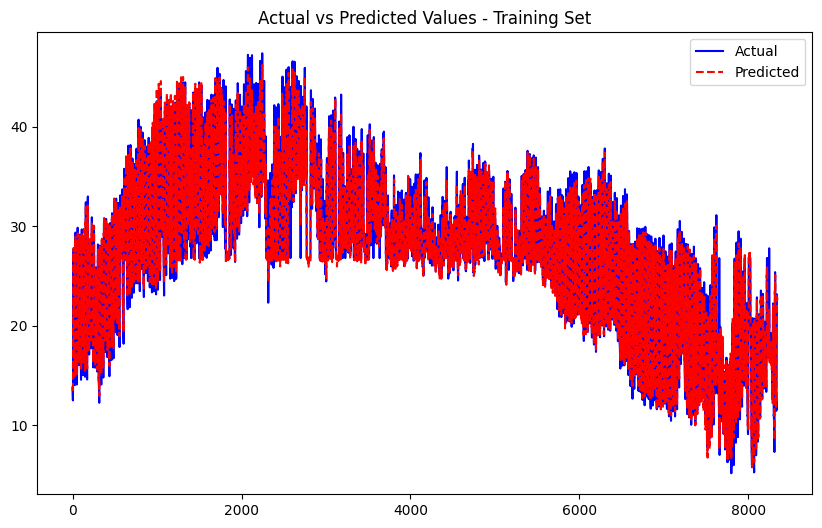

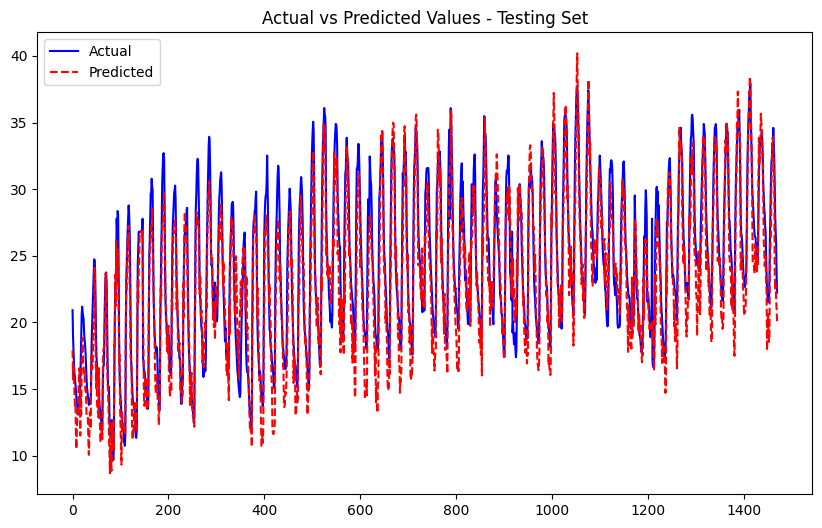

Train GNN and LSTM Imputed HourMean bs 3 sl 3.csv
CSV file 'Train GNN and LSTM Imputed HourMean bs 3 sl 3.csv' created successfully.
Test GNN and LSTM Imputed HourMean bs 3 sl 3.csv
CSV file 'Test GNN and LSTM Imputed HourMean bs 3 sl 3.csv' created successfully.


In [21]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import numpy as np
import torch.optim.lr_scheduler as lr_scheduler

# Define the LSTM Model
class LSTMModel(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size, dropout_prob=0.2):
        super(LSTMModel, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        
        # Define the LSTM layer
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)  # One hidden layer
        
        # Dropout layer
        self.dropout = nn.Dropout(dropout_prob)
        
        # Fully connected layer (output layer)
        self.fc = nn.Linear(hidden_size, output_size)
        
        # Activation function
        self.elu = nn.ELU()

    def forward(self, x):
        # Initialize hidden state and cell state with zeros
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)  # 1 layer, batch_size, hidden_size
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)  # 1 layer, batch_size, hidden_size

        # Forward pass through LSTM
        out, _ = self.lstm(x, (h0, c0))  # LSTM returns all outputs (hidden states) and the final states
        
        # Apply ReLU activation function to the last time step output
        out = self.elu(out[:, -1, :])  # out[:, -1, :] -> output from the last time step
        
        # Apply dropout to the hidden layer's output
        out = self.dropout(out)
        
        # Pass the output through the fully connected layer
        out = self.fc(out)
        
        return out


def train_model(model, train_loader, criterion, optimizer, num_epochs):
    model.train()  # Set the model to training mode
    for epoch in range(num_epochs):
        running_loss = 0.0
        
        # Training phase
        for features, targets in train_loader:
            features, targets = features.to(device), targets.to(device)

            # Reshape input for LSTM (batch_size, sequence_length, num_features)
            # features should already be of shape (batch_size, sequence_length, num_features)
            
            # Forward pass
            outputs = model(features)  # LSTM will process the sequence data correctly
            loss = criterion(outputs, targets)  # Compute the loss

            # Backward and optimize
            optimizer.zero_grad()  # Clear previous gradients
            loss.backward()  # Backpropagate the loss
            optimizer.step()  # Update weights

            running_loss += loss.item()   

        # Print training loss after each epoch
        print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {running_loss/len(train_loader):.4f}')
    
    # Switch back to evaluation mode
    model.eval()



def test_model(model, train_loader, test_loader, node_idx):
    model.eval()
    all_actuals = []
    all_predictions = []
    
    # For tracking actuals and predictions for train and test sets separately
    train_actuals = []
    train_predictions = []
    
    test_actuals = []
    test_predictions = []

    
    with torch.no_grad():
        # Predict on training data
        for features, targets in train_loader:
            features, targets = features.to(device), targets.to(device)
            outputs = model(features)

            train_actuals.append(targets.cpu().numpy())
            train_predictions.append(outputs.cpu().numpy())

        # Predict on testing data
        for features, targets in test_loader:
            features, targets = features.to(device), targets.to(device)
            outputs = model(features)

            test_actuals.append(targets.cpu().numpy())
            test_predictions.append(outputs.cpu().numpy())
    
    # Concatenate all sets
    train_actuals = np.concatenate(train_actuals, axis=0)
    test_actuals = np.concatenate(test_actuals, axis=0)
    
    train_predictions = np.concatenate(train_predictions, axis=0)
    test_predictions = np.concatenate(test_predictions, axis=0)

    # Check shapes before proceeding
    print(f"Training actuals shape: {train_actuals.shape}, Predictions shape: {train_predictions.shape}")
    print(f"Testing actuals shape: {test_actuals.shape}, Predictions shape: {test_predictions.shape}")
    
    # Combine them for inverse scaling
    all_actuals = np.concatenate([train_actuals, test_actuals])
    all_predictions = np.concatenate([train_predictions, test_predictions])
    
    # Inverse scaling
    file_name = input_files[node_idx]
    
    if file_name in scalers:
        all_actuals = all_actuals.reshape(-1, 1)
        all_predictions = all_predictions.reshape(-1, 1)
        
        # Apply inverse scaling
        all_actuals_inverse = scalers[file_name].inverse_transform(all_actuals).flatten()
        all_predictions_inverse = scalers[file_name].inverse_transform(all_predictions).flatten()
    else:
        print(f"Scaler not found for {file_name}")
        return
    
    # Split them back into training and test sets
    train_size = len(train_actuals)
    test_size = len(test_actuals)
    
    train_actuals_inverse = all_actuals_inverse[:train_size]
    test_actuals_inverse = all_actuals_inverse[train_size:]
    
    train_predictions_inverse = all_predictions_inverse[:train_size]
    test_predictions_inverse = all_predictions_inverse[train_size:]

    # Verify split sizes
    print(f"Split Training actuals shape: {train_actuals_inverse.shape}, Predictions shape: {train_predictions_inverse.shape}")
    print(f"Split Testing actuals shape: {test_actuals_inverse.shape}, Predictions shape: {test_predictions_inverse.shape}")
    
    # Function to calculate and print metrics
    def calculate_metrics(actuals, predictions, set_name):
        mae = mean_absolute_error(actuals, predictions)
        mse = mean_squared_error(actuals, predictions)
        rmse = np.sqrt(mse)
        r2 = r2_score(actuals, predictions)
        corr_coeff = np.corrcoef(actuals.flatten(), predictions.flatten())[0, 1]
        
        # Print the metrics
        print(f"{set_name} Set Metrics:")
        print(f"Mean Absolute Error (MAE): {mae:.4f}")
        print(f"Mean Squared Error (MSE): {mse:.4f}")
        print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
        print(f"Pearson Correlation Coefficient: {corr_coeff:.4f}")
        print(f"R-squared (R²): {r2:.4f}")
        print("\n" + "-"*40 + "\n")

        if set_name == 'Training':
            train_mae_list.append(mae)
            train_mse_list.append(mse)
            train_rmse_list.append(rmse)
            train_r2_list.append(r2)
            train_corr_list.append(corr_coeff)

        elif set_name == 'Testing':
            test_mae_list.append(mae)
            test_mse_list.append(mse)
            test_rmse_list.append(rmse)
            test_r2_list.append(r2)
            test_corr_list.append(corr_coeff)        
    
    # Calculate and print metrics for each set
    print(f"\nCalculating metrics for Node {node_idx+1} - {file_name}")
    calculate_metrics(train_actuals_inverse, train_predictions_inverse, 'Training')
    calculate_metrics(test_actuals_inverse, test_predictions_inverse, 'Testing')

    print(f"\n\nCalculating Average Metrics for Training:")
    print(f"Mean MAE: {np.mean(train_mae_list):.4f}")
    print(f"Mean MSE: {np.mean(train_mse_list):.4f}")
    print(f"Mean RMSE: {np.mean(train_rmse_list):.4f}")
    print(f"Mean R²: {np.mean(train_r2_list):.4f}")
    print(f"Mean CorrCoeff: {np.mean(train_corr_list):.4f}")

    print(f"\n\nCalculating Average Metrics for Testing:")
    print(f"Mean MAE: {np.mean(test_mae_list):.4f}")
    print(f"Mean MSE: {np.mean(test_mse_list):.4f}")
    print(f"Mean RMSE: {np.mean(test_rmse_list):.4f}")
    print(f"Mean R²: {np.mean(test_r2_list):.4f}")
    print(f"Mean CorrCoeff: {np.mean(test_corr_list):.4f}")    
    
    # Function to plot actual vs predicted values
    def plot_results(actuals, predictions, set_name):
        plt.figure(figsize=(10, 6))
        plt.plot(actuals, label="Actual", color='blue')
        plt.plot(predictions, label="Predicted", color='red', linestyle='dashed')
        plt.title(f'Actual vs Predicted Values - {set_name} Set')
        plt.legend()
        plt.show()
    
    # Plot results for each set
    plot_results(train_actuals_inverse, train_predictions_inverse, 'Training')
    plot_results(test_actuals_inverse, test_predictions_inverse, 'Testing')


def create_dataloaders(features, targets, batch_size, sequence_length):
    # Convert DataFrame to NumPy arrays
    features_np = features.to_numpy()
    targets_np = targets.to_numpy()

    # Prepare sequences of data
    feature_sequences = []
    target_sequences = []

    # Create rolling windows of `sequence_length`
    for i in range(len(features_np) - sequence_length + 1):
        # Get sequence of features and corresponding target
        feature_sequences.append(features_np[i:i+sequence_length])
        target_sequences.append(targets_np[i+sequence_length-1])  # target is the last value of the sequence

    # Convert to NumPy arrays
    feature_sequences = np.array(feature_sequences)
    target_sequences = np.array(target_sequences)

    # Convert to PyTorch tensors
    features_tensor = torch.tensor(feature_sequences, dtype=torch.float32)
    targets_tensor = torch.tensor(target_sequences, dtype=torch.float32)

    # Create a dataset and dataloader
    dataset = torch.utils.data.TensorDataset(features_tensor, targets_tensor)
    return torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=False)

# Initialize the PyTorch model, criterion, and optimizer
input_size = train_features_list[0].shape[1]
hidden_size = 128
num_layers = 2
output_size = 1
num_epochs = 50
learning_rate = 0.0005
batch_size = 3
sequence_length = 3

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = LSTMModel(input_size, hidden_size, num_layers, output_size).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

print(f"For Batch Size= {batch_size} and Sequence Length = {sequence_length}")
train_mae_list = []
train_mse_list = []
train_rmse_list = []
train_r2_list = []
train_corr_list = []

test_mae_list = []
test_mse_list = []
test_rmse_list = []
test_r2_list = []
test_corr_list = []

# Process for each node
for node_idx, (train_features, train_targets, test_features, test_targets) in enumerate(zip(train_features_list, train_target_list, test_features_list, test_target_list)):
    print(f"Processing node {node_idx+1}...")

    # Create dataloaders
    train_loader = create_dataloaders(train_features, train_targets, batch_size, sequence_length)
    test_loader = create_dataloaders(test_features, test_targets, batch_size, sequence_length)

    # Train the model
    train_model(model, train_loader, criterion, optimizer, num_epochs)

    # Test the model and output metrics/plot
    test_model(model, train_loader, test_loader, node_idx)

    # Define function to create DataFrame and save to CSV
def create_metrics_csv(file_name, input_files, mae_list, mse_list, rmse_list, r2_list, corr_list):
    metrics_df = pd.DataFrame({
        "File Name": input_files,
        "MAE": mae_list,
        "MSE": mse_list,
        "RMSE": rmse_list,
        "R2": r2_list,
        "CorrCoeff": corr_list
    })
    metrics_df.to_csv(file_name, index=False)
    print(f"CSV file '{file_name}' created successfully.")

# Create CSV for training set
file_name = "Train GNN and LSTM Imputed HourMean bs 3 sl 3.csv"
print(file_name)
create_metrics_csv(file_name, input_files, train_mae_list, train_mse_list, train_rmse_list, train_r2_list, train_corr_list)

# Create CSV for test set
file_name = "Test GNN and LSTM Imputed HourMean bs 3 sl 3.csv"
print(file_name)
create_metrics_csv(file_name, input_files, test_mae_list, test_mse_list, test_rmse_list, test_r2_list, test_corr_list)    
